In [1]:
import numpy as np
from numpy import linalg as la
import matplotlib.pyplot as plt
from sklearn.preprocessing import scale

from data_cube import DataCube
from ssm import SSM
from similarity_network_fusion import SNF

In [2]:
from tslearn.metrics import dtw, dtw_path

In [3]:
dc = DataCube(
    subjects="all",
    gestures=["1", "2", "3", "4"],
    channels=["2", "4", "6", "8"],
    data_grp="parsed"
)
dc.load_data()
dc.rms_smooth(300, 20)
dc.normalize_modalities(smooth=True)

---

In [4]:
def pass_synergist_channels(gnum, array):
    """
    pass synergist only channels for each gesture
    gnum - gesture number (i.e. 1, 2, 3, or 4)
    array - entire array of all channels and time index
    """
    synrgsts = {"1":[0, 1, 4], # channels 2 & 8; 0 is tidx
                "2":[0, 2, 3], # channels 4 & 6; 0 is tidx
                "3":[0, 1, 2], # channels 4 & 2; 0 is tidx
                "4":[0, 3, 4]} # channels 6 & 8; 0 is tidx
    synergist_array = np.c_[array[:, synrgsts[gnum][0]],
                            array[:, synrgsts[gnum][1]],
                            array[:, synrgsts[gnum][2]]]
    return synergist_array

---

subject 30; gesture 3_0_1


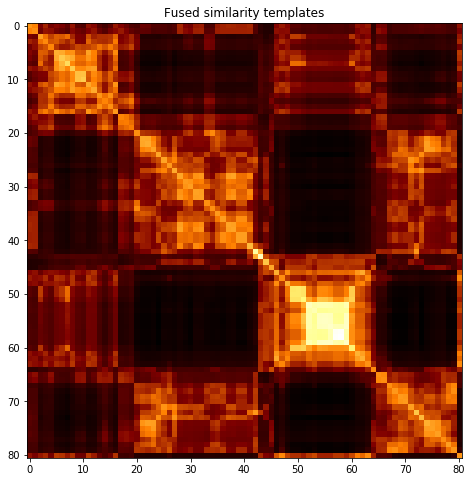

subject 30; gesture 4_1_1


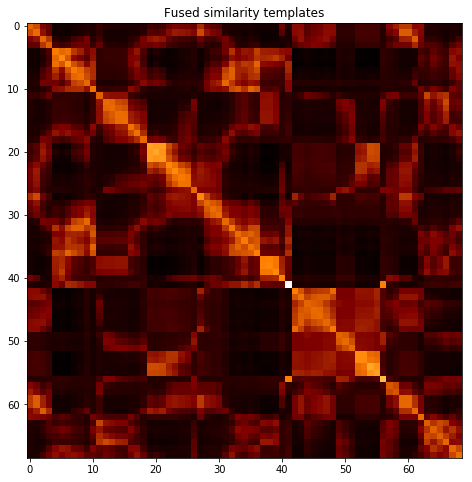

subject 30; gesture 2_0_1


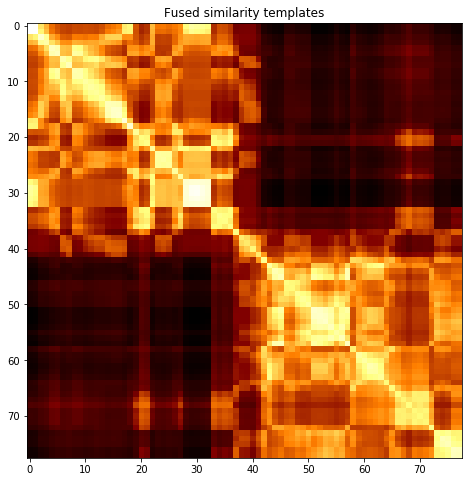

subject 30; gesture 4_1_2


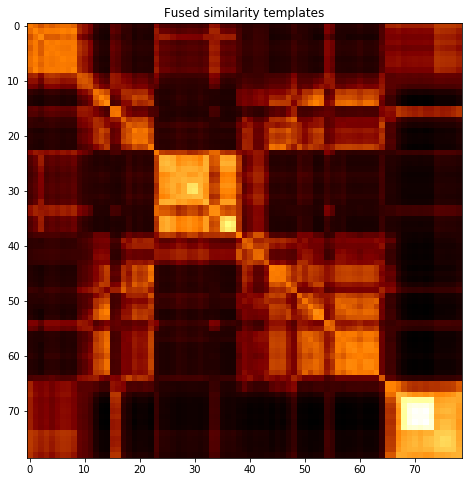

subject 30; gesture 2_0_2


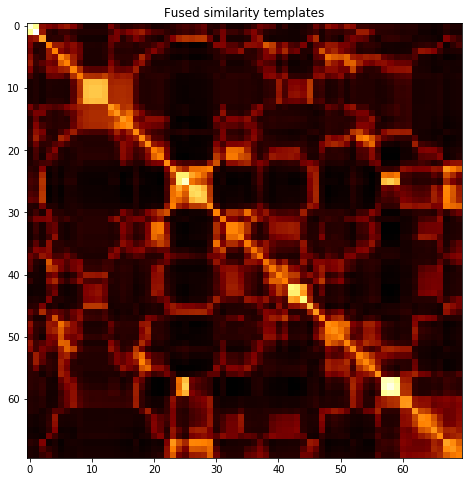

subject 30; gesture 1_1_2


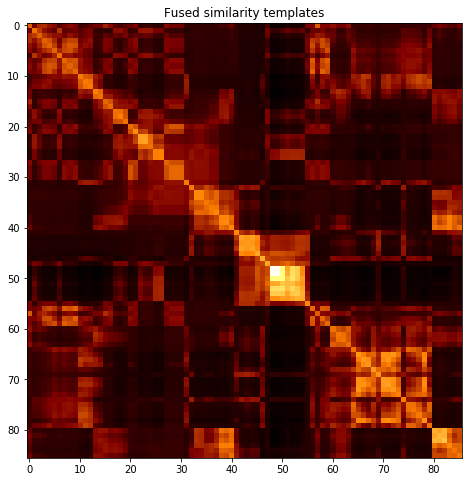

subject 30; gesture 2_1_2


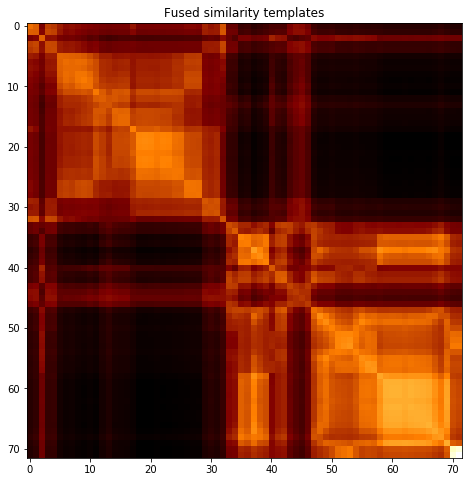

subject 30; gesture 4_0_1


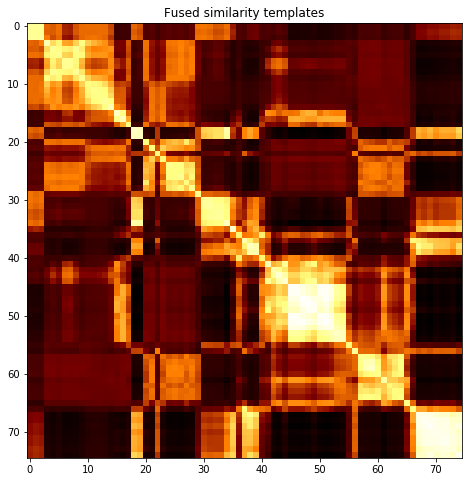

subject 30; gesture 3_0_2


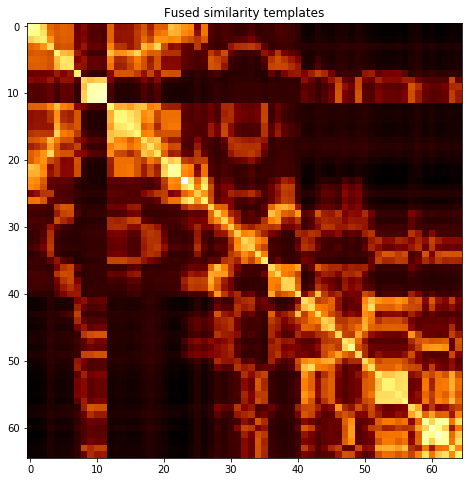

subject 30; gesture 1_1_1


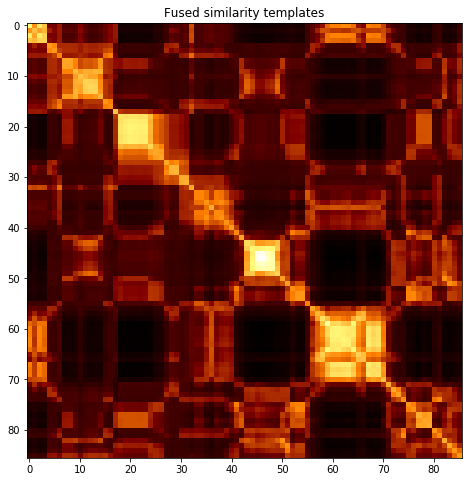

subject 30; gesture 3_1_2


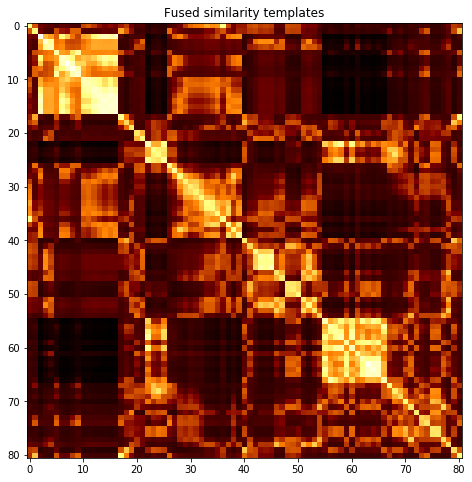

subject 30; gesture 2_1_1


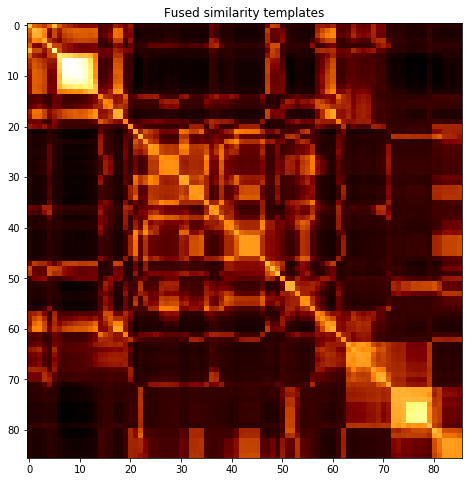

subject 30; gesture 1_0_1


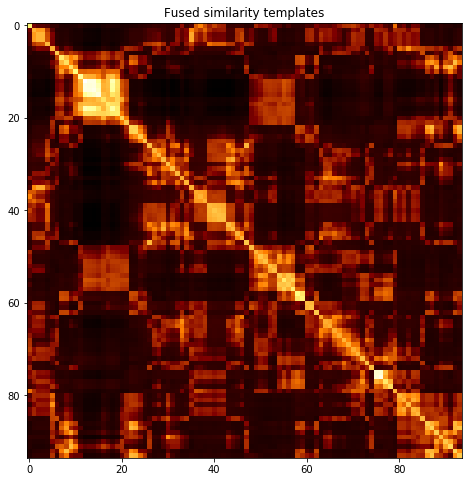

subject 30; gesture 3_1_1


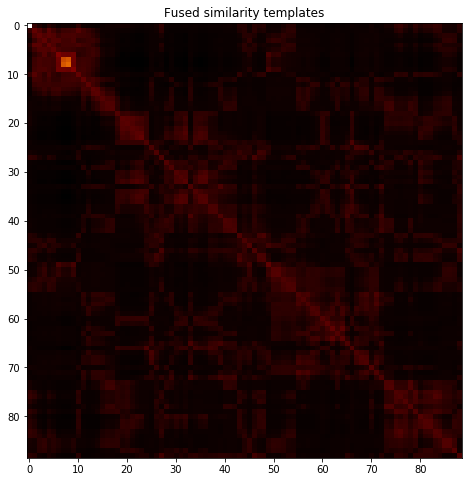

subject 30; gesture 1_0_2


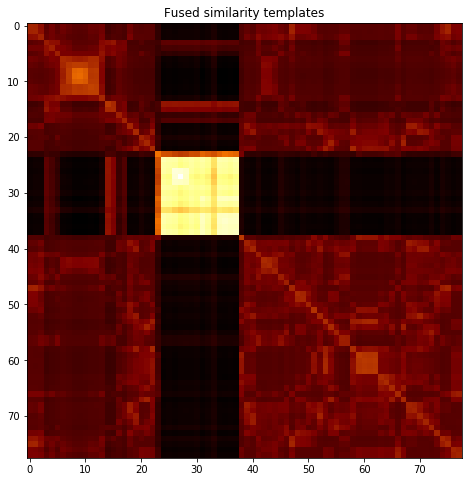

subject 30; gesture 4_0_2


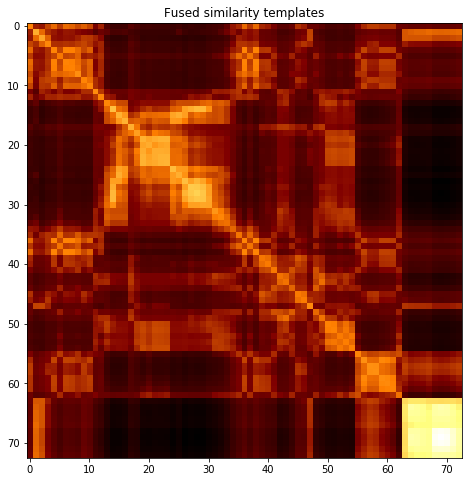

subject 06; gesture 3_0_1


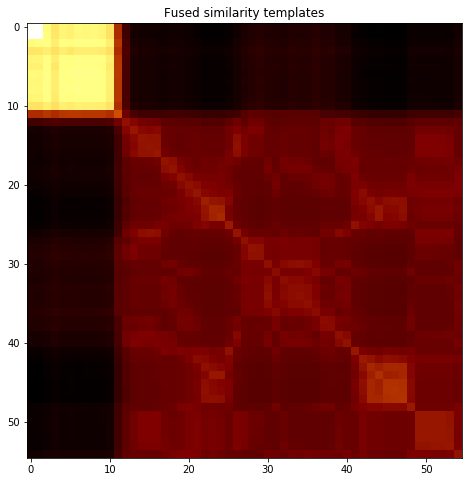

subject 06; gesture 4_1_1


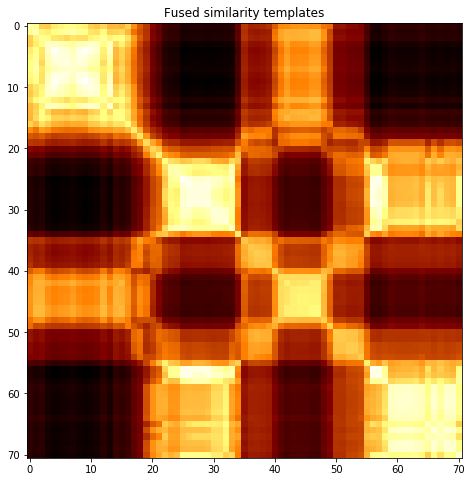

subject 06; gesture 2_0_1


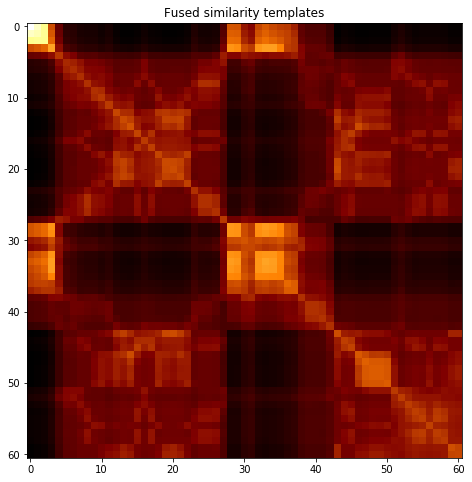

subject 06; gesture 4_1_2


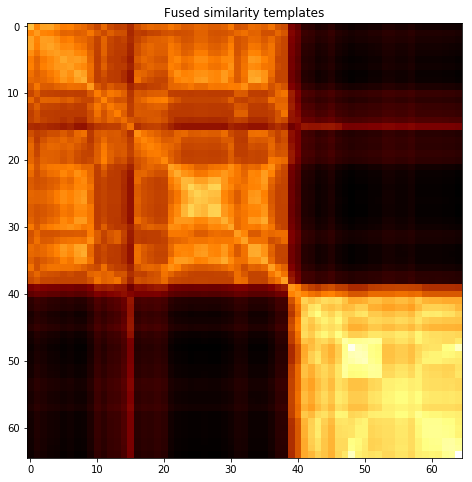

subject 06; gesture 2_0_2


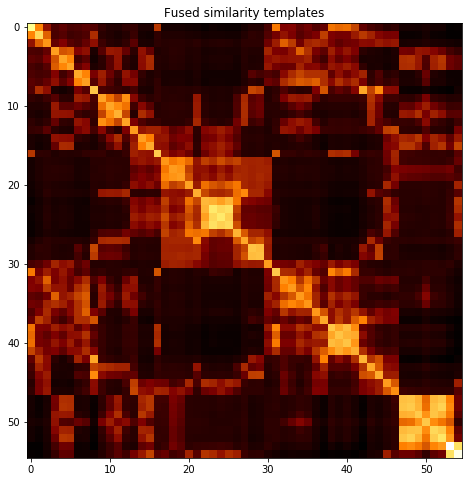

subject 06; gesture 1_1_2


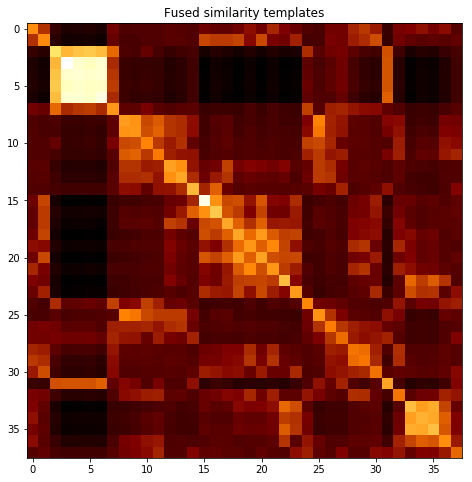

subject 06; gesture 2_1_2


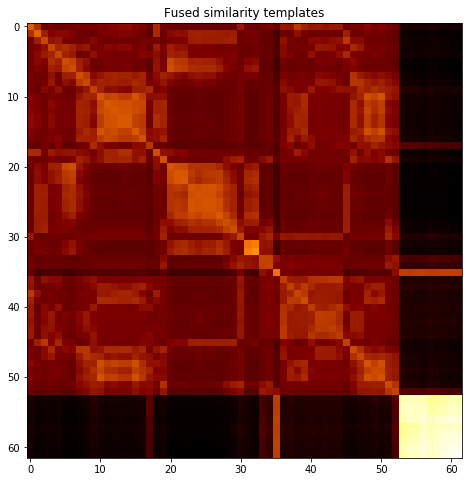

subject 06; gesture 4_0_1


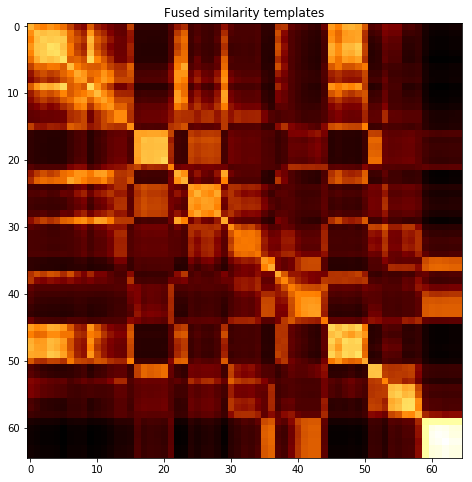

subject 06; gesture 3_0_2


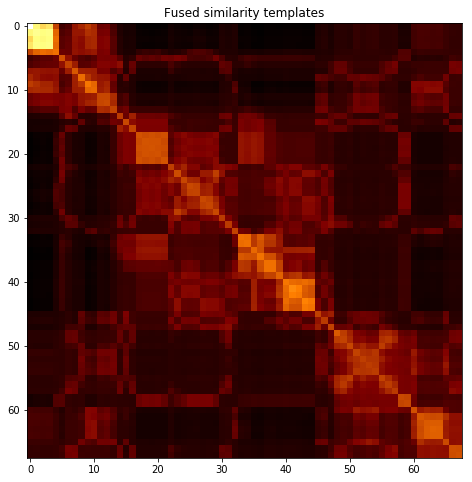

subject 06; gesture 1_1_1


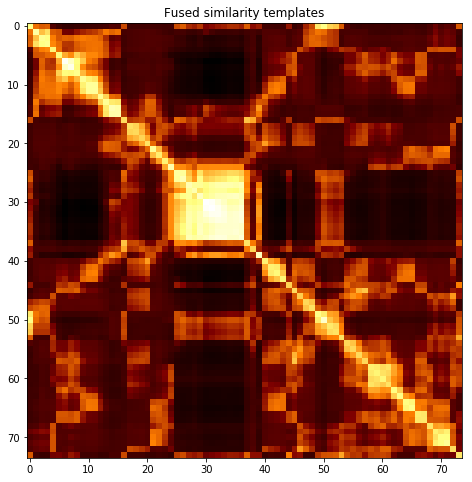

subject 06; gesture 3_1_2


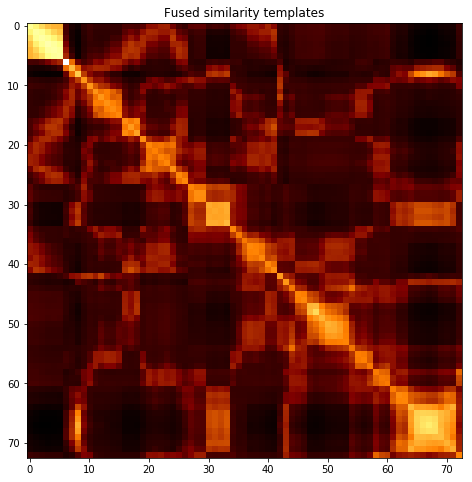

subject 06; gesture 2_1_1


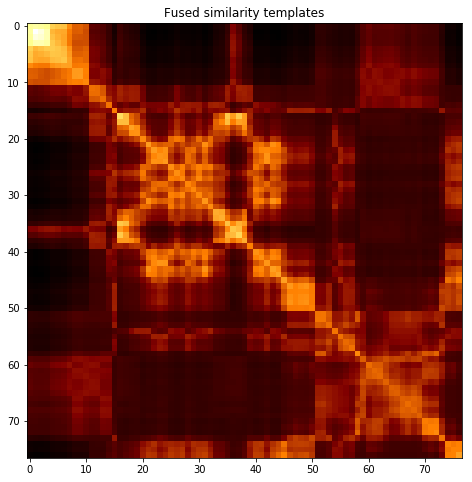

subject 06; gesture 1_0_1


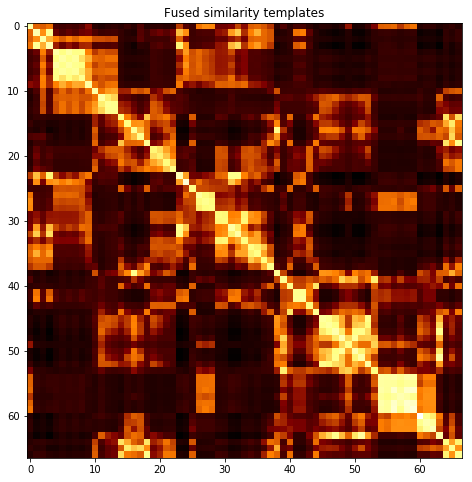

subject 06; gesture 3_1_1


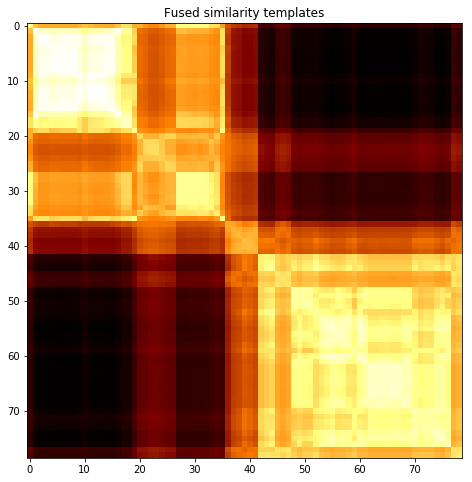

subject 06; gesture 1_0_2


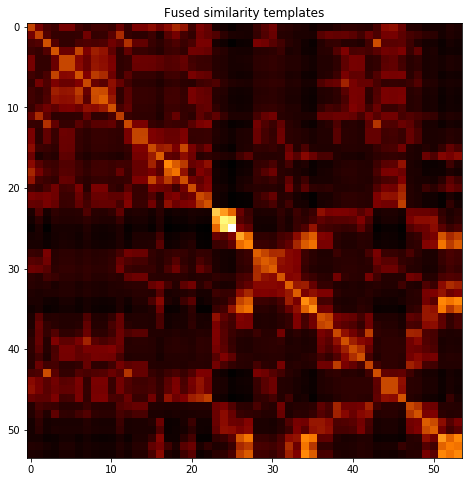

subject 06; gesture 4_0_2


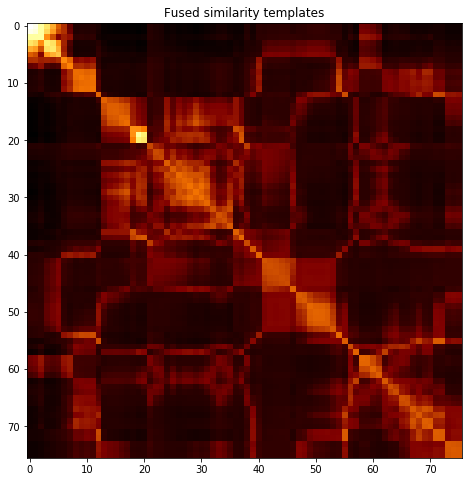

subject 09; gesture 3_0_1


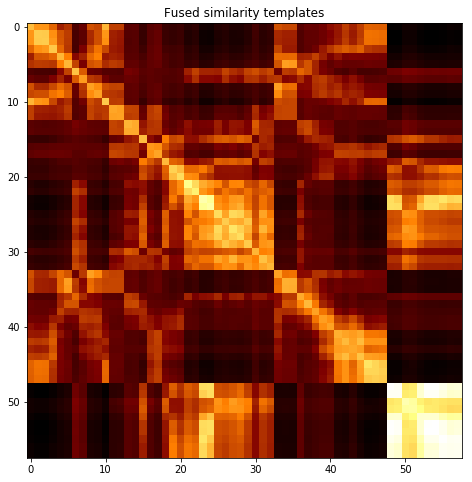

subject 09; gesture 4_1_1


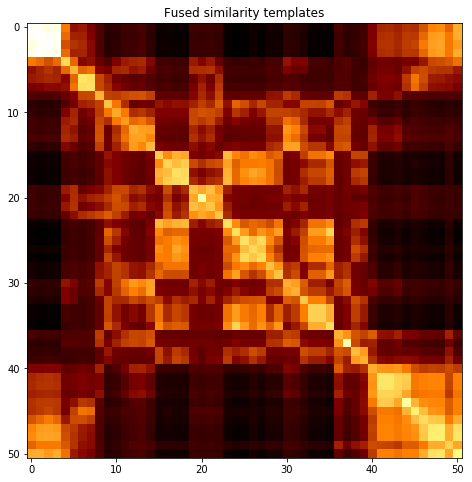

subject 09; gesture 2_0_1


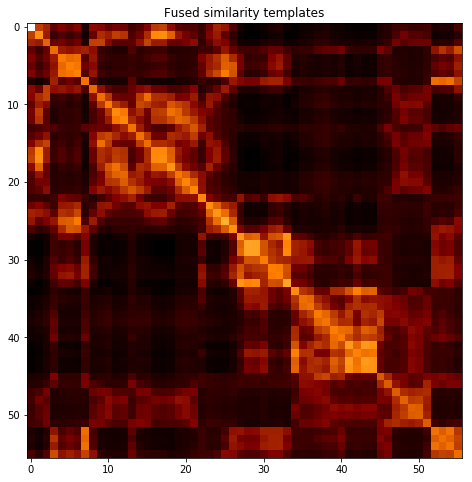

subject 09; gesture 4_1_2


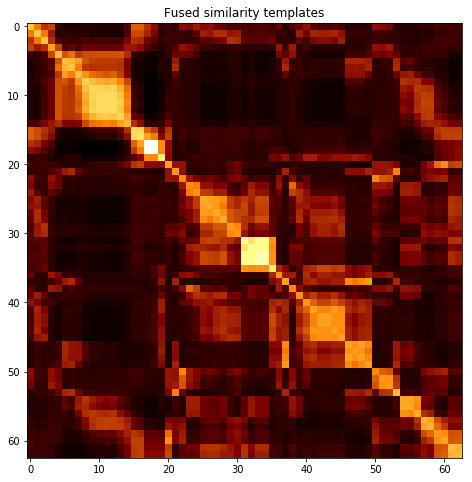

subject 09; gesture 2_0_2


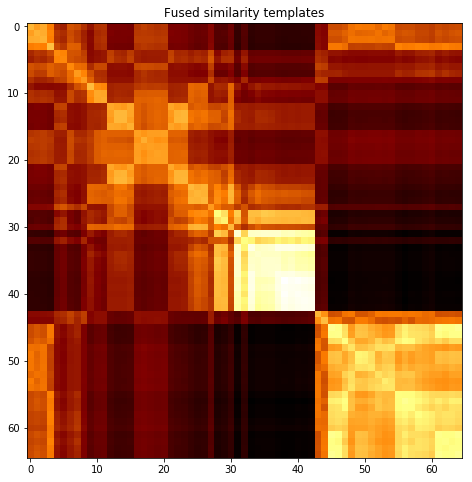

subject 09; gesture 1_1_2


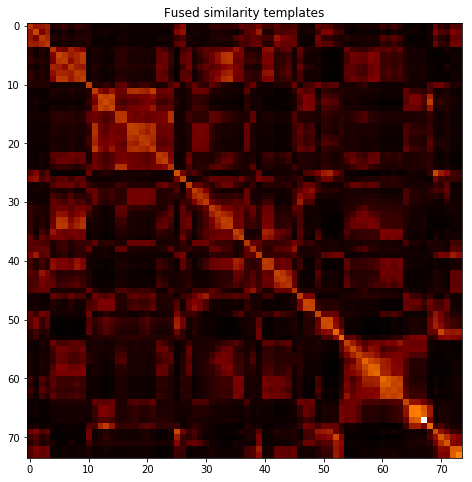

subject 09; gesture 2_1_2


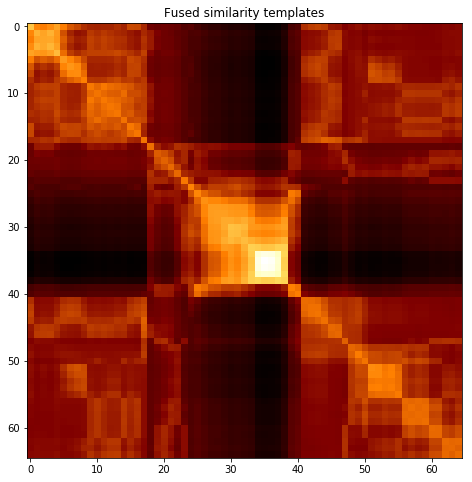

subject 09; gesture 4_0_1


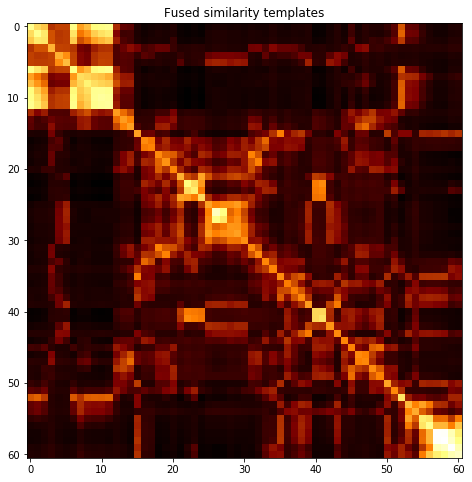

subject 09; gesture 3_0_2


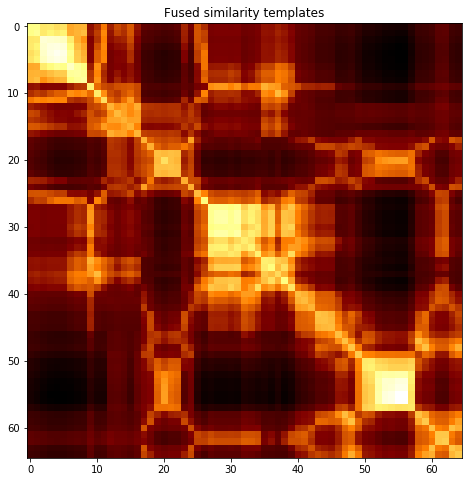

subject 09; gesture 1_1_1


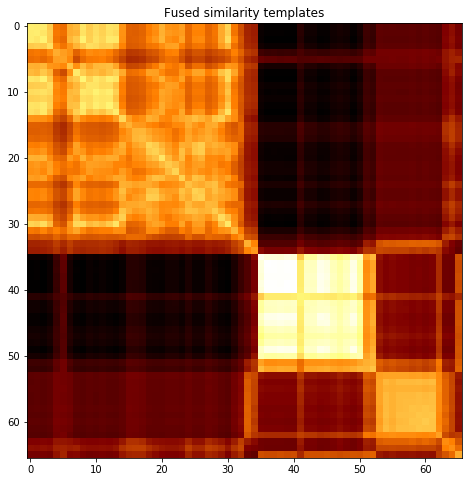

subject 09; gesture 3_1_2


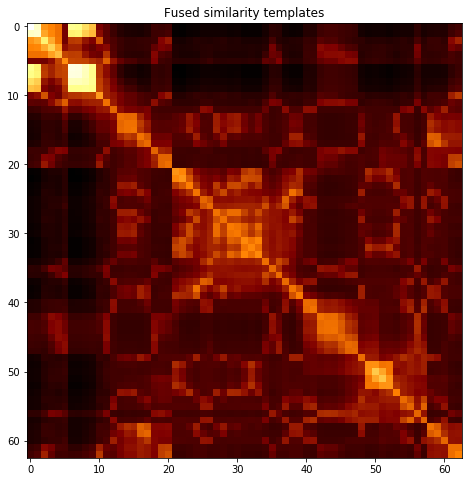

subject 09; gesture 2_1_1


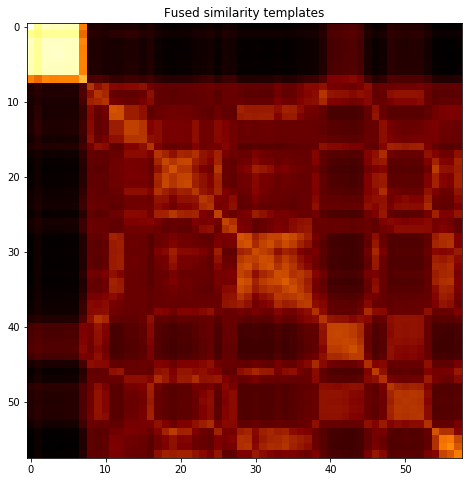

subject 09; gesture 1_0_1


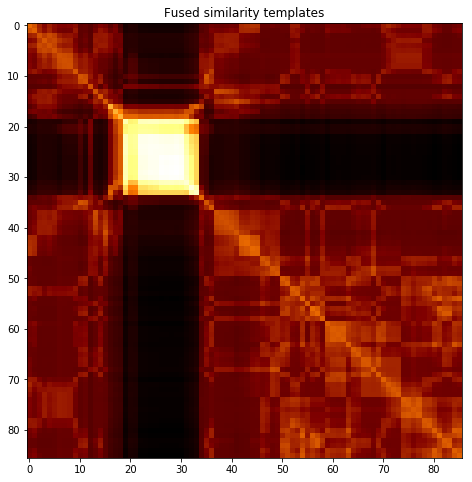

subject 09; gesture 3_1_1


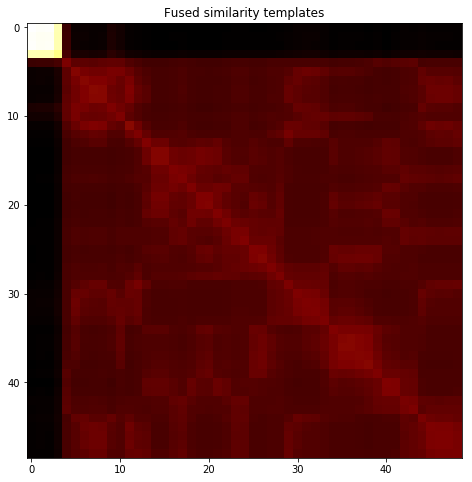

subject 09; gesture 1_0_2


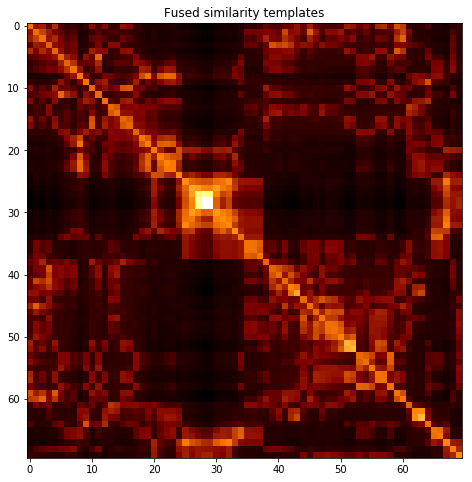

subject 09; gesture 4_0_2


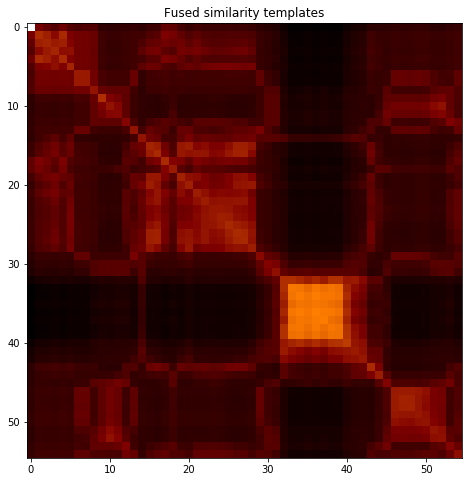

subject 03; gesture 3_0_1


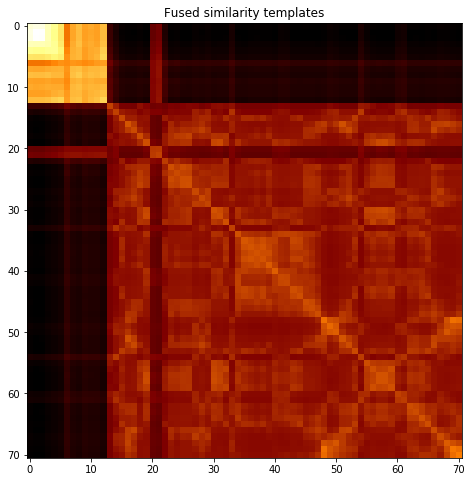

subject 03; gesture 4_1_1


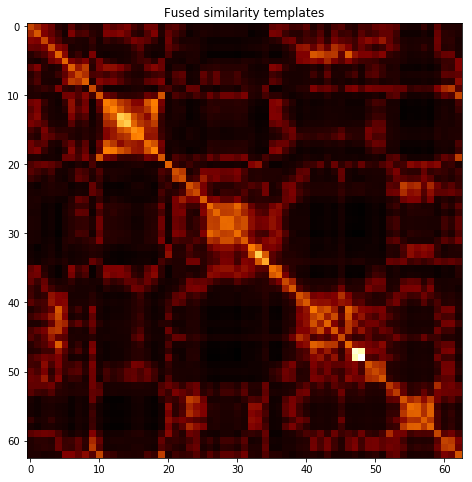

subject 03; gesture 2_0_1


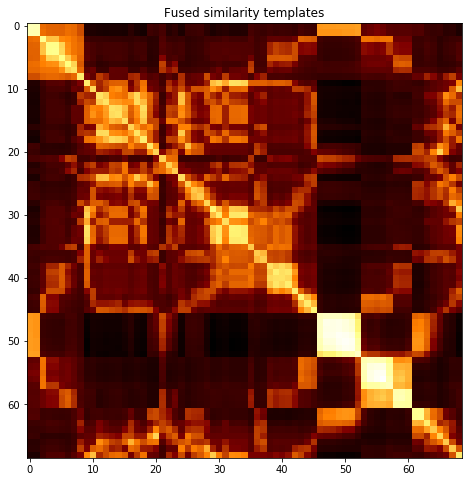

subject 03; gesture 4_1_2


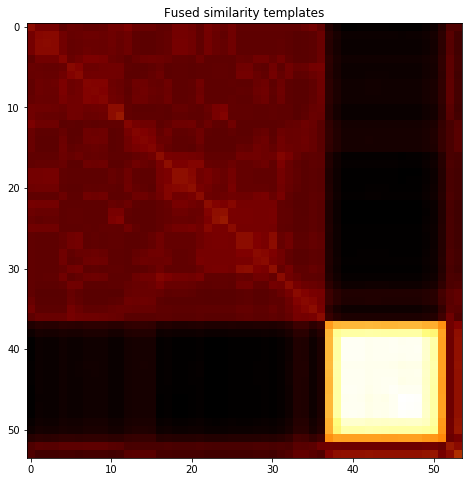

subject 03; gesture 2_0_2


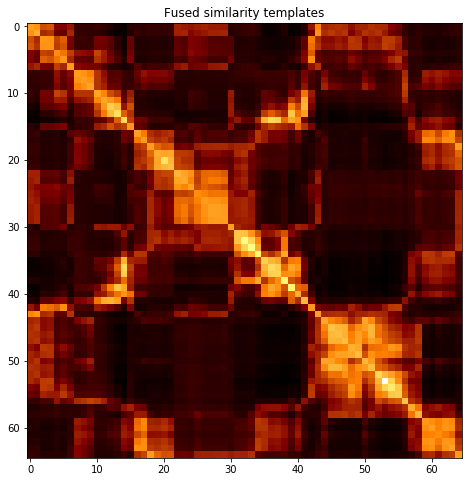

subject 03; gesture 1_1_2


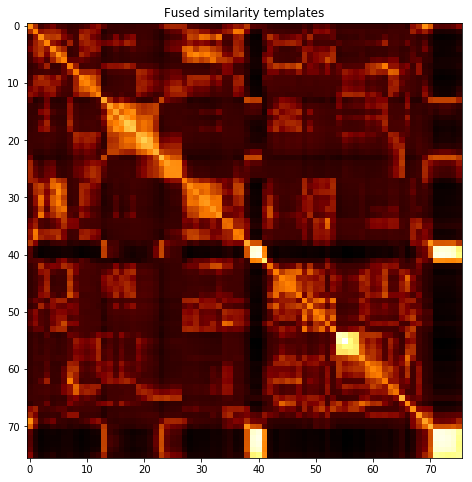

subject 03; gesture 2_1_2


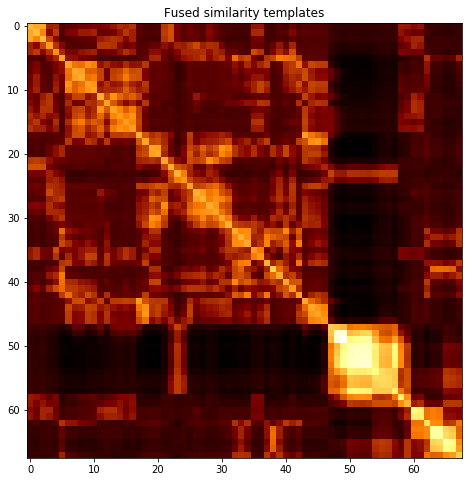

subject 03; gesture 4_0_1


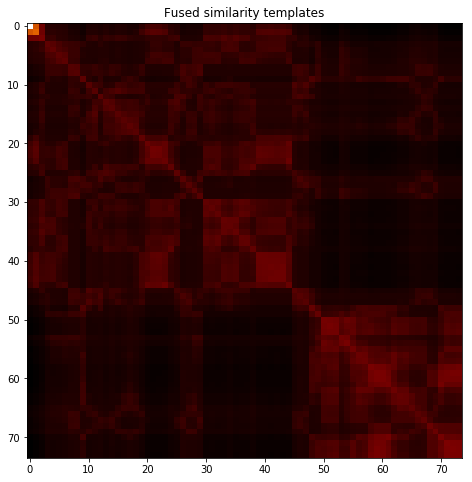

subject 03; gesture 3_0_2


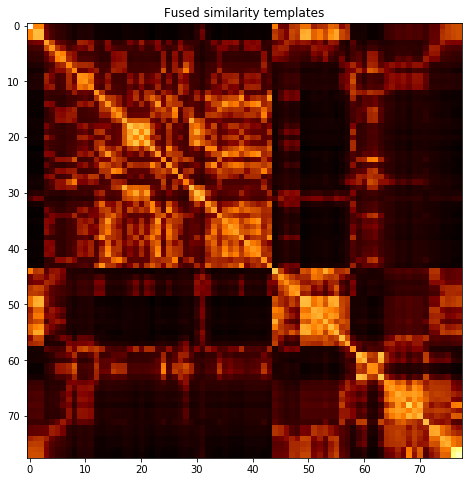

subject 03; gesture 1_1_1


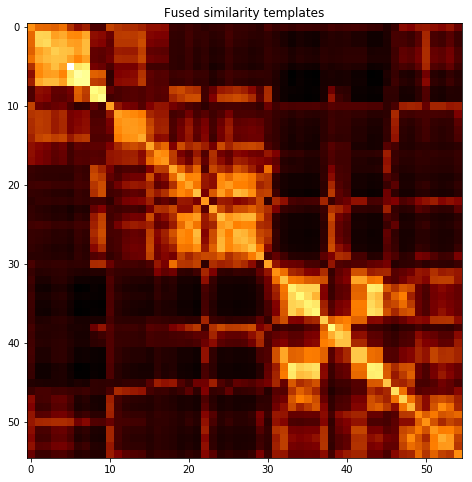

subject 03; gesture 3_1_2


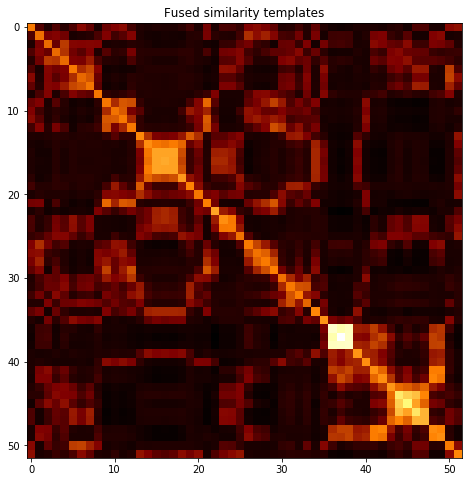

subject 03; gesture 2_1_1


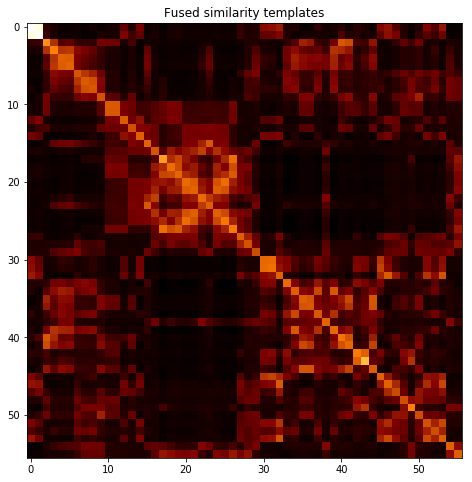

subject 03; gesture 1_0_1


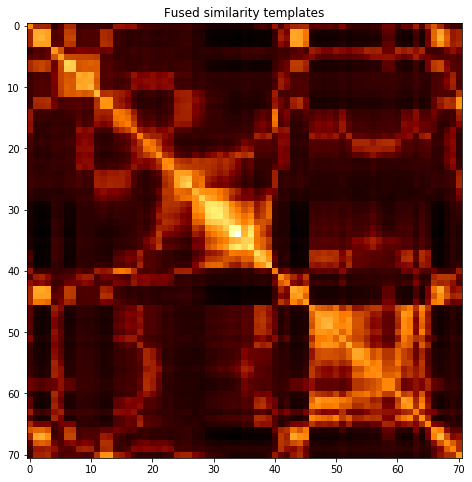

subject 03; gesture 3_1_1


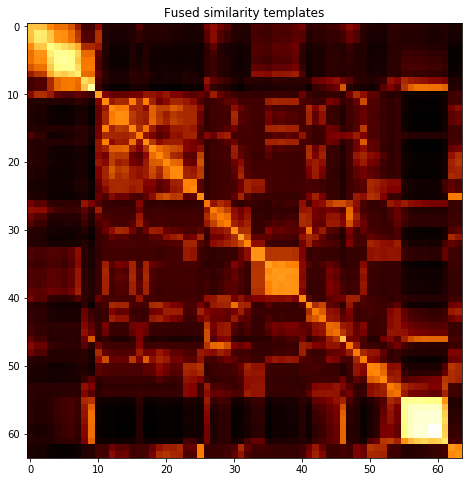

subject 03; gesture 1_0_2


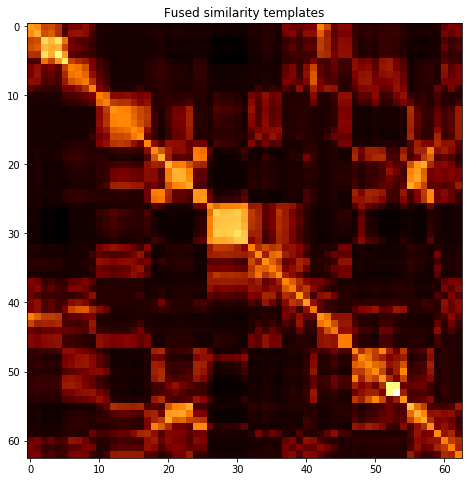

subject 03; gesture 4_0_2


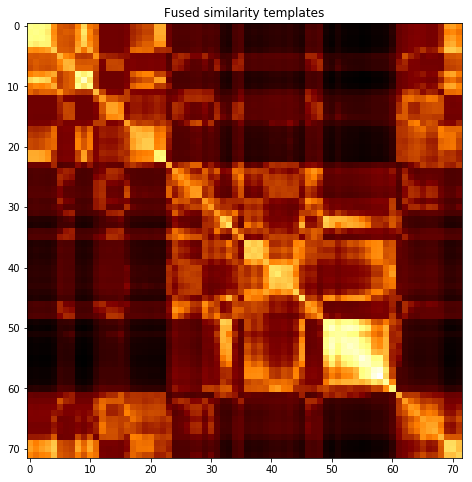

subject 05; gesture 3_0_1


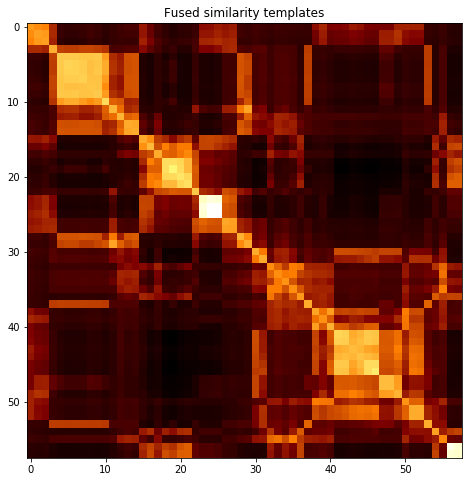

subject 05; gesture 4_1_1


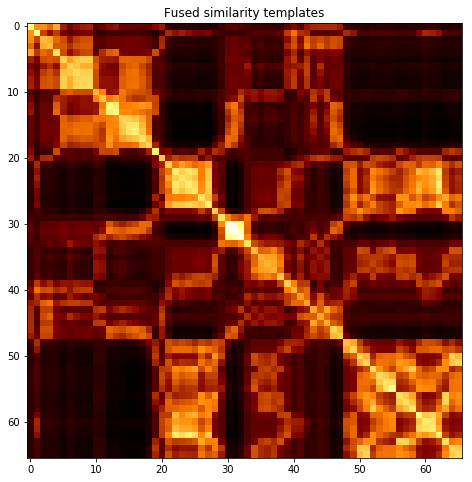

subject 05; gesture 2_0_1


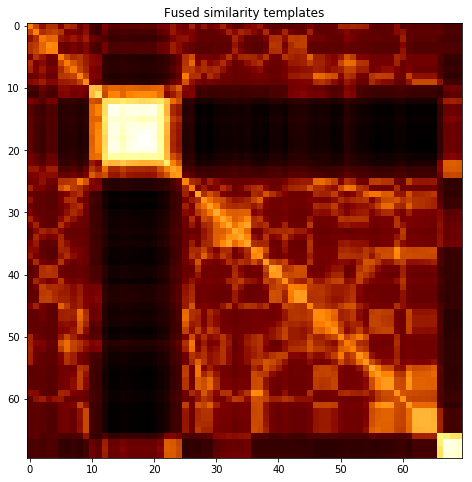

subject 05; gesture 4_1_2


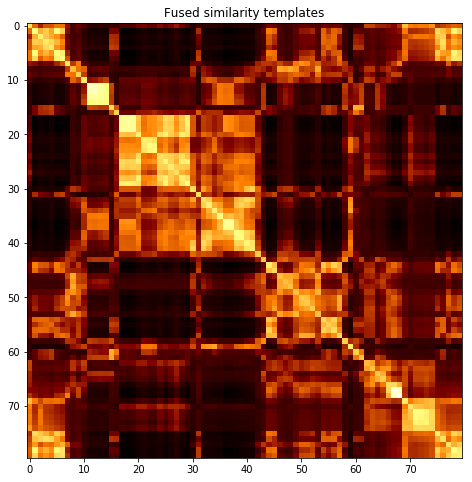

subject 05; gesture 2_0_2


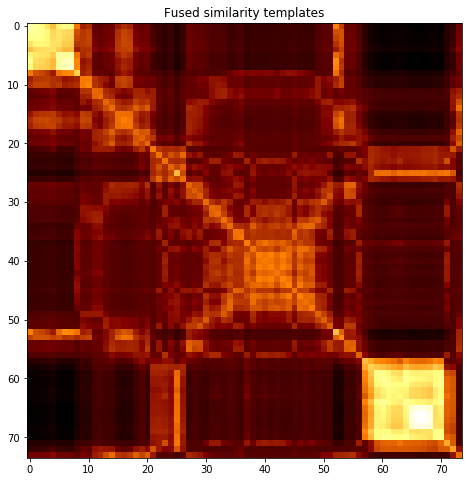

subject 05; gesture 1_1_2


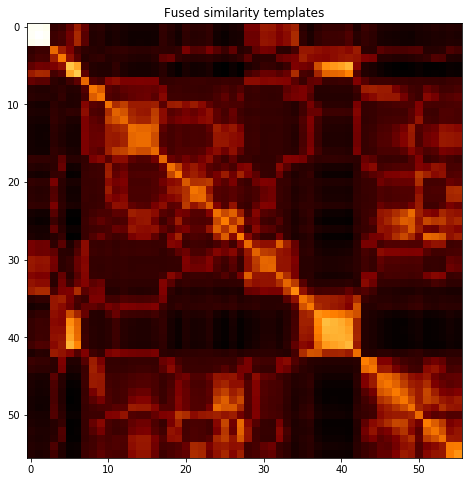

subject 05; gesture 2_1_2


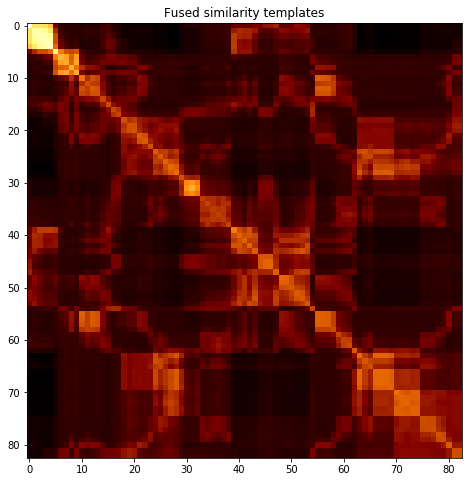

subject 05; gesture 4_0_1


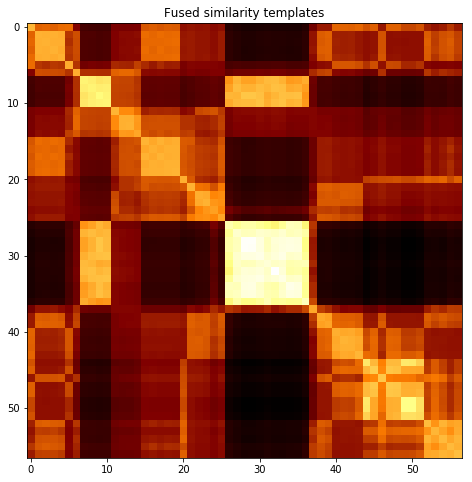

subject 05; gesture 3_0_2


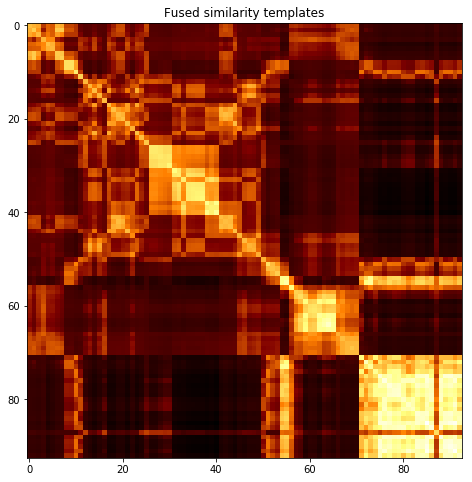

subject 05; gesture 1_1_1


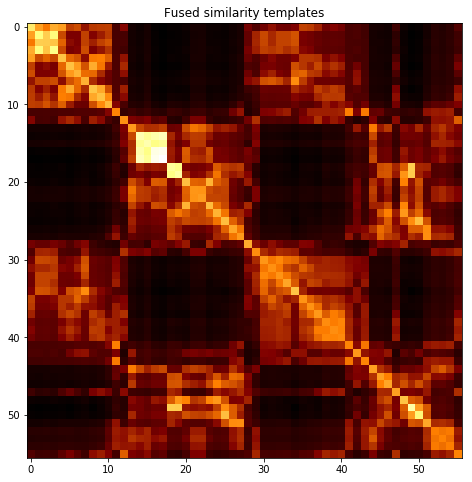

subject 05; gesture 3_1_2


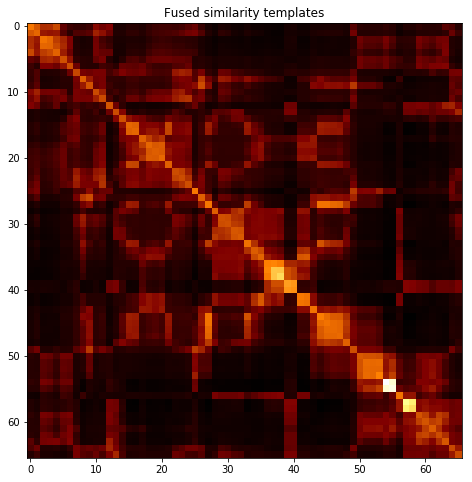

subject 05; gesture 2_1_1


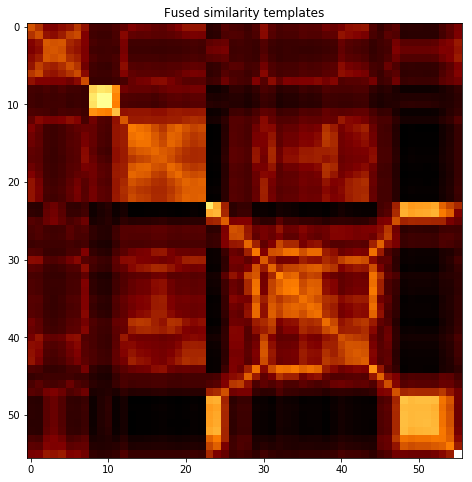

subject 05; gesture 1_0_1


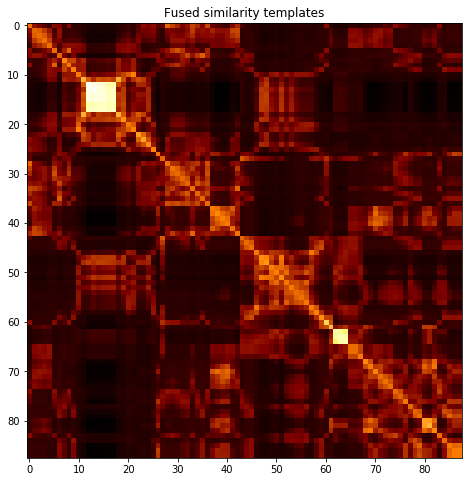

subject 05; gesture 3_1_1


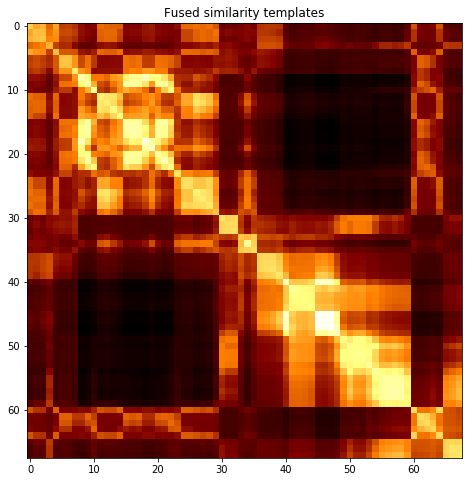

subject 05; gesture 1_0_2


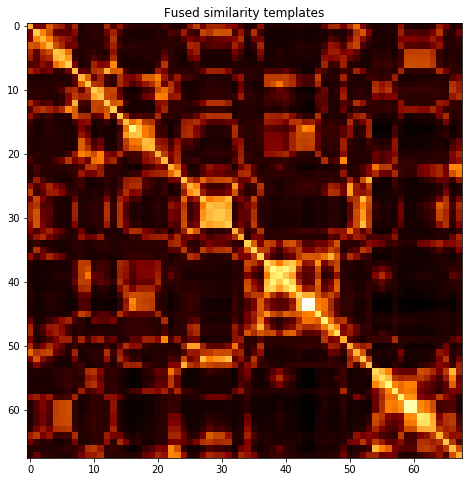

subject 05; gesture 4_0_2


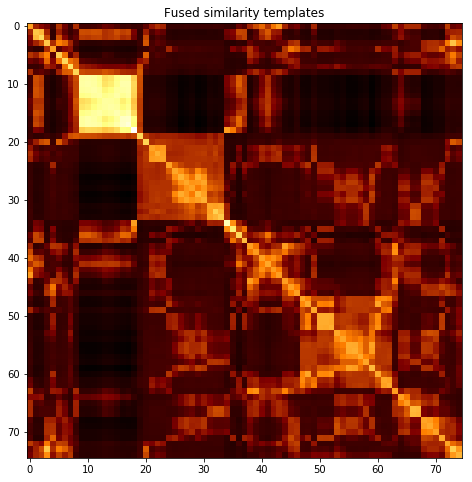

subject 21; gesture 3_0_1


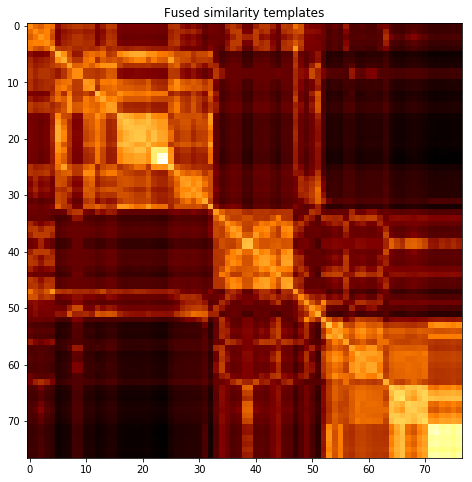

subject 21; gesture 4_1_1


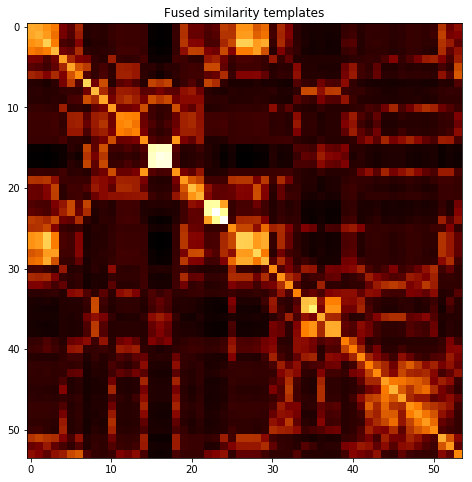

subject 21; gesture 2_0_1


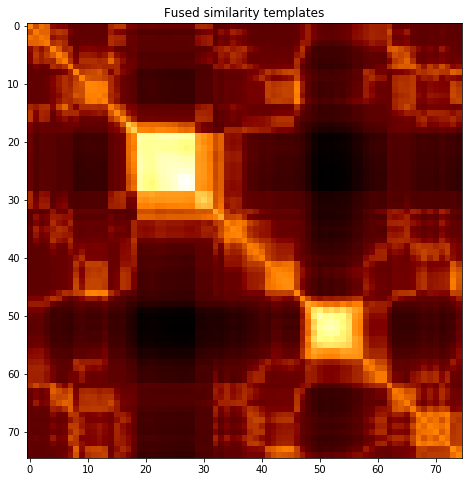

subject 21; gesture 4_1_2


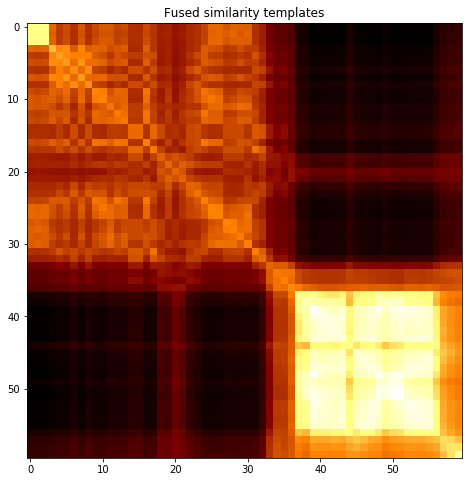

subject 21; gesture 2_0_2


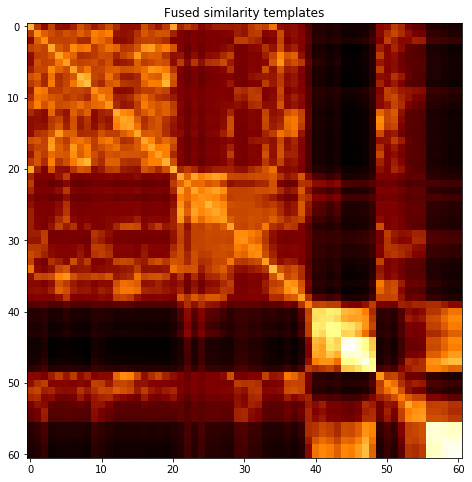

subject 21; gesture 1_1_2


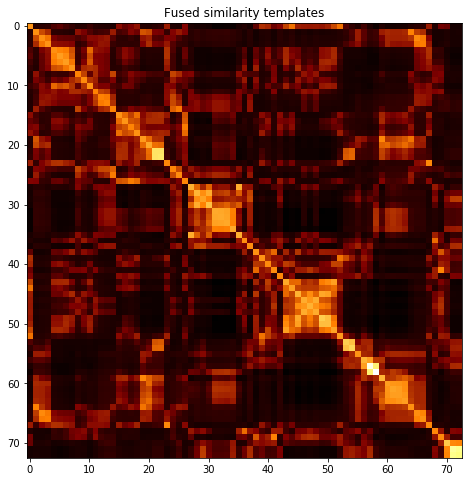

subject 21; gesture 2_1_2


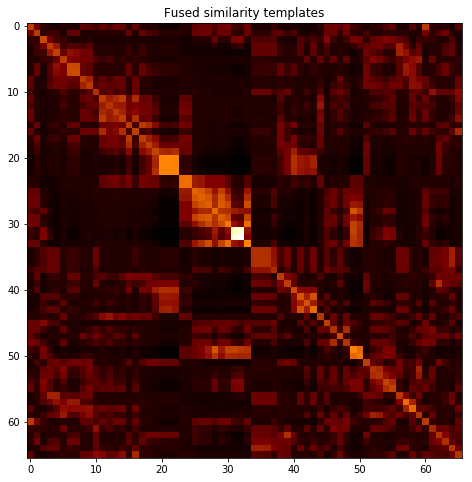

subject 21; gesture 4_0_1


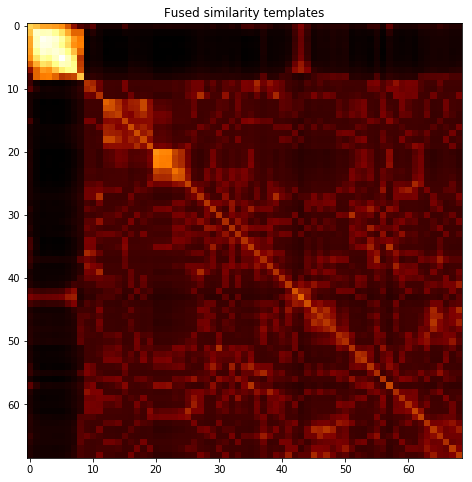

subject 21; gesture 3_0_2


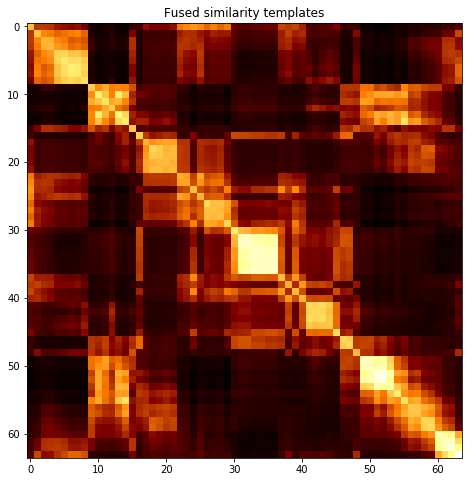

subject 21; gesture 1_1_1


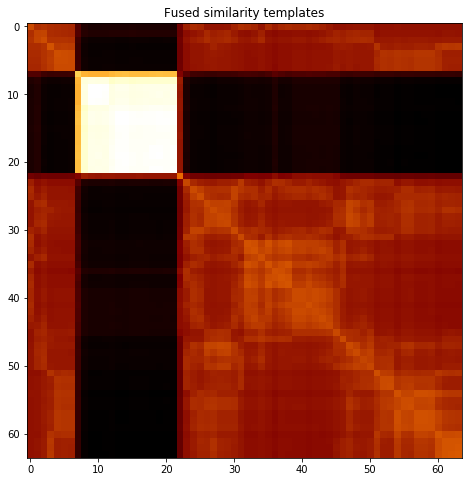

subject 21; gesture 3_1_2


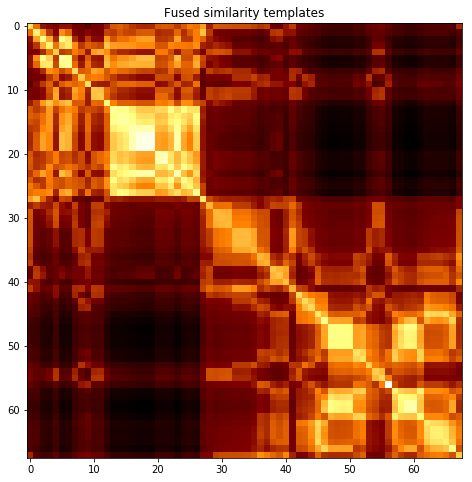

subject 21; gesture 2_1_1


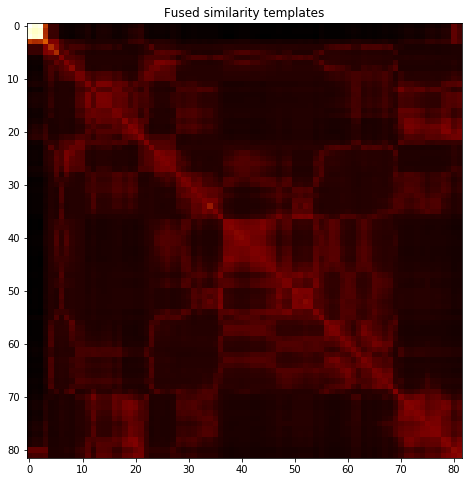

subject 21; gesture 1_0_1


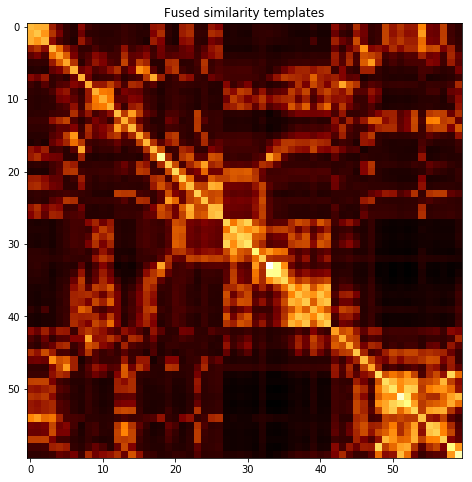

subject 21; gesture 3_1_1


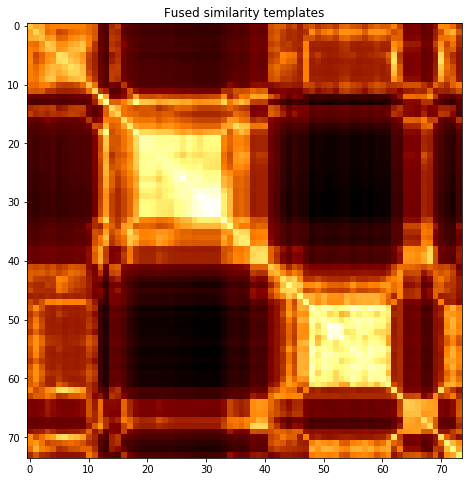

subject 21; gesture 1_0_2


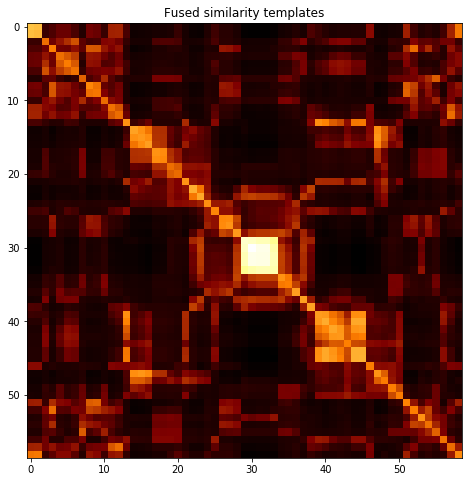

subject 21; gesture 4_0_2


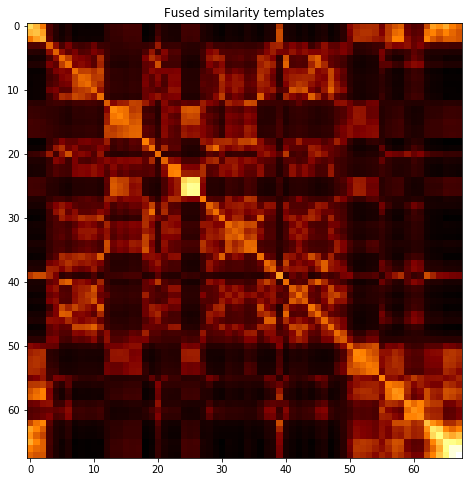

subject 17; gesture 3_0_1


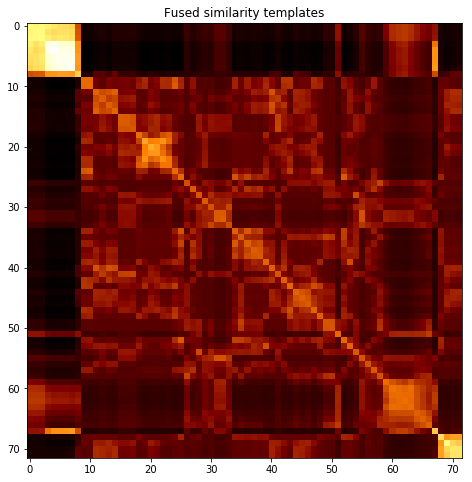

subject 17; gesture 4_1_1


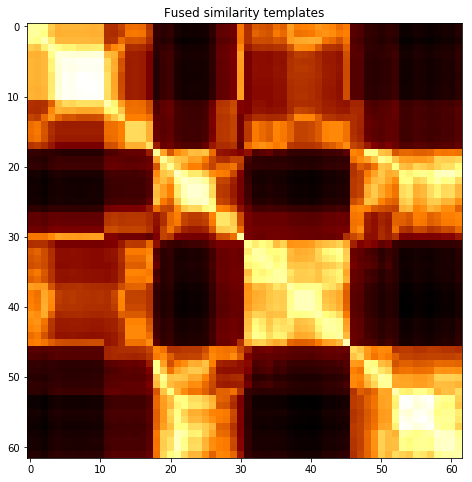

subject 17; gesture 2_0_1


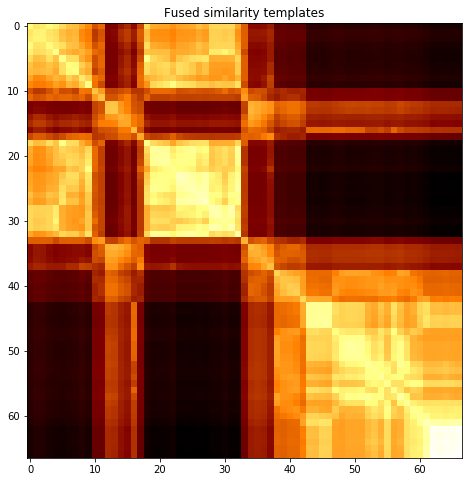

subject 17; gesture 4_1_2


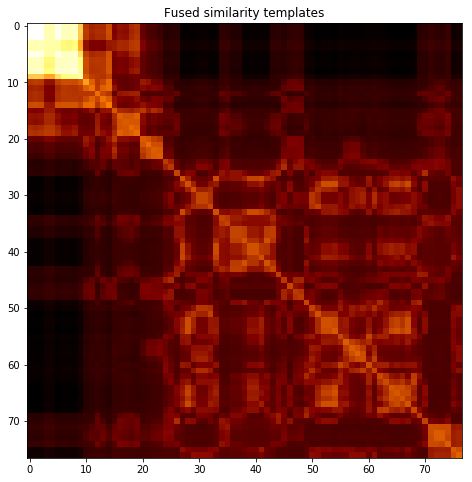

subject 17; gesture 2_0_2


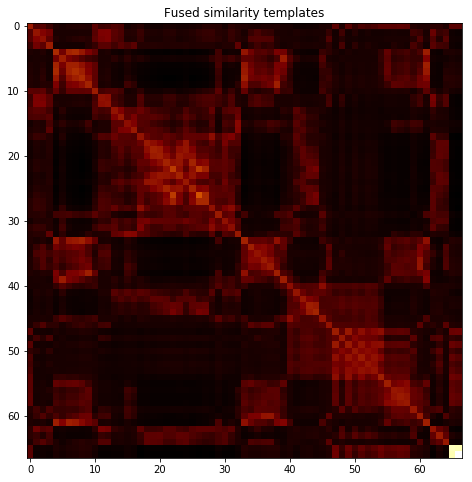

subject 17; gesture 1_1_2


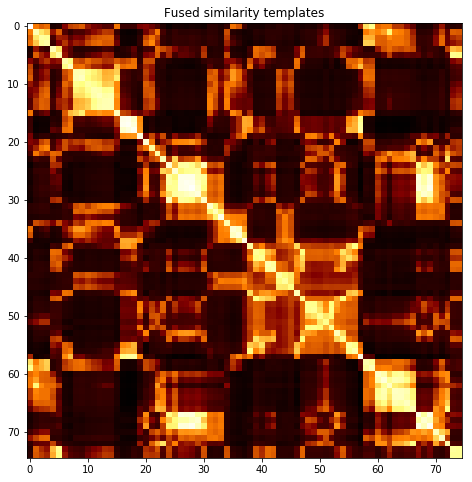

subject 17; gesture 2_1_2


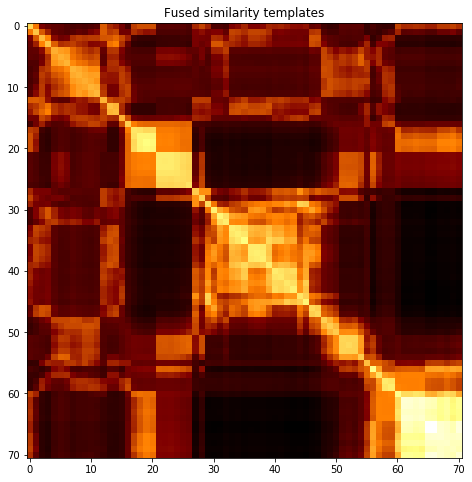

subject 17; gesture 4_0_1


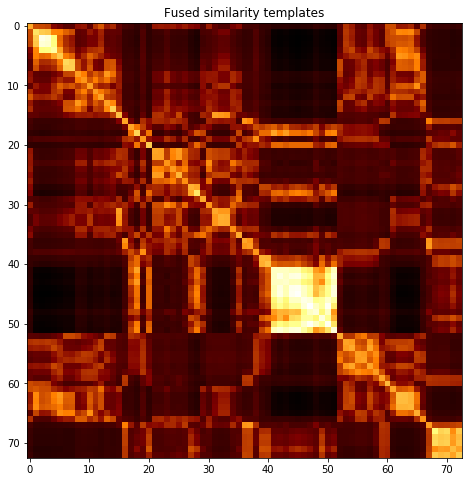

subject 17; gesture 3_0_2


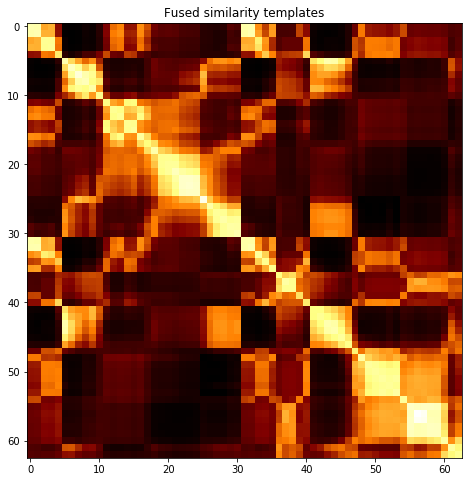

subject 17; gesture 1_1_1


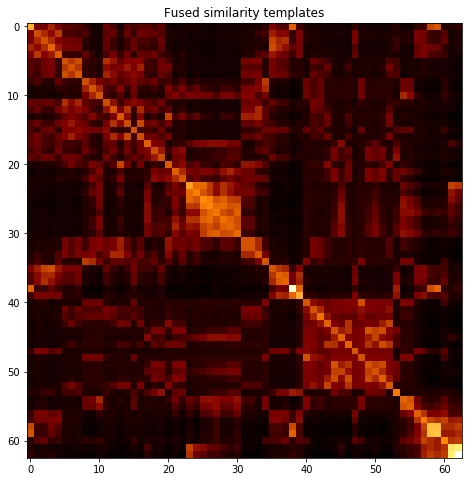

subject 17; gesture 3_1_2


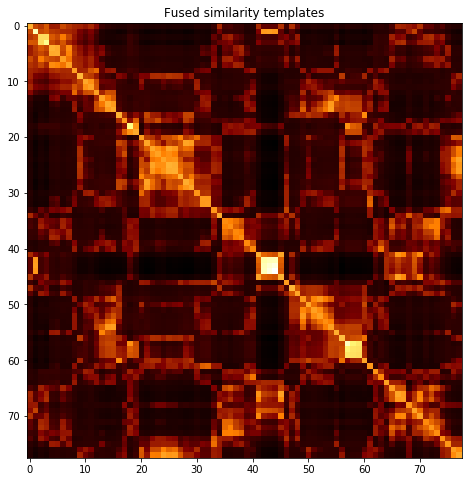

subject 17; gesture 2_1_1


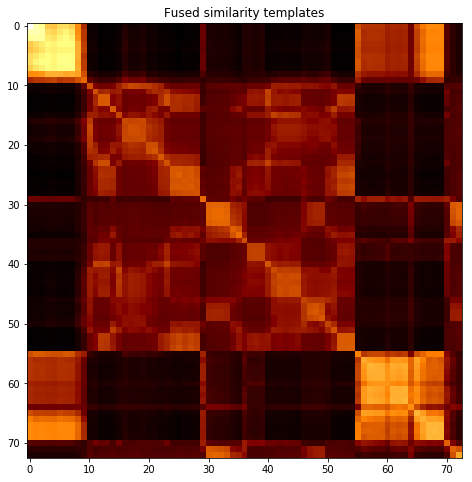

subject 17; gesture 1_0_1


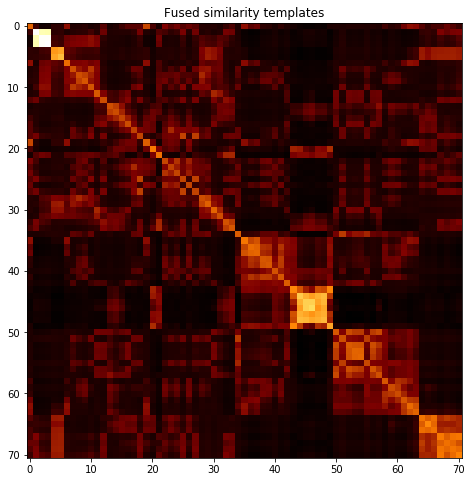

subject 17; gesture 3_1_1


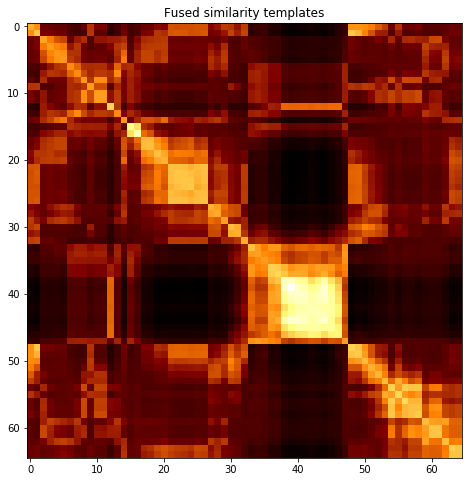

subject 17; gesture 1_0_2


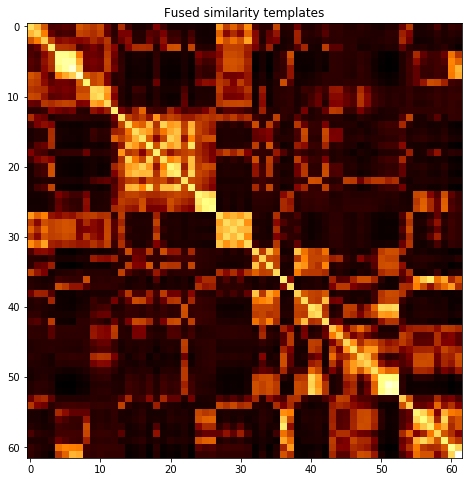

subject 17; gesture 4_0_2


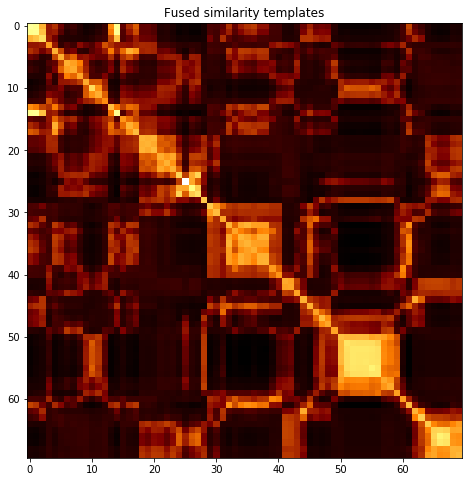

subject 01; gesture 3_0_1


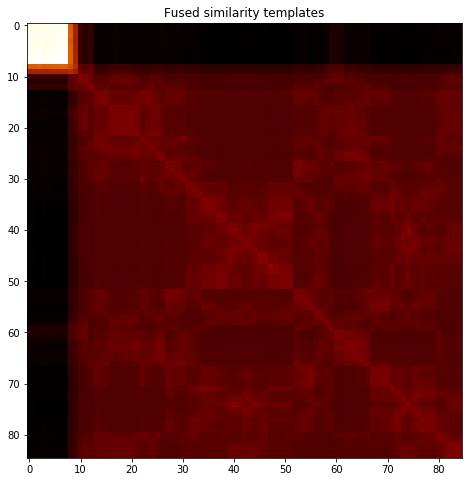

subject 01; gesture 4_1_1


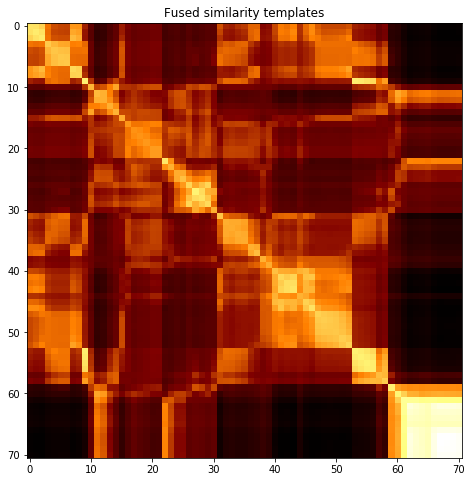

subject 01; gesture 2_0_1


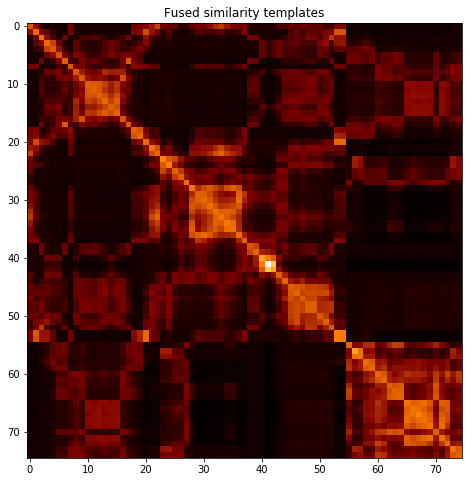

subject 01; gesture 4_1_2


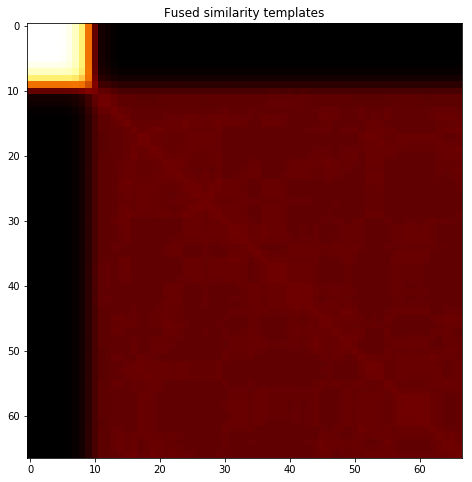

subject 01; gesture 2_0_2


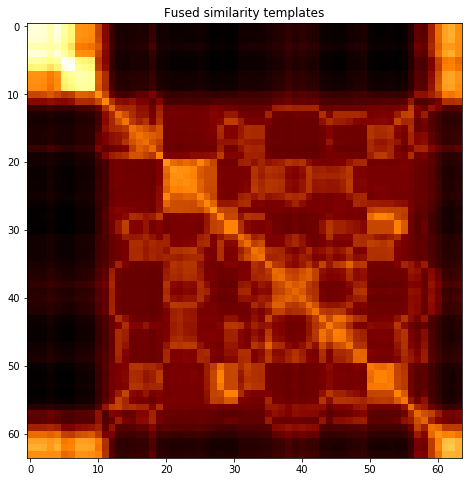

subject 01; gesture 1_1_2


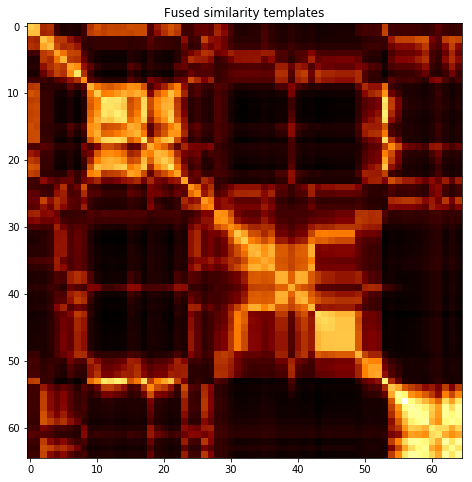

subject 01; gesture 2_1_2


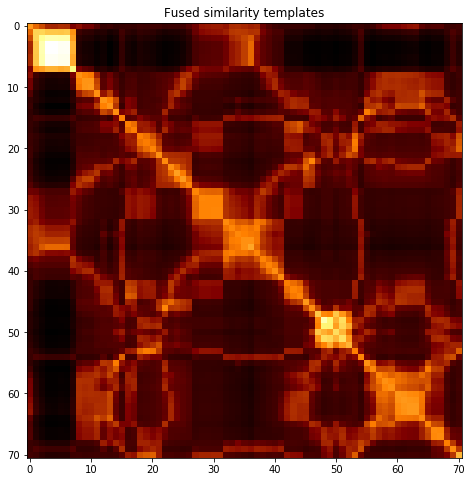

subject 01; gesture 4_0_1


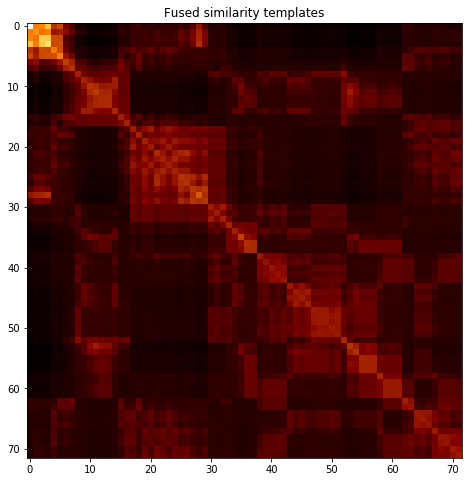

subject 01; gesture 3_0_2


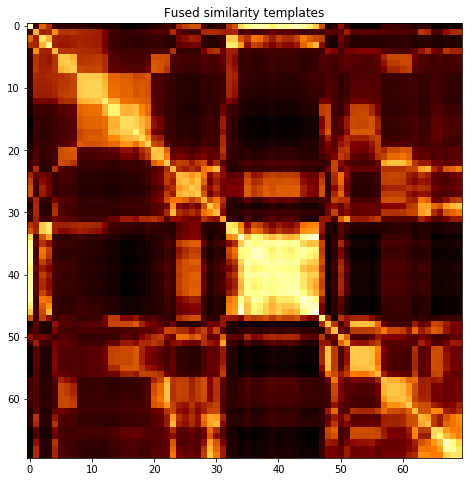

subject 01; gesture 1_1_1


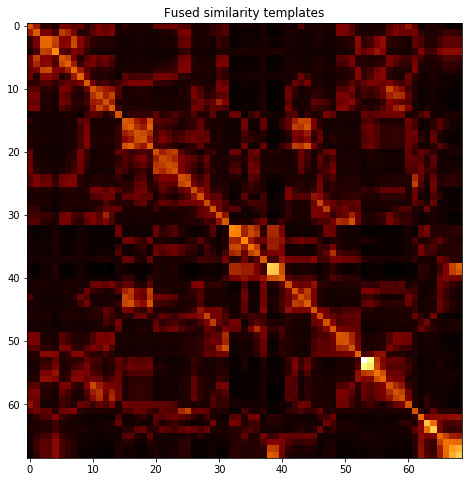

subject 01; gesture 3_1_2


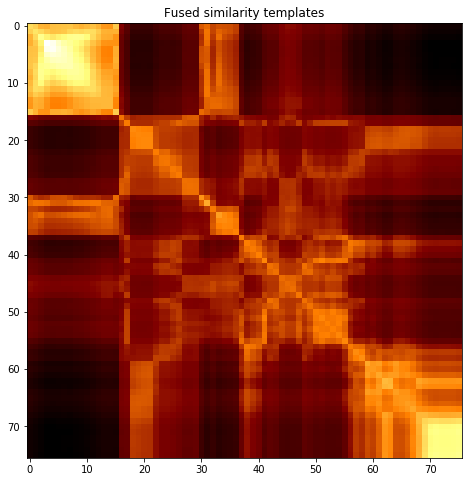

subject 01; gesture 2_1_1


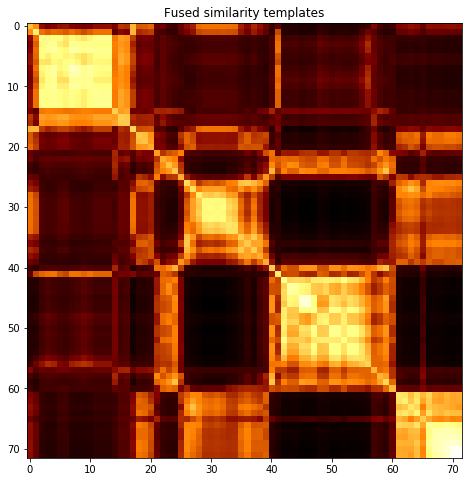

subject 01; gesture 1_0_1


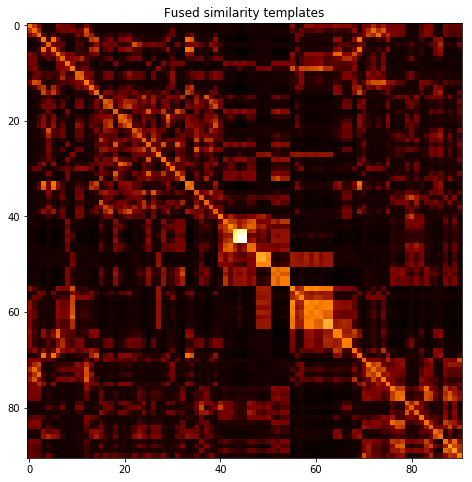

subject 01; gesture 3_1_1


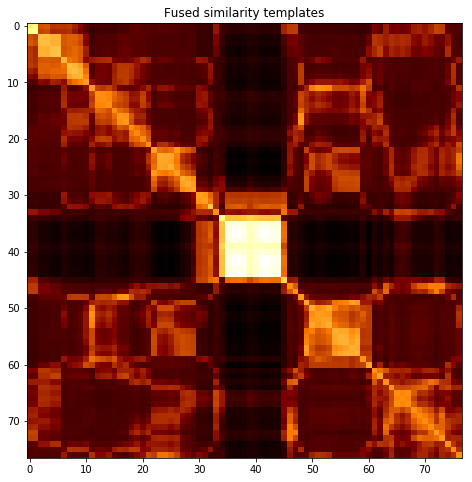

subject 01; gesture 1_0_2


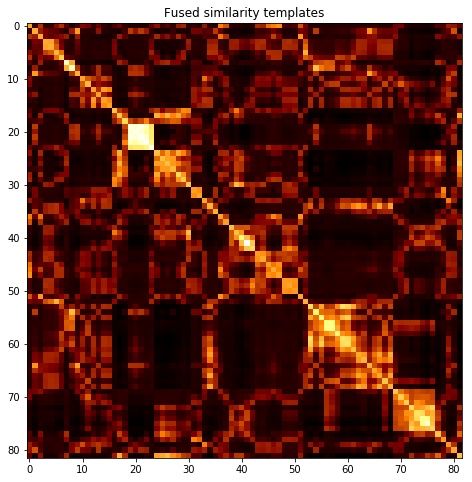

subject 01; gesture 4_0_2


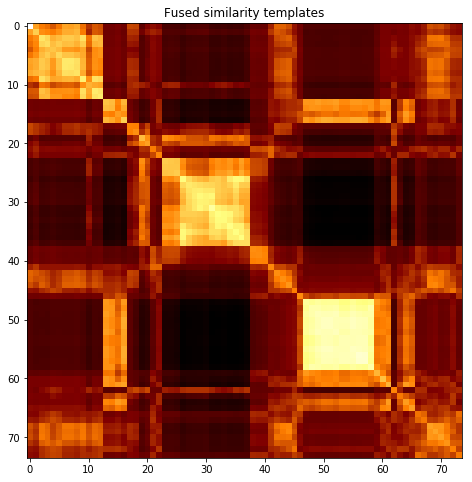

subject 16; gesture 3_0_1


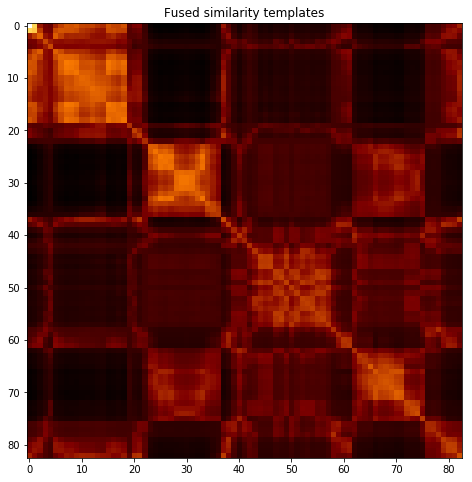

subject 16; gesture 4_1_1


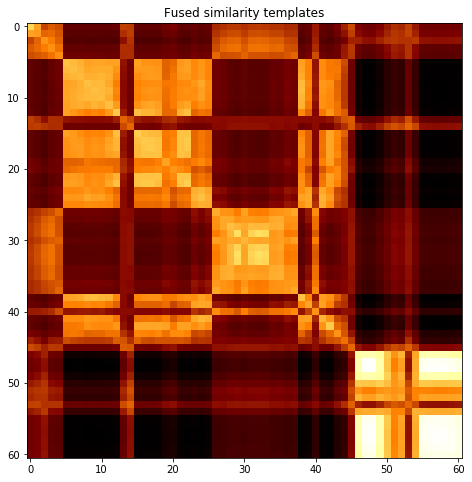

subject 16; gesture 2_0_1


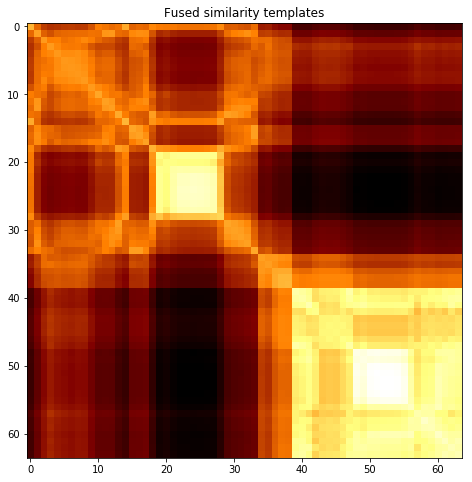

subject 16; gesture 4_1_2


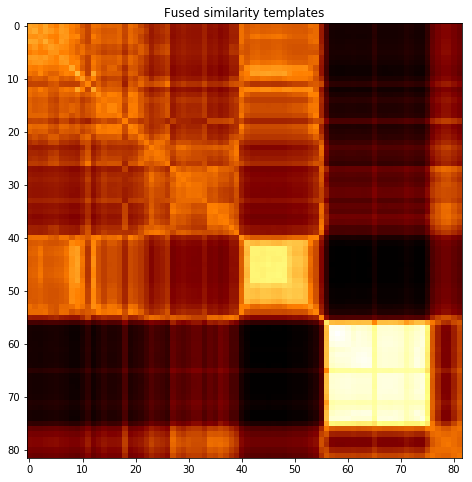

subject 16; gesture 2_0_2


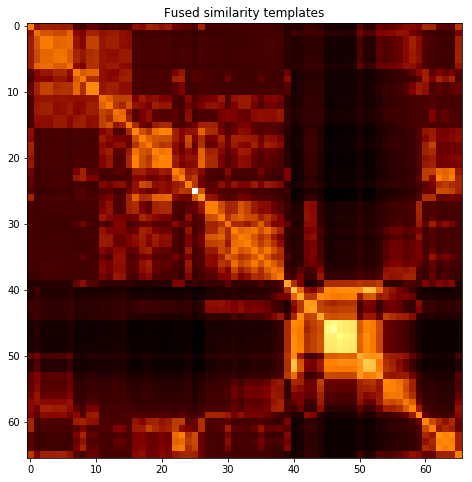

subject 16; gesture 1_1_2


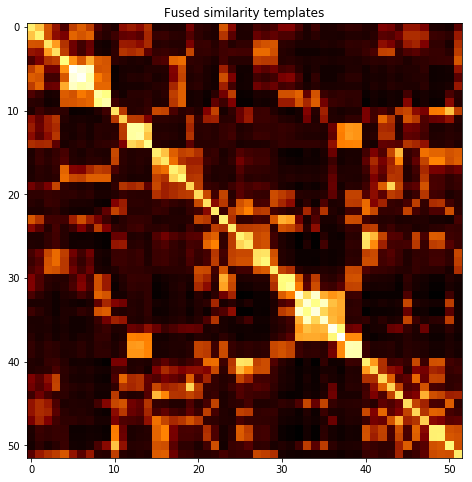

subject 16; gesture 2_1_2


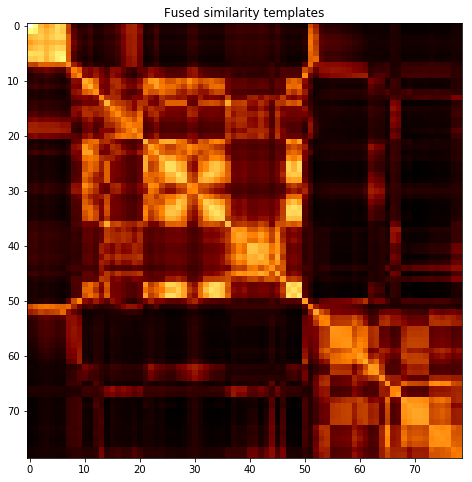

subject 16; gesture 4_0_1


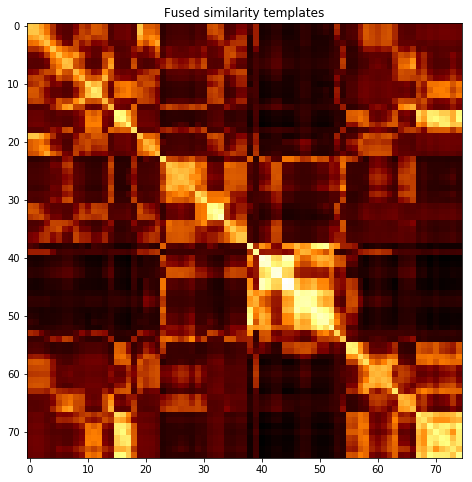

subject 16; gesture 3_0_2


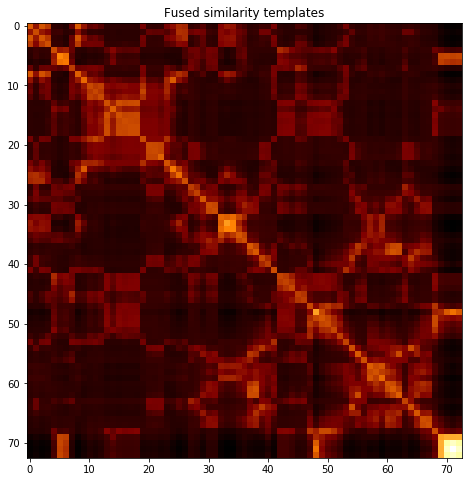

subject 16; gesture 1_1_1


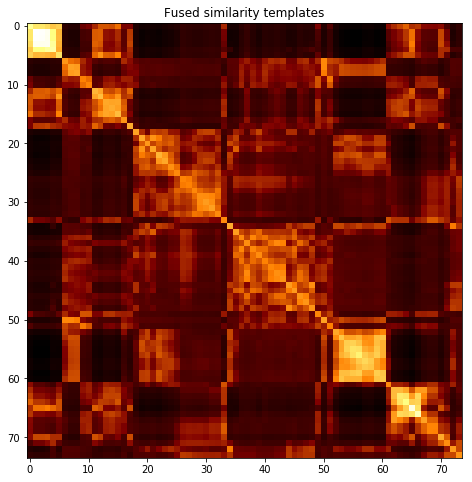

subject 16; gesture 3_1_2


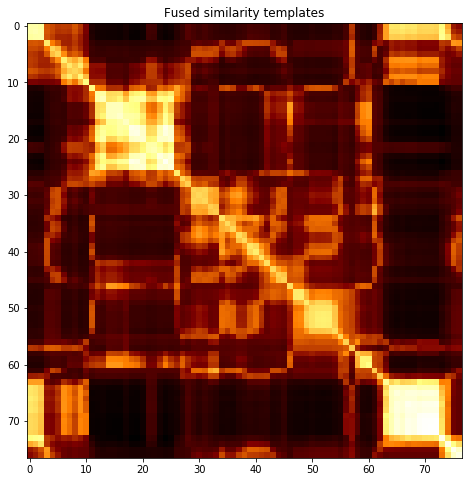

subject 16; gesture 2_1_1


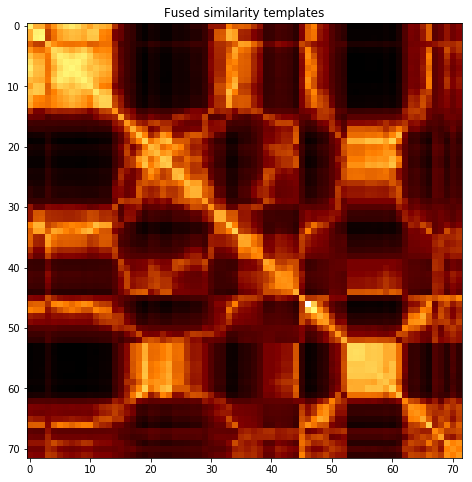

subject 16; gesture 1_0_1


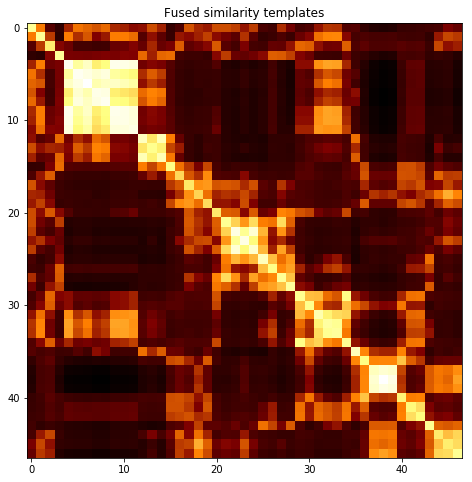

subject 16; gesture 3_1_1


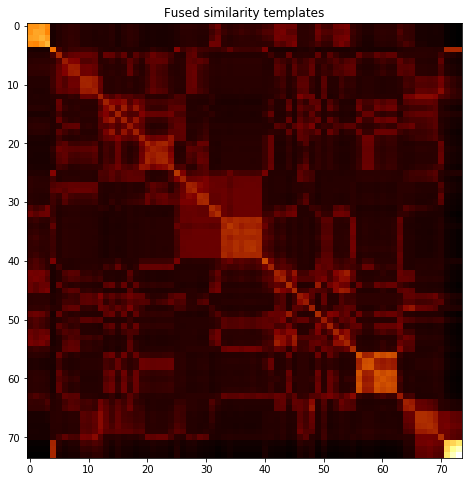

subject 16; gesture 1_0_2


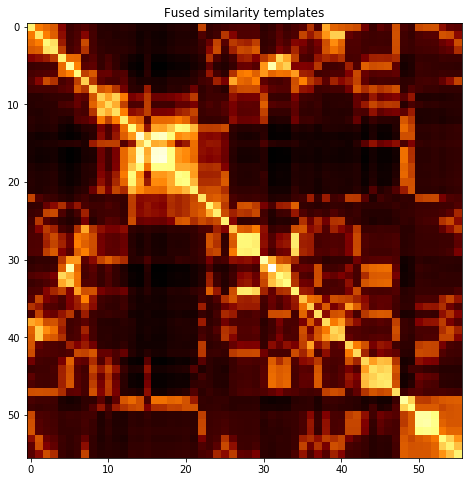

subject 16; gesture 4_0_2


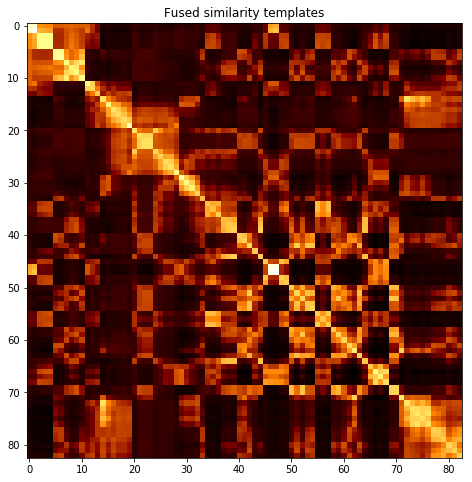

subject 26; gesture 3_0_1


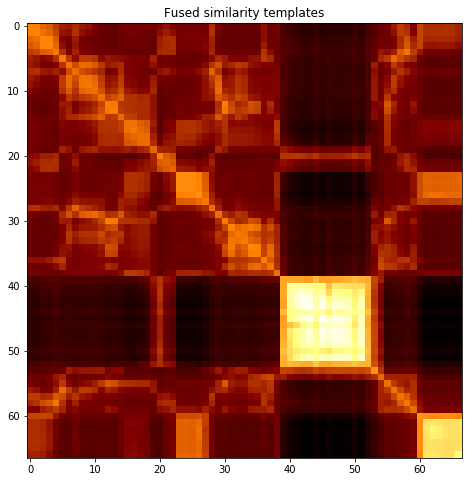

subject 26; gesture 4_1_1


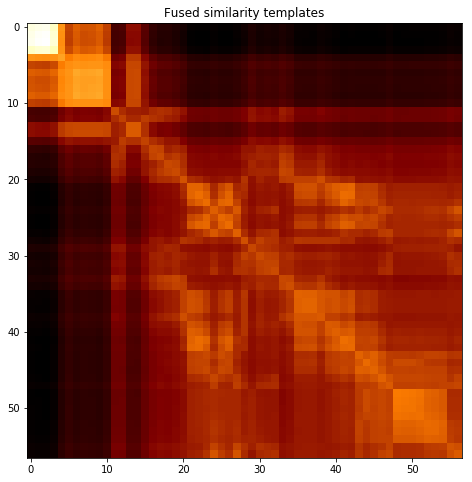

subject 26; gesture 2_0_1


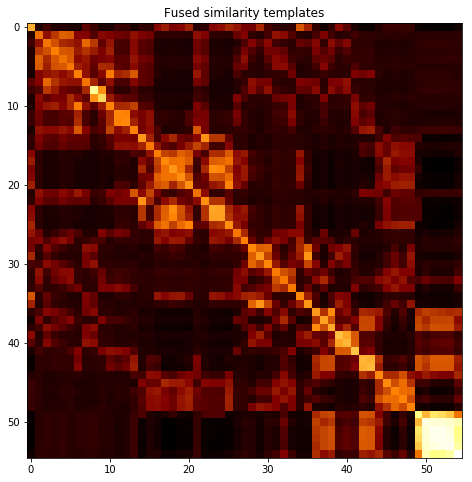

subject 26; gesture 4_1_2


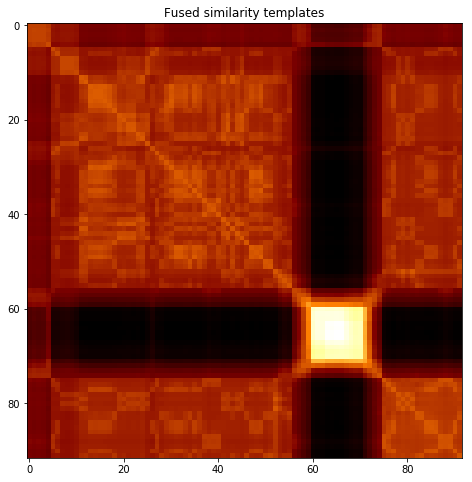

subject 26; gesture 2_0_2


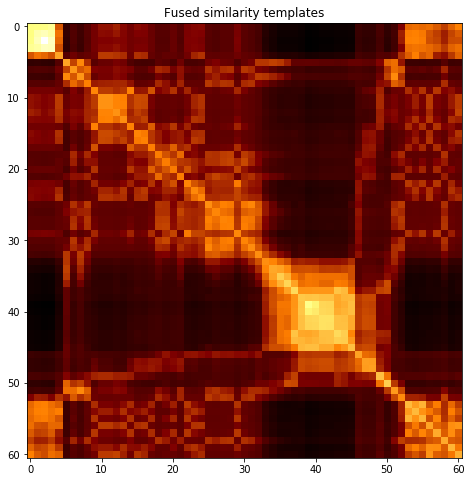

subject 26; gesture 1_1_2


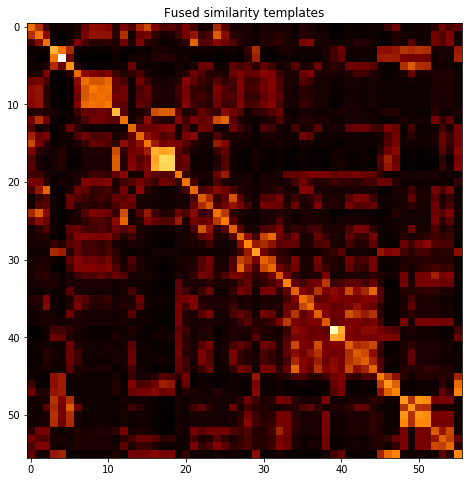

subject 26; gesture 2_1_2


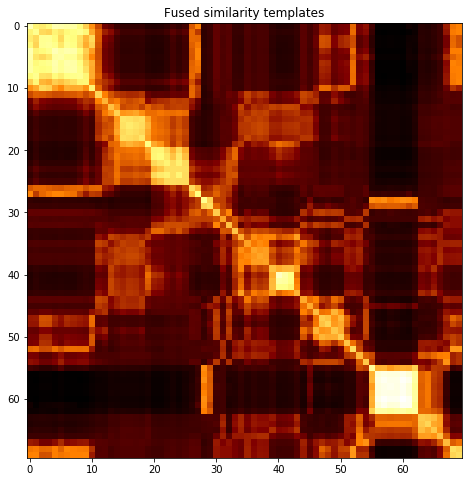

subject 26; gesture 4_0_1


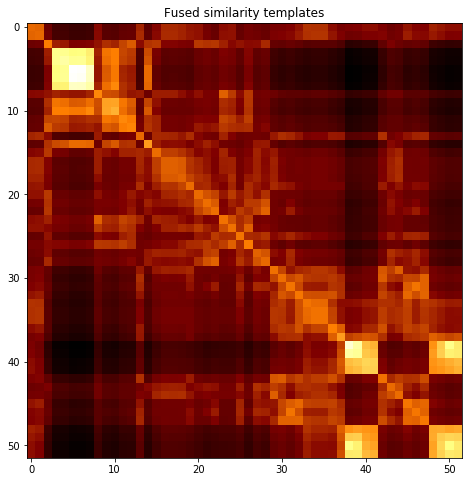

subject 26; gesture 3_0_2


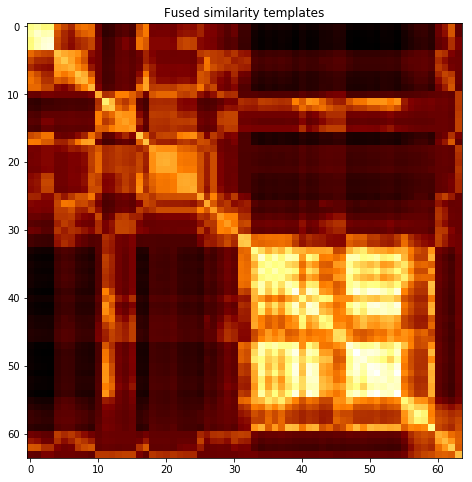

subject 26; gesture 1_1_1


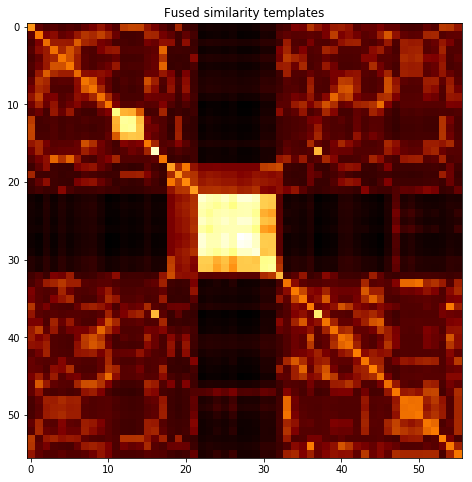

subject 26; gesture 3_1_2


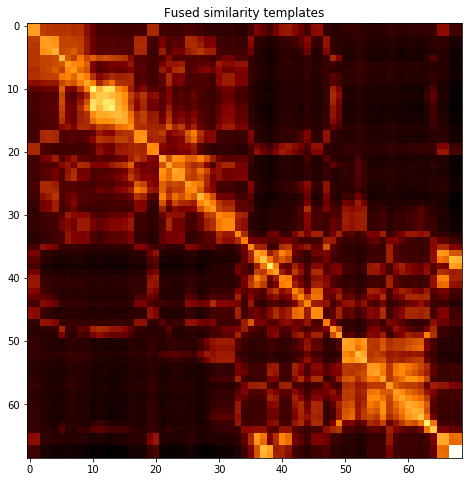

subject 26; gesture 2_1_1


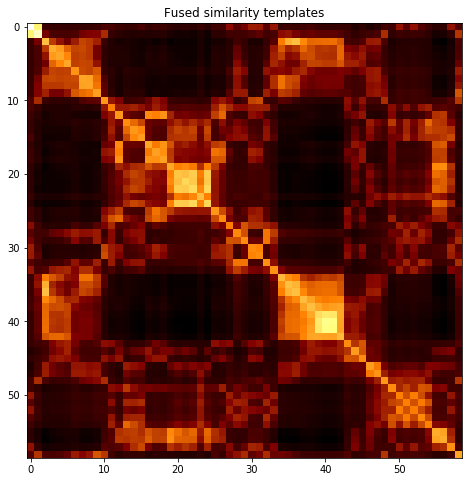

subject 26; gesture 1_0_1


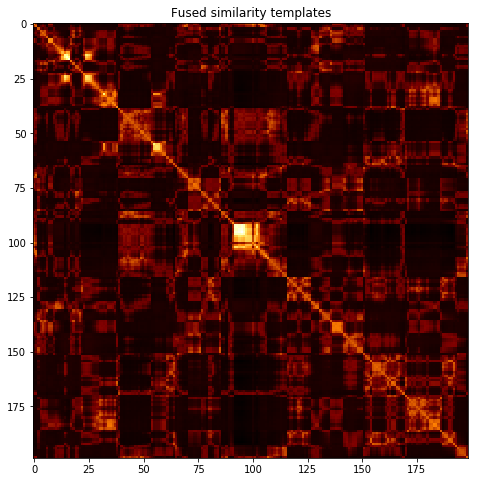

subject 26; gesture 3_1_1


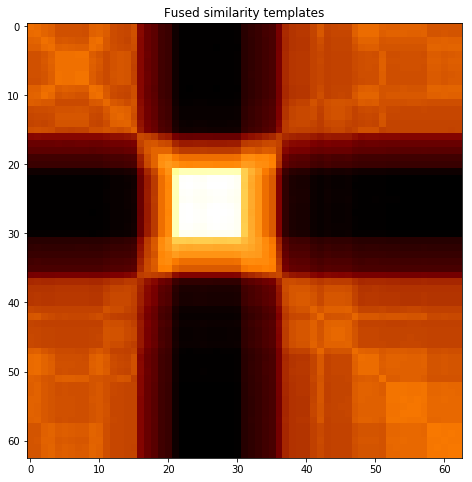

subject 26; gesture 1_0_2


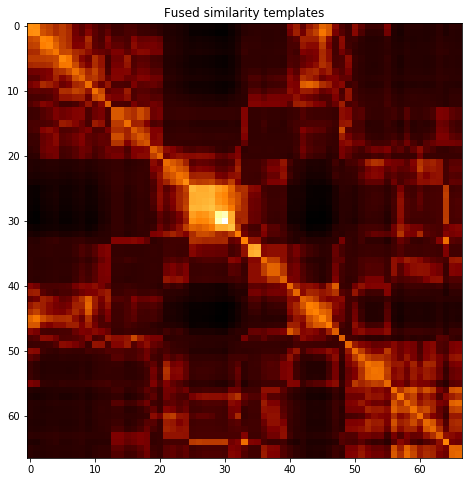

subject 26; gesture 4_0_2


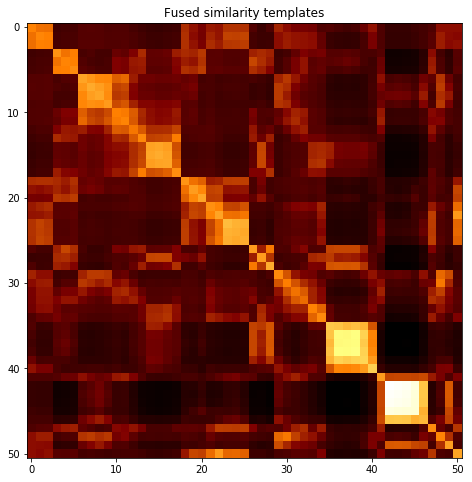

subject 32; gesture 3_0_1


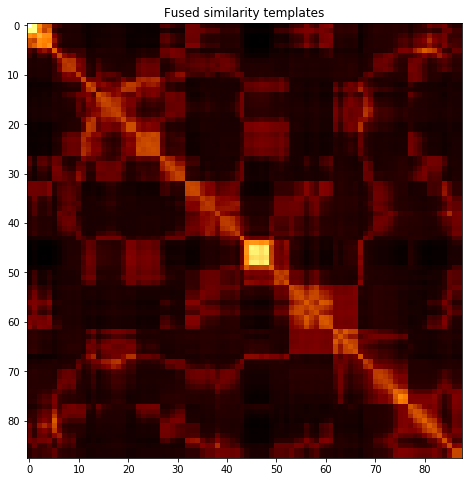

subject 32; gesture 4_1_1


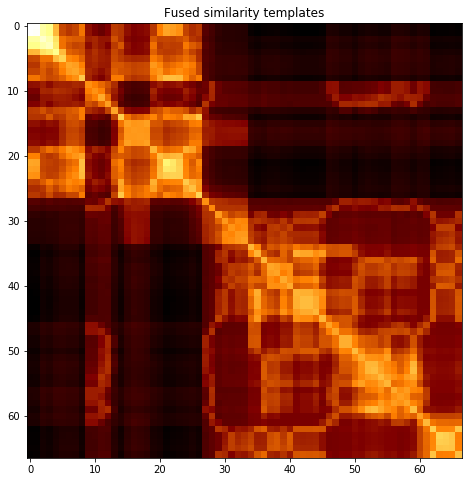

subject 32; gesture 2_0_1


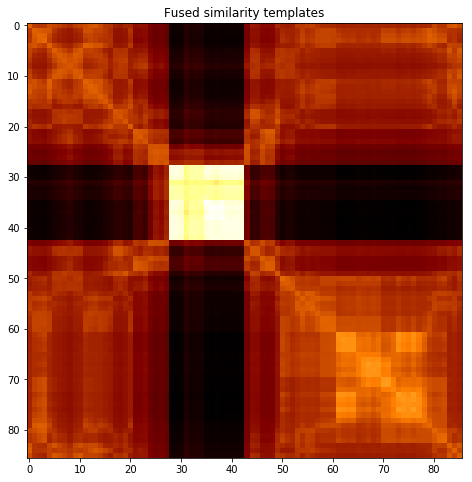

subject 32; gesture 4_1_2


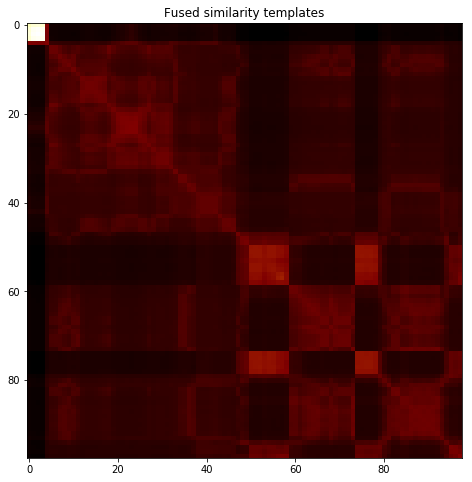

subject 32; gesture 2_0_2


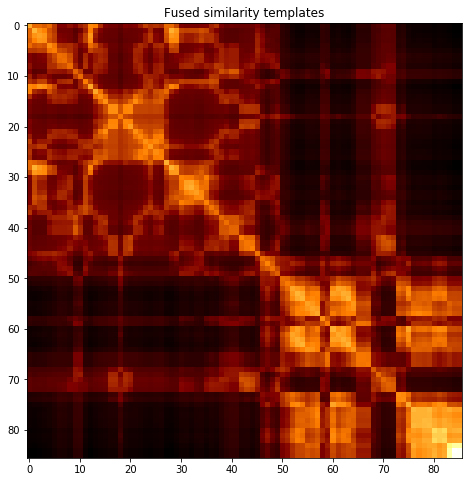

subject 32; gesture 1_1_2


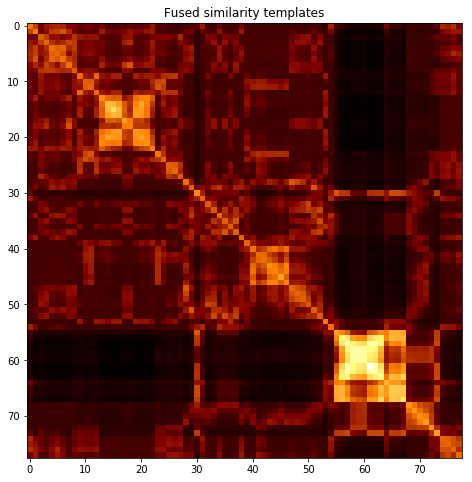

subject 32; gesture 2_1_2


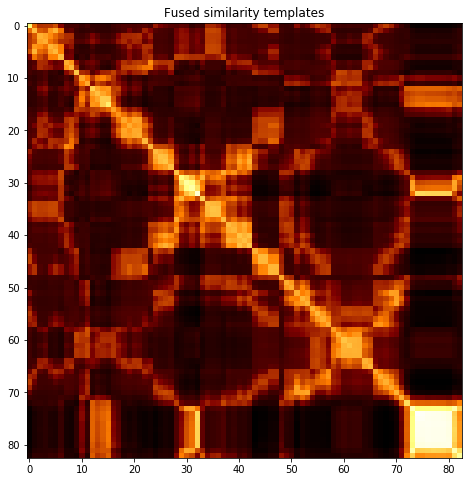

subject 32; gesture 4_0_1


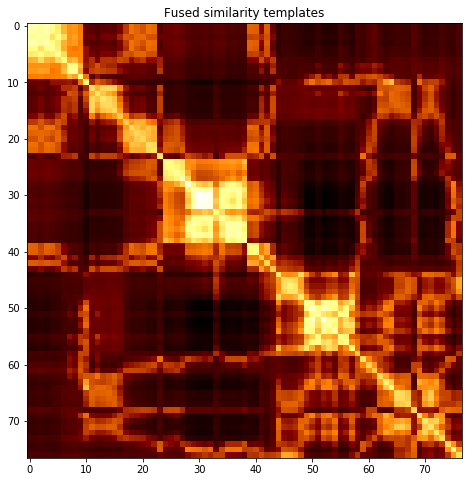

subject 32; gesture 3_0_2


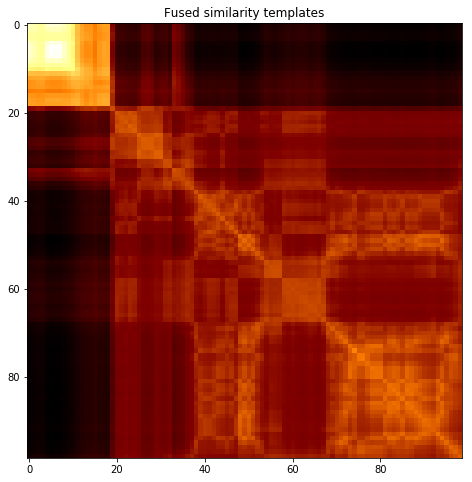

subject 32; gesture 1_1_1


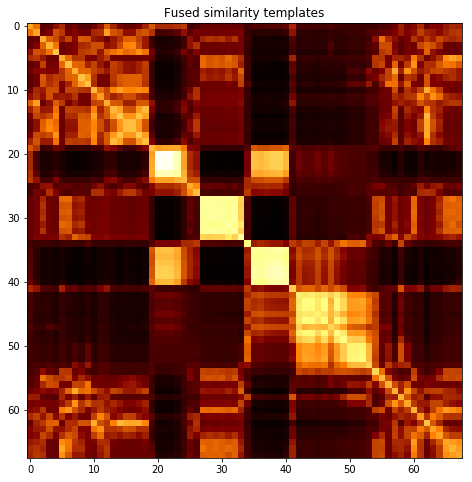

subject 32; gesture 3_1_2


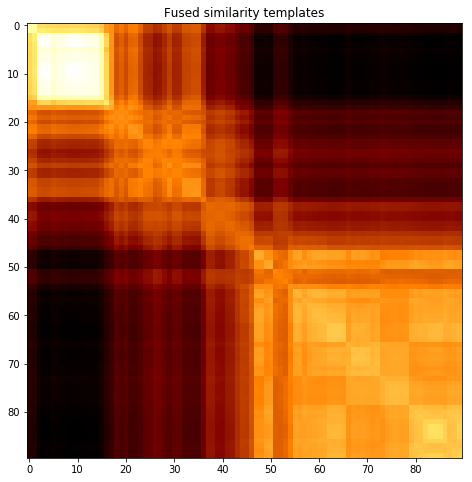

subject 32; gesture 2_1_1


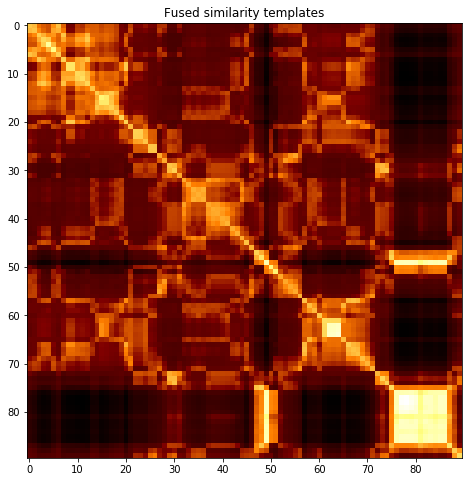

subject 32; gesture 1_0_1


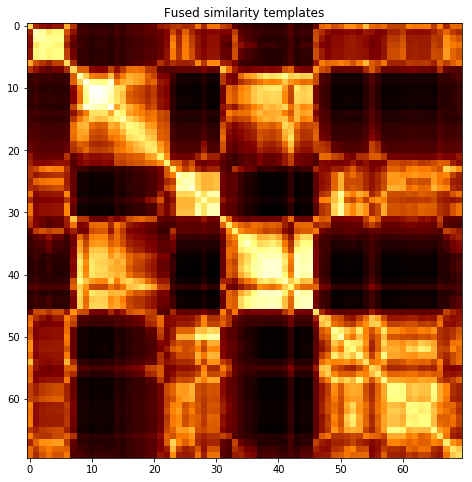

subject 32; gesture 3_1_1


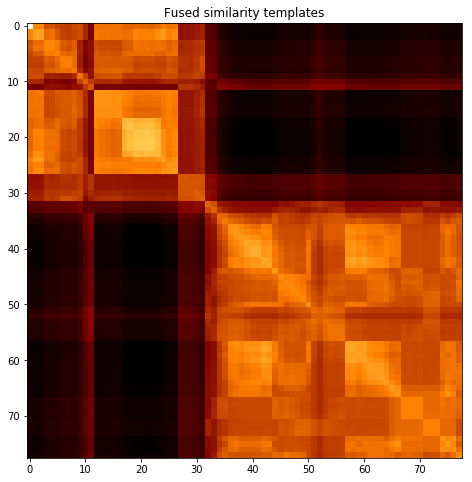

subject 32; gesture 1_0_2


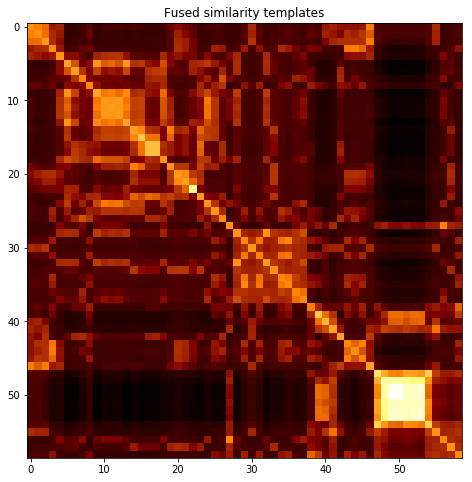

subject 32; gesture 4_0_2


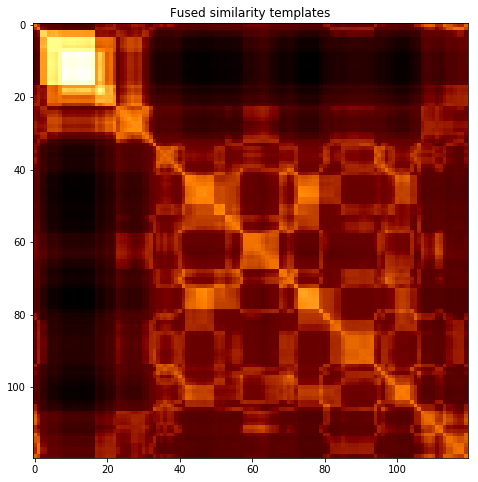

subject 04; gesture 3_0_1


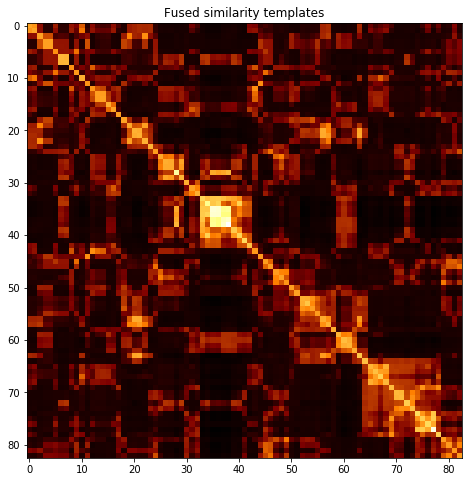

subject 04; gesture 4_1_1


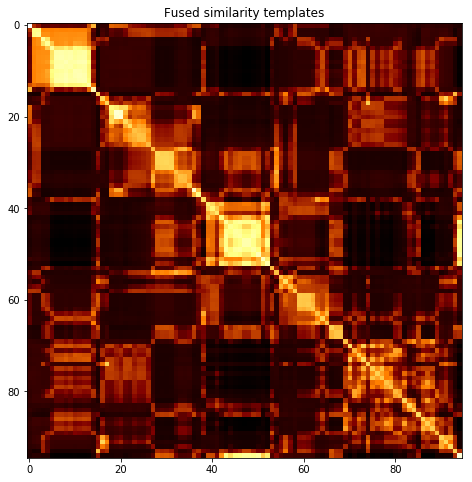

subject 04; gesture 2_0_1


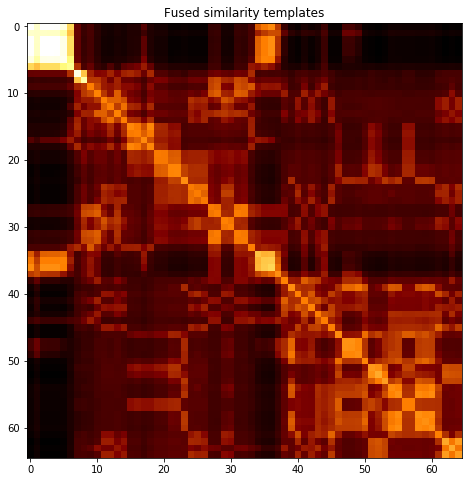

subject 04; gesture 4_1_2


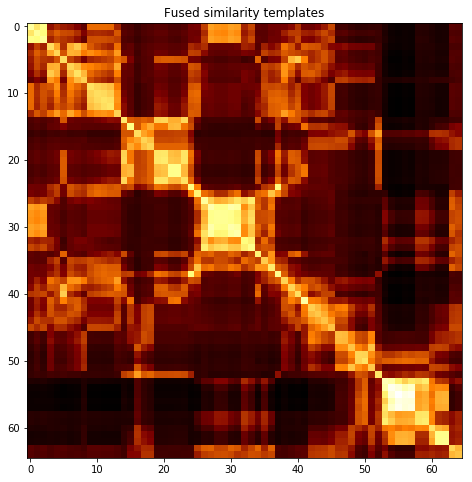

subject 04; gesture 2_0_2


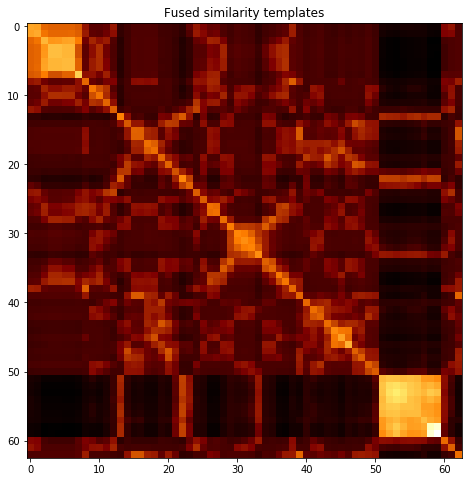

subject 04; gesture 1_1_2


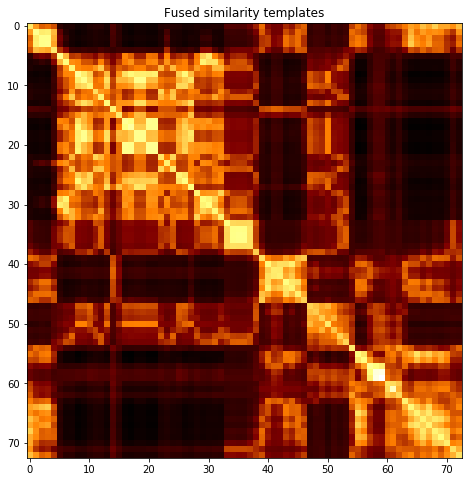

subject 04; gesture 2_1_2


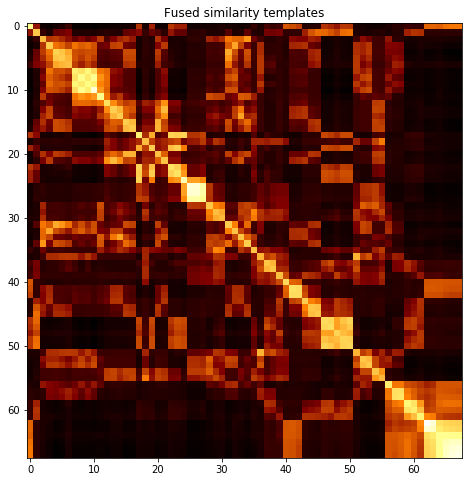

subject 04; gesture 4_0_1


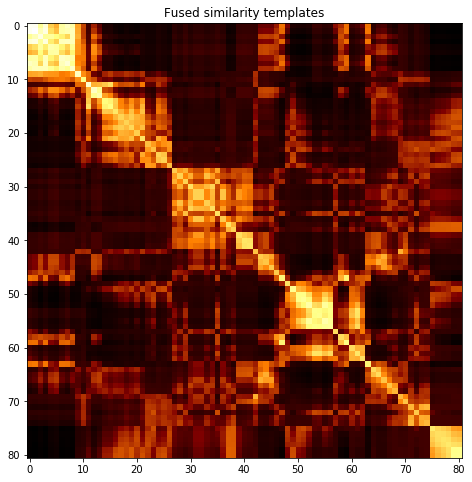

subject 04; gesture 3_0_2


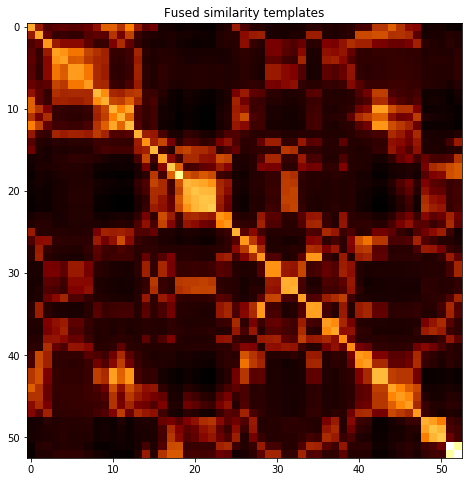

subject 04; gesture 1_1_1


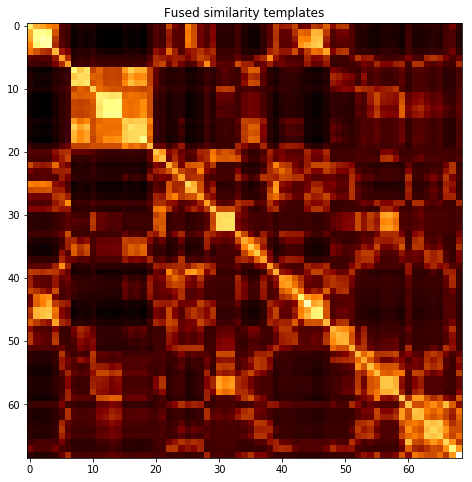

subject 04; gesture 3_1_2


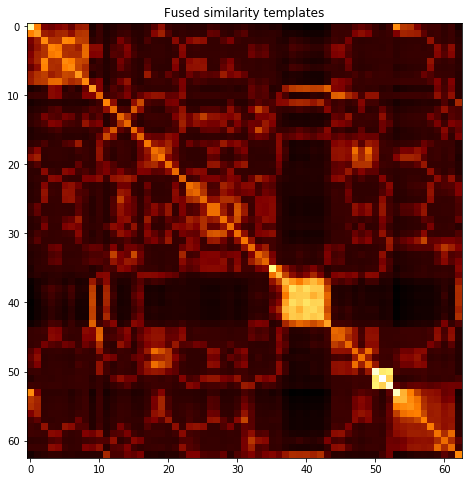

subject 04; gesture 2_1_1


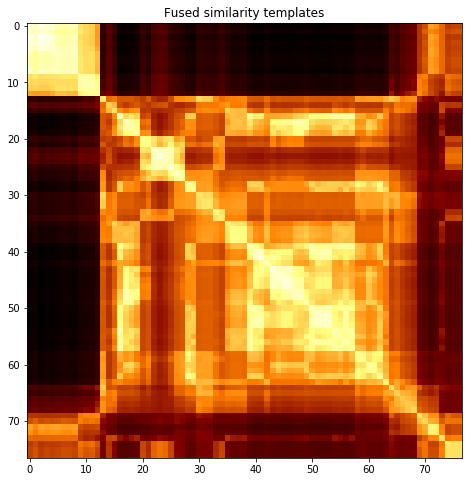

subject 04; gesture 1_0_1


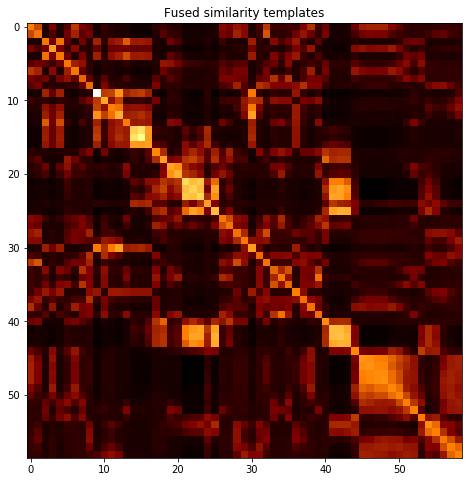

subject 04; gesture 3_1_1


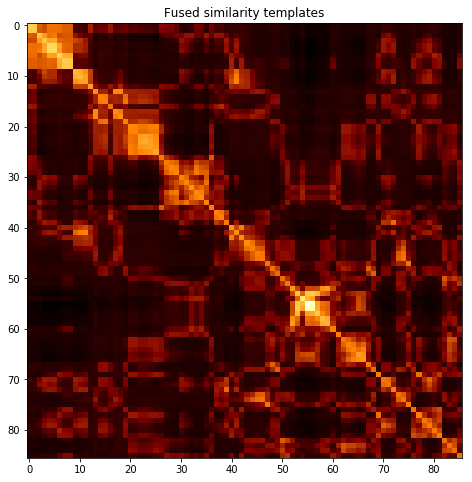

subject 04; gesture 1_0_2


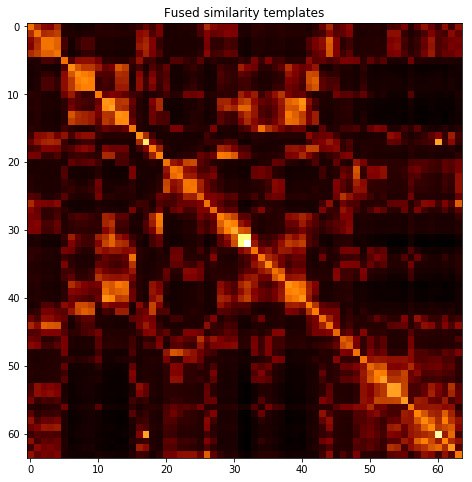

subject 04; gesture 4_0_2


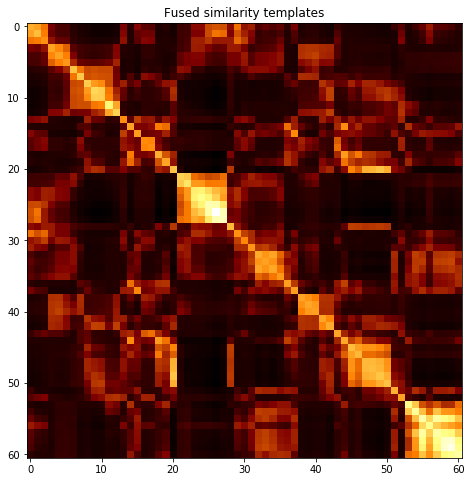

subject 08; gesture 3_0_1


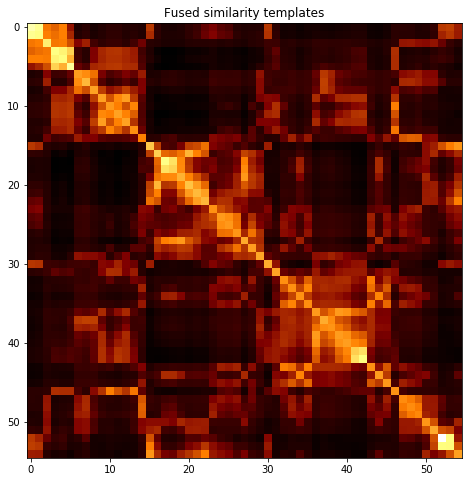

subject 08; gesture 4_1_1


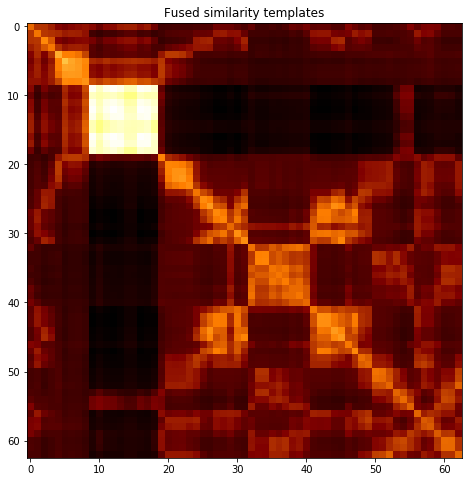

subject 08; gesture 2_0_1


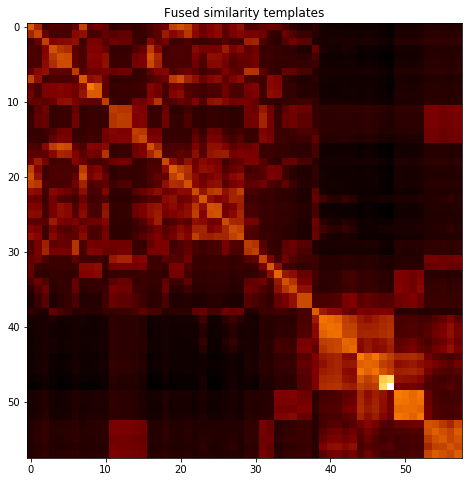

subject 08; gesture 4_1_2


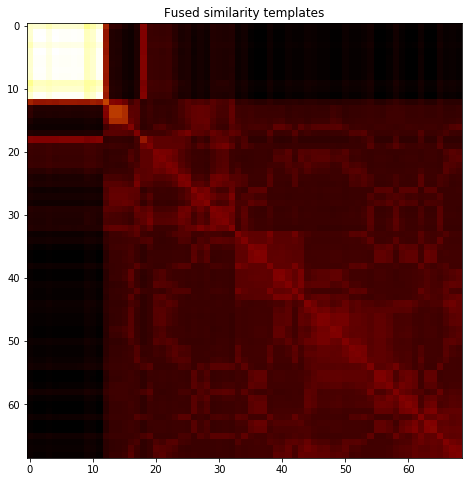

subject 08; gesture 2_0_2


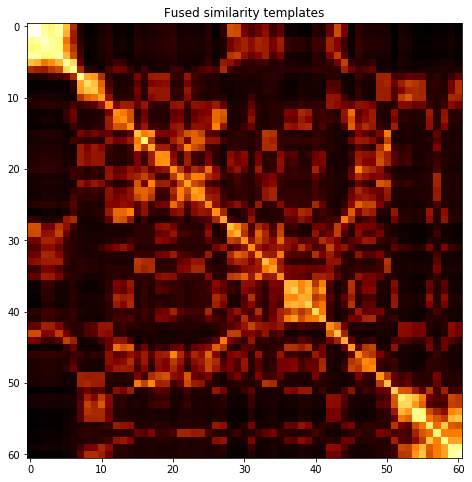

subject 08; gesture 1_1_2


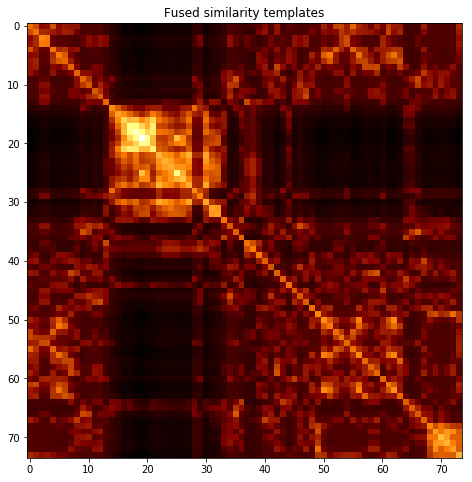

subject 08; gesture 2_1_2


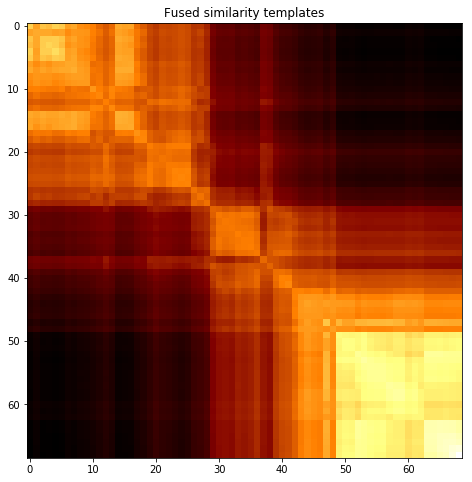

subject 08; gesture 4_0_1


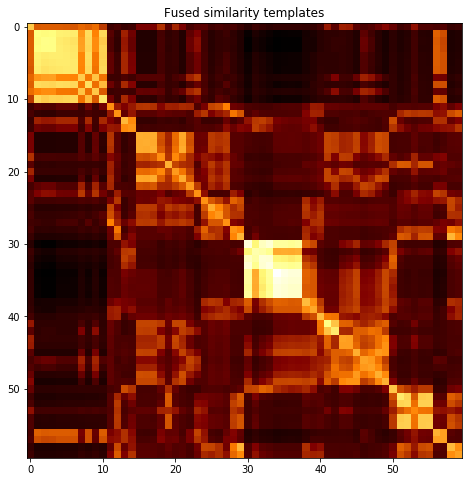

subject 08; gesture 3_0_2


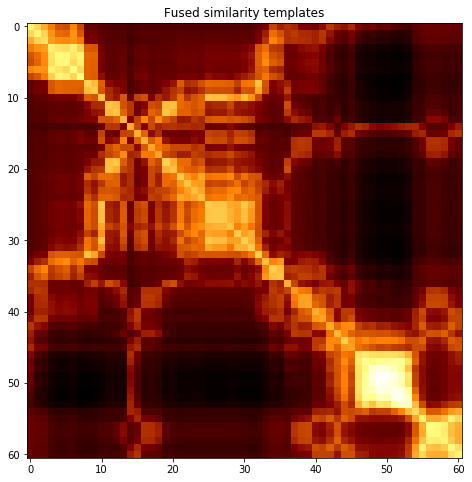

subject 08; gesture 1_1_1


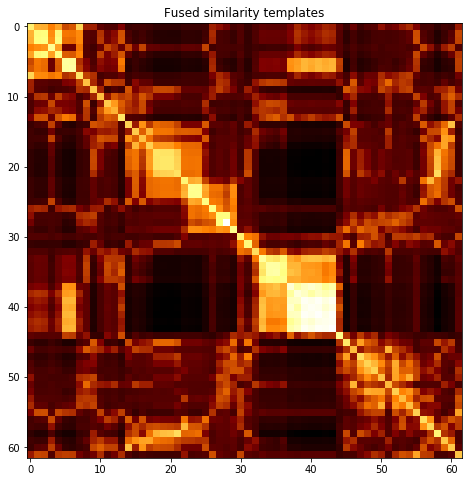

subject 08; gesture 3_1_2


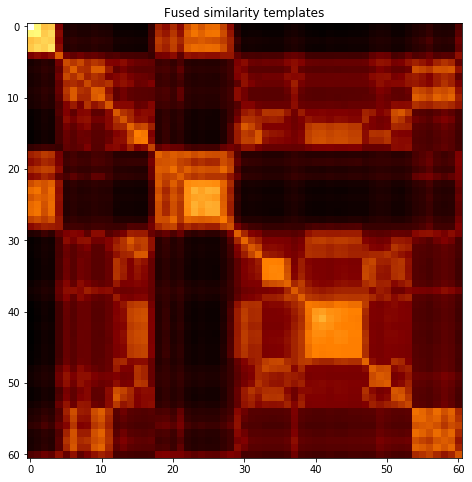

subject 08; gesture 2_1_1


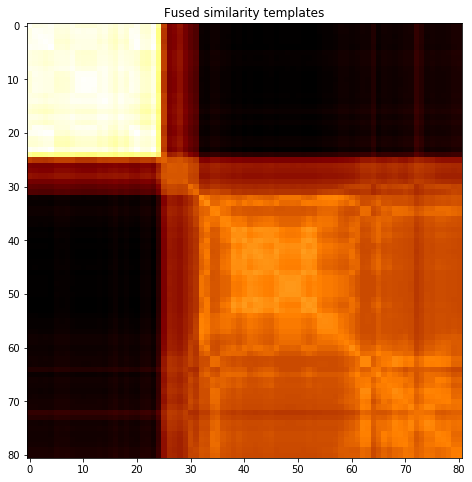

subject 08; gesture 1_0_1


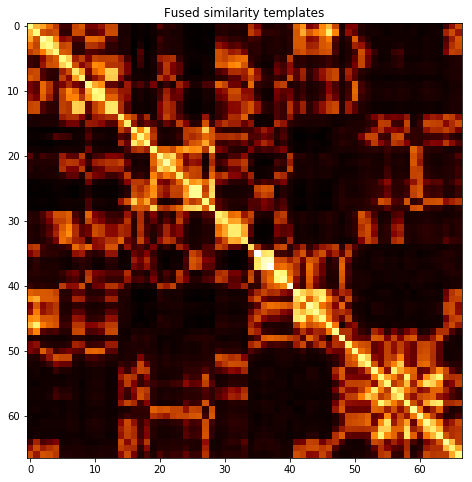

subject 08; gesture 3_1_1


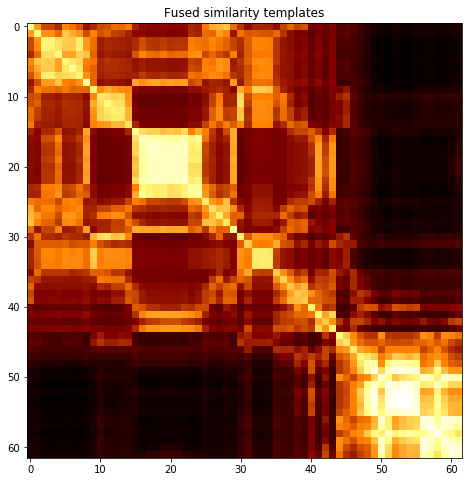

subject 08; gesture 1_0_2


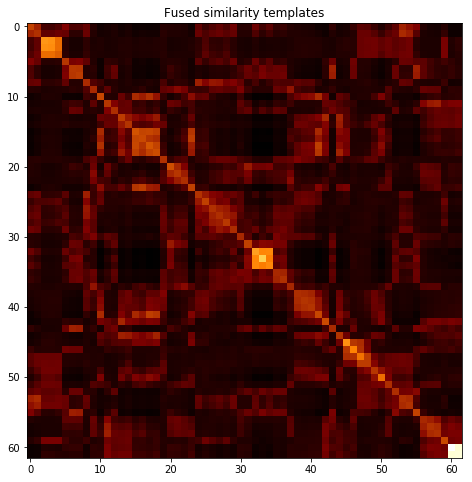

subject 08; gesture 4_0_2


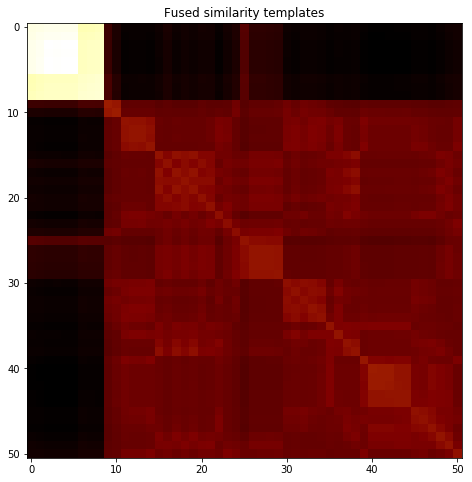

subject 27; gesture 3_0_1


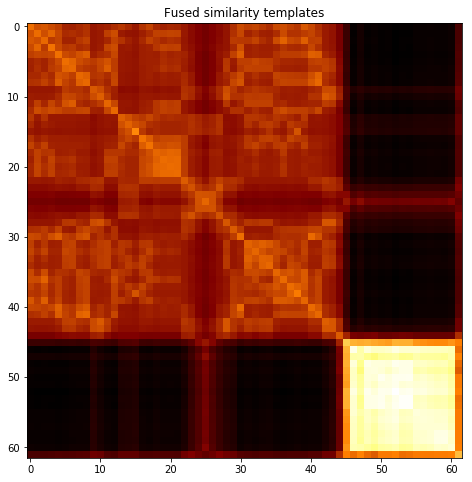

subject 27; gesture 4_1_1


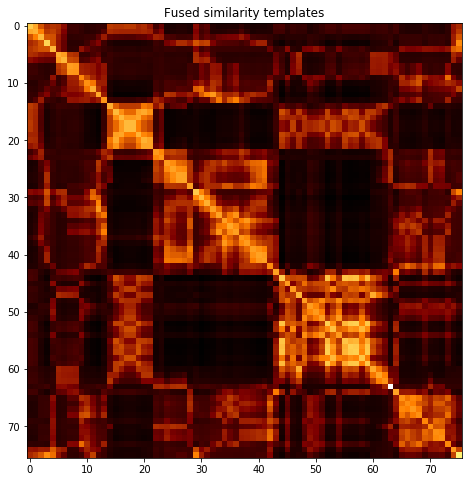

subject 27; gesture 2_0_1


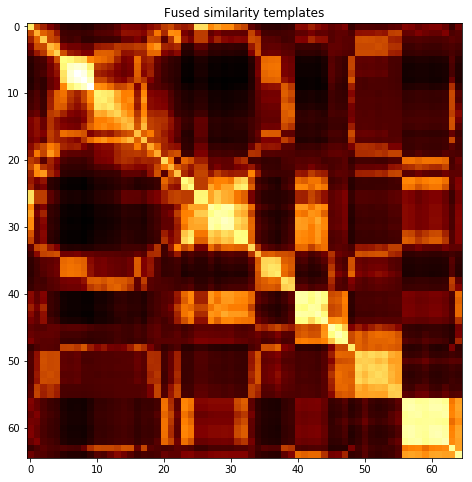

subject 27; gesture 4_1_2


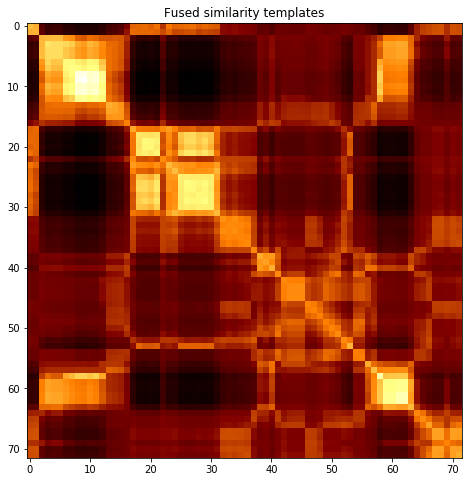

subject 27; gesture 2_0_2


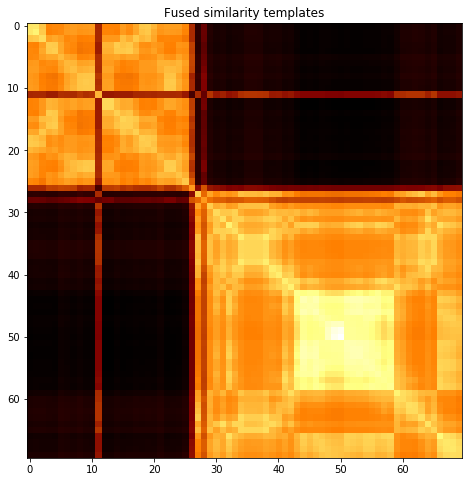

subject 27; gesture 1_1_2


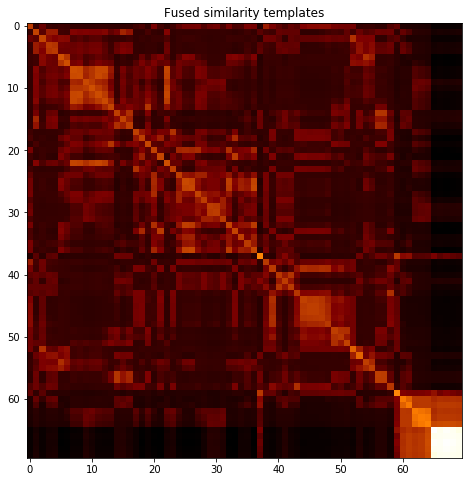

subject 27; gesture 2_1_2


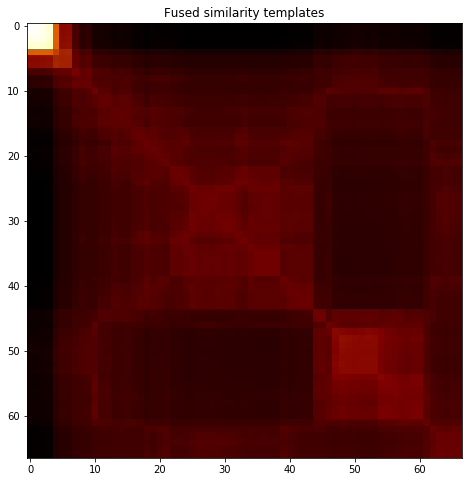

subject 27; gesture 4_0_1


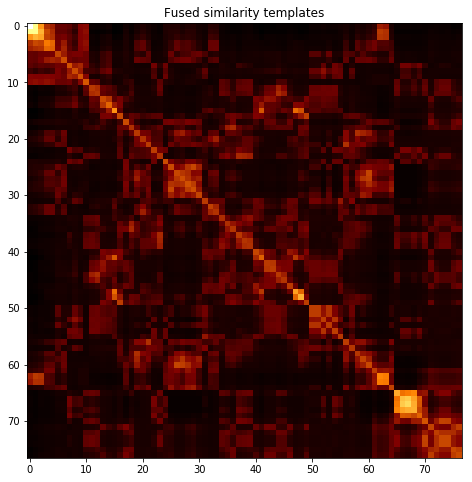

subject 27; gesture 3_0_2


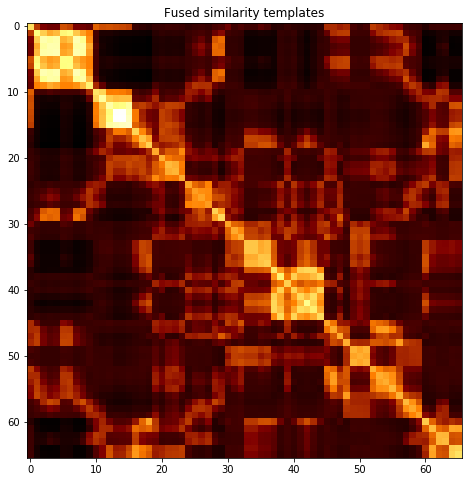

subject 27; gesture 1_1_1


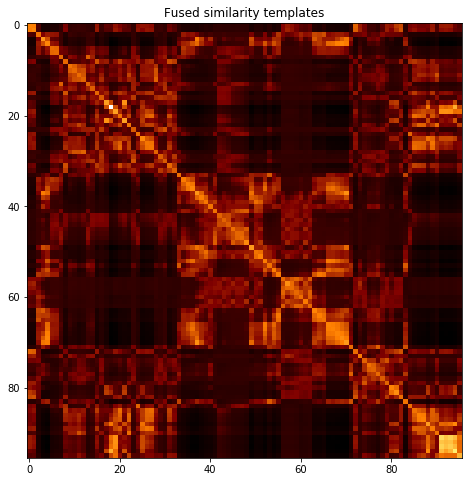

subject 27; gesture 3_1_2


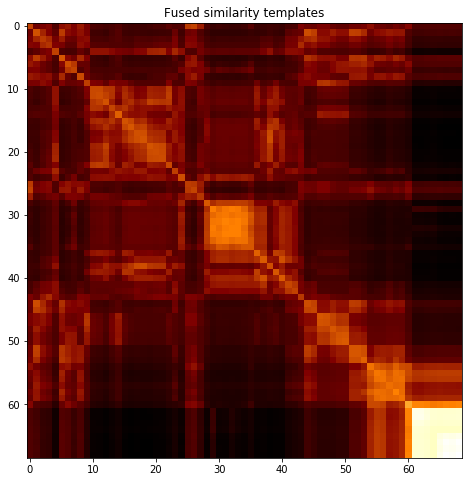

subject 27; gesture 2_1_1


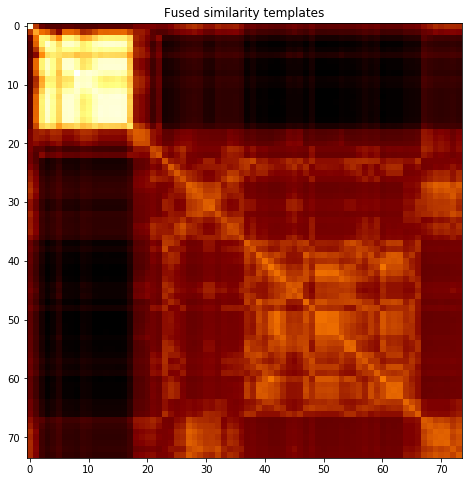

subject 27; gesture 1_0_1


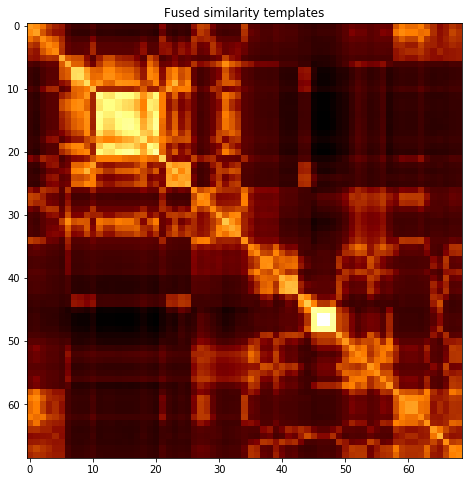

subject 27; gesture 3_1_1


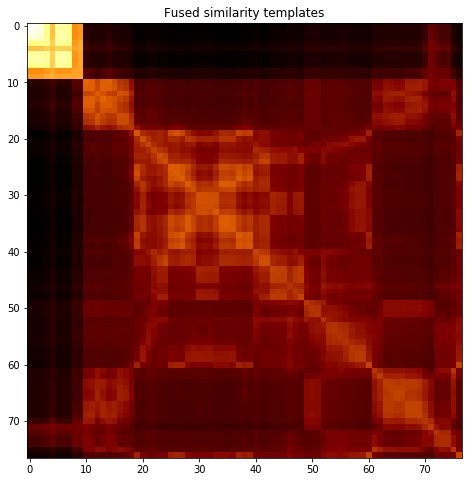

subject 27; gesture 1_0_2


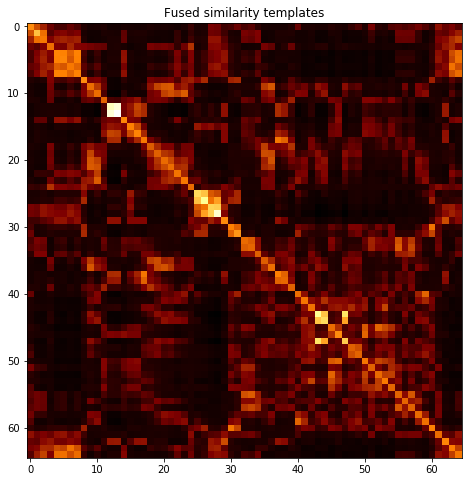

subject 27; gesture 4_0_2


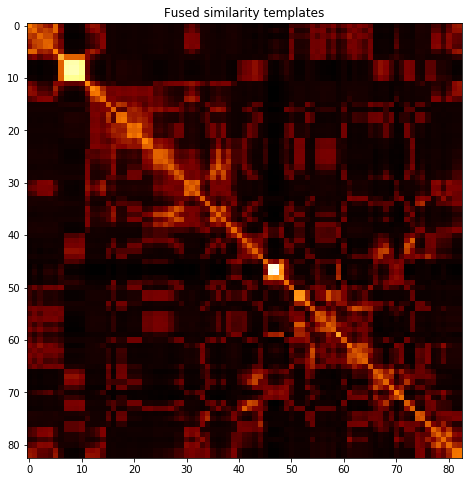

subject 14; gesture 3_0_1


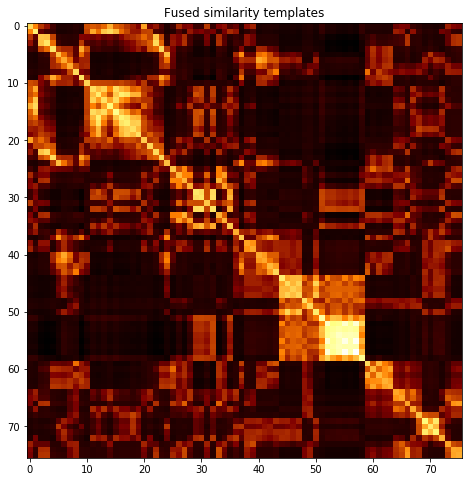

subject 14; gesture 4_1_1


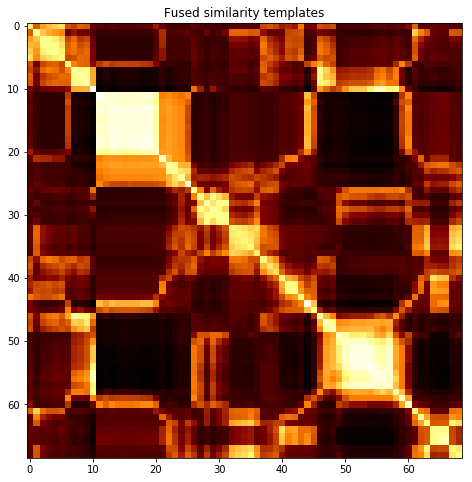

subject 14; gesture 2_0_1


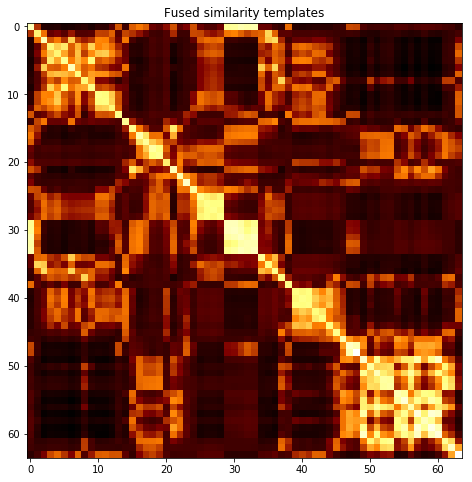

subject 14; gesture 4_1_2


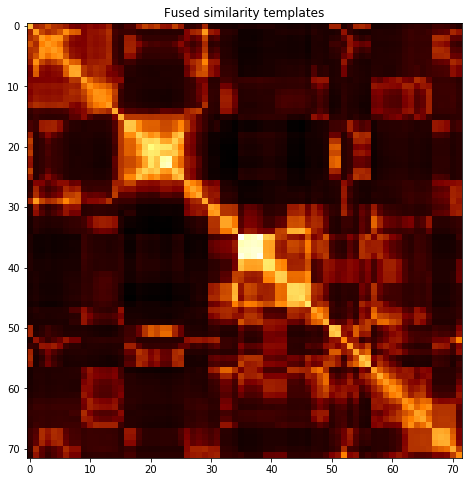

subject 14; gesture 2_0_2


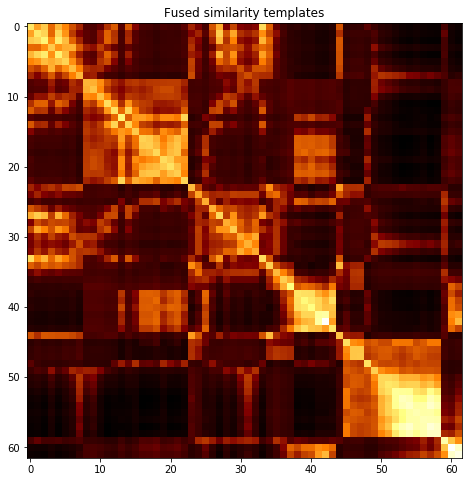

subject 14; gesture 1_1_2


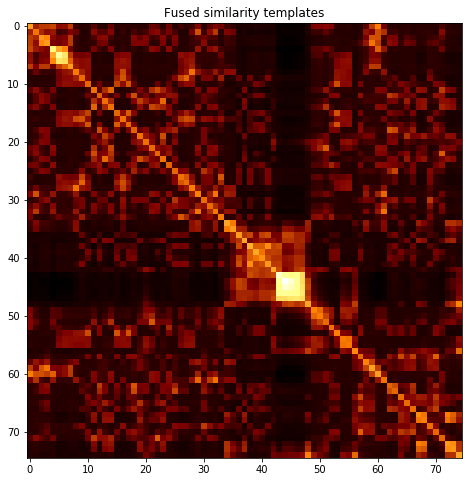

subject 14; gesture 2_1_2


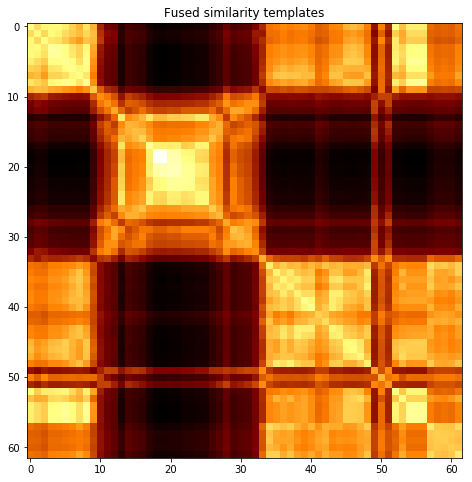

subject 14; gesture 4_0_1


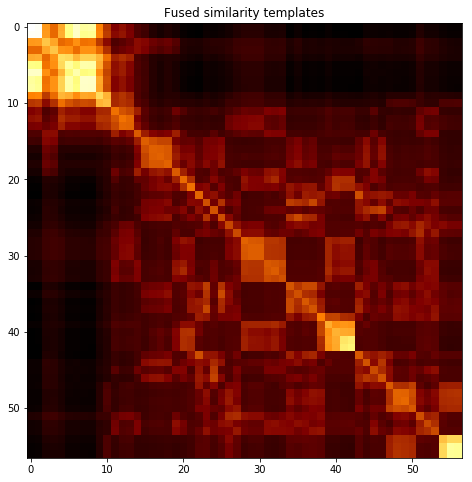

subject 14; gesture 3_0_2


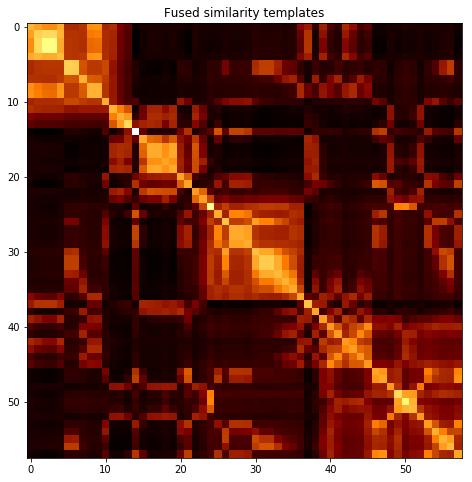

subject 14; gesture 1_1_1


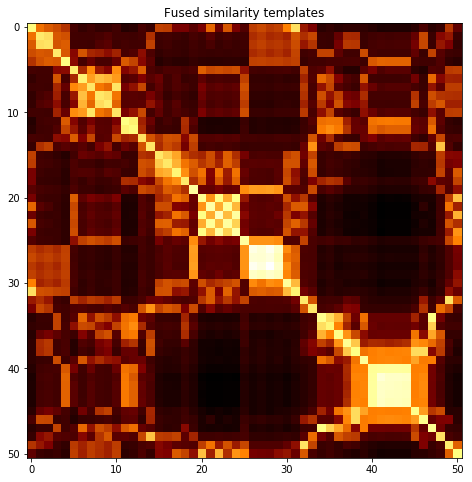

subject 14; gesture 3_1_2


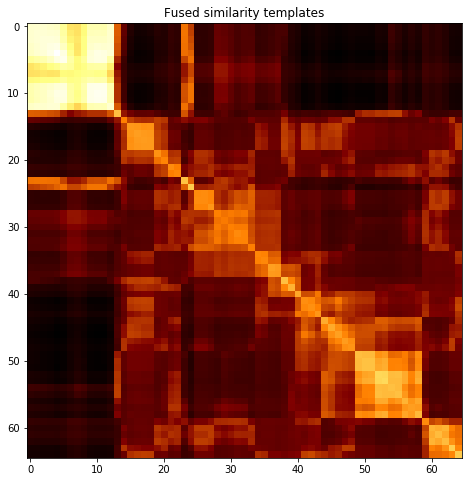

subject 14; gesture 2_1_1


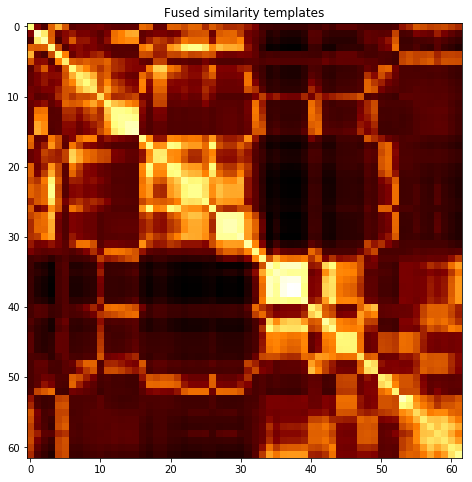

subject 14; gesture 1_0_1


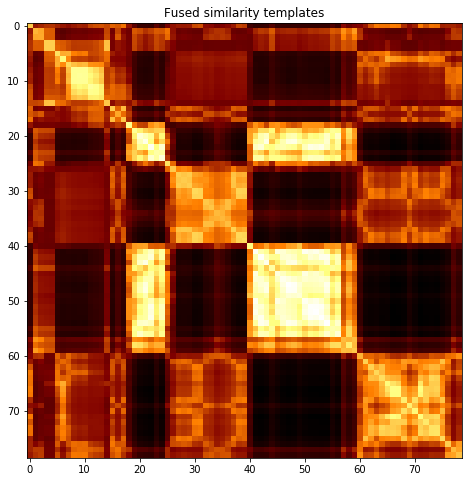

subject 14; gesture 3_1_1


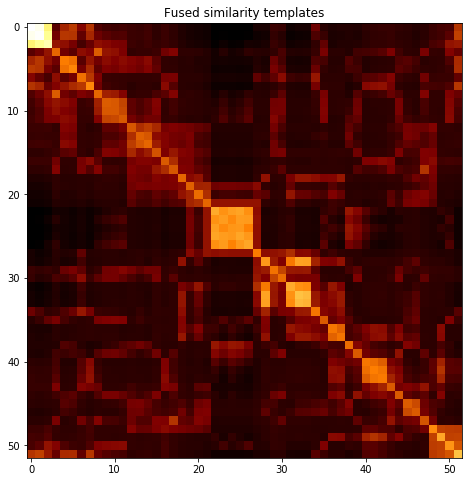

subject 14; gesture 1_0_2


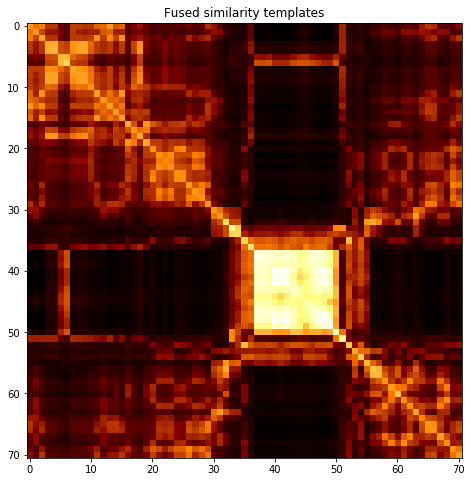

subject 14; gesture 4_0_2


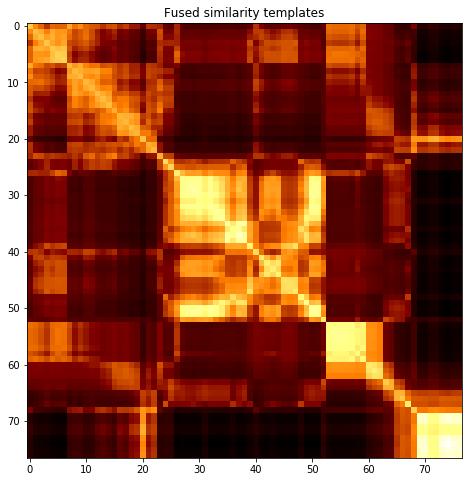

subject 23; gesture 3_0_1


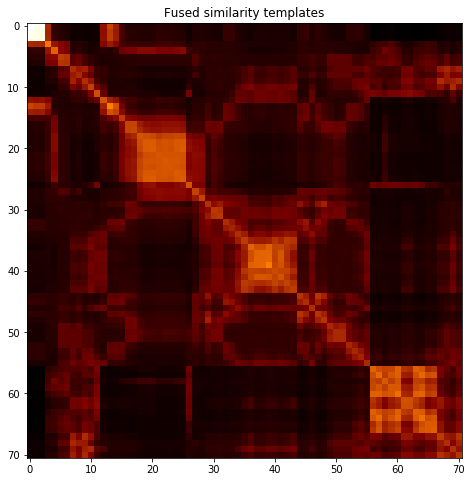

subject 23; gesture 4_1_1


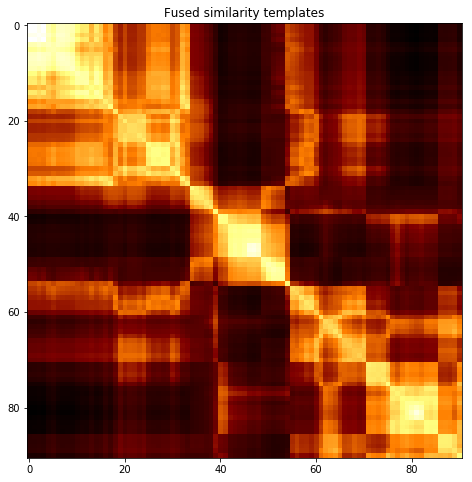

subject 23; gesture 2_0_1


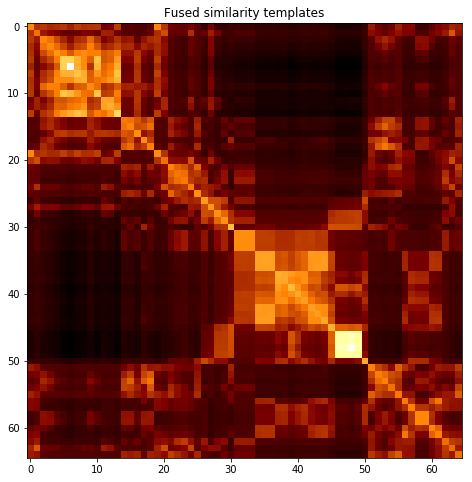

subject 23; gesture 4_1_2


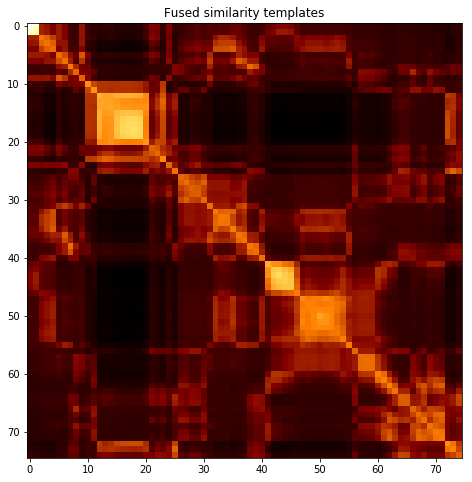

subject 23; gesture 2_0_2


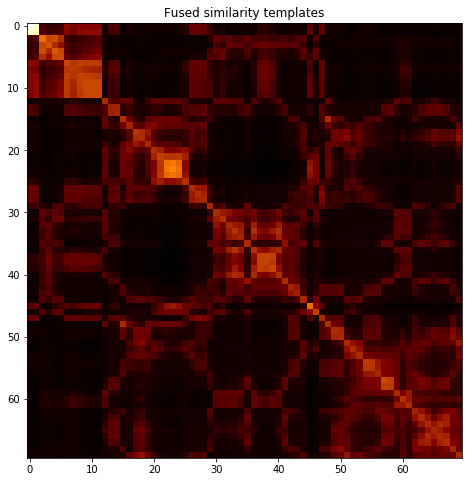

subject 23; gesture 1_1_2


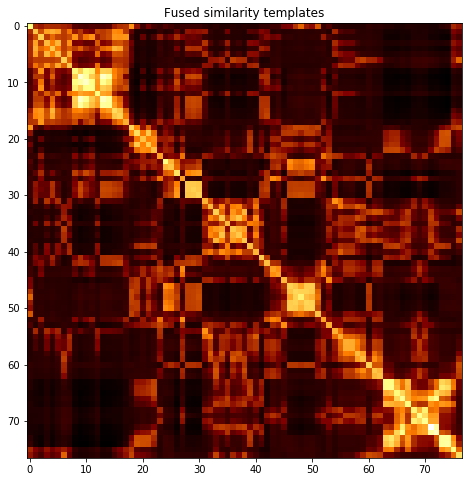

subject 23; gesture 2_1_2


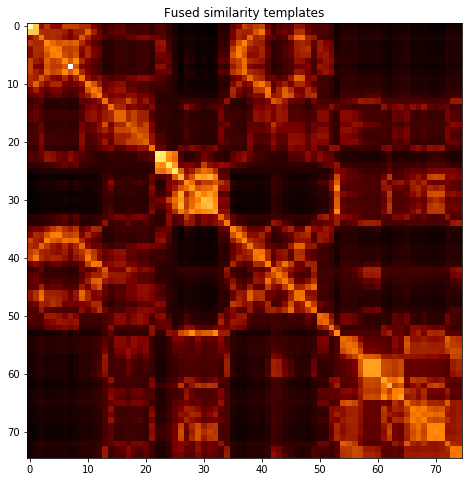

subject 23; gesture 4_0_1


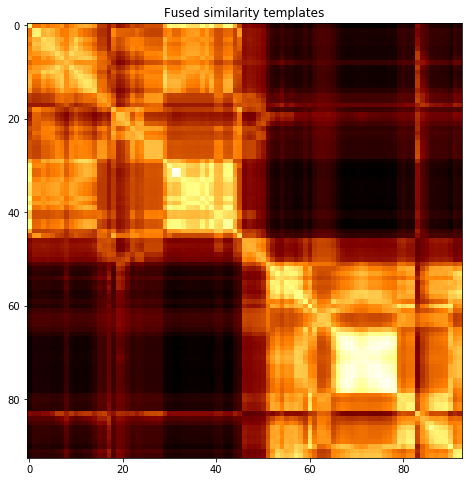

subject 23; gesture 3_0_2


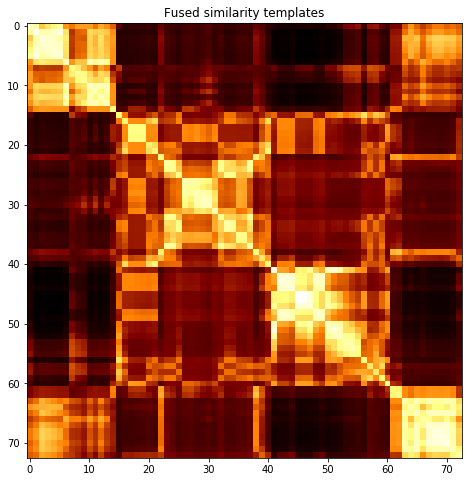

subject 23; gesture 1_1_1


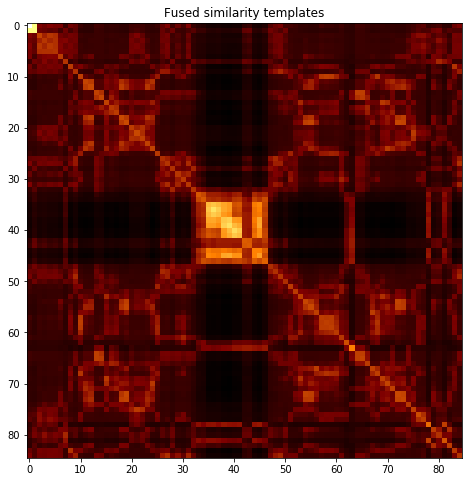

subject 23; gesture 3_1_2


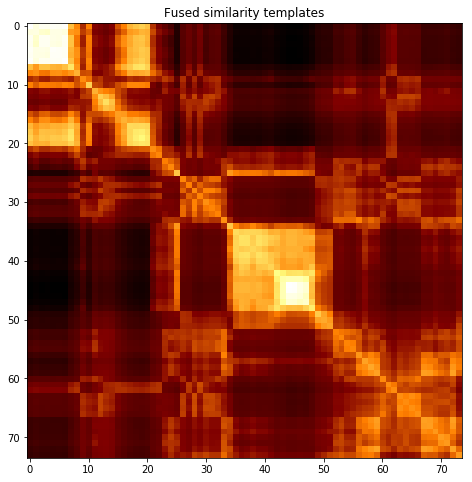

subject 23; gesture 2_1_1


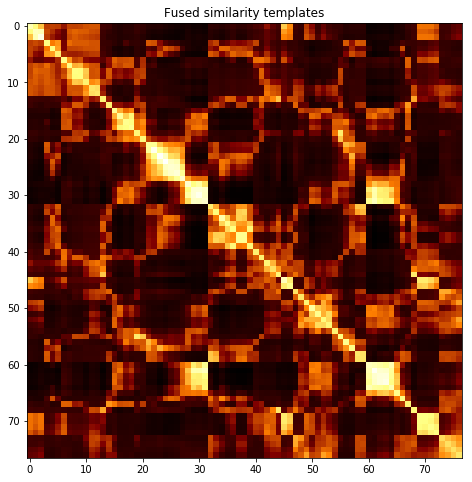

subject 23; gesture 1_0_1


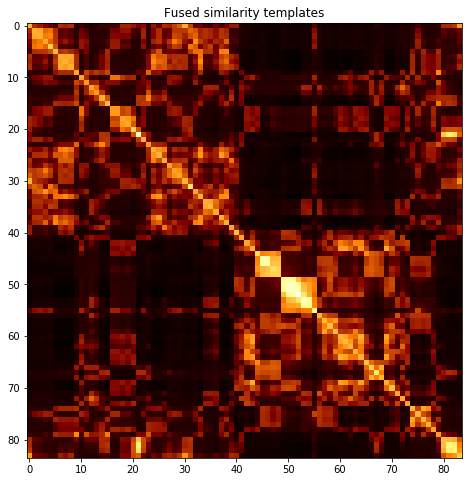

subject 23; gesture 3_1_1


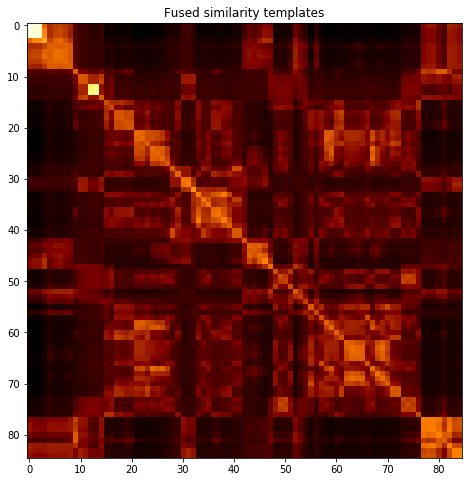

subject 23; gesture 1_0_2


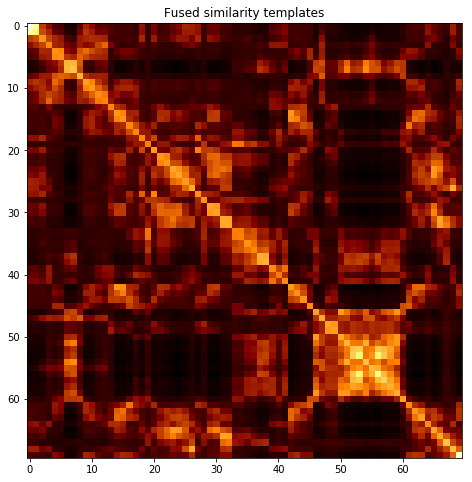

subject 23; gesture 4_0_2


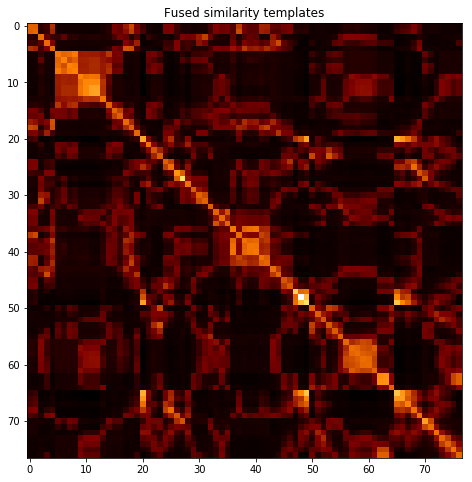

subject 25; gesture 3_0_1


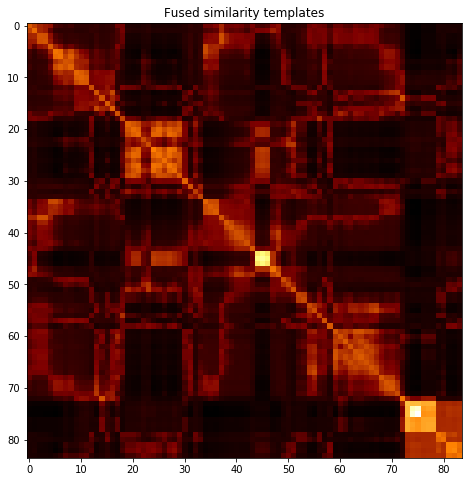

subject 25; gesture 4_1_1


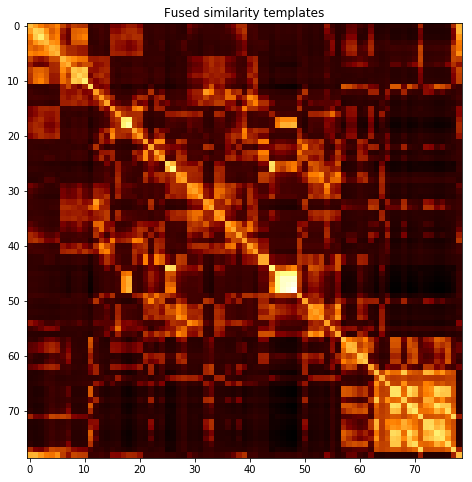

subject 25; gesture 2_0_1


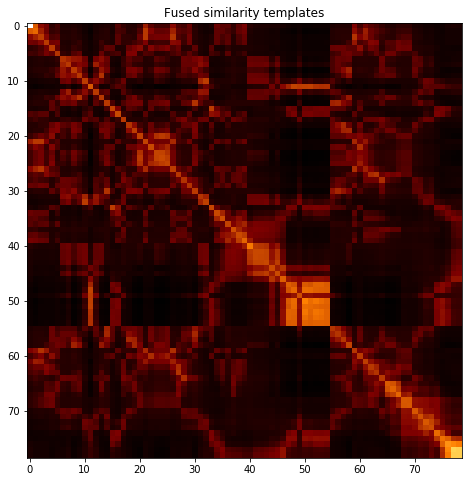

subject 25; gesture 4_1_2


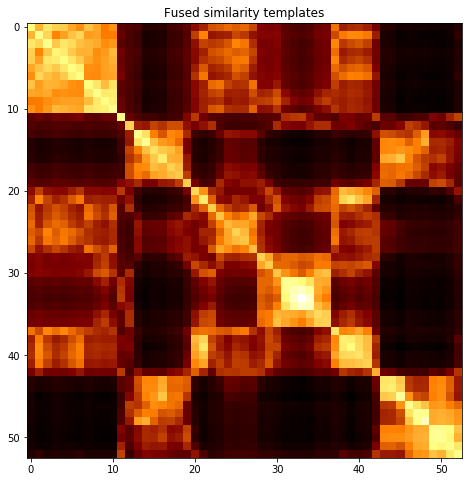

subject 25; gesture 2_0_2


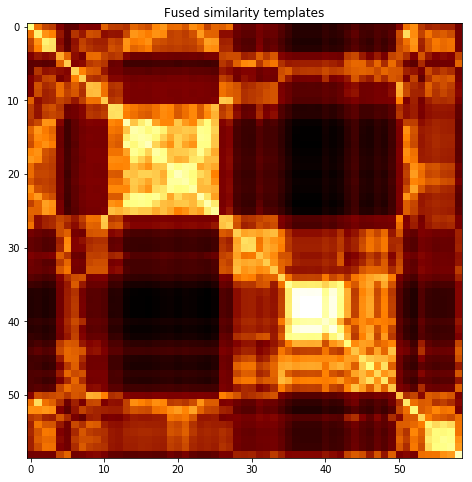

subject 25; gesture 1_1_2


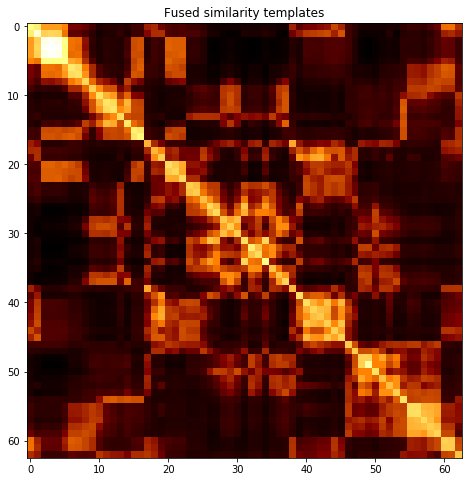

subject 25; gesture 2_1_2


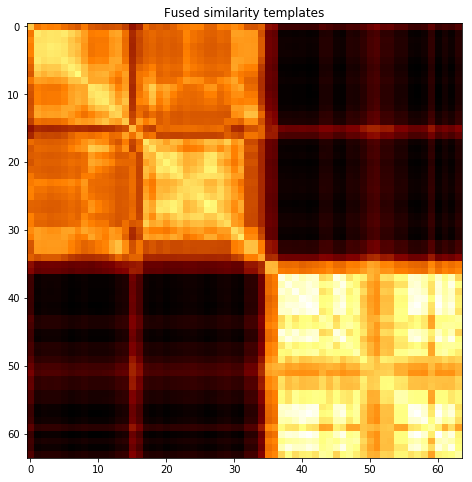

subject 25; gesture 4_0_1


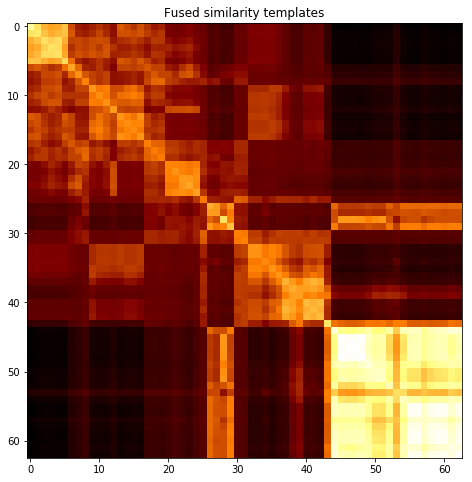

subject 25; gesture 3_0_2


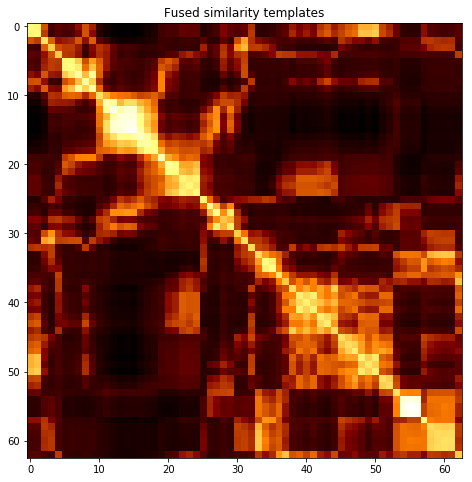

subject 25; gesture 1_1_1


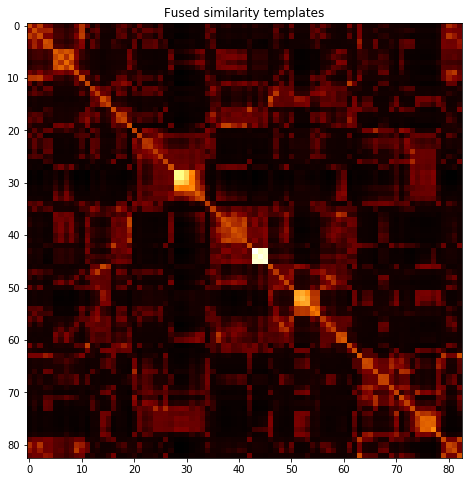

subject 25; gesture 3_1_2


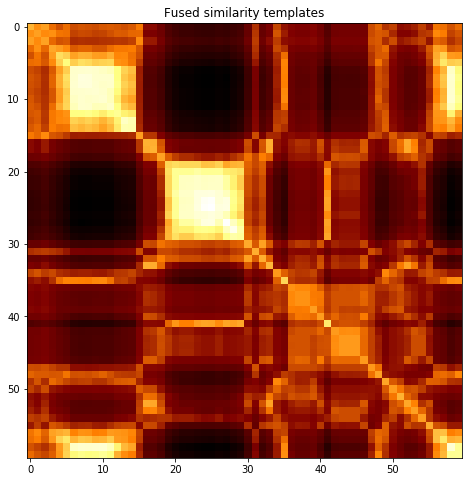

subject 25; gesture 2_1_1


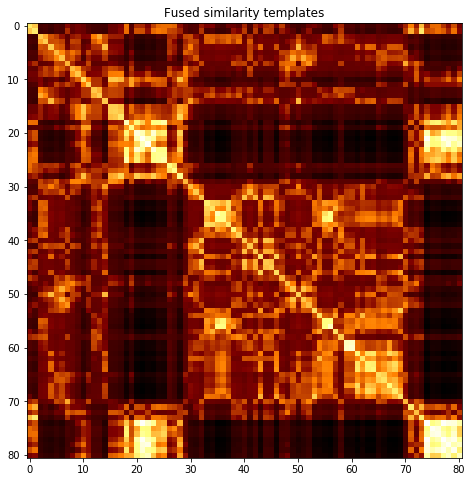

subject 25; gesture 1_0_1


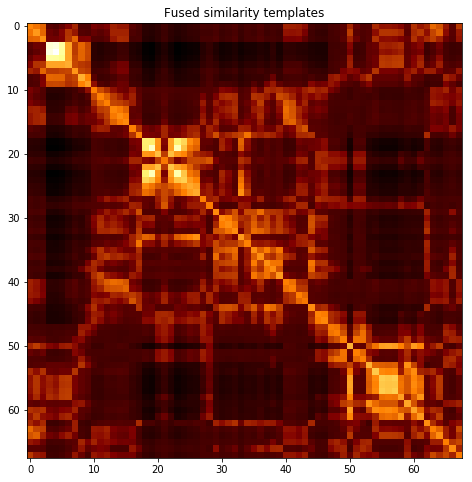

subject 25; gesture 3_1_1


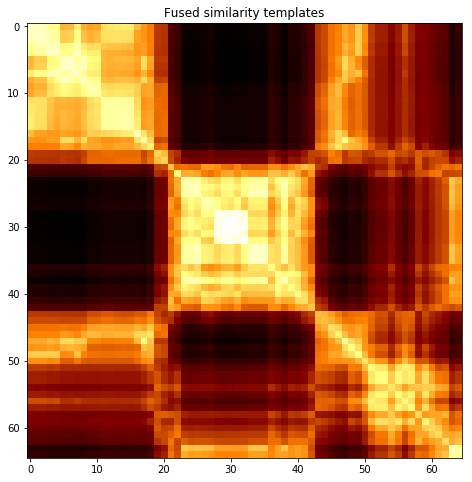

subject 25; gesture 1_0_2


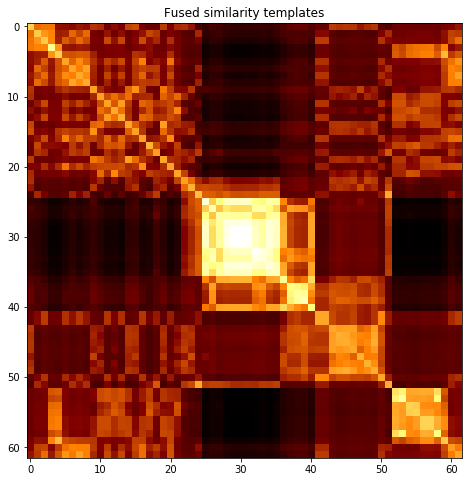

subject 25; gesture 4_0_2


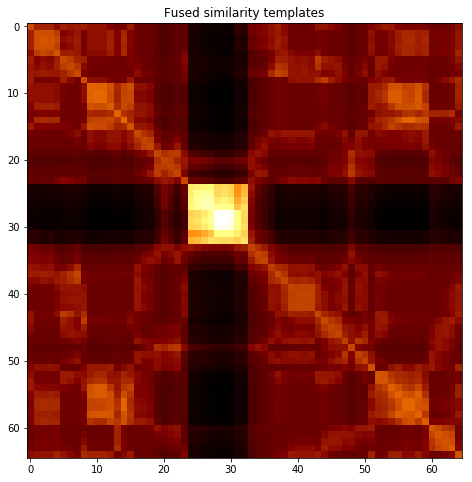

subject 18; gesture 3_0_1


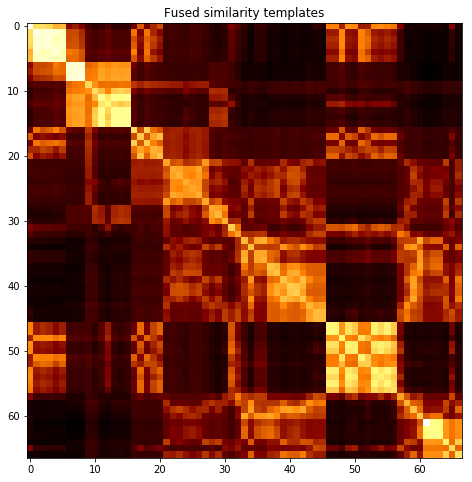

subject 18; gesture 4_1_1


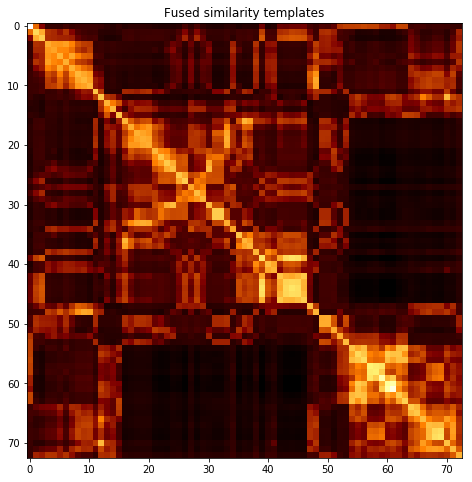

subject 18; gesture 2_0_1


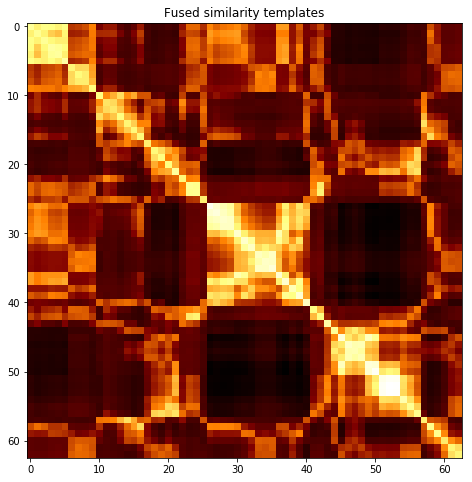

subject 18; gesture 4_1_2


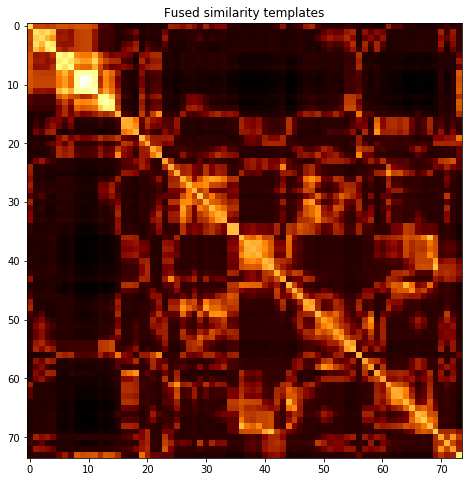

subject 18; gesture 2_0_2


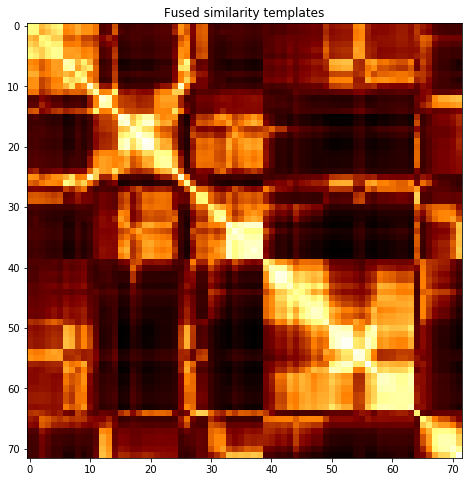

subject 18; gesture 1_1_2


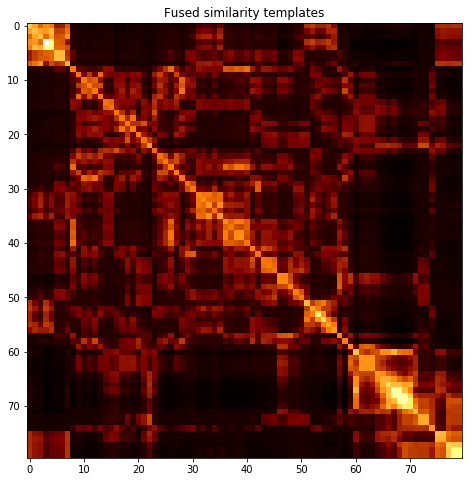

subject 18; gesture 2_1_2


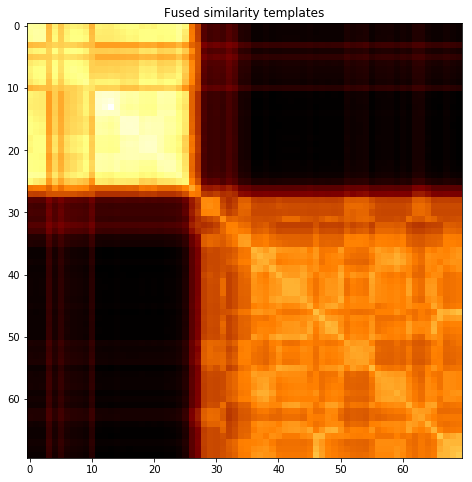

subject 18; gesture 4_0_1


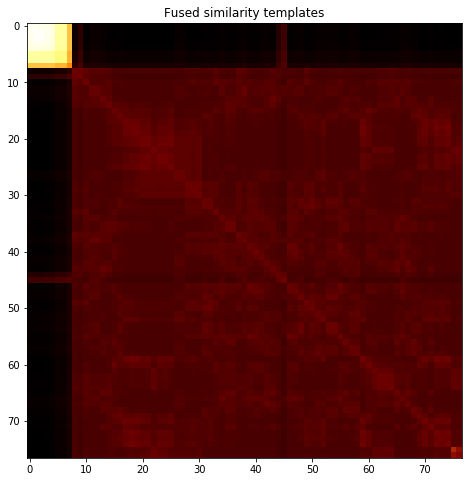

subject 18; gesture 3_0_2


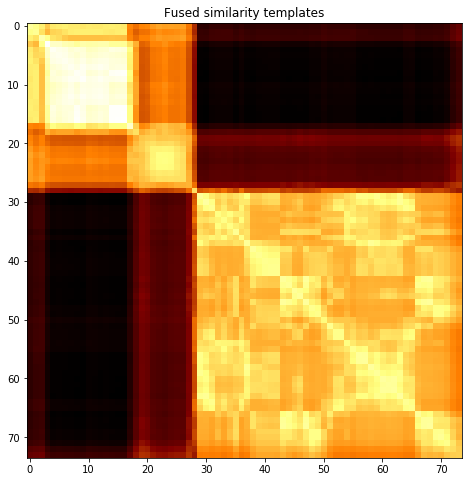

subject 18; gesture 1_1_1


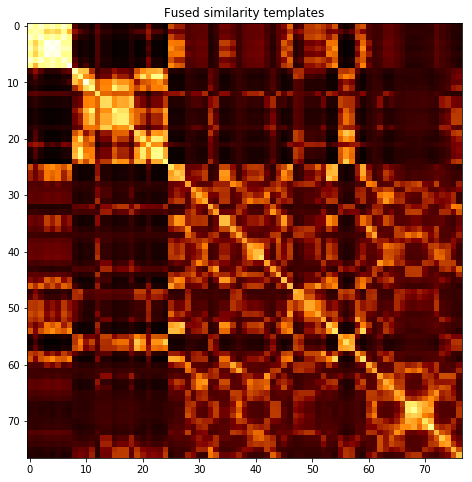

subject 18; gesture 3_1_2


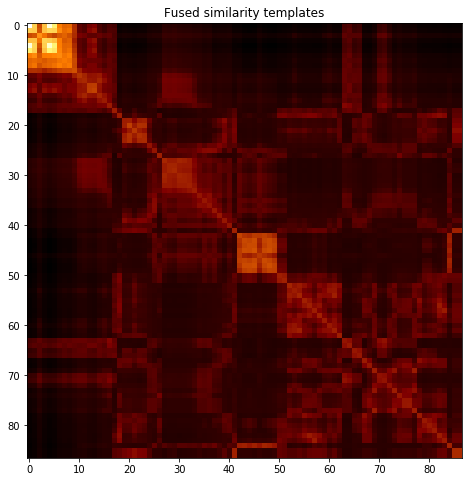

subject 18; gesture 2_1_1


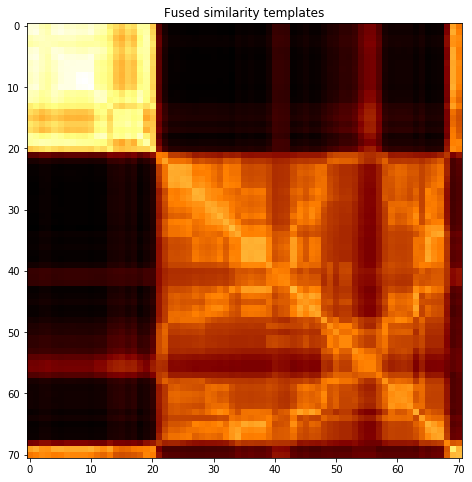

subject 18; gesture 1_0_1


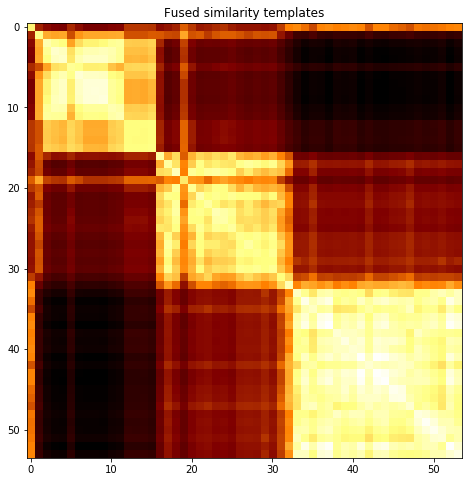

subject 18; gesture 3_1_1


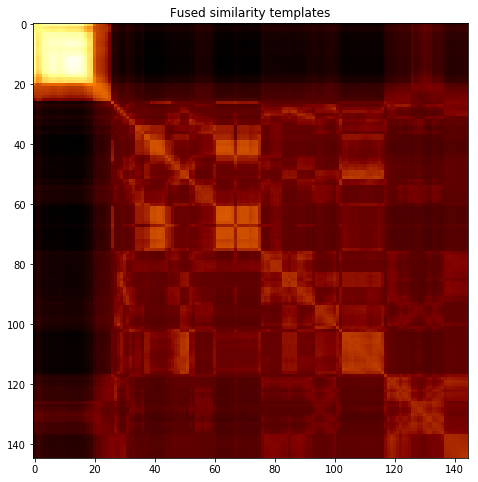

subject 18; gesture 1_0_2


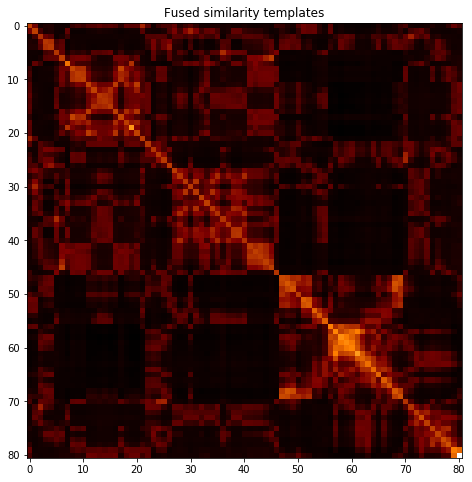

subject 18; gesture 4_0_2


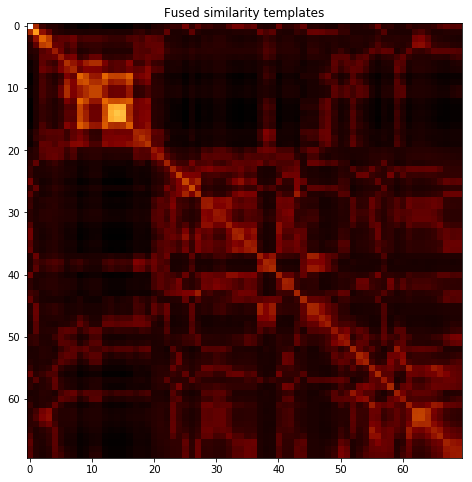

subject 29; gesture 3_0_1


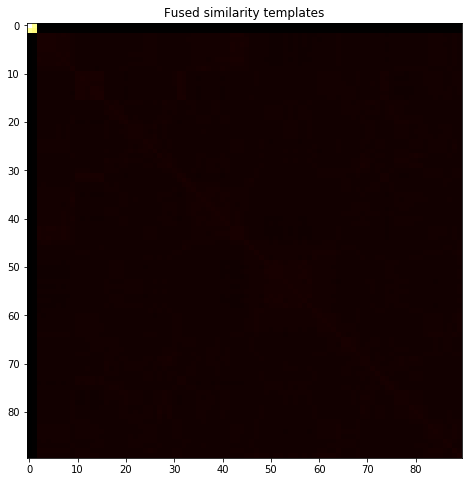

subject 29; gesture 4_1_1


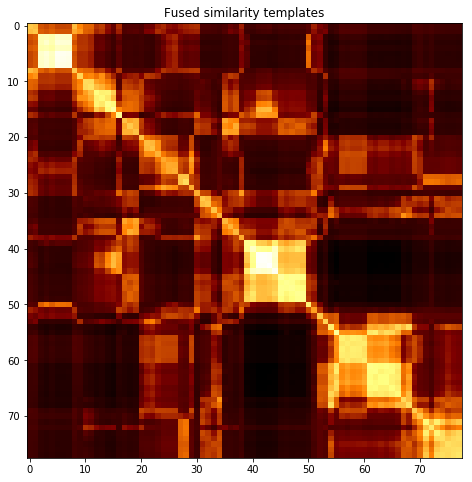

subject 29; gesture 2_0_1


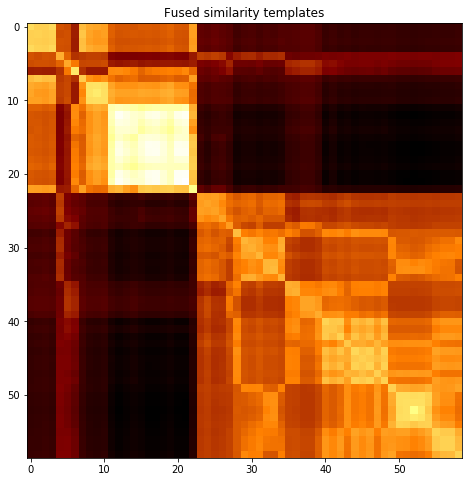

subject 29; gesture 4_1_2


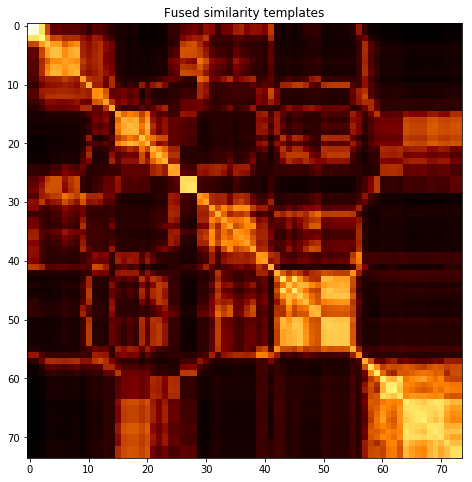

subject 29; gesture 2_0_2


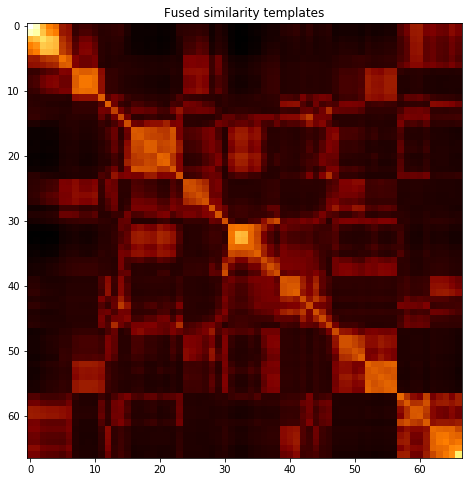

subject 29; gesture 1_1_2


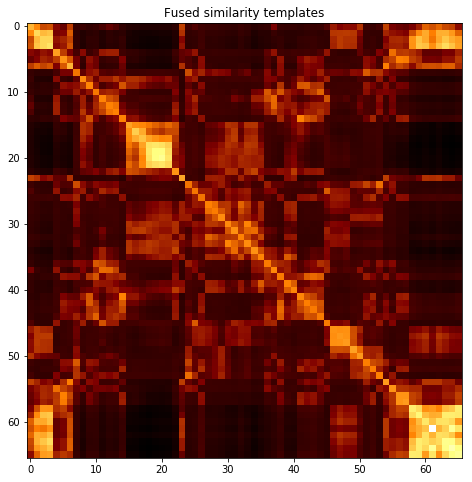

subject 29; gesture 2_1_2


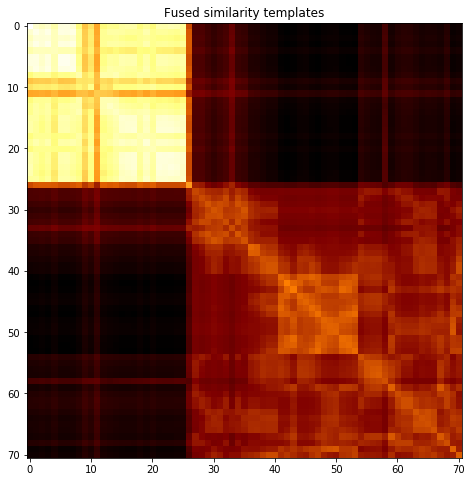

subject 29; gesture 4_0_1


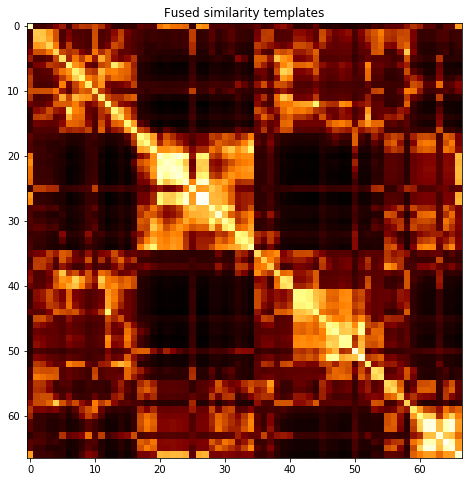

subject 29; gesture 3_0_2


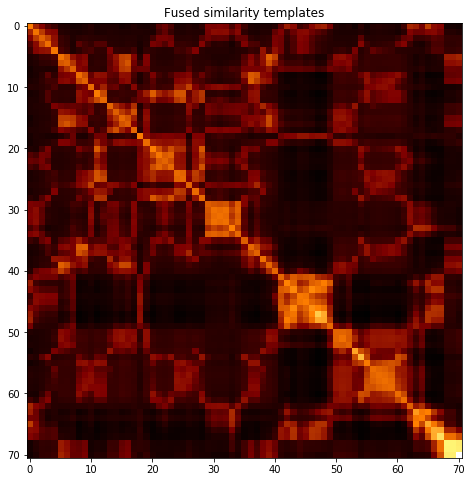

subject 29; gesture 1_1_1


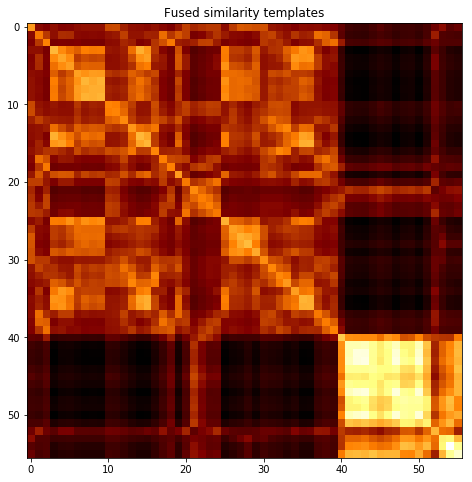

subject 29; gesture 3_1_2


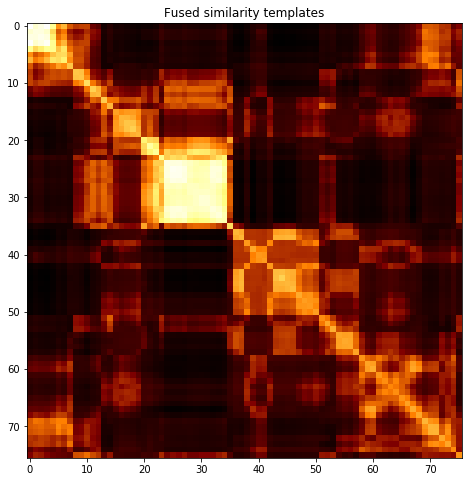

subject 29; gesture 2_1_1


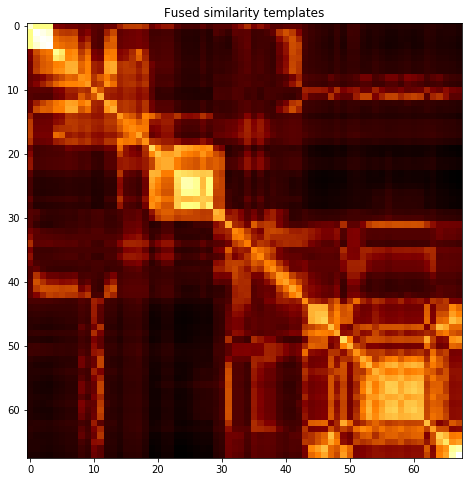

subject 29; gesture 1_0_1


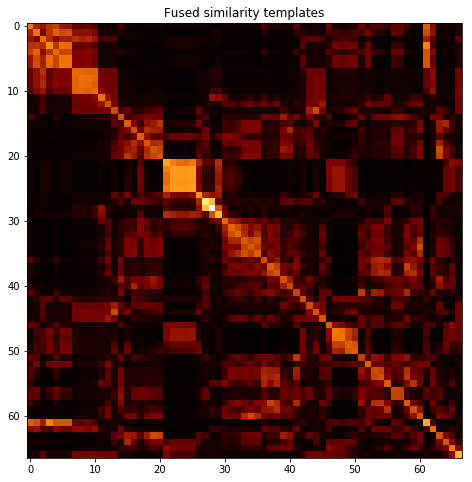

subject 29; gesture 3_1_1


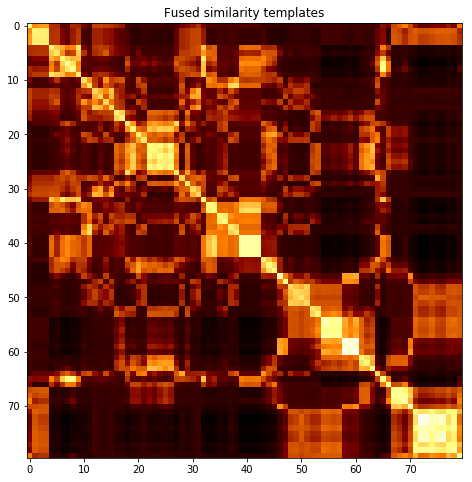

subject 29; gesture 1_0_2


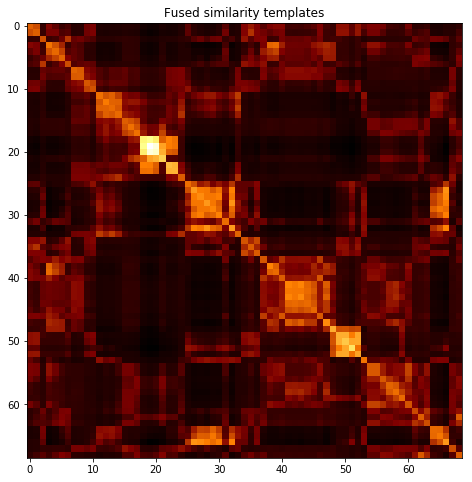

subject 29; gesture 4_0_2


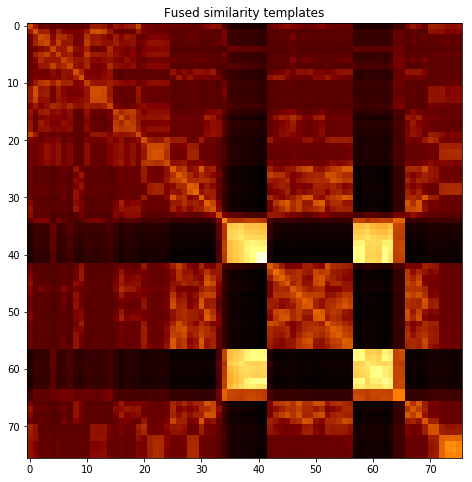

subject 15; gesture 3_0_1


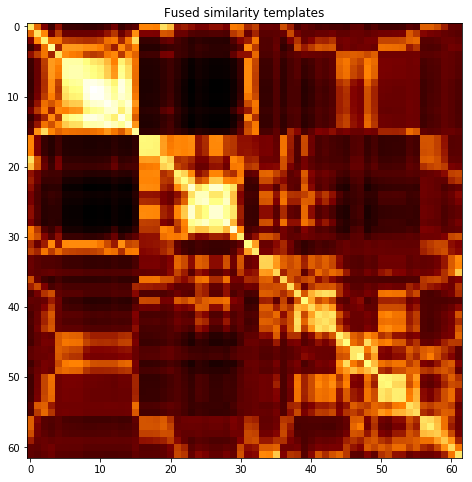

subject 15; gesture 4_1_1


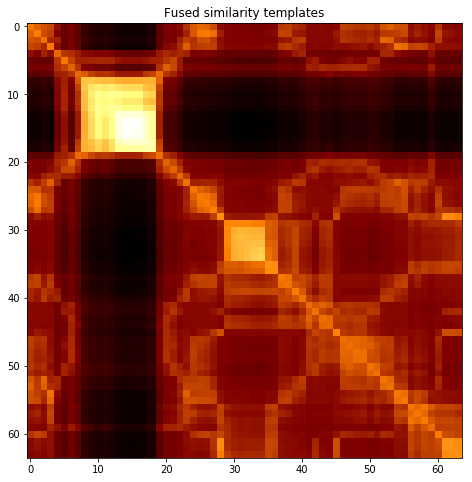

subject 15; gesture 2_0_1


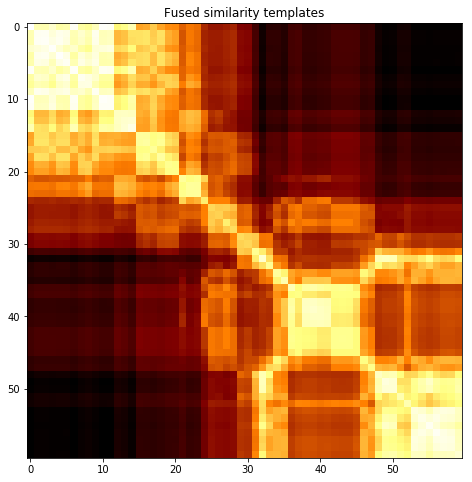

subject 15; gesture 4_1_2


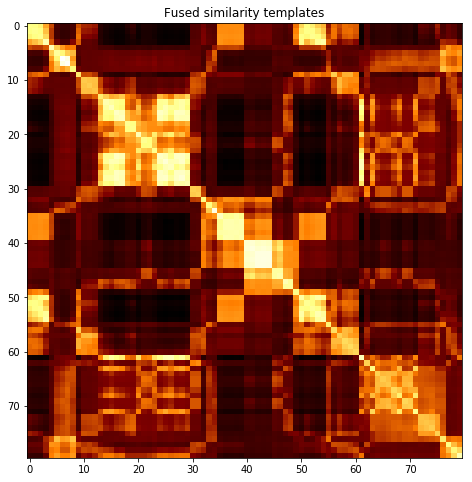

subject 15; gesture 2_0_2


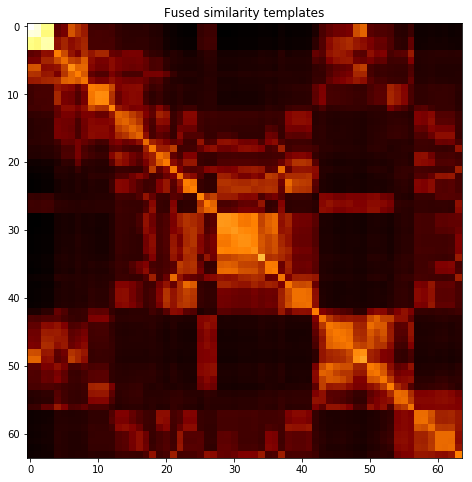

subject 15; gesture 1_1_2


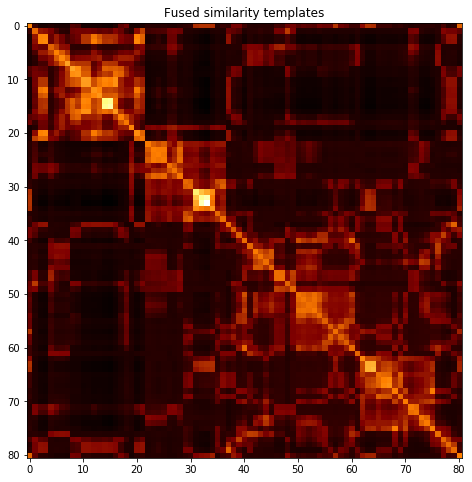

subject 15; gesture 2_1_2


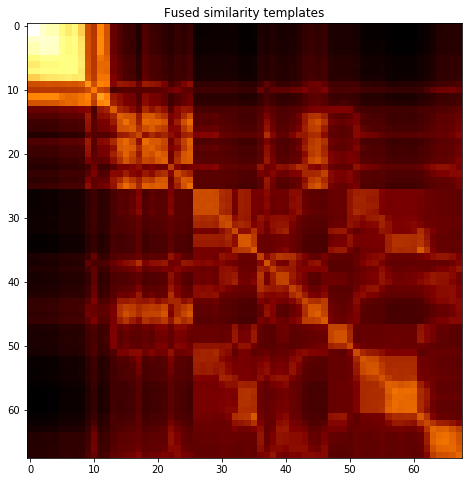

subject 15; gesture 4_0_1


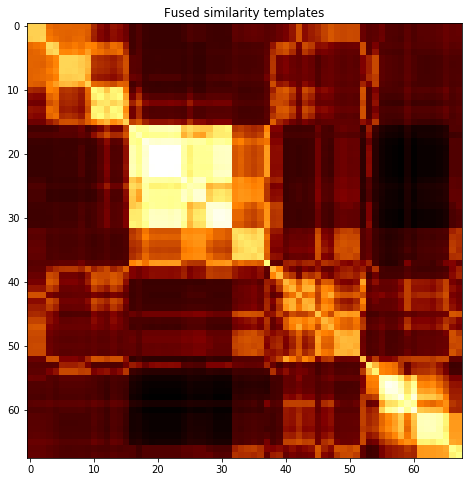

subject 15; gesture 3_0_2


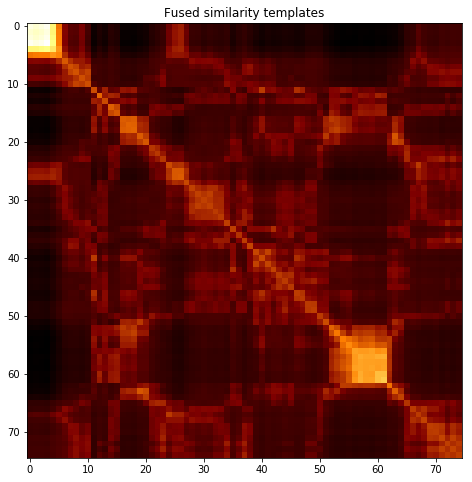

subject 15; gesture 1_1_1


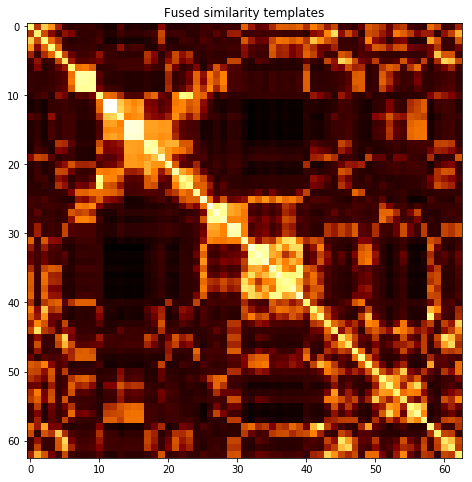

subject 15; gesture 3_1_2


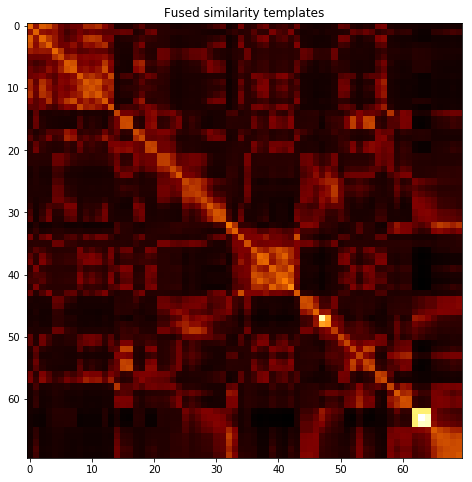

subject 15; gesture 2_1_1


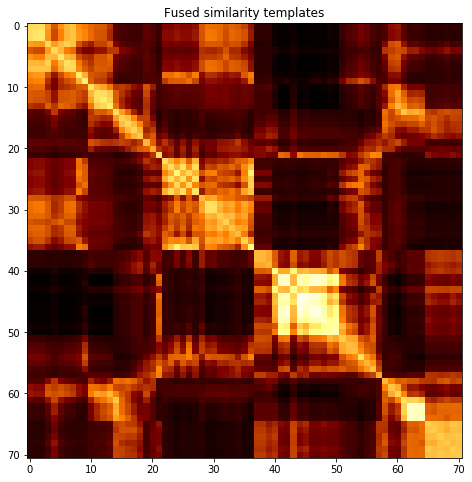

subject 15; gesture 1_0_1


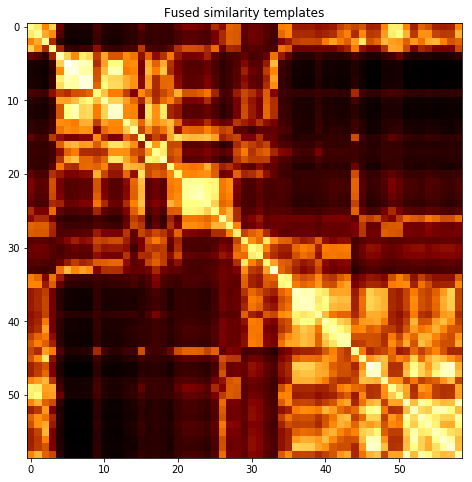

subject 15; gesture 3_1_1


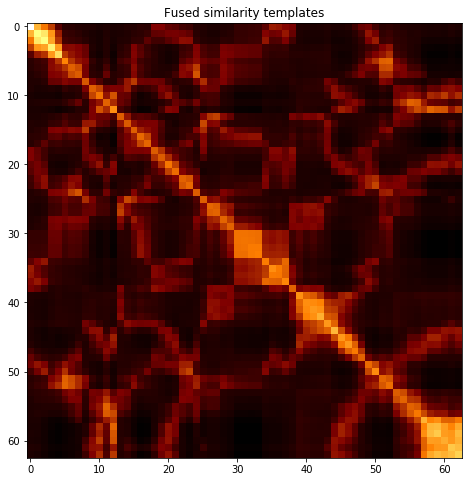

subject 15; gesture 1_0_2


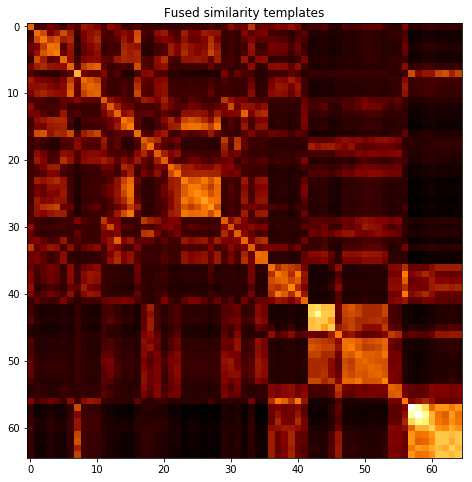

subject 15; gesture 4_0_2


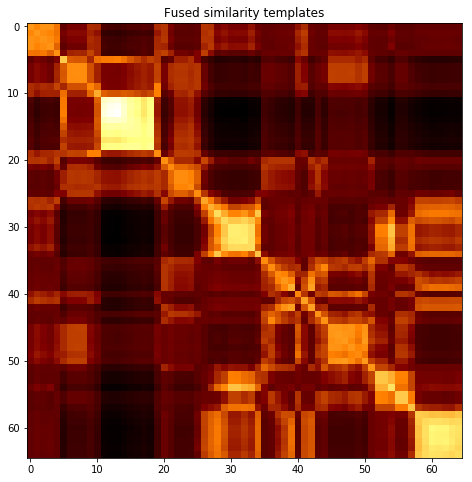

subject 28; gesture 3_0_1


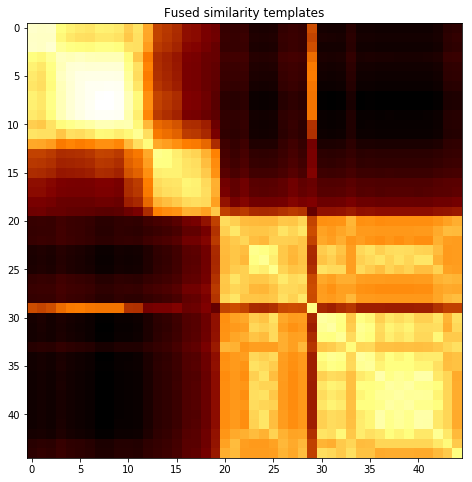

subject 28; gesture 4_1_1


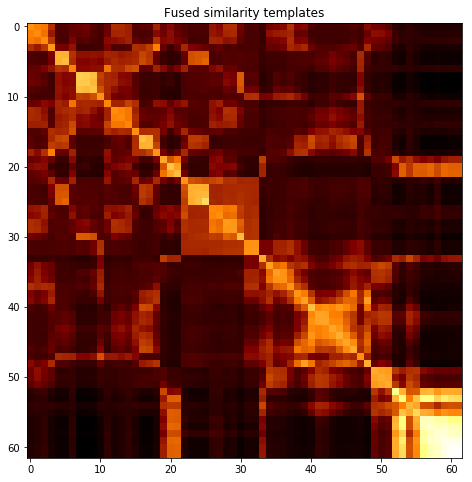

subject 28; gesture 2_0_1


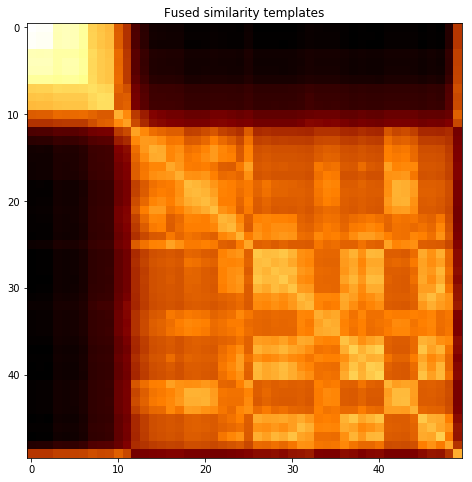

subject 28; gesture 4_1_2


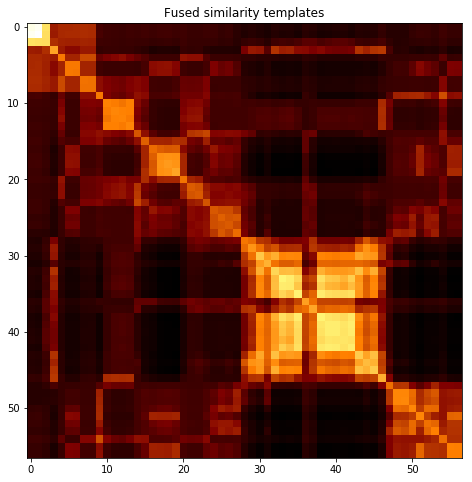

subject 28; gesture 2_0_2


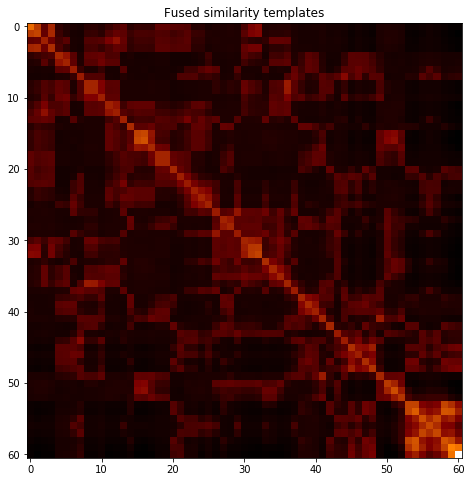

subject 28; gesture 1_1_2


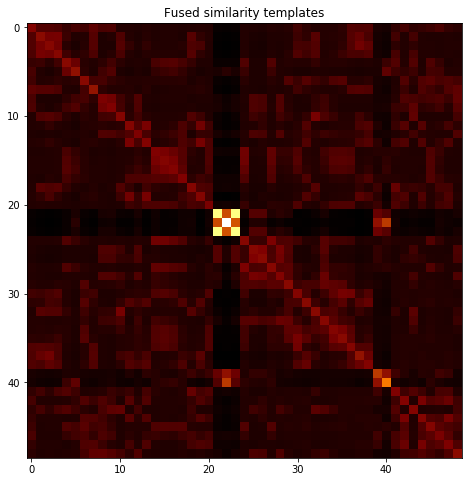

subject 28; gesture 2_1_2


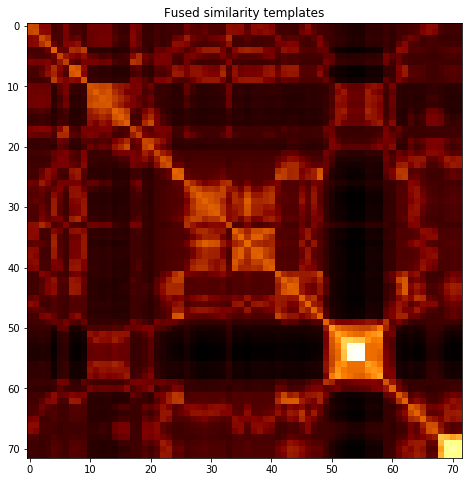

subject 28; gesture 4_0_1


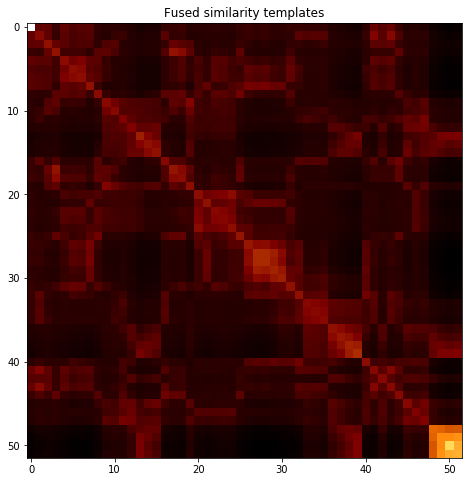

subject 28; gesture 3_0_2


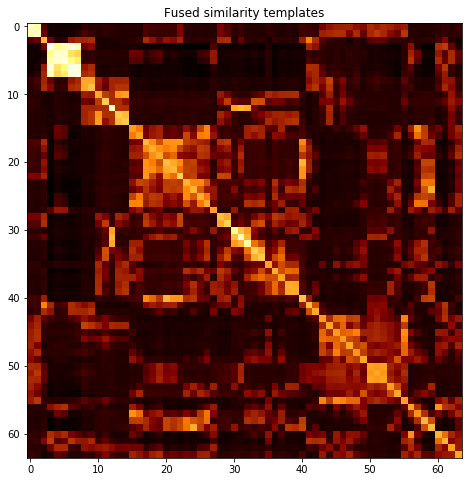

subject 28; gesture 1_1_1


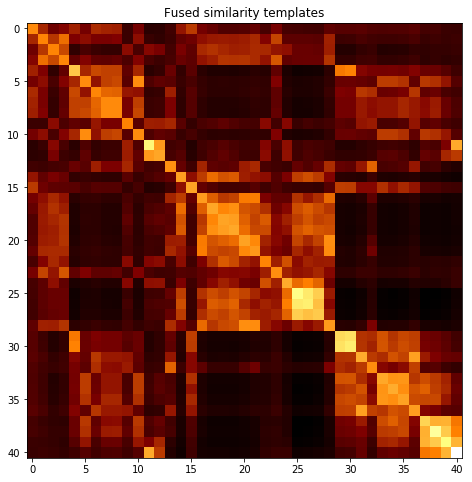

subject 28; gesture 3_1_2


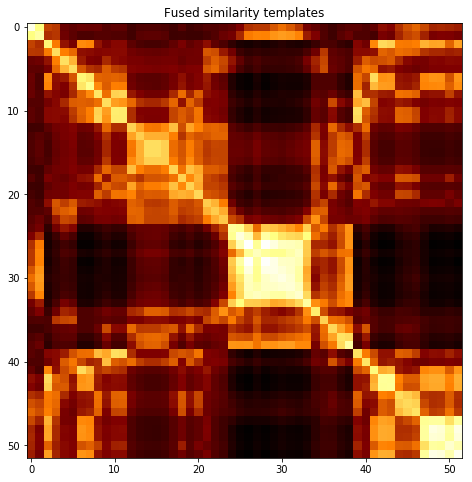

subject 28; gesture 2_1_1


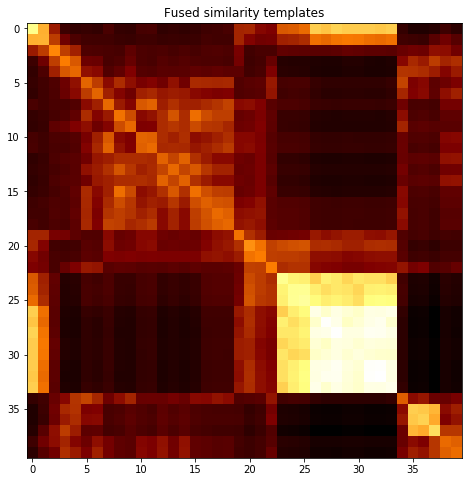

subject 28; gesture 1_0_1


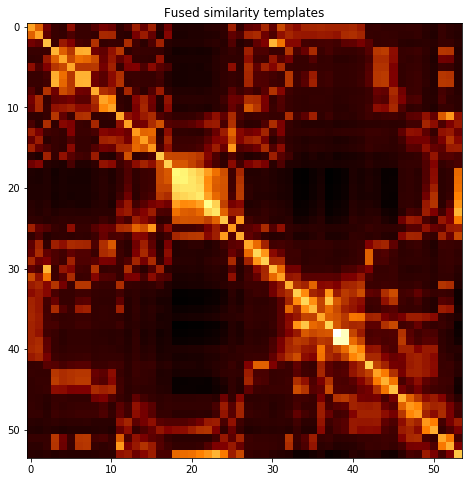

subject 28; gesture 3_1_1


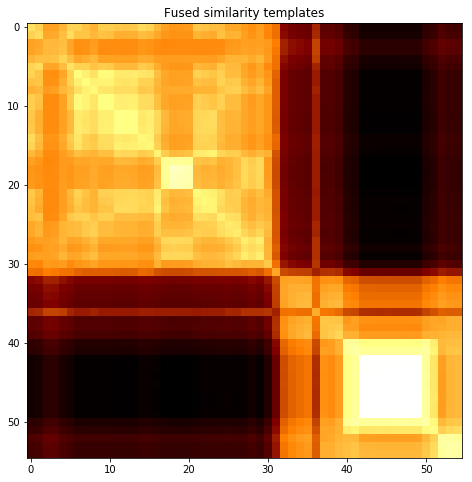

subject 28; gesture 1_0_2


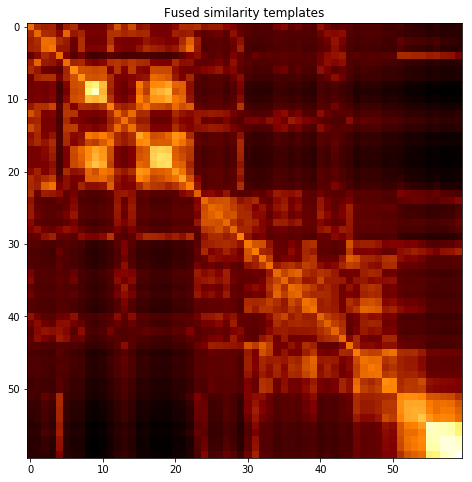

subject 28; gesture 4_0_2


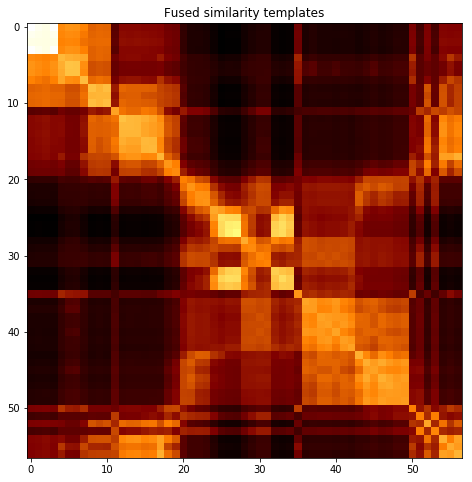

subject 12; gesture 3_0_1


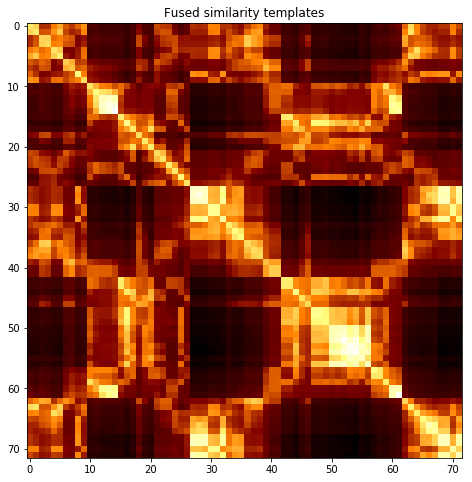

subject 12; gesture 4_1_1


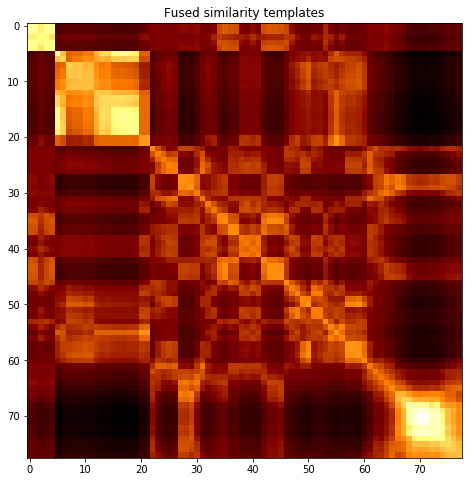

subject 12; gesture 2_0_1


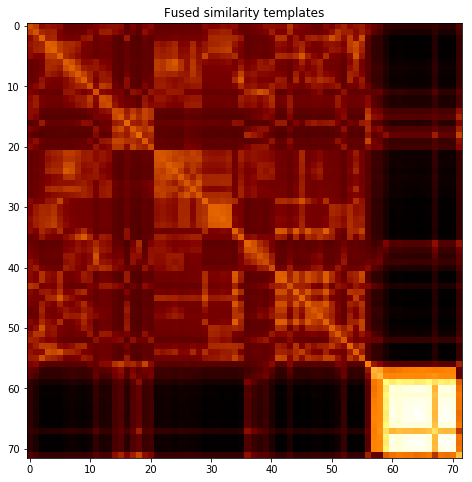

subject 12; gesture 4_1_2


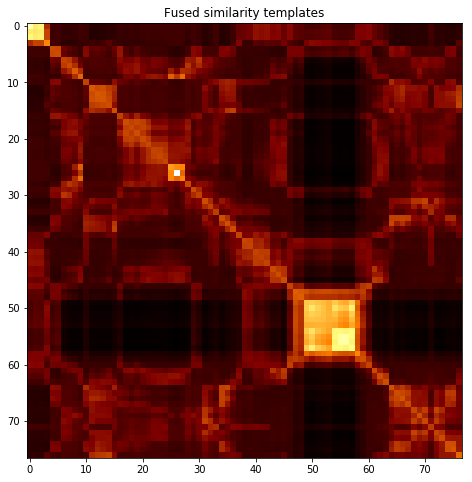

subject 12; gesture 2_0_2


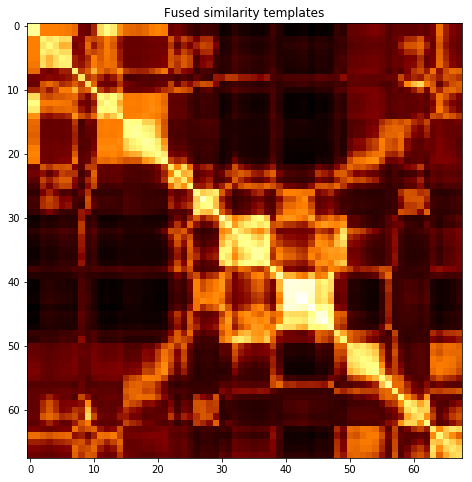

subject 12; gesture 1_1_2


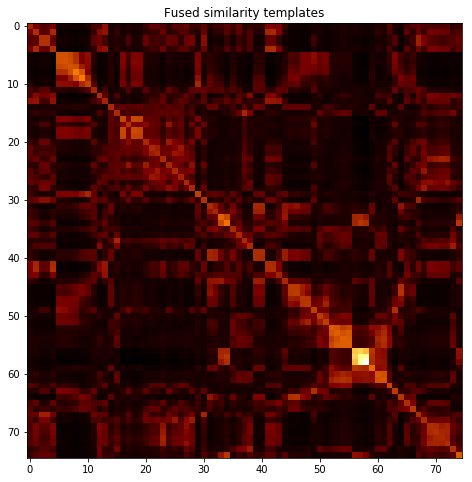

subject 12; gesture 2_1_2


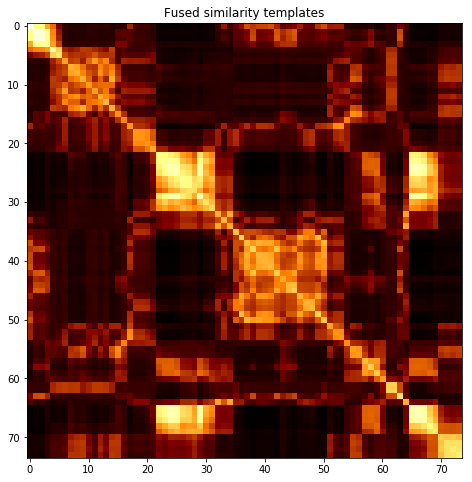

subject 12; gesture 4_0_1


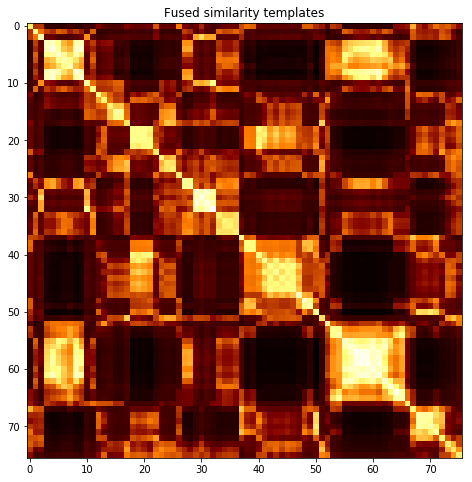

subject 12; gesture 3_0_2


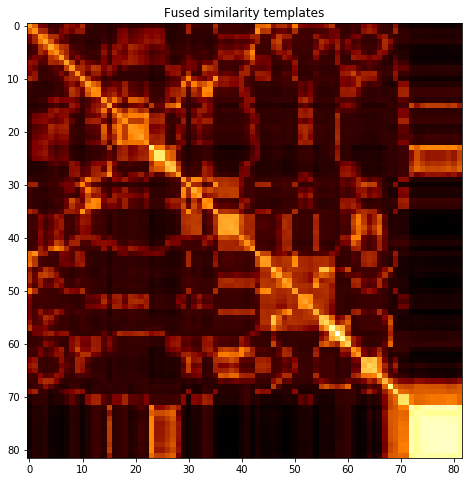

subject 12; gesture 1_1_1


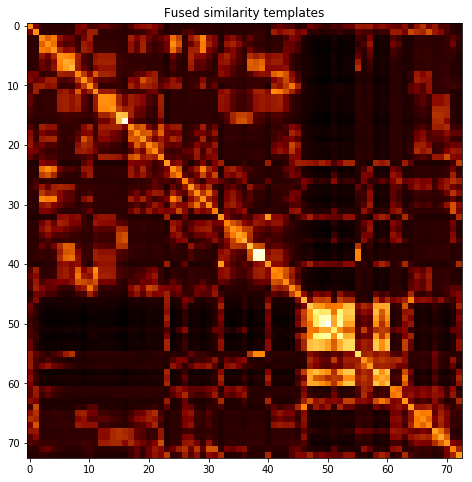

subject 12; gesture 3_1_2


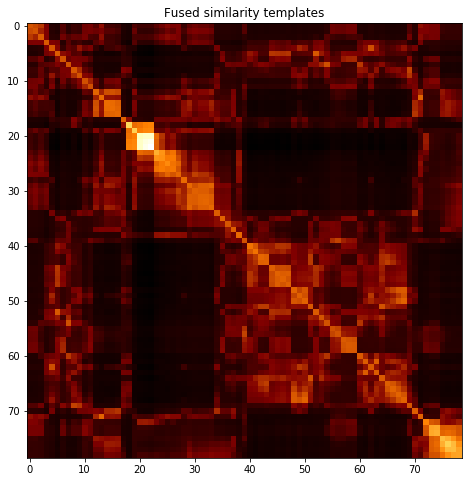

subject 12; gesture 2_1_1


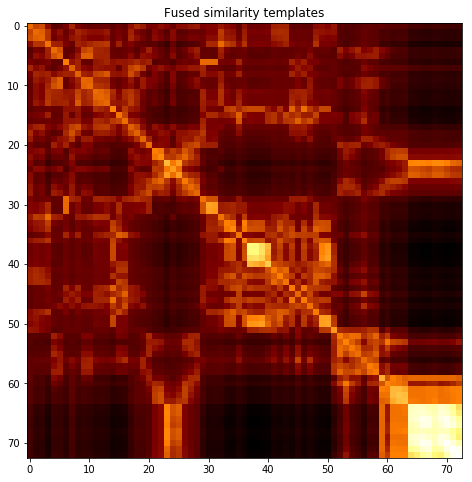

subject 12; gesture 1_0_1


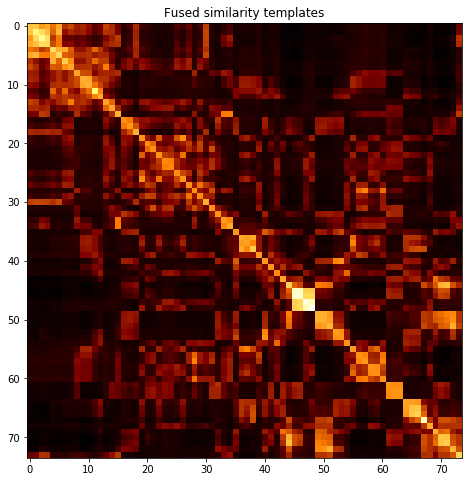

subject 12; gesture 3_1_1


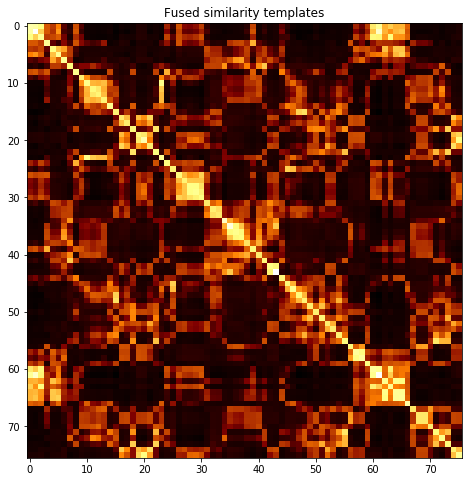

subject 12; gesture 1_0_2


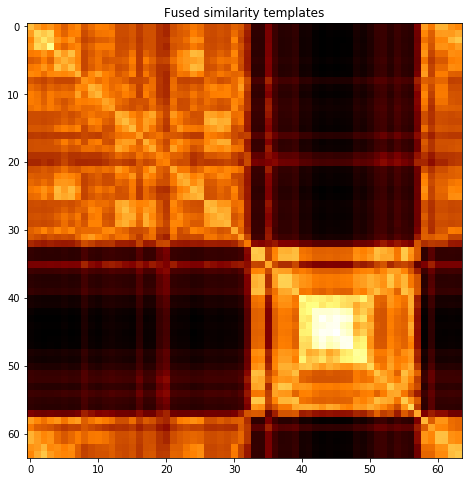

subject 12; gesture 4_0_2


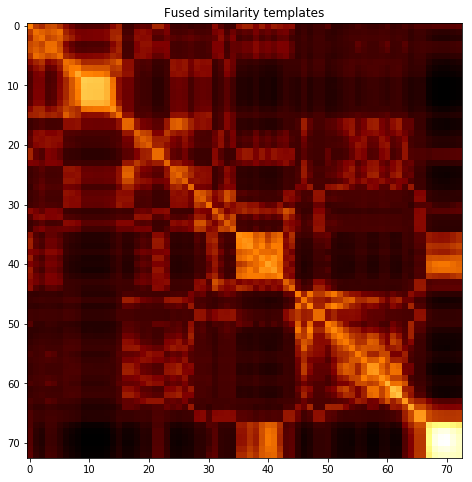

subject 19; gesture 3_0_1


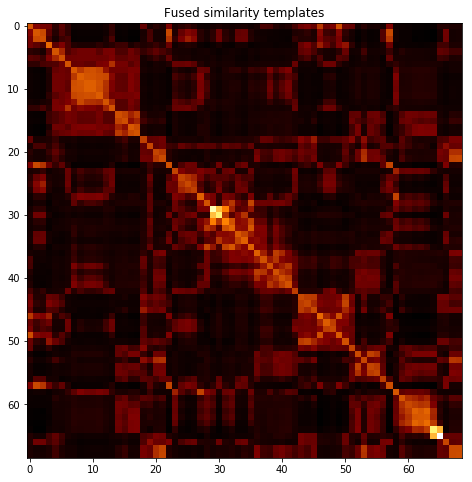

subject 19; gesture 4_1_1


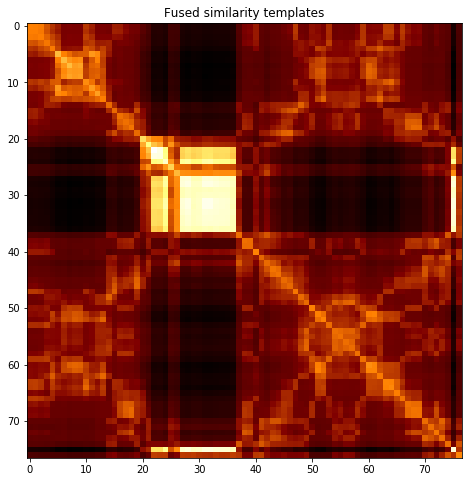

subject 19; gesture 2_0_1


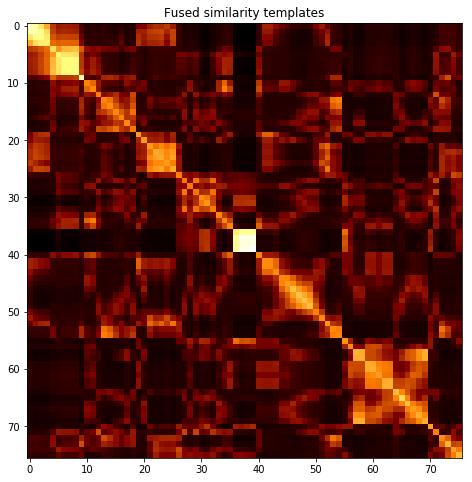

subject 19; gesture 4_1_2


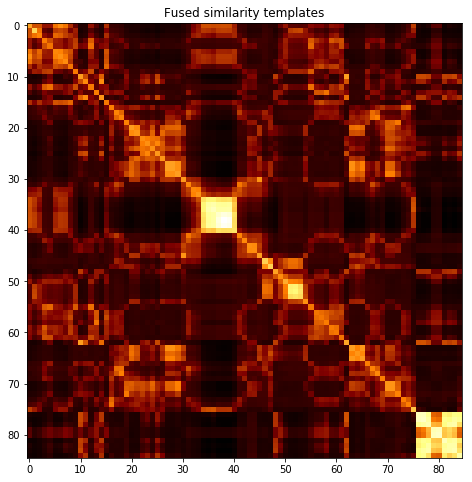

subject 19; gesture 2_0_2


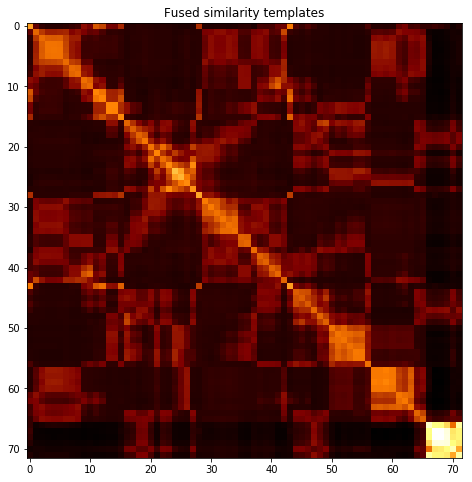

subject 19; gesture 1_1_2


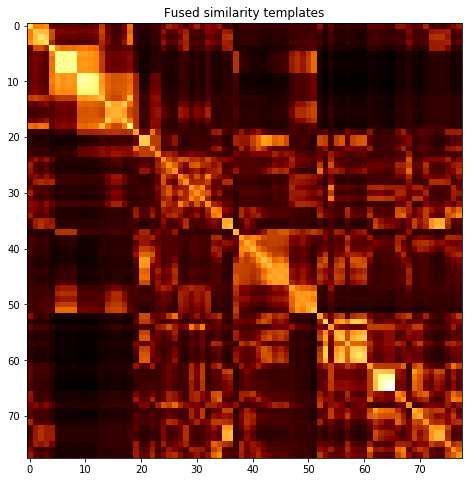

subject 19; gesture 2_1_2


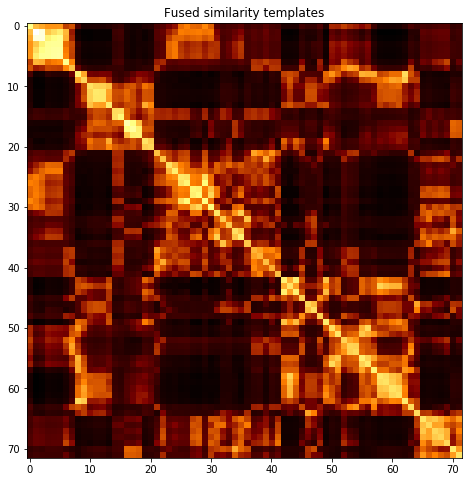

subject 19; gesture 4_0_1


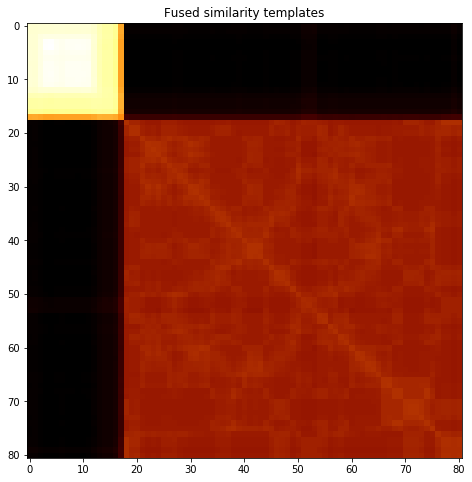

subject 19; gesture 3_0_2


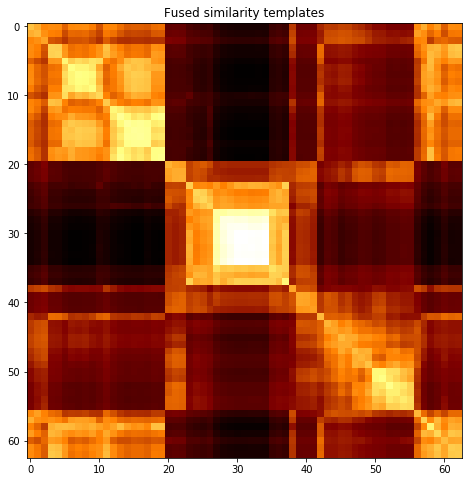

subject 19; gesture 1_1_1


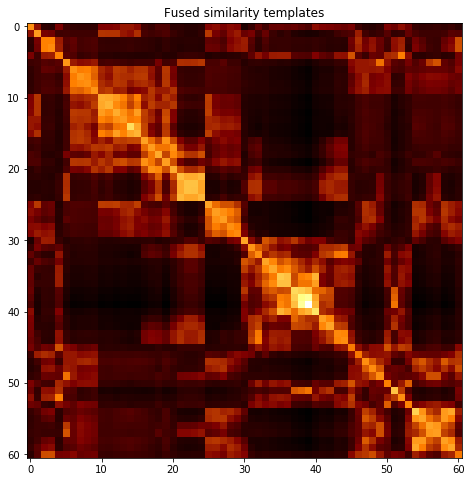

subject 19; gesture 3_1_2


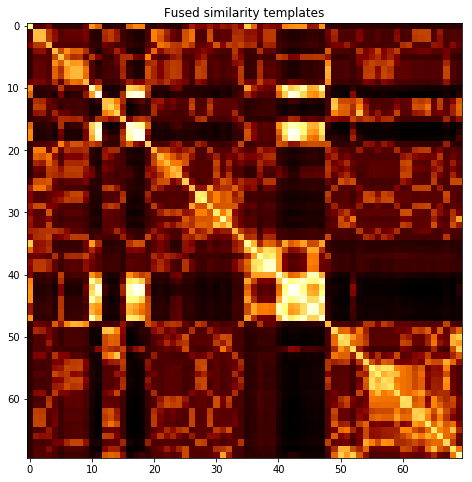

subject 19; gesture 2_1_1


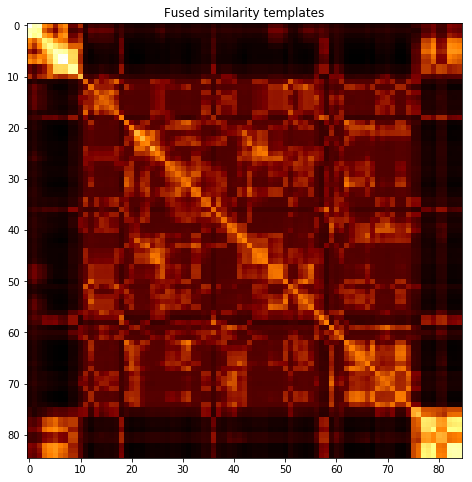

subject 19; gesture 1_0_1


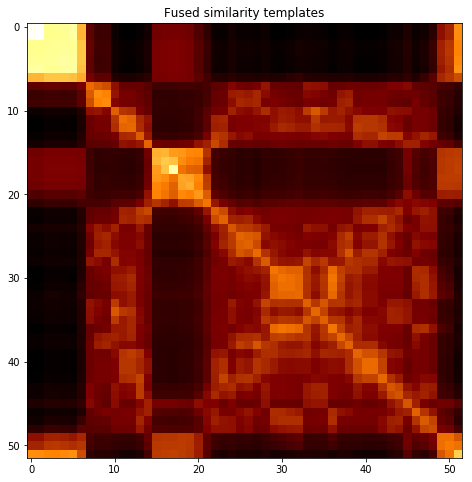

subject 19; gesture 3_1_1


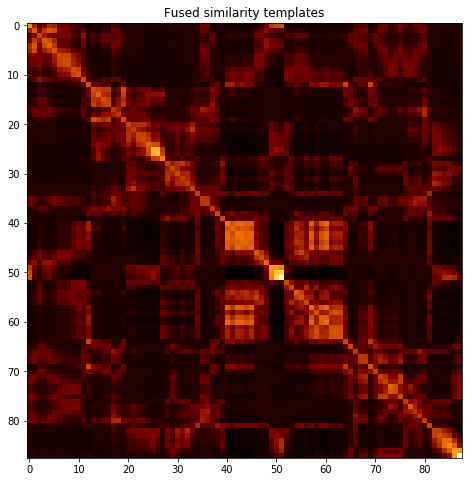

subject 19; gesture 1_0_2


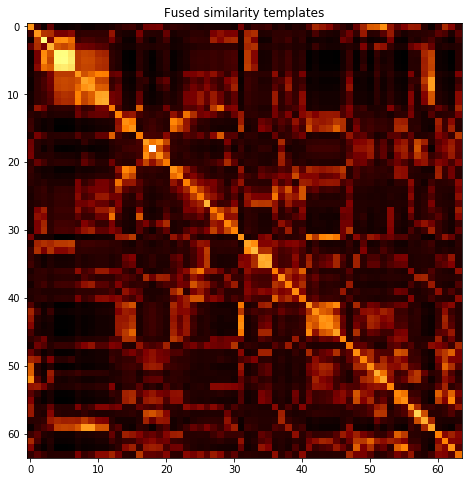

subject 19; gesture 4_0_2


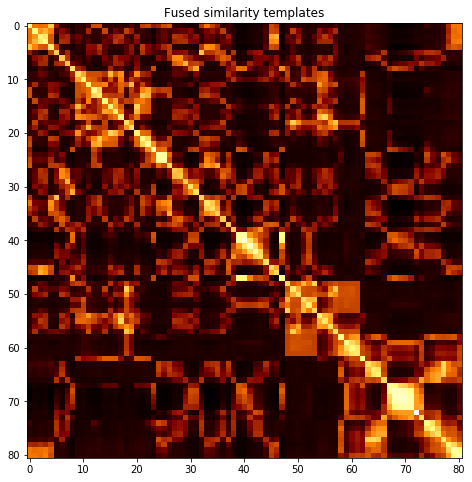

subject 07; gesture 3_0_1


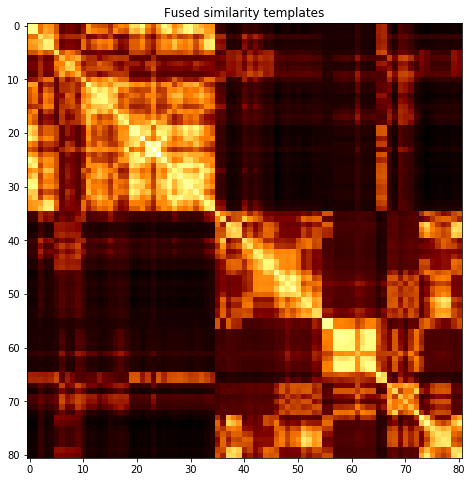

subject 07; gesture 4_1_1


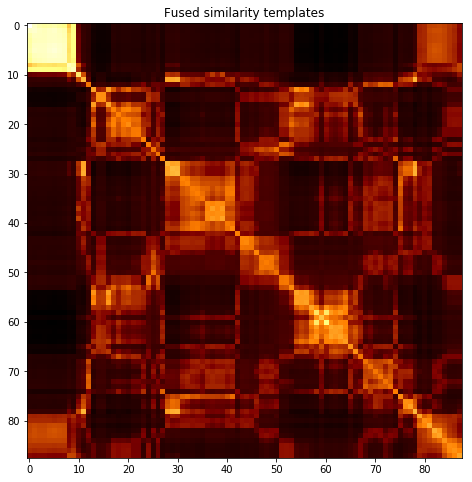

subject 07; gesture 2_0_1


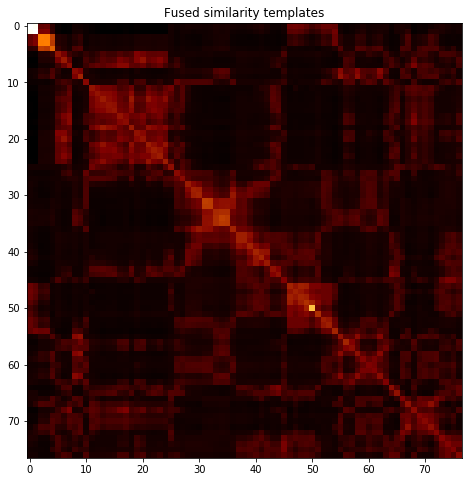

subject 07; gesture 4_1_2


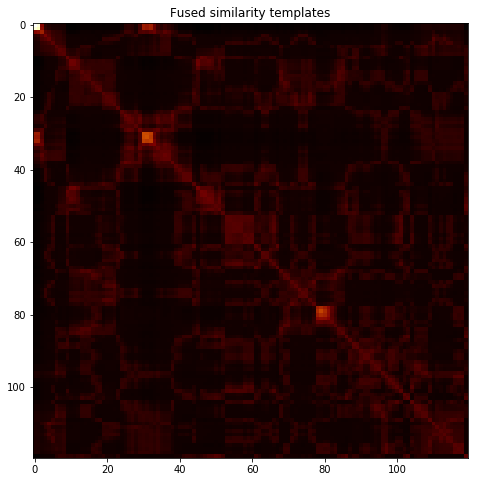

subject 07; gesture 2_0_2


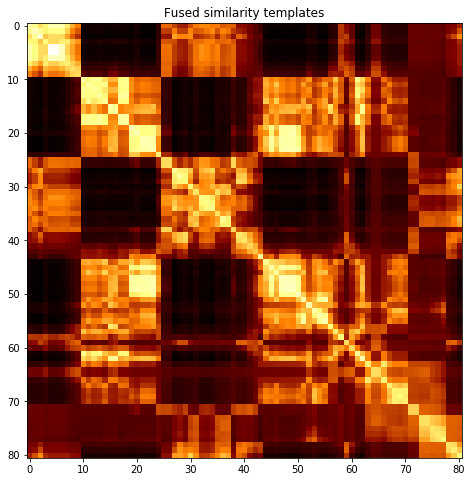

subject 07; gesture 1_1_2


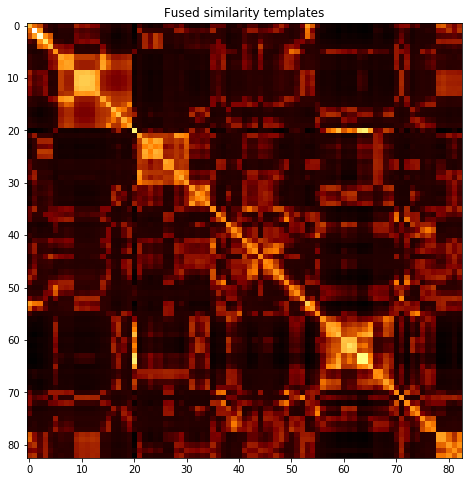

subject 07; gesture 2_1_2


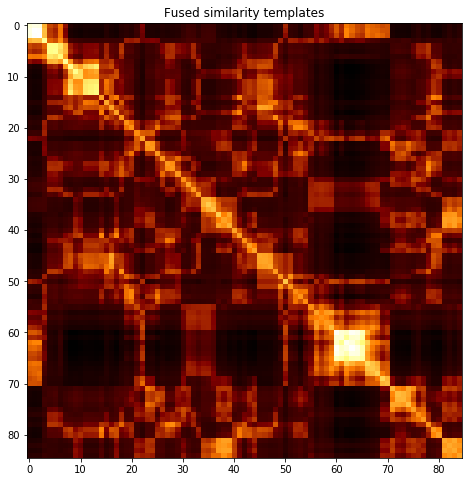

subject 07; gesture 4_0_1


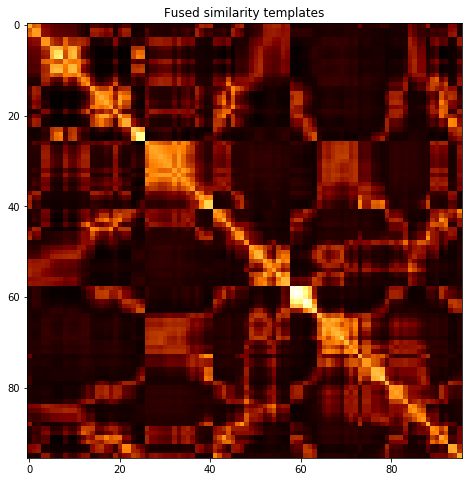

subject 07; gesture 3_0_2


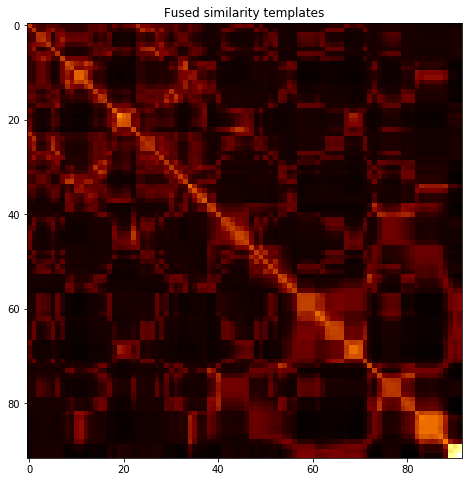

subject 07; gesture 1_1_1


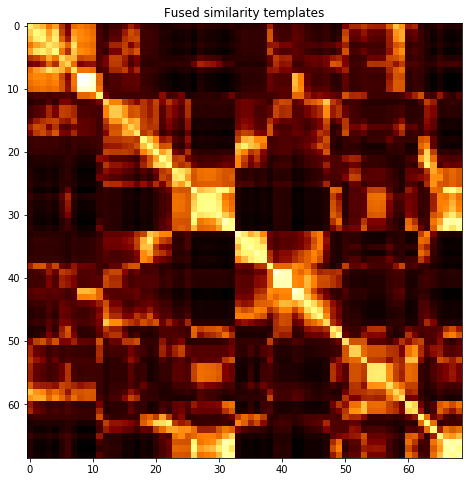

subject 07; gesture 3_1_2


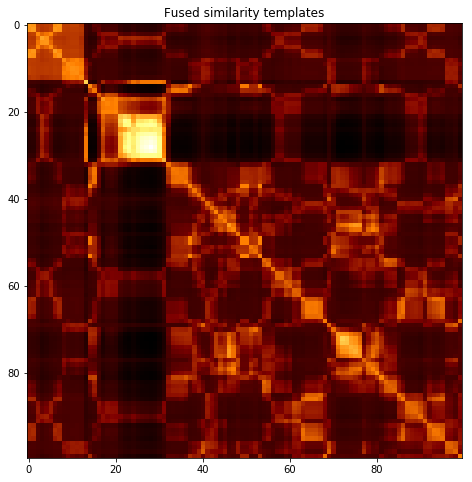

subject 07; gesture 2_1_1


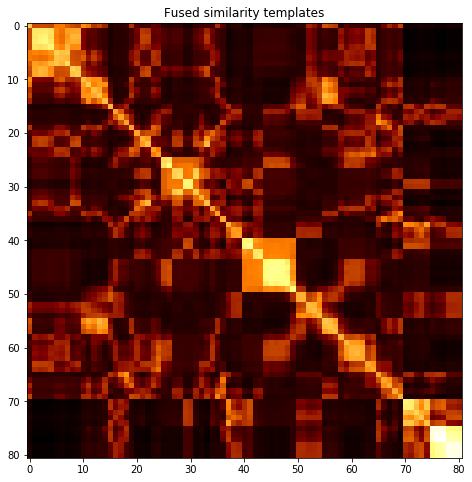

subject 07; gesture 1_0_1


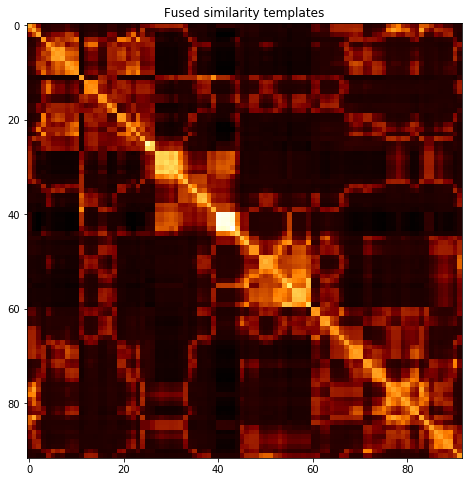

subject 07; gesture 3_1_1


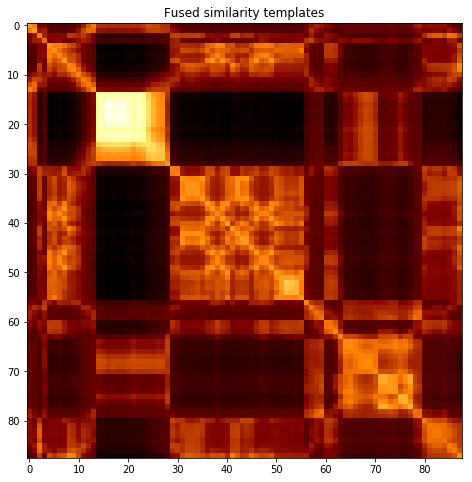

subject 07; gesture 1_0_2


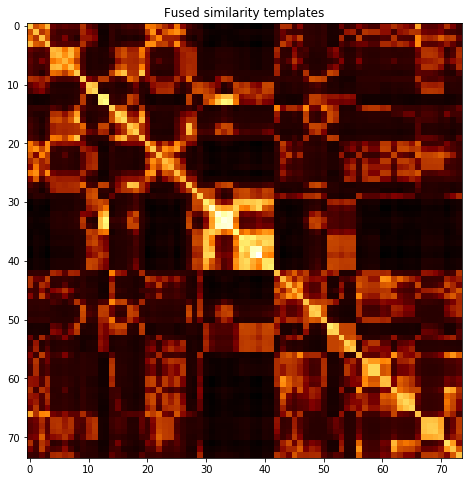

subject 07; gesture 4_0_2


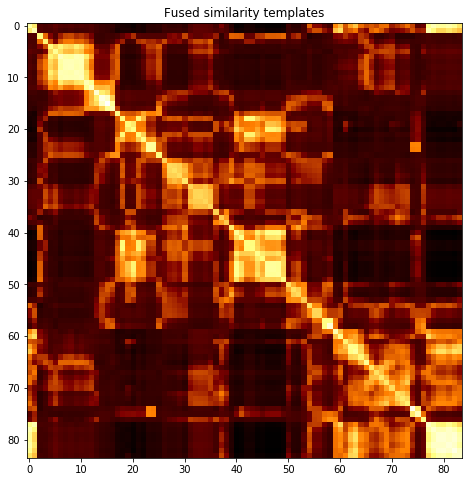

subject 20; gesture 3_0_1


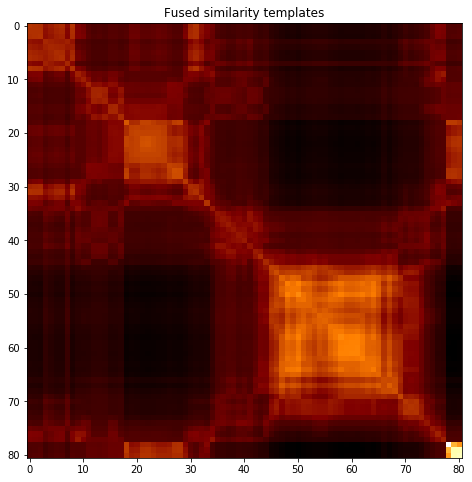

subject 20; gesture 4_1_1


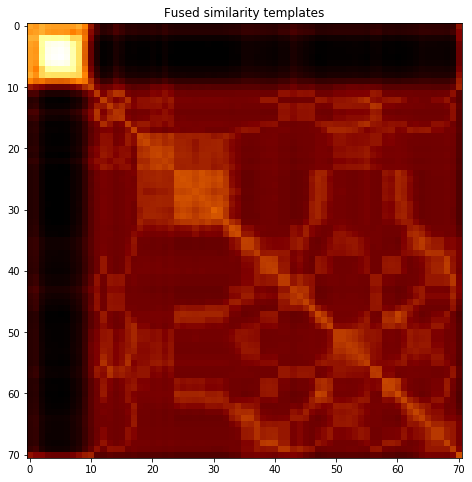

subject 20; gesture 2_0_1


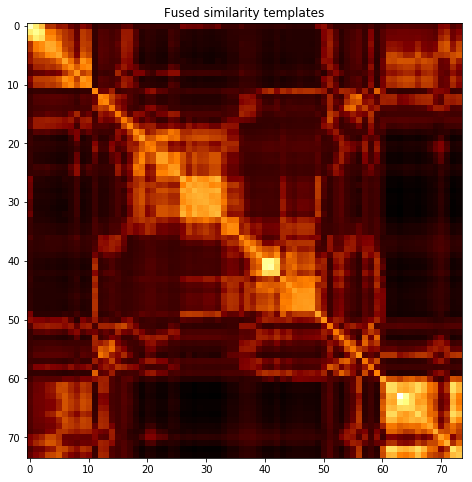

subject 20; gesture 4_1_2


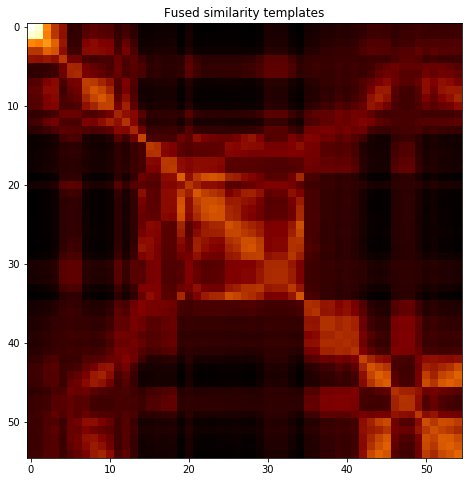

subject 20; gesture 2_0_2


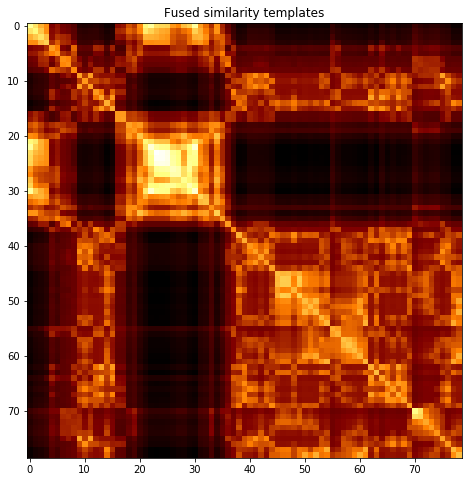

subject 20; gesture 1_1_2


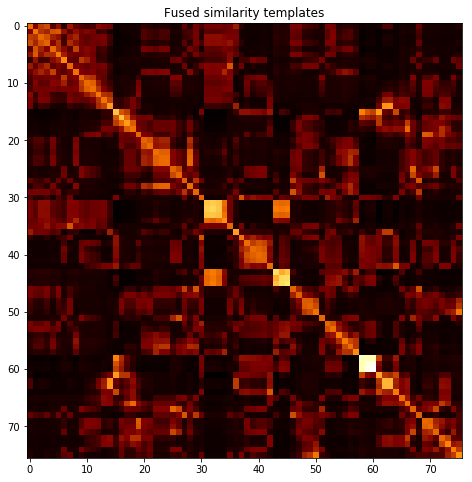

subject 20; gesture 2_1_2


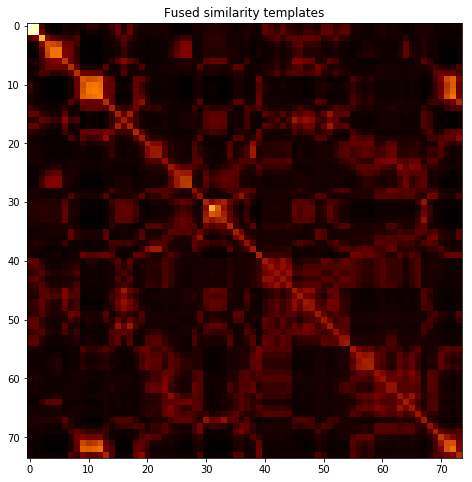

subject 20; gesture 4_0_1


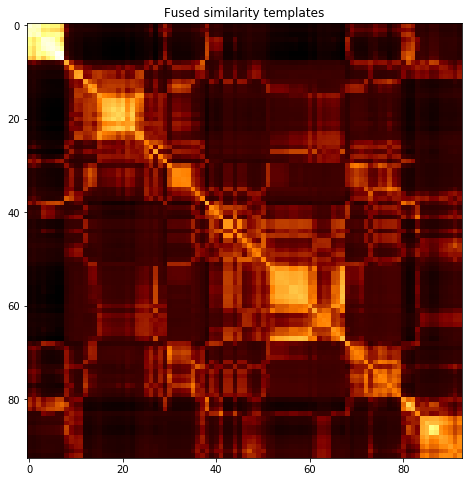

subject 20; gesture 3_0_2


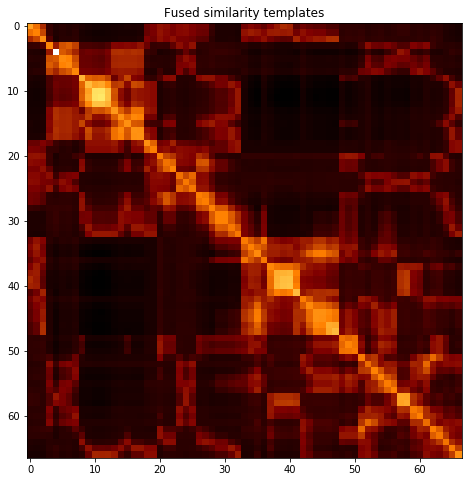

subject 20; gesture 1_1_1


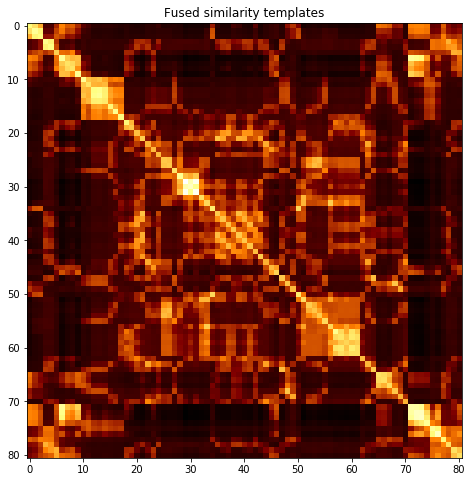

subject 20; gesture 3_1_2


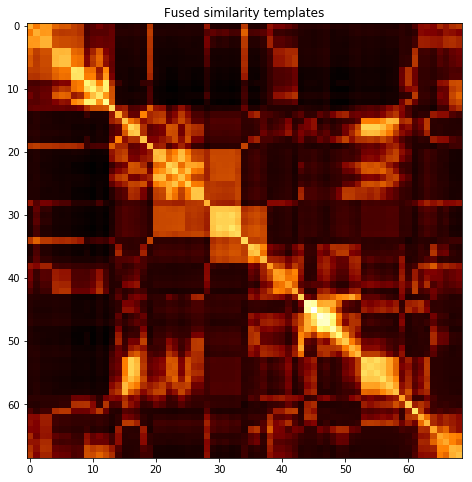

subject 20; gesture 2_1_1


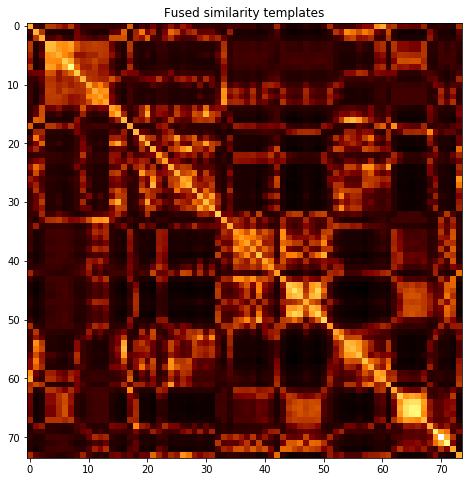

subject 20; gesture 1_0_1


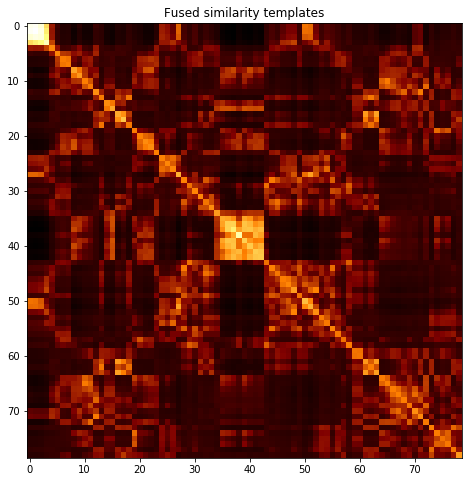

subject 20; gesture 3_1_1


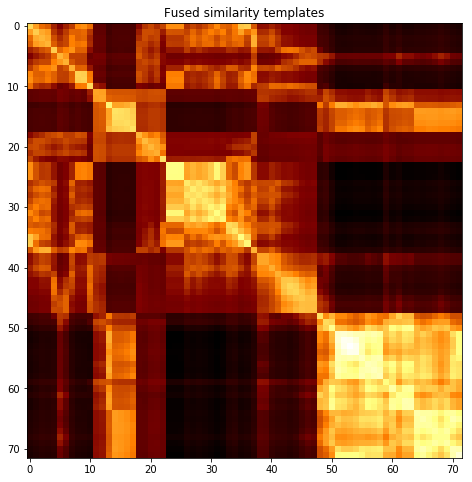

subject 20; gesture 1_0_2


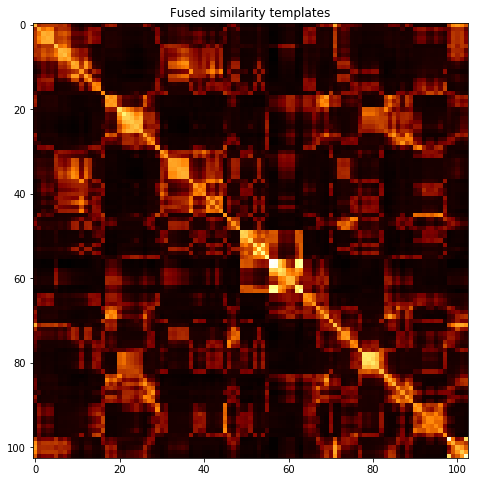

subject 20; gesture 4_0_2


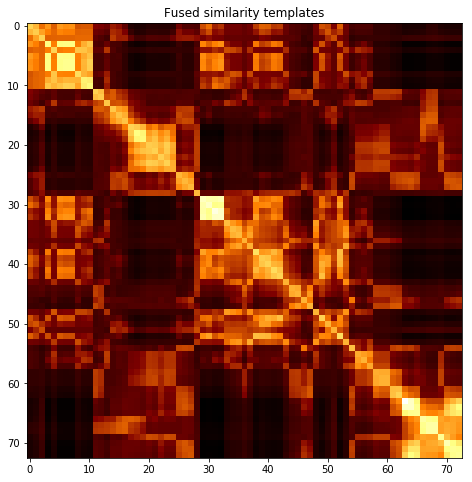

subject 31; gesture 3_0_1


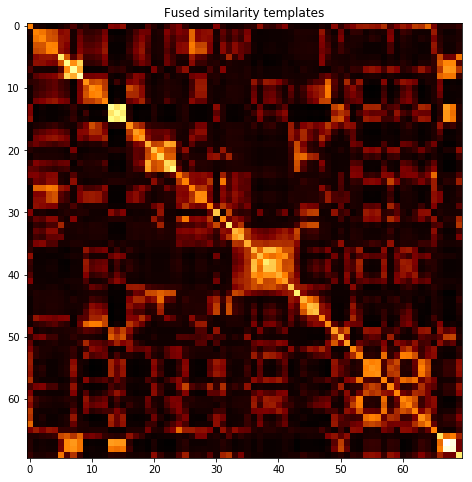

subject 31; gesture 4_1_1


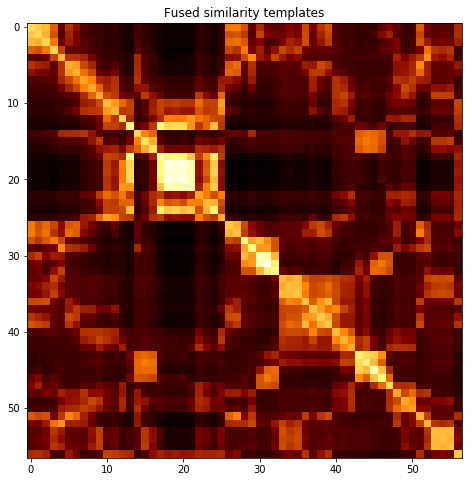

subject 31; gesture 2_0_1


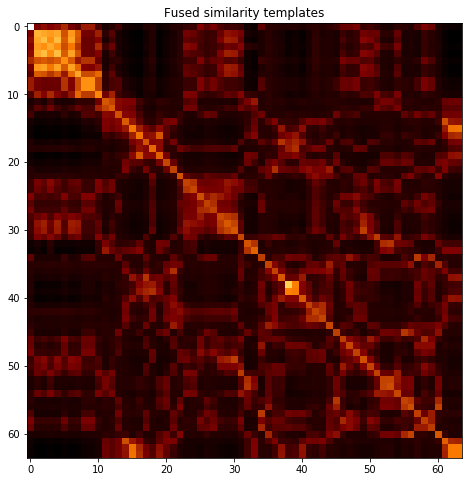

subject 31; gesture 4_1_2


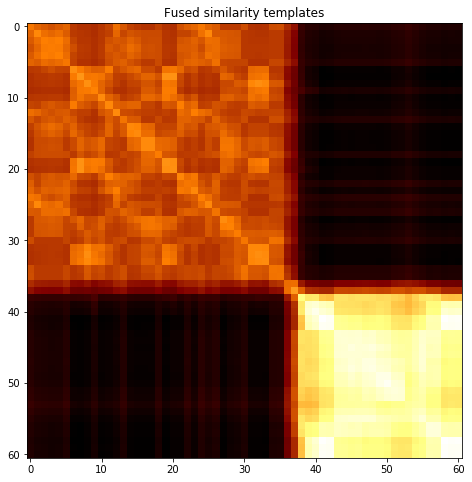

subject 31; gesture 2_0_2


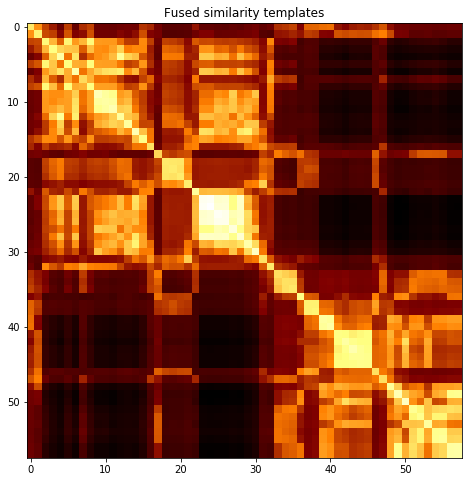

subject 31; gesture 1_1_2


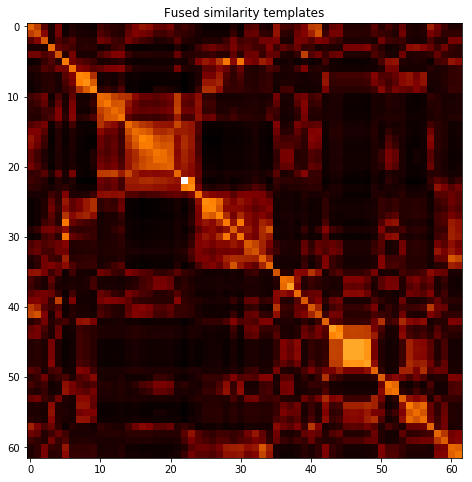

subject 31; gesture 2_1_2


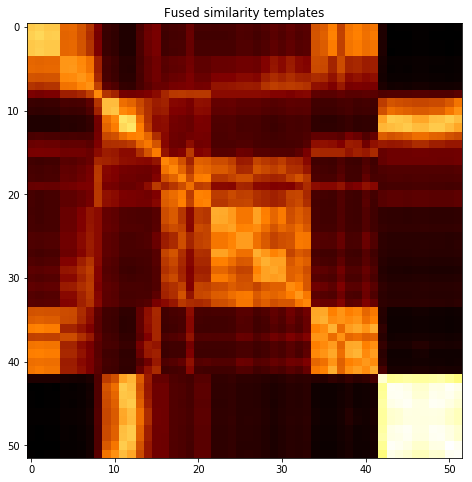

subject 31; gesture 4_0_1


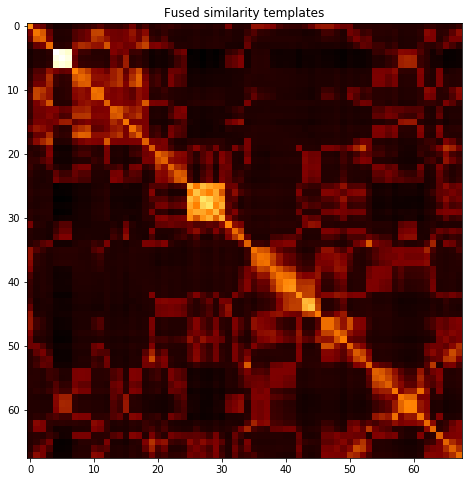

subject 31; gesture 3_0_2


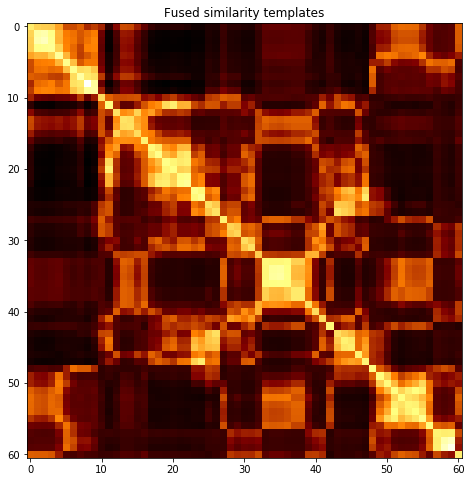

subject 31; gesture 1_1_1


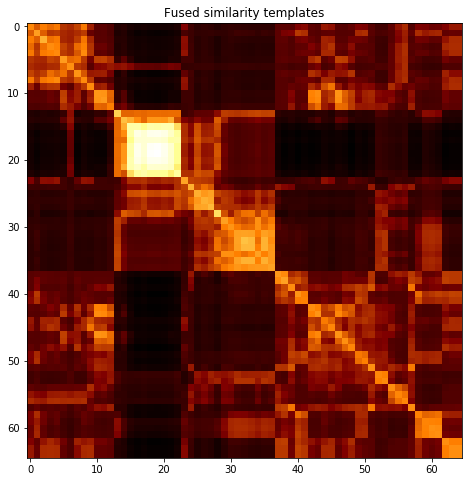

subject 31; gesture 3_1_2


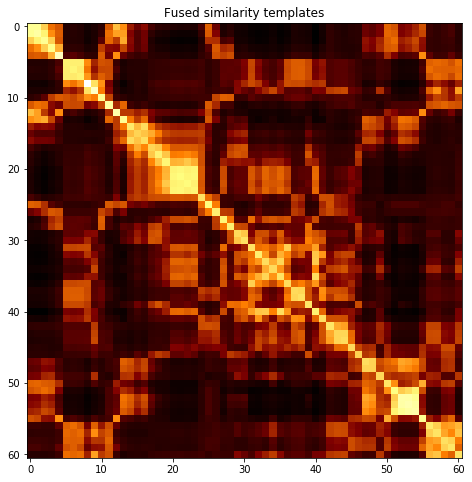

subject 31; gesture 2_1_1


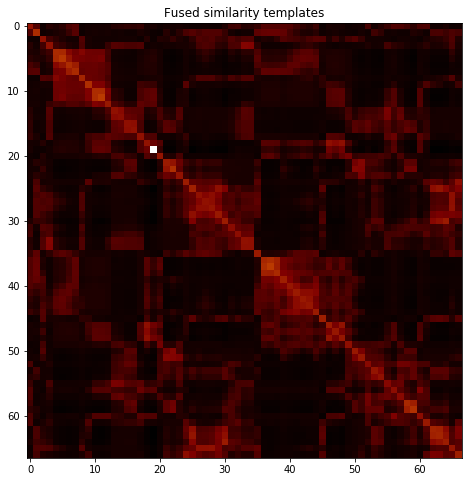

subject 31; gesture 1_0_1


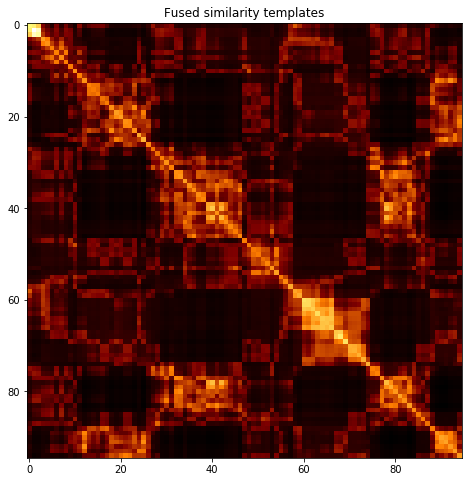

subject 31; gesture 3_1_1


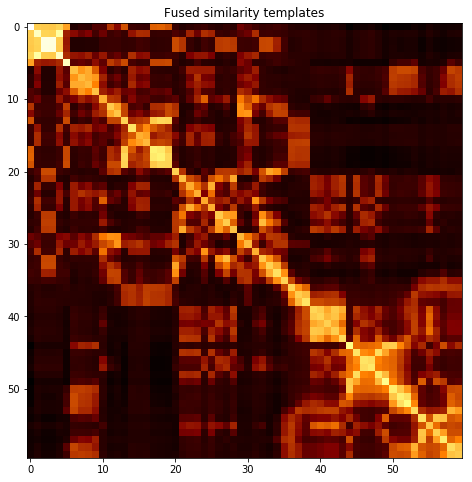

subject 31; gesture 1_0_2


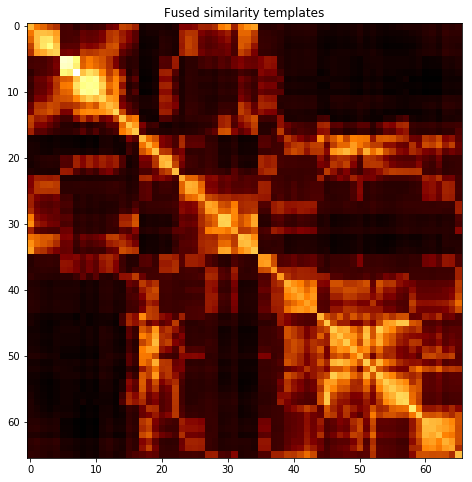

subject 31; gesture 4_0_2


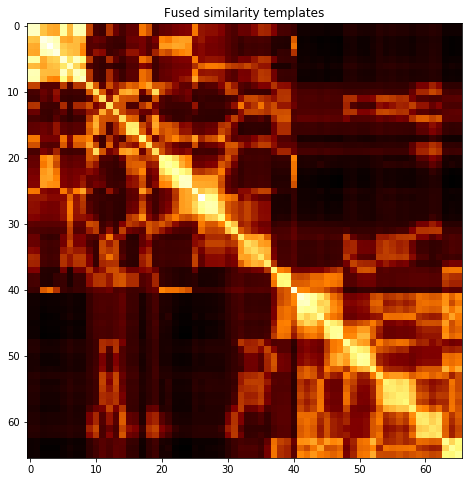

subject 13; gesture 3_0_1


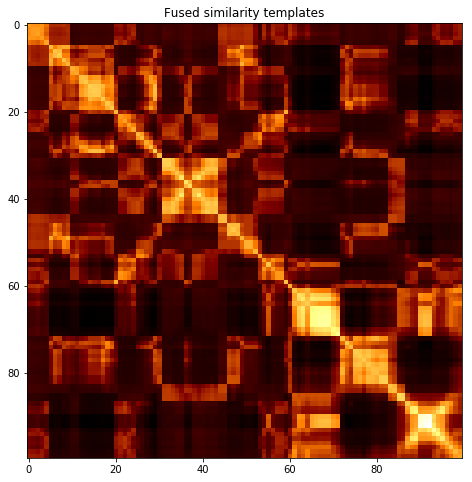

subject 13; gesture 4_1_1


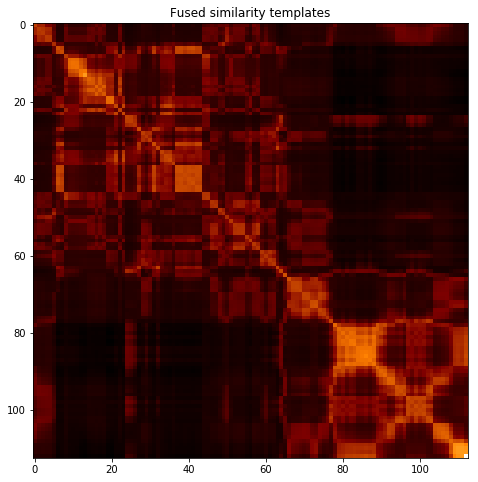

subject 13; gesture 2_0_1


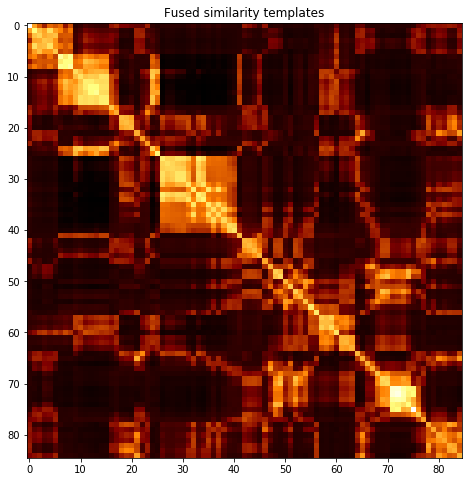

subject 13; gesture 4_1_2


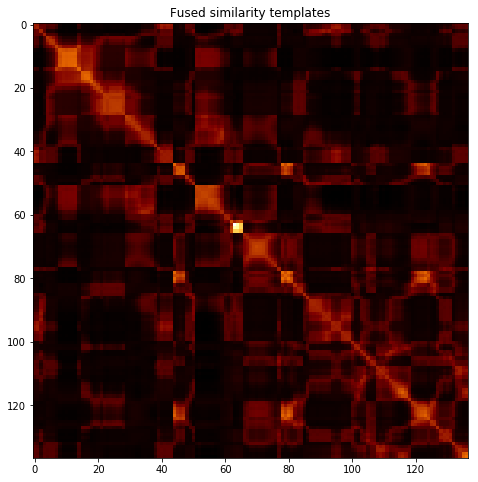

subject 13; gesture 2_0_2


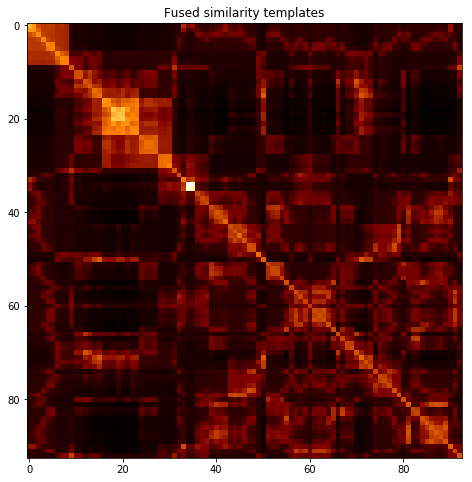

subject 13; gesture 1_1_2


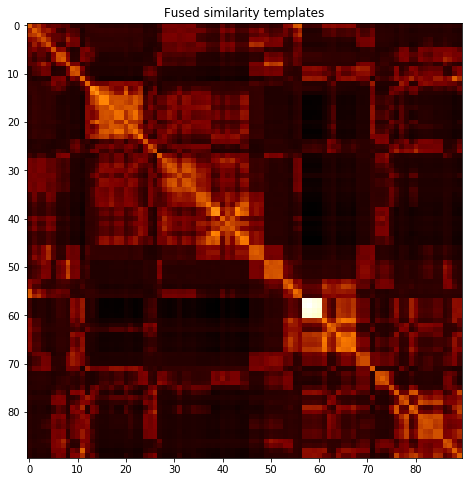

subject 13; gesture 2_1_2


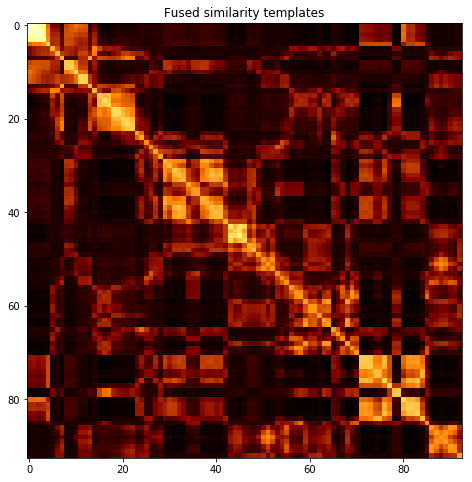

subject 13; gesture 4_0_1


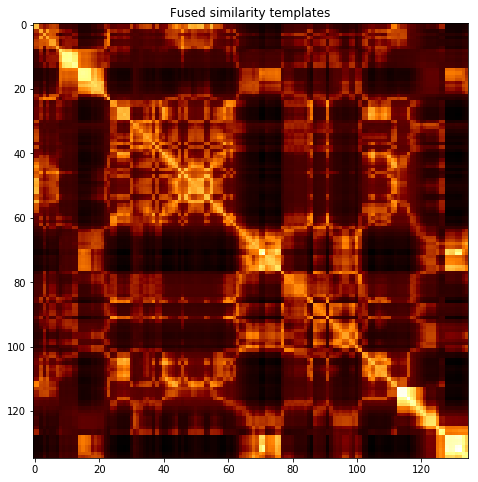

subject 13; gesture 3_0_2


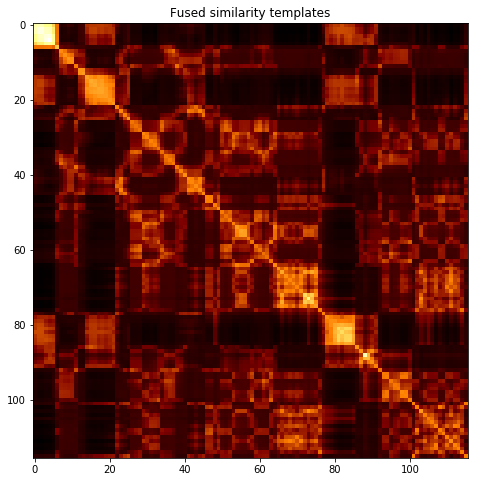

subject 13; gesture 1_1_1


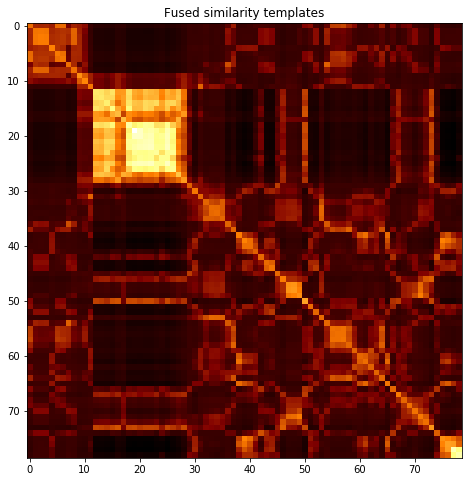

subject 13; gesture 3_1_2


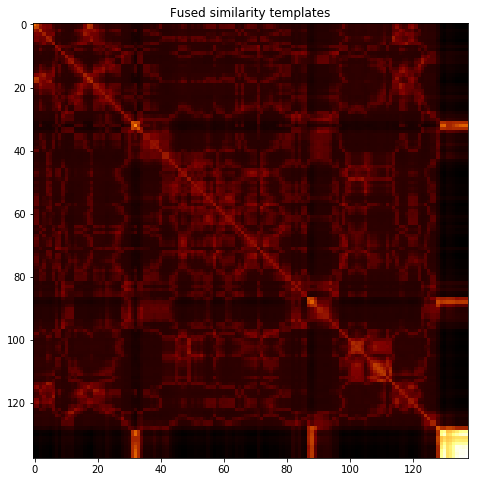

subject 13; gesture 2_1_1


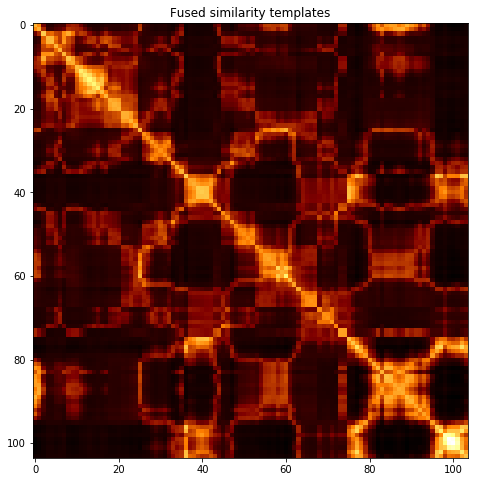

subject 13; gesture 1_0_1


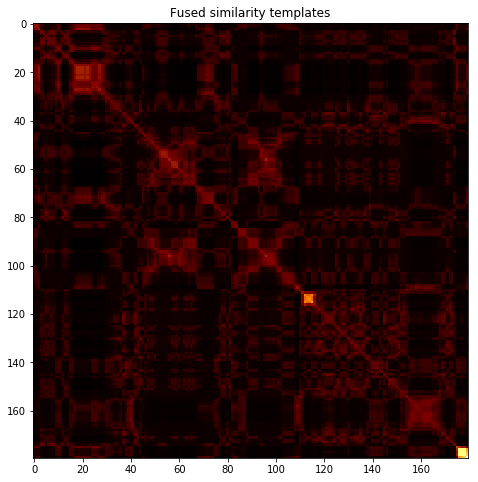

subject 13; gesture 3_1_1


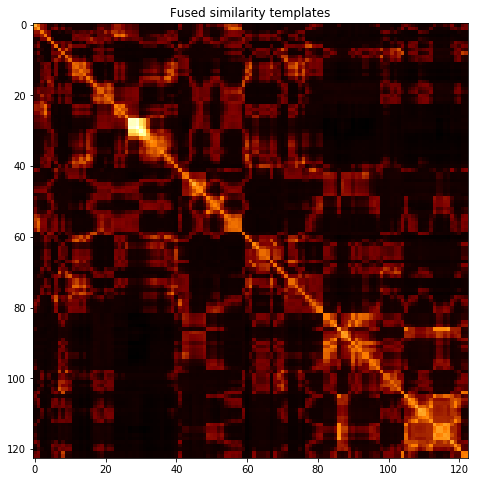

subject 13; gesture 1_0_2


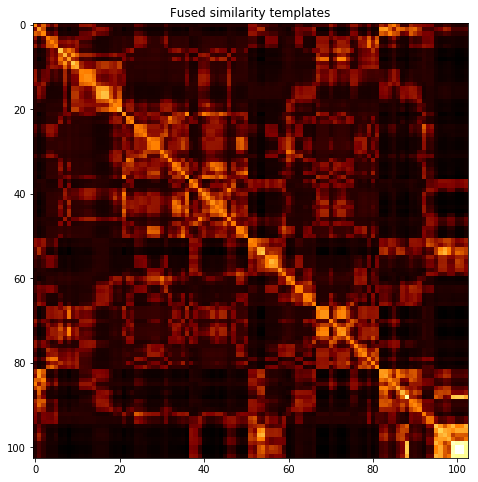

subject 13; gesture 4_0_2


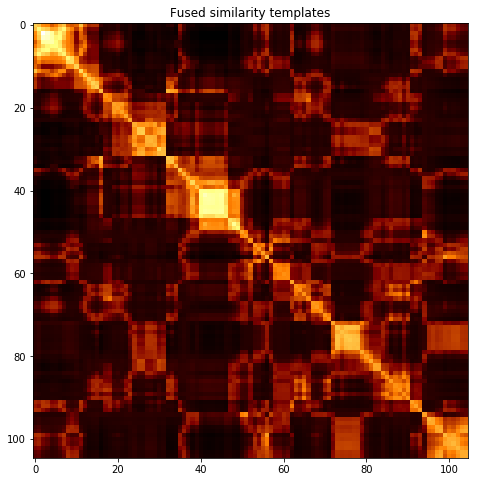

subject 36; gesture 3_0_1


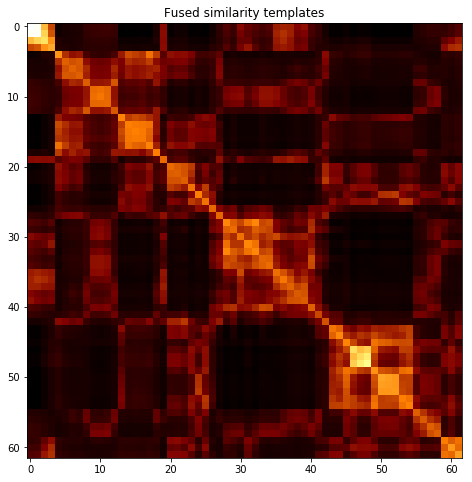

subject 36; gesture 4_1_1


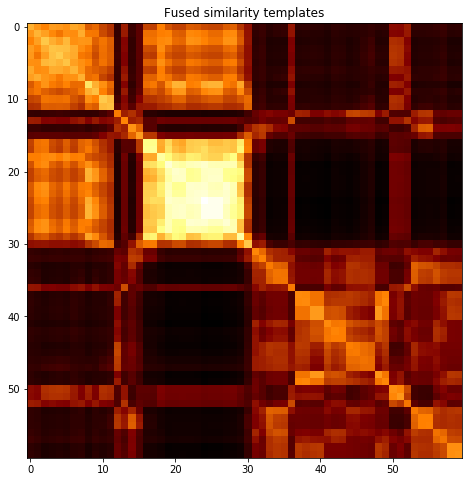

subject 36; gesture 2_0_1


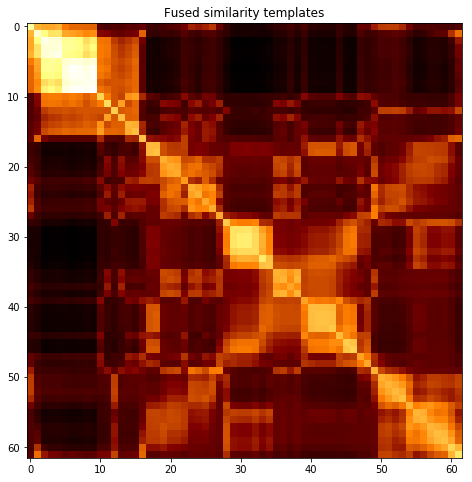

subject 36; gesture 4_1_2


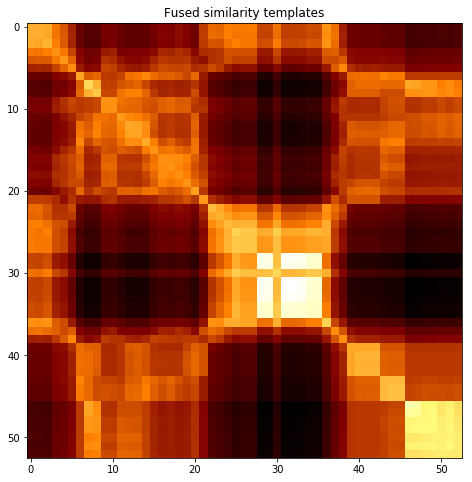

subject 36; gesture 2_0_2


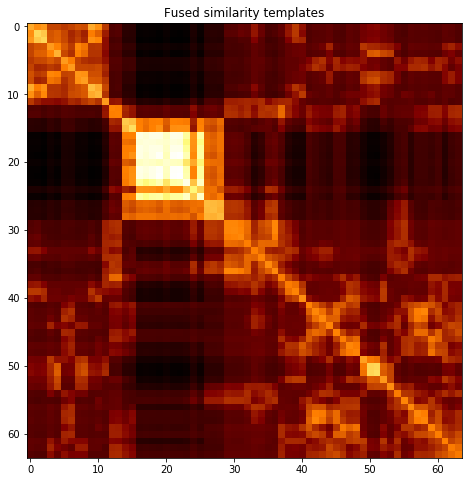

subject 36; gesture 1_1_2


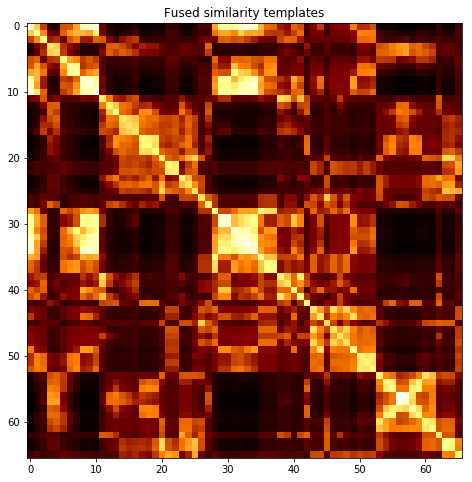

subject 36; gesture 2_1_2


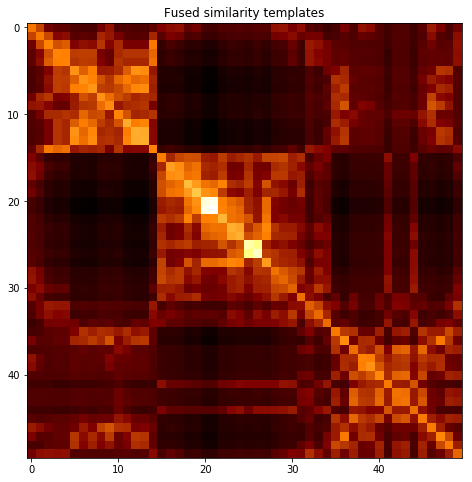

subject 36; gesture 4_0_1


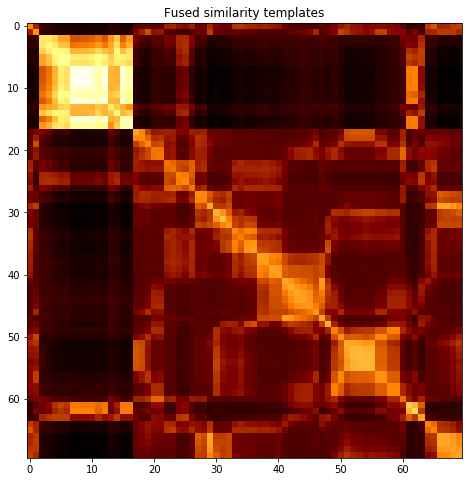

subject 36; gesture 3_0_2


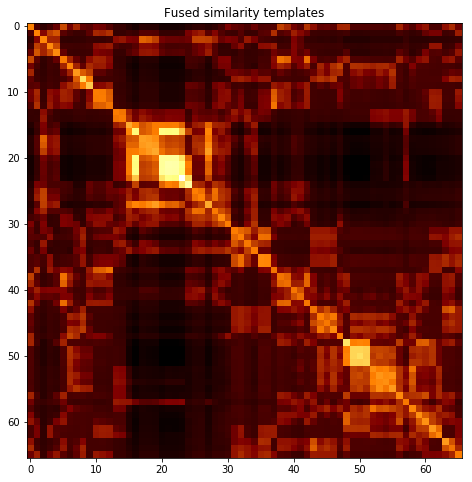

subject 36; gesture 1_1_1


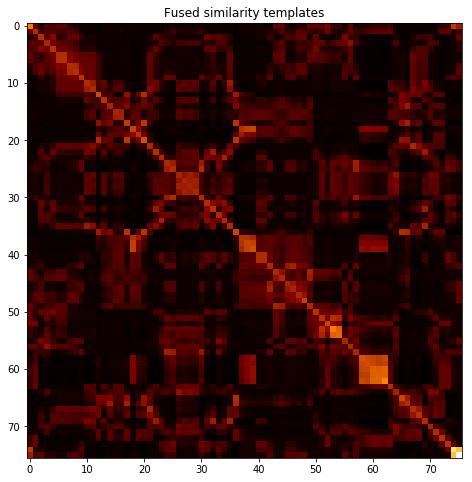

subject 36; gesture 3_1_2


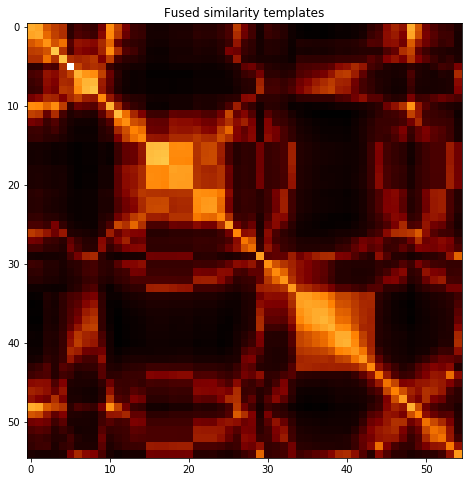

subject 36; gesture 2_1_1


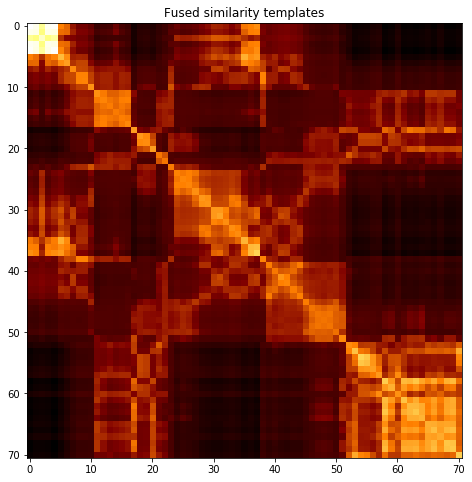

subject 36; gesture 1_0_1


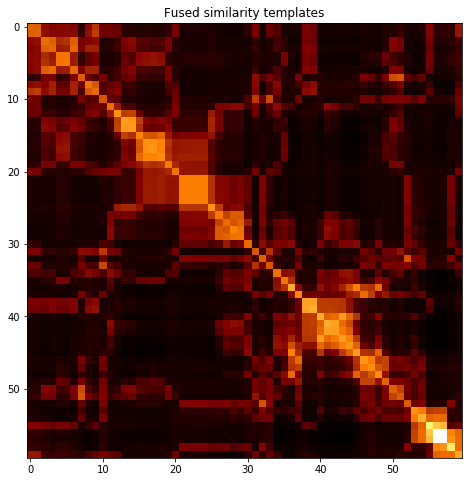

subject 36; gesture 3_1_1


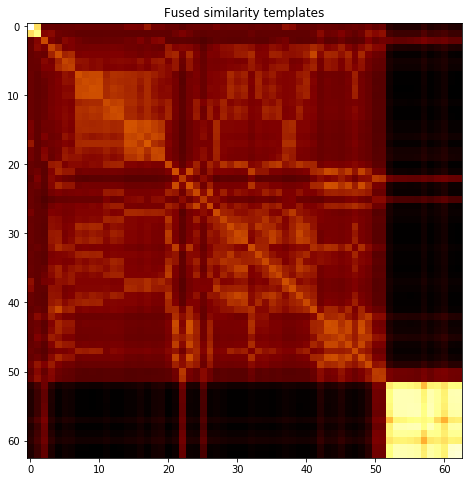

subject 36; gesture 1_0_2


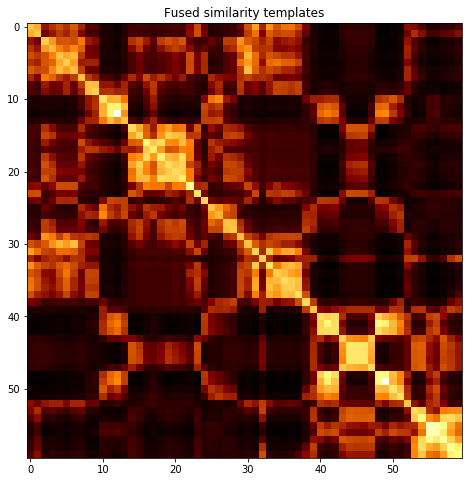

subject 36; gesture 4_0_2


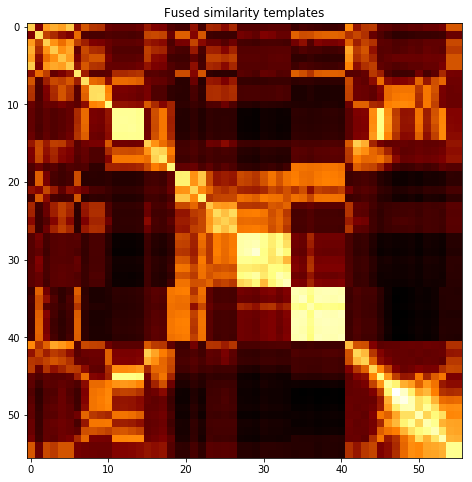

subject 24; gesture 3_0_1


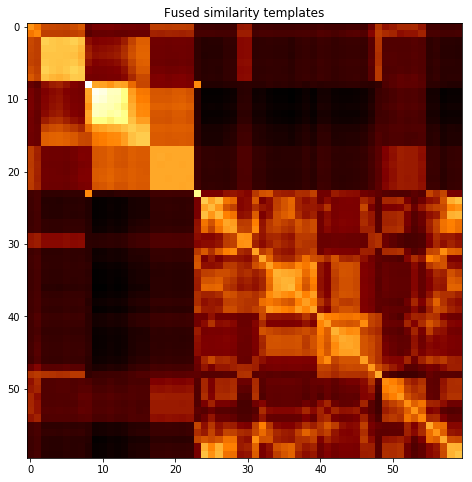

subject 24; gesture 4_1_1


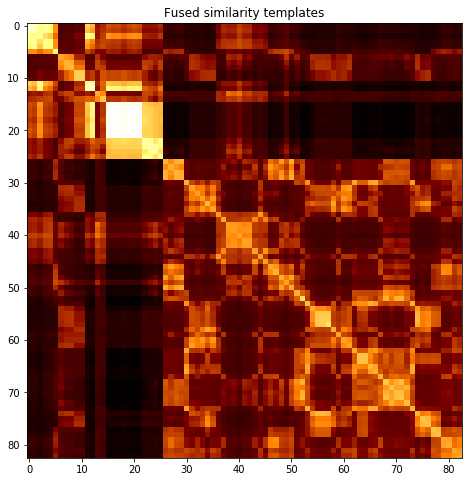

subject 24; gesture 2_0_1


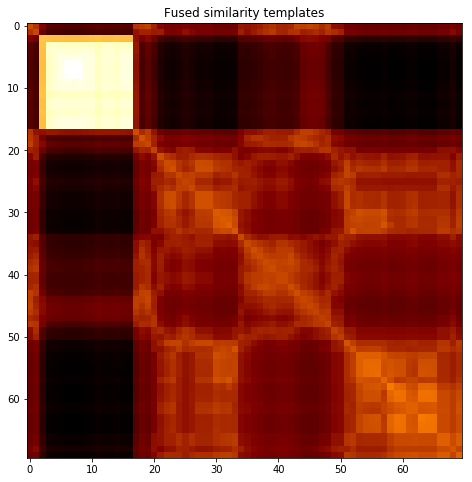

subject 24; gesture 4_1_2


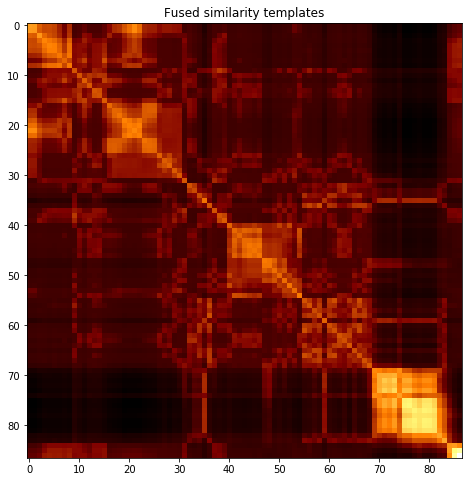

subject 24; gesture 2_0_2


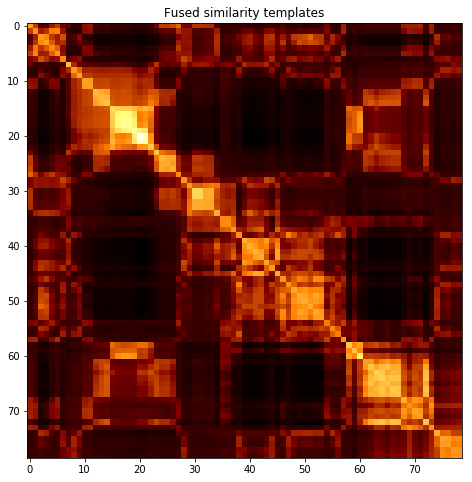

subject 24; gesture 1_1_2


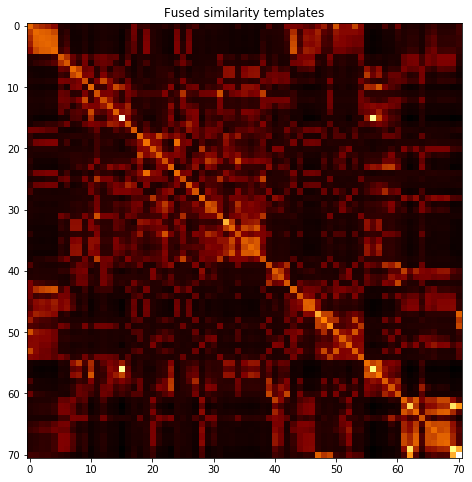

subject 24; gesture 2_1_2


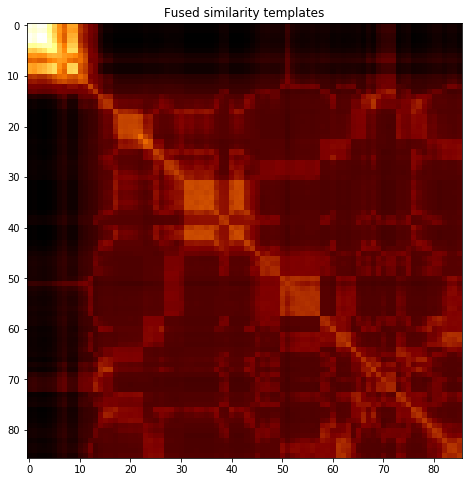

subject 24; gesture 4_0_1


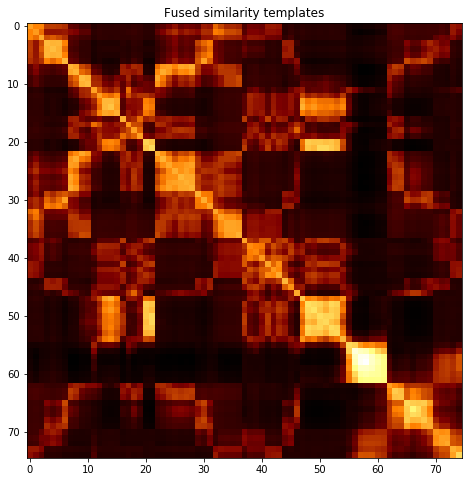

subject 24; gesture 3_0_2


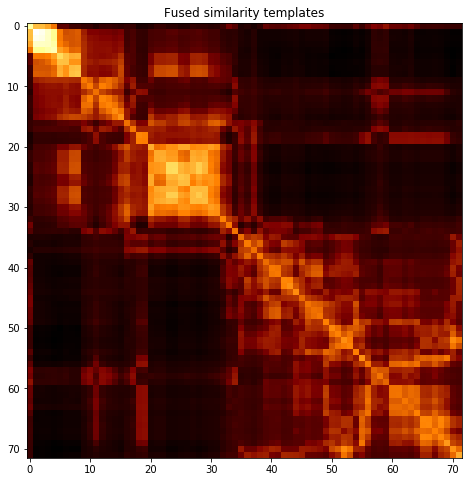

subject 24; gesture 1_1_1


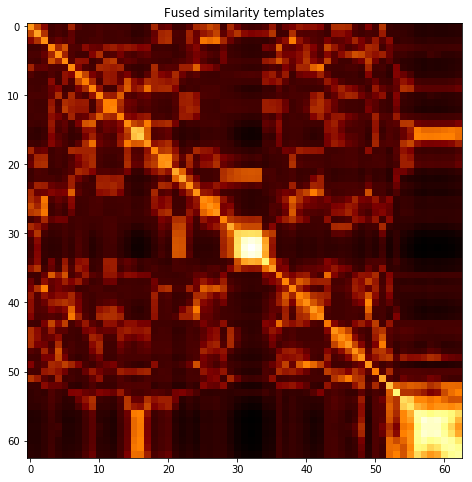

subject 24; gesture 3_1_2


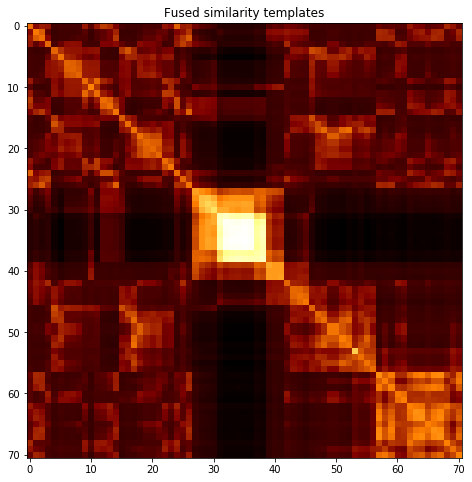

subject 24; gesture 2_1_1


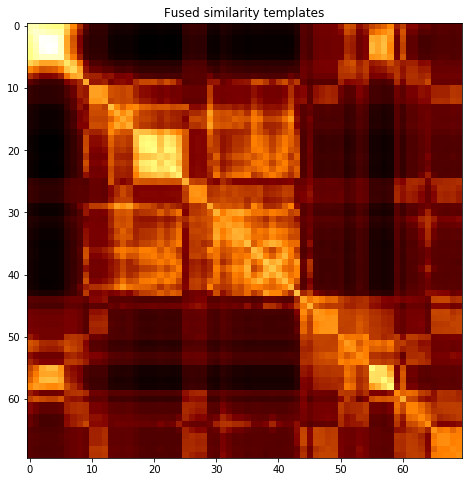

subject 24; gesture 1_0_1


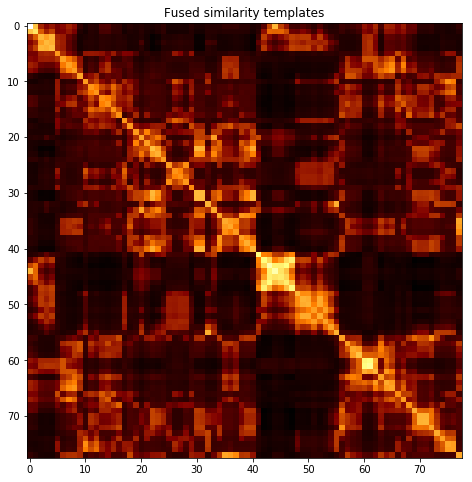

subject 24; gesture 3_1_1


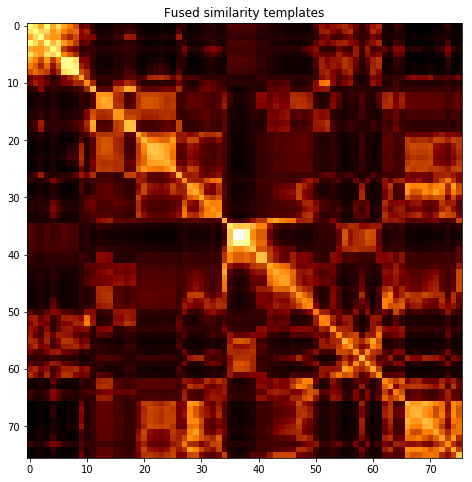

subject 24; gesture 1_0_2


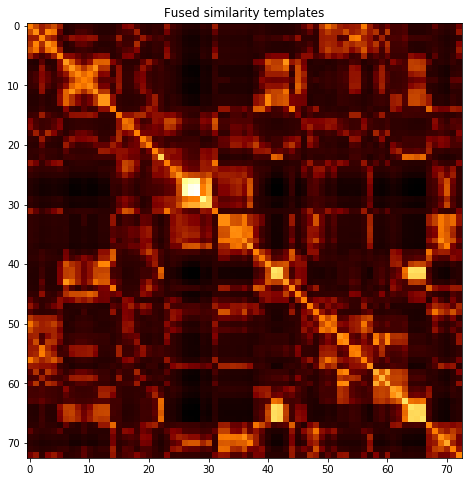

subject 24; gesture 4_0_2


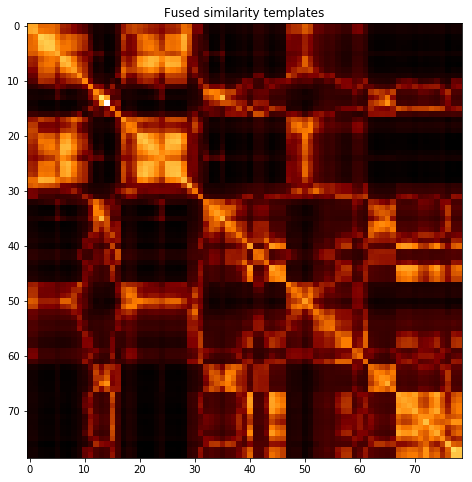

subject 33; gesture 3_0_1


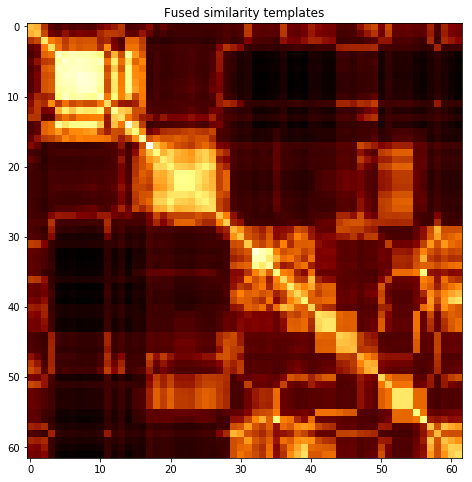

subject 33; gesture 4_1_1


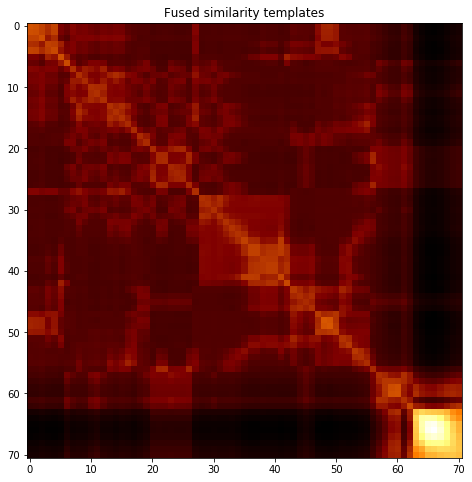

subject 33; gesture 2_0_1


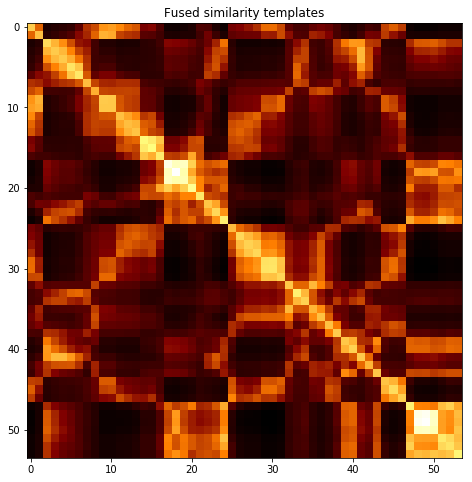

subject 33; gesture 4_1_2


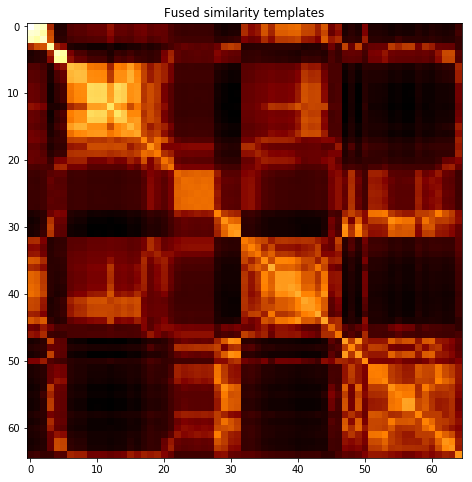

subject 33; gesture 2_0_2


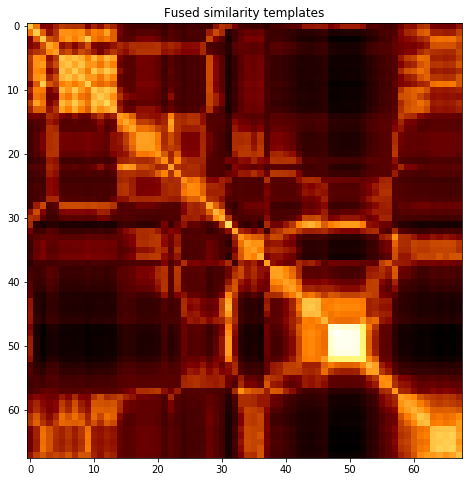

subject 33; gesture 1_1_2


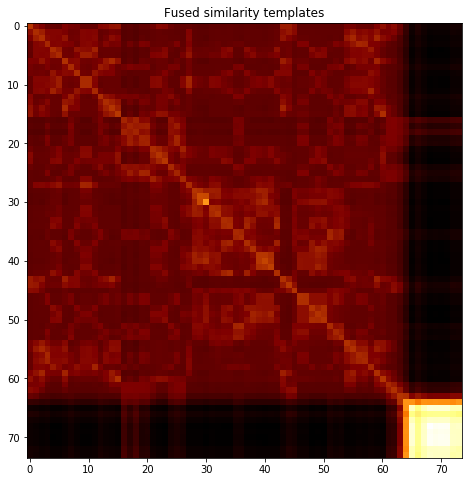

subject 33; gesture 2_1_2


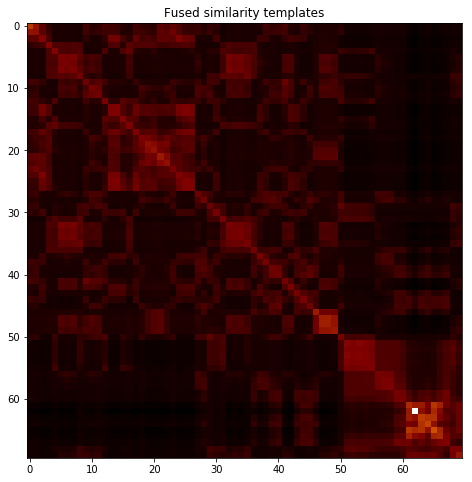

subject 33; gesture 4_0_1


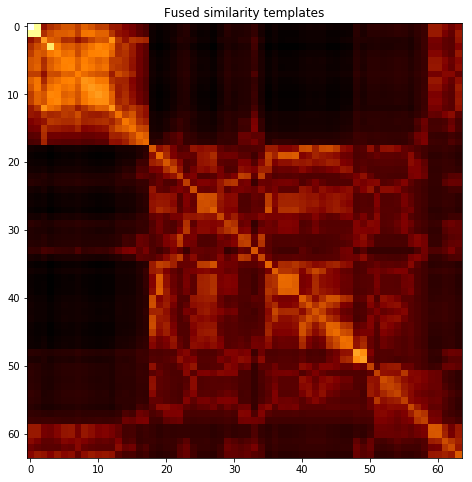

subject 33; gesture 3_0_2


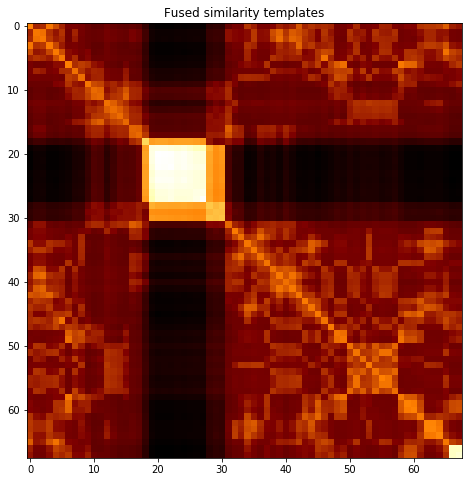

subject 33; gesture 1_1_1


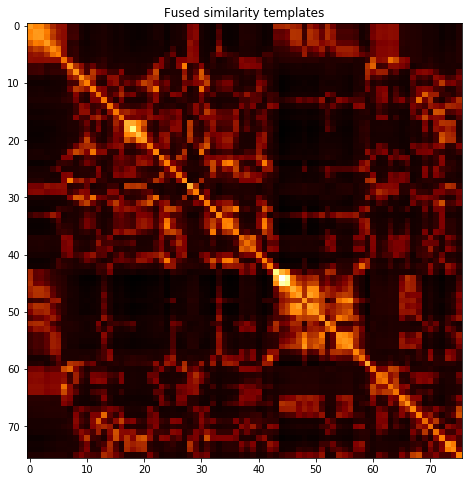

subject 33; gesture 3_1_2


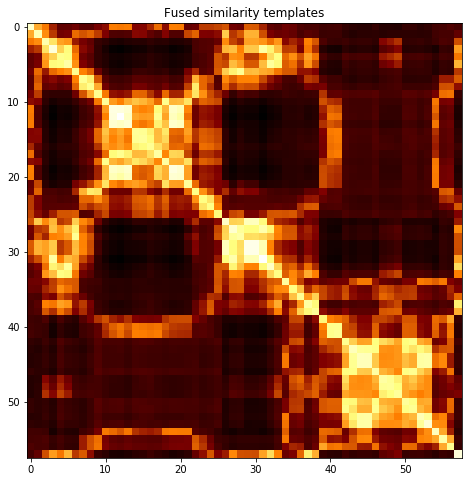

subject 33; gesture 2_1_1


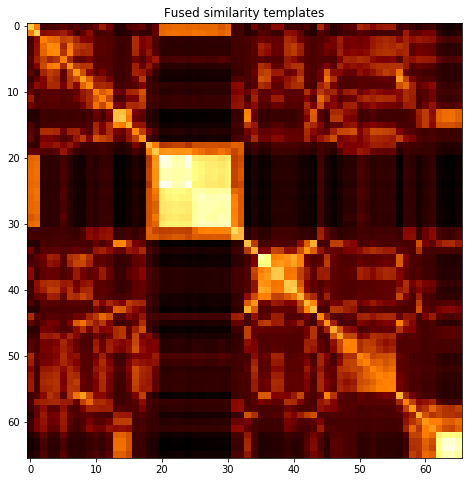

subject 33; gesture 1_0_1


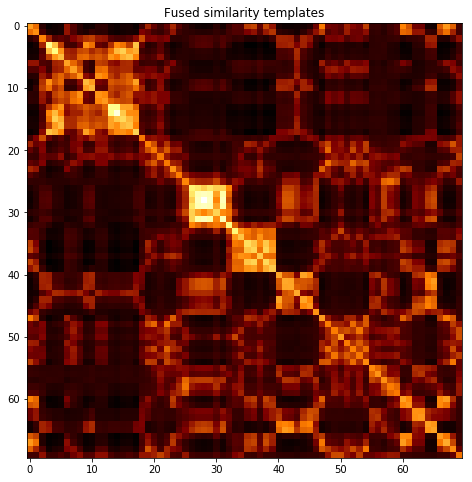

subject 33; gesture 3_1_1


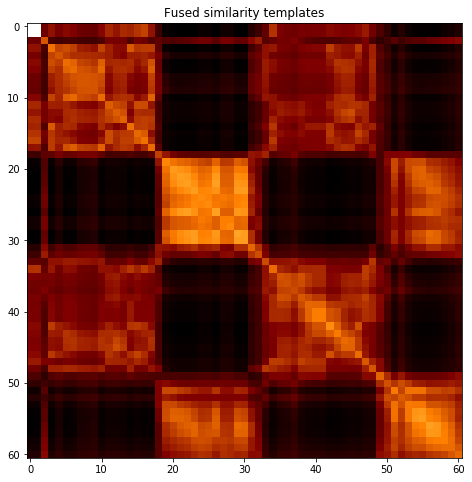

subject 33; gesture 1_0_2


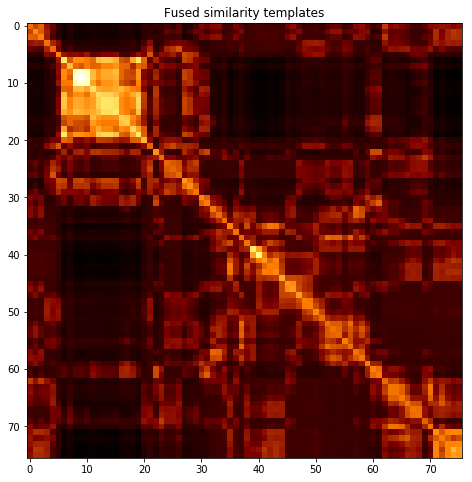

subject 33; gesture 4_0_2


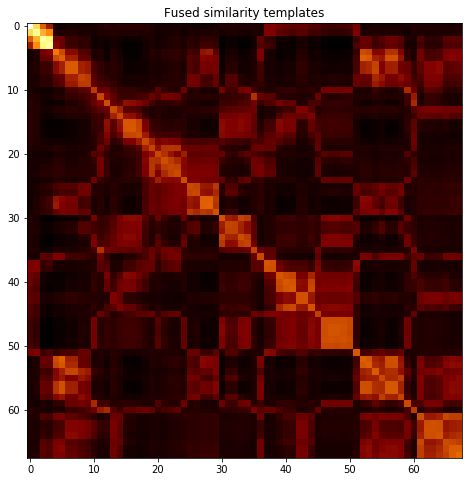

subject 11; gesture 3_0_1


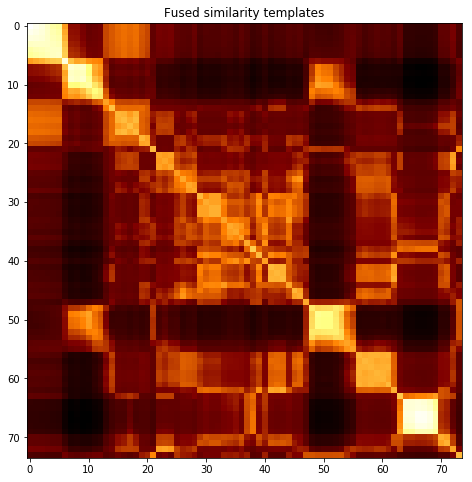

subject 11; gesture 4_1_1


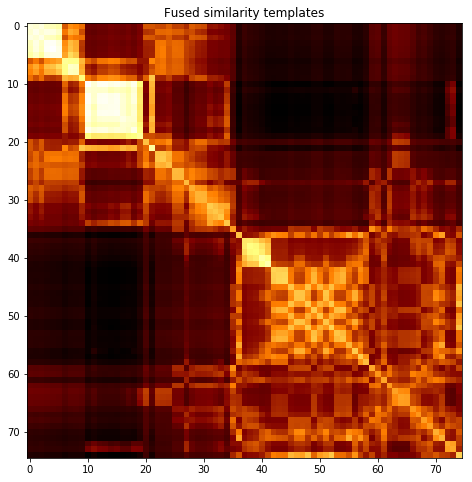

subject 11; gesture 2_0_1


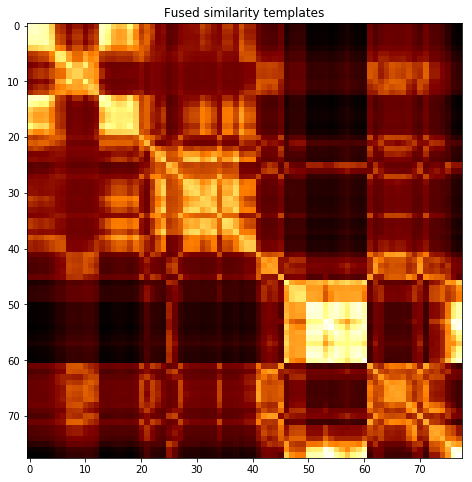

subject 11; gesture 4_1_2


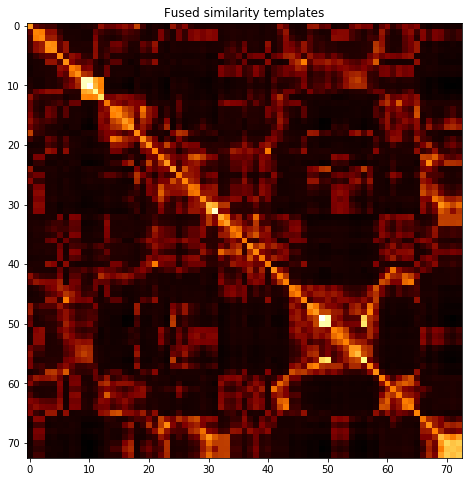

subject 11; gesture 2_0_2


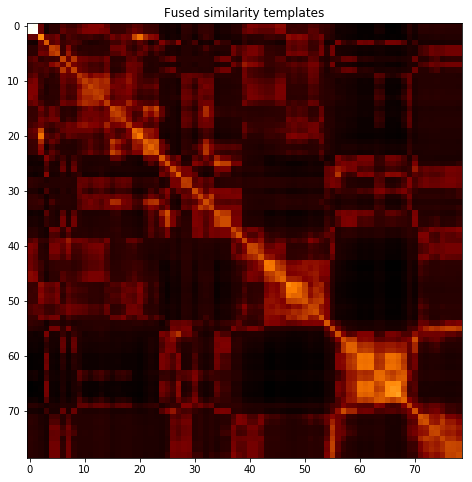

subject 11; gesture 1_1_2


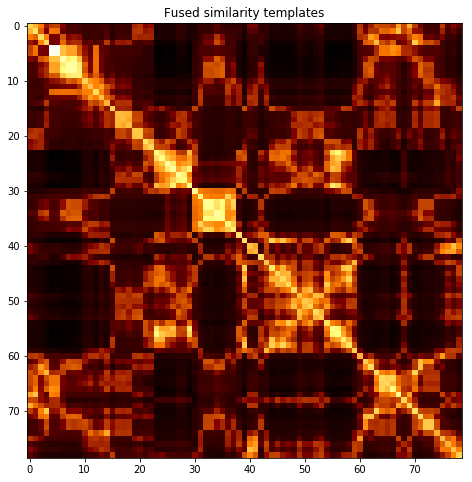

subject 11; gesture 2_1_2


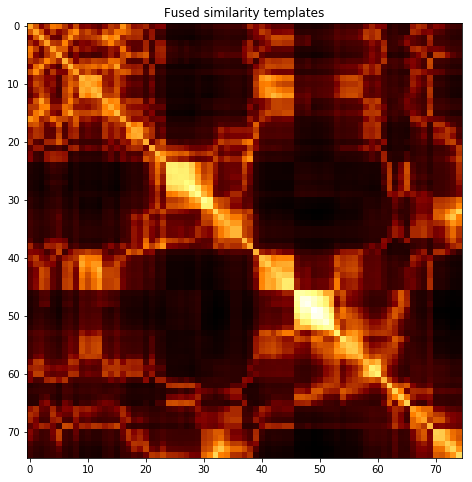

subject 11; gesture 4_0_1


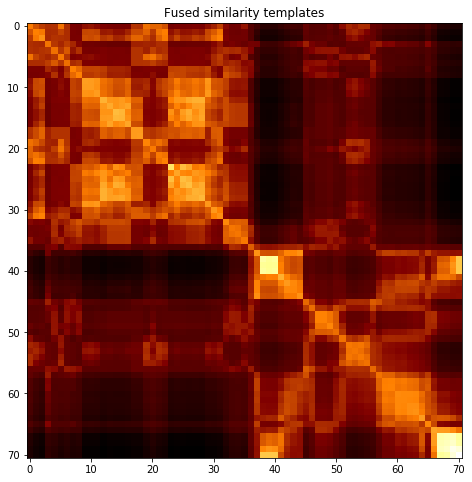

subject 11; gesture 3_0_2


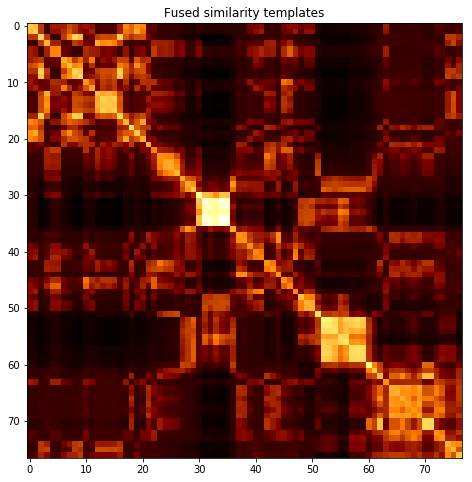

subject 11; gesture 1_1_1


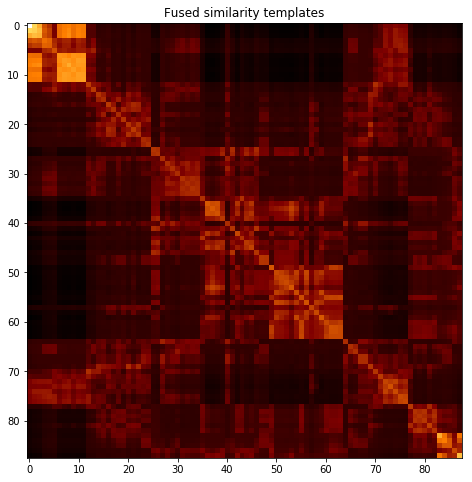

subject 11; gesture 3_1_2


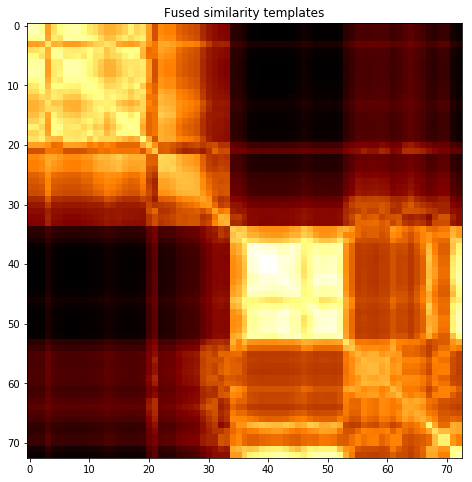

subject 11; gesture 2_1_1


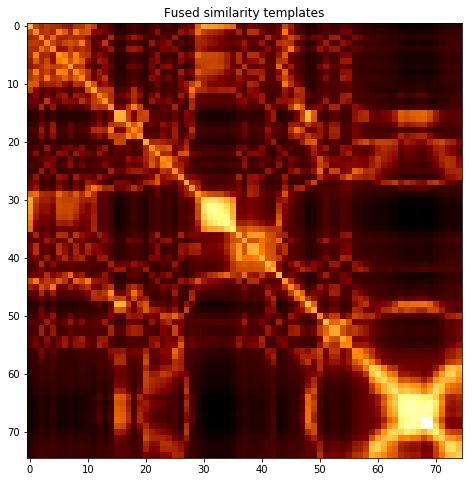

subject 11; gesture 1_0_1


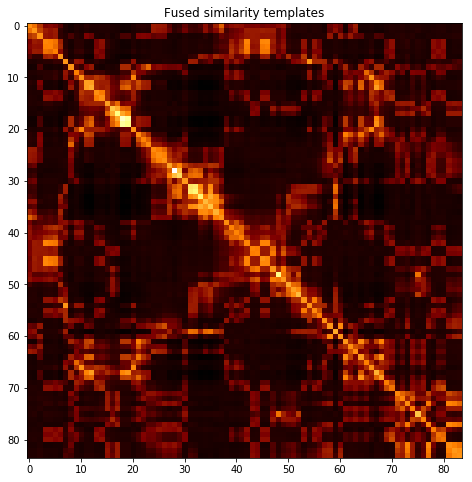

subject 11; gesture 3_1_1


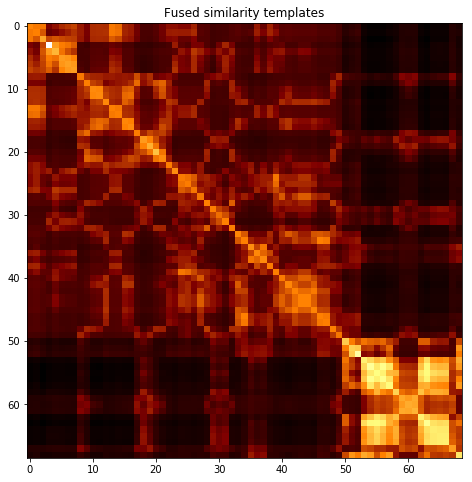

subject 11; gesture 1_0_2


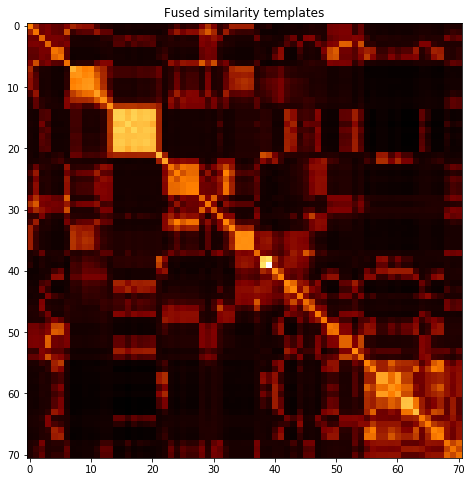

subject 11; gesture 4_0_2


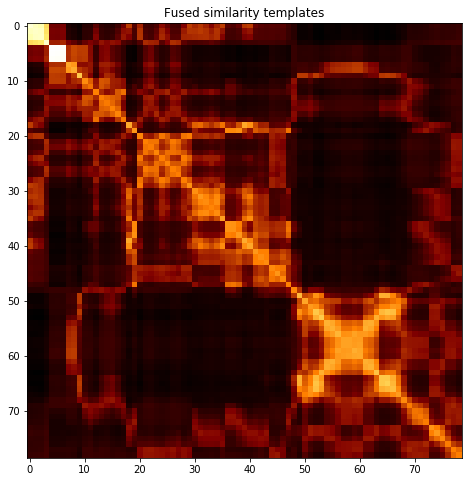

subject 35; gesture 3_0_1


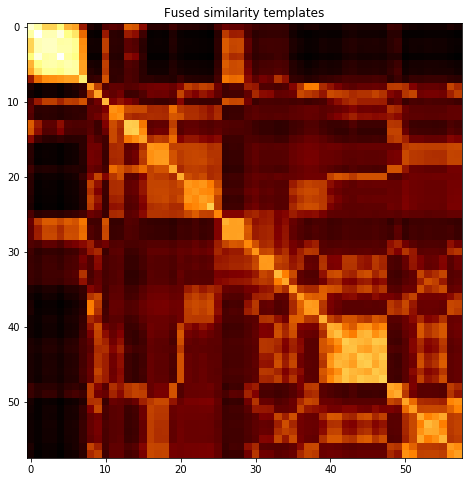

subject 35; gesture 4_1_1


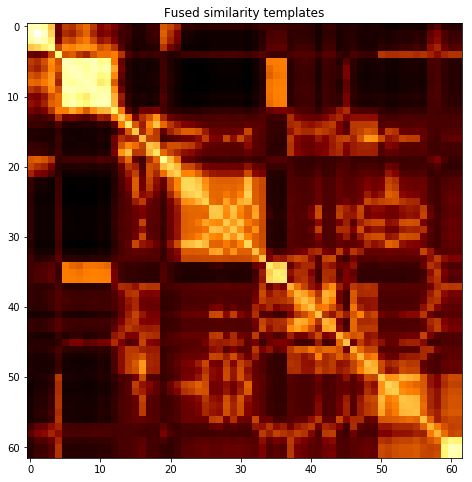

subject 35; gesture 2_0_1


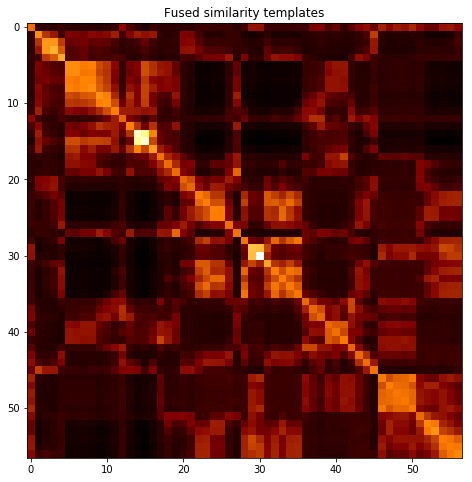

subject 35; gesture 4_1_2


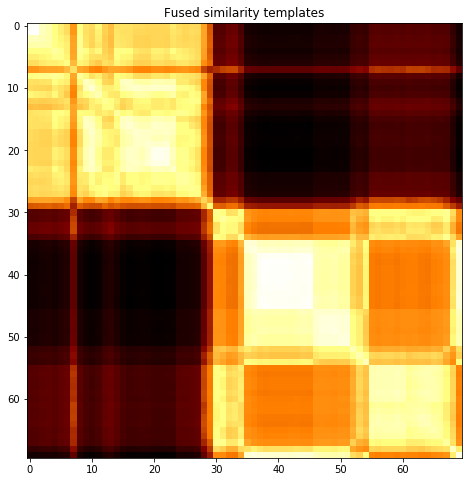

subject 35; gesture 2_0_2


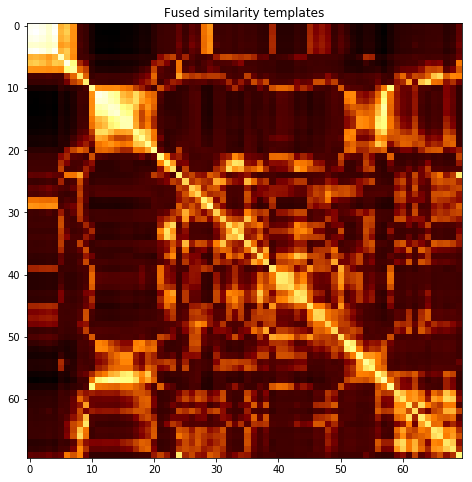

subject 35; gesture 1_1_2


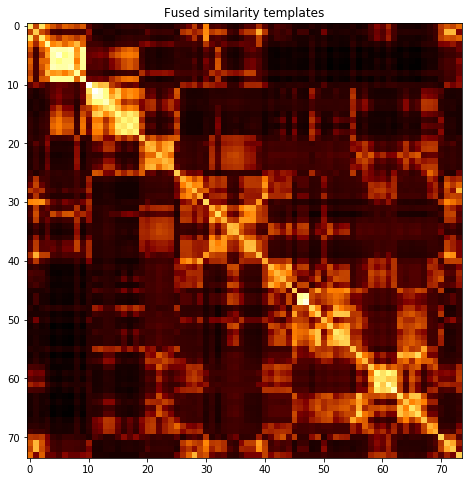

subject 35; gesture 2_1_2


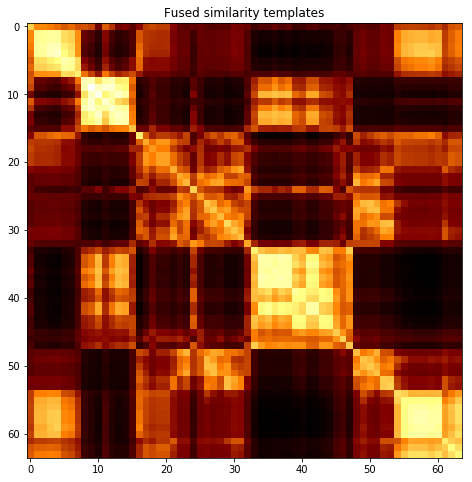

subject 35; gesture 4_0_1


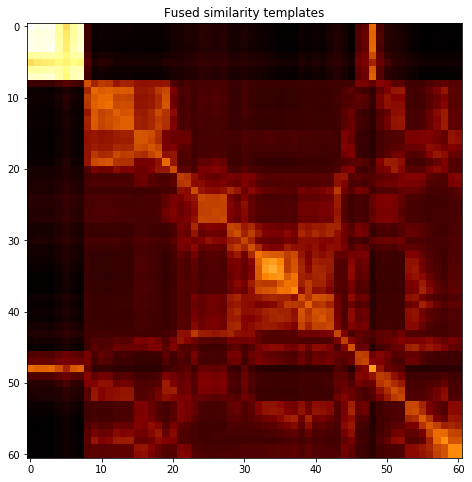

subject 35; gesture 3_0_2


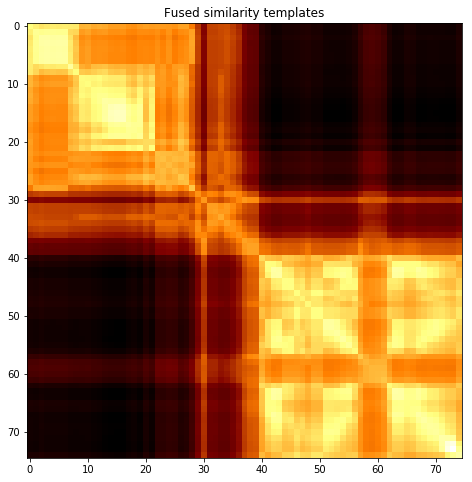

subject 35; gesture 1_1_1


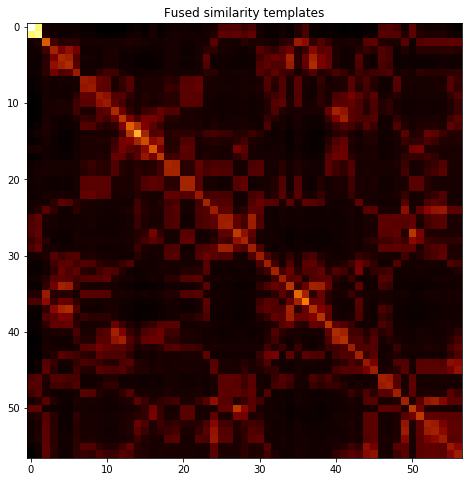

subject 35; gesture 3_1_2


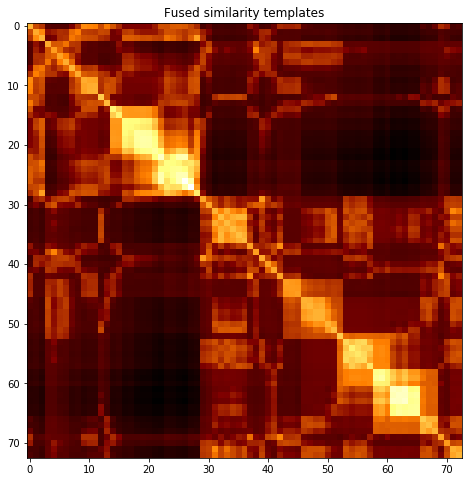

subject 35; gesture 2_1_1


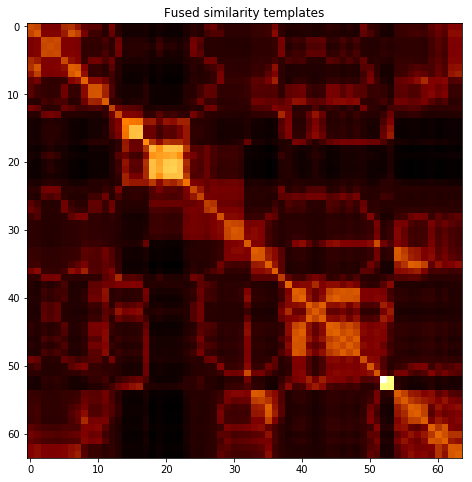

subject 35; gesture 1_0_1


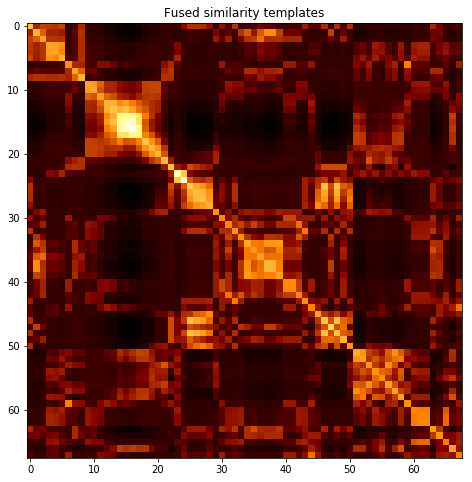

subject 35; gesture 3_1_1


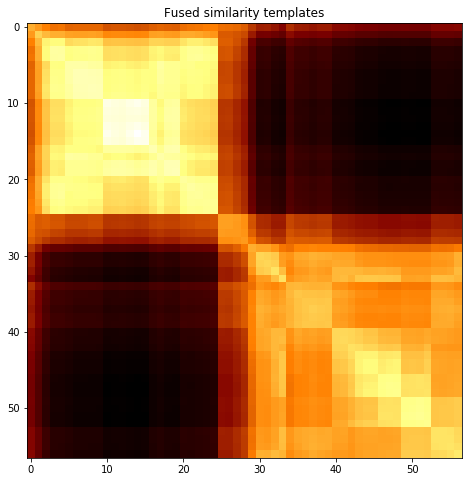

subject 35; gesture 1_0_2


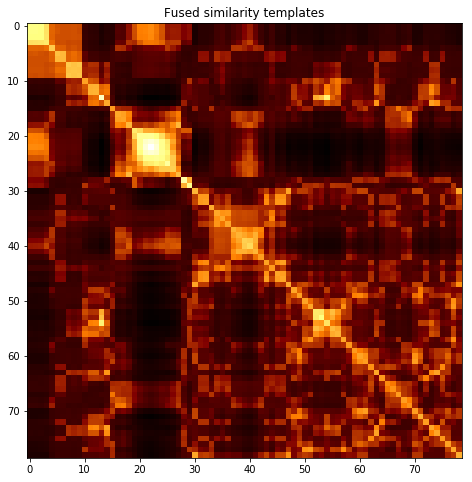

subject 35; gesture 4_0_2


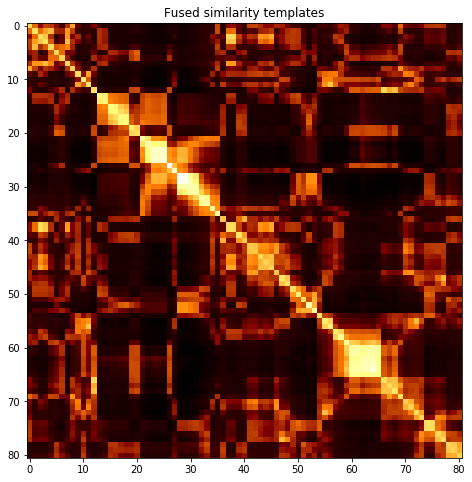

subject 22; gesture 3_0_1


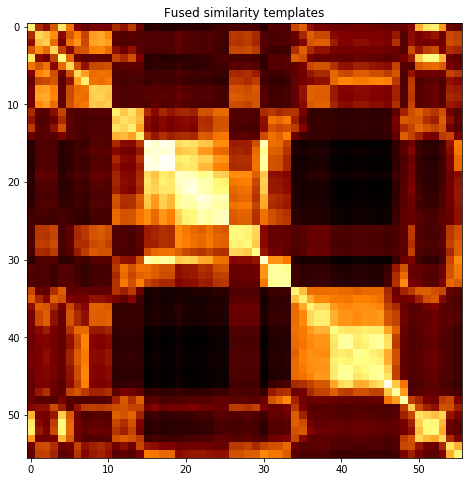

subject 22; gesture 4_1_1


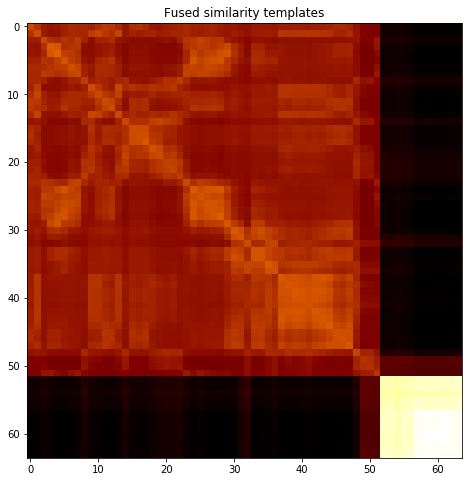

subject 22; gesture 2_0_1


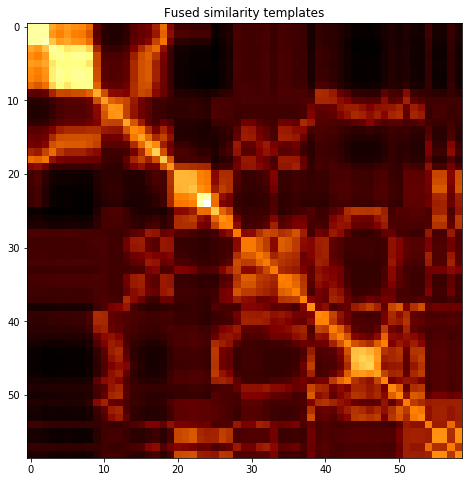

subject 22; gesture 4_1_2


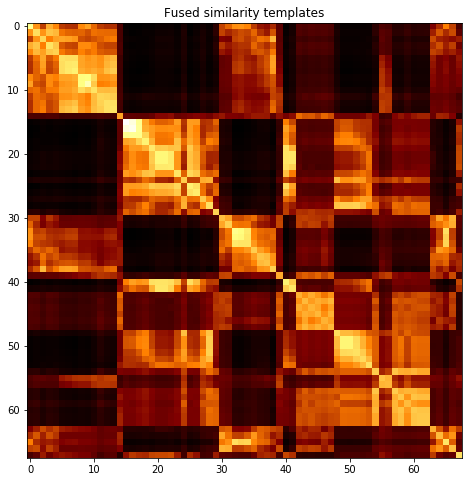

subject 22; gesture 2_0_2


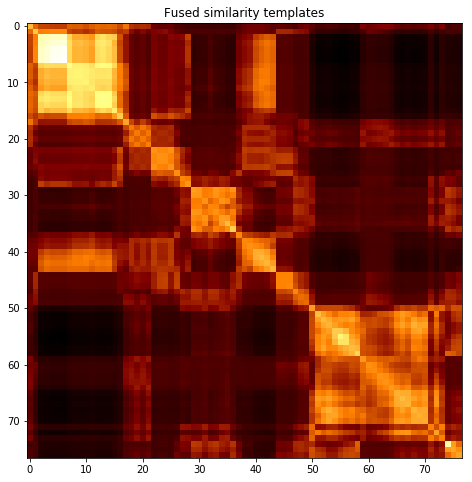

subject 22; gesture 1_1_2


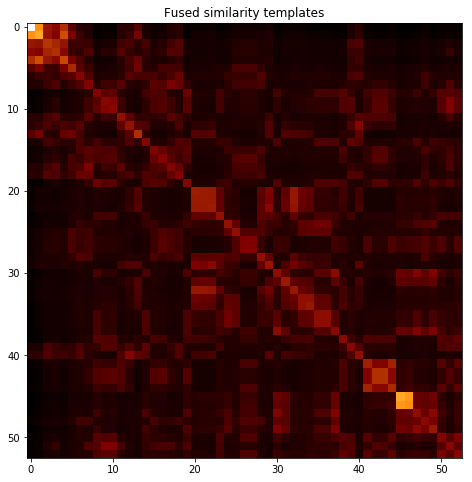

subject 22; gesture 2_1_2


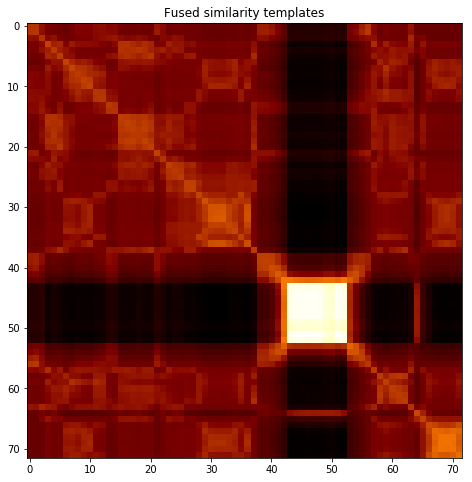

subject 22; gesture 4_0_1


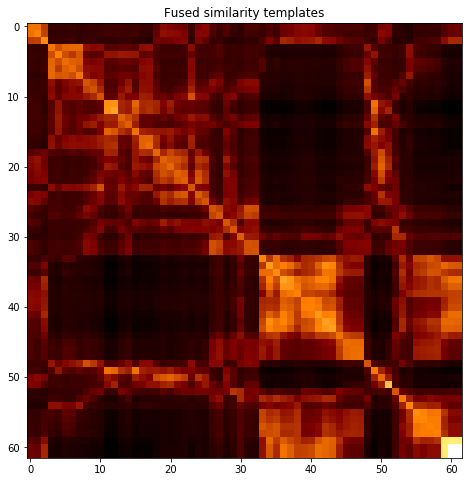

subject 22; gesture 3_0_2


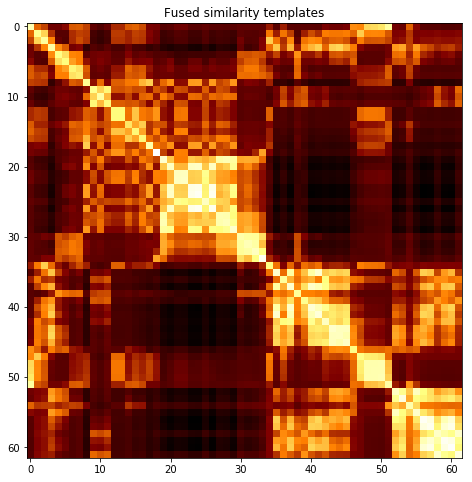

subject 22; gesture 1_1_1


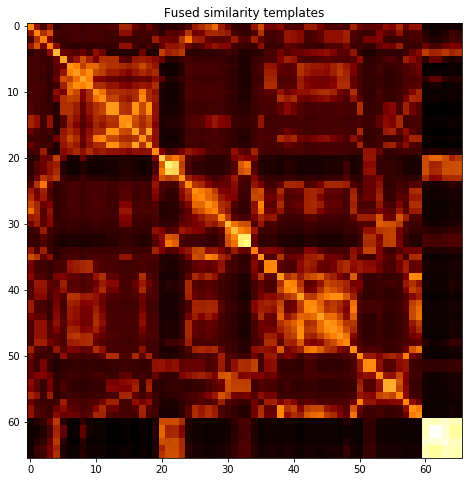

subject 22; gesture 3_1_2


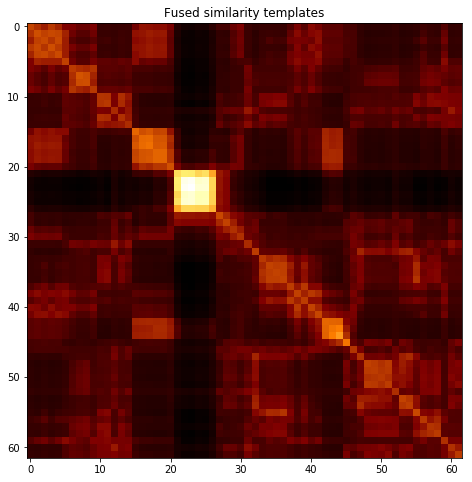

subject 22; gesture 2_1_1


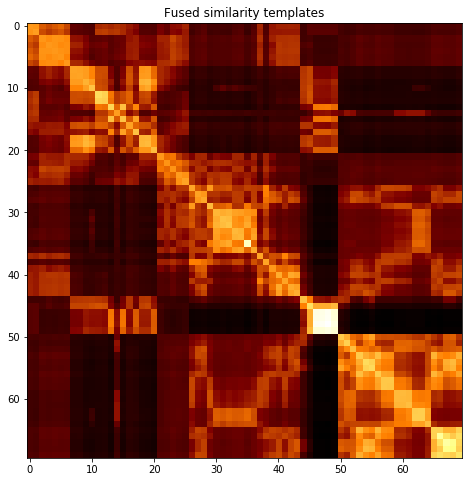

subject 22; gesture 1_0_1


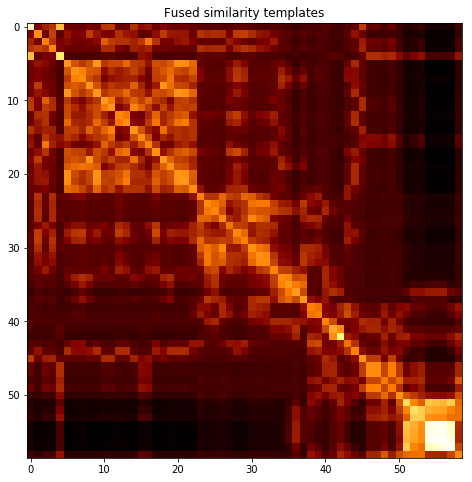

subject 22; gesture 3_1_1


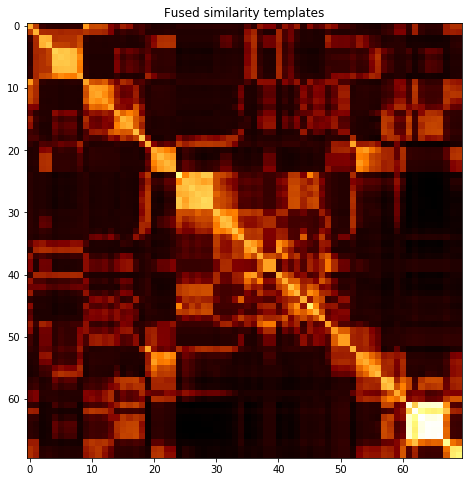

subject 22; gesture 1_0_2


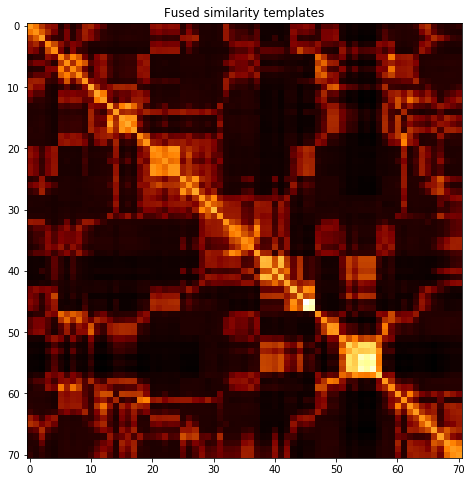

subject 22; gesture 4_0_2


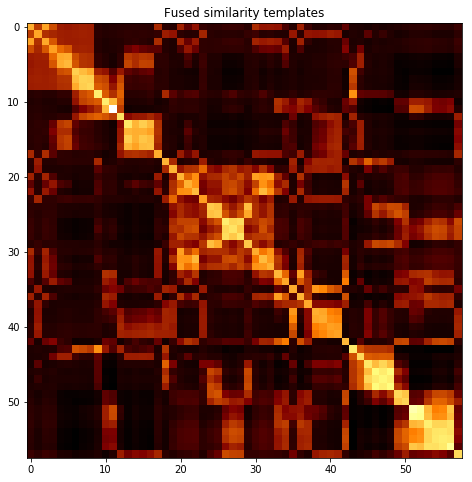

subject 34; gesture 3_0_1


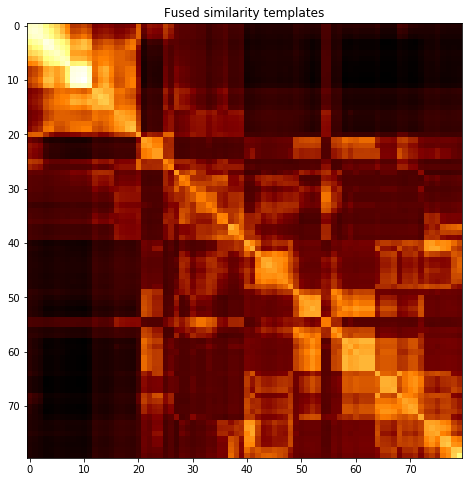

subject 34; gesture 4_1_1


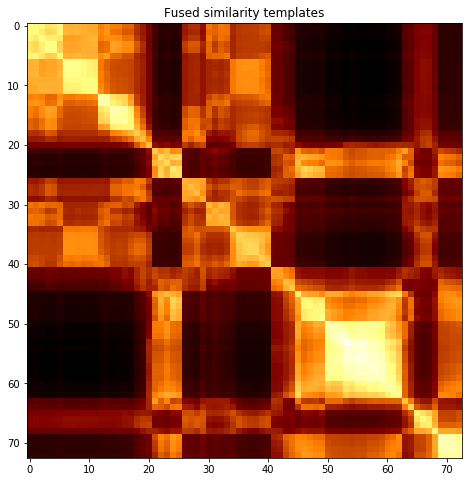

subject 34; gesture 2_0_1


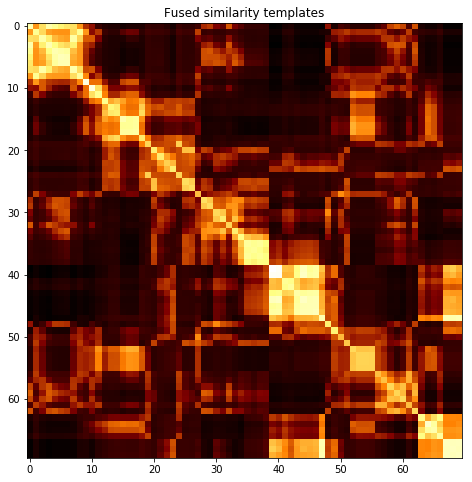

subject 34; gesture 4_1_2


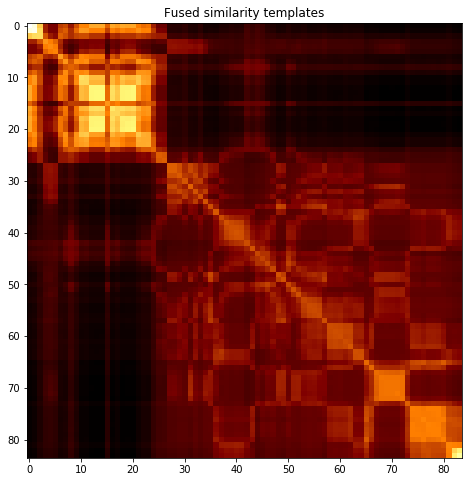

subject 34; gesture 2_0_2


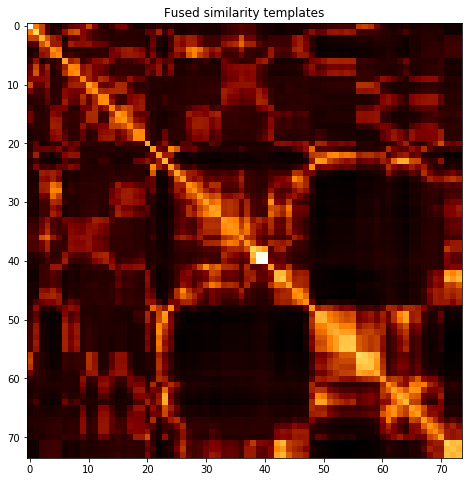

subject 34; gesture 1_1_2


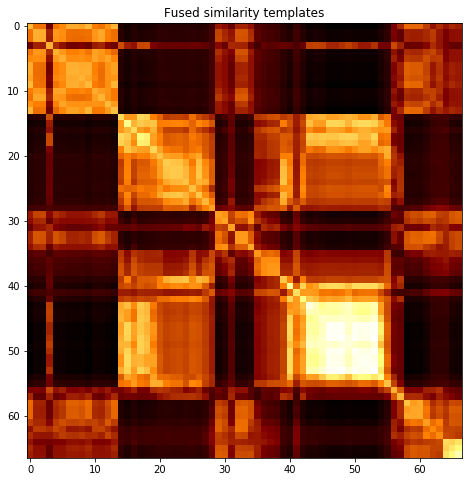

subject 34; gesture 2_1_2


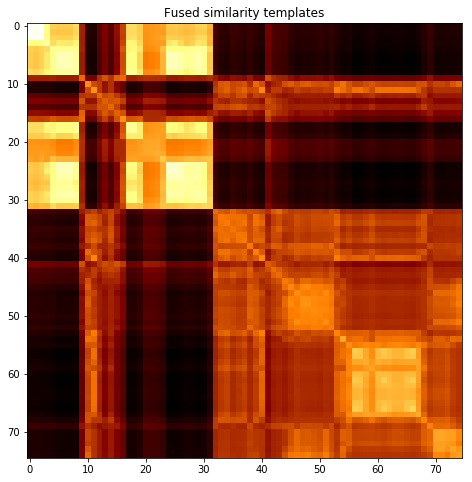

subject 34; gesture 4_0_1


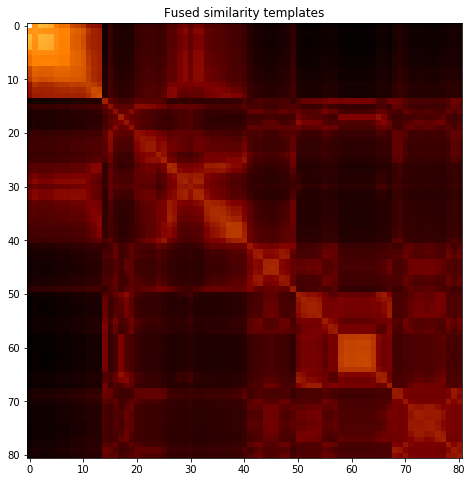

subject 34; gesture 3_0_2


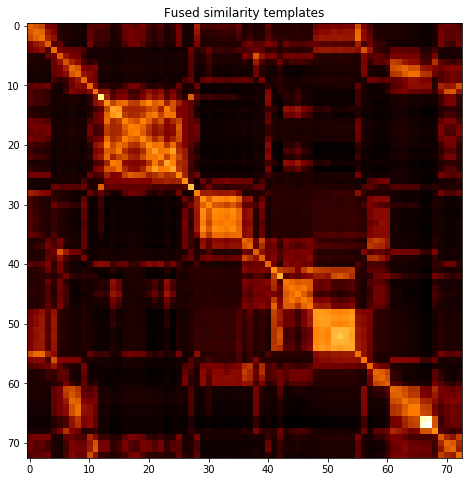

subject 34; gesture 1_1_1


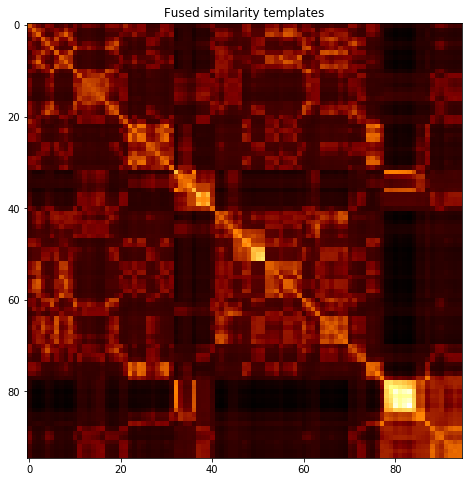

subject 34; gesture 3_1_2


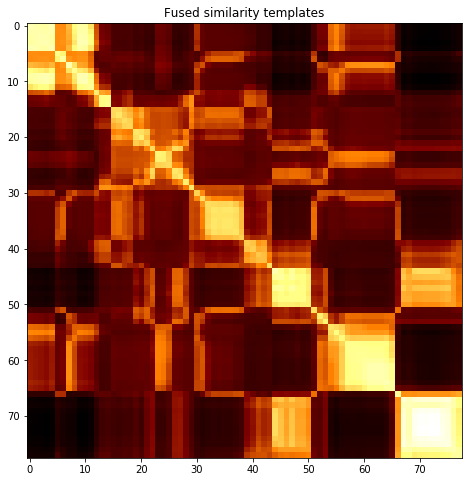

subject 34; gesture 2_1_1


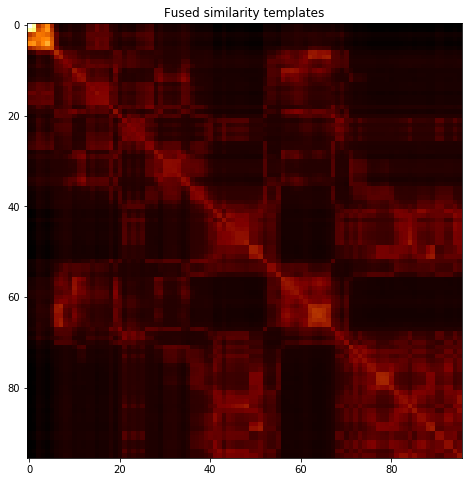

subject 34; gesture 1_0_1


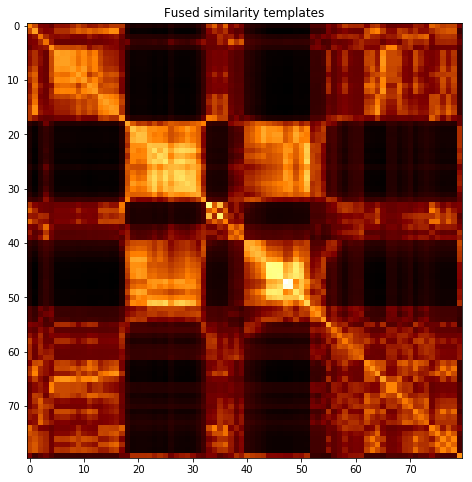

subject 34; gesture 3_1_1


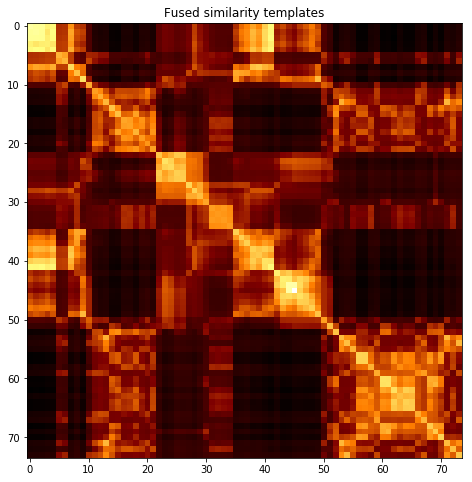

subject 34; gesture 1_0_2


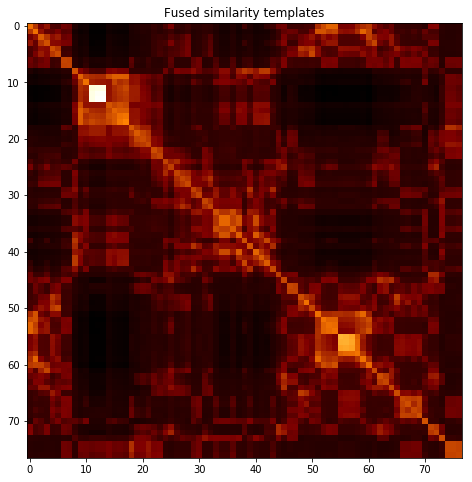

subject 34; gesture 4_0_2


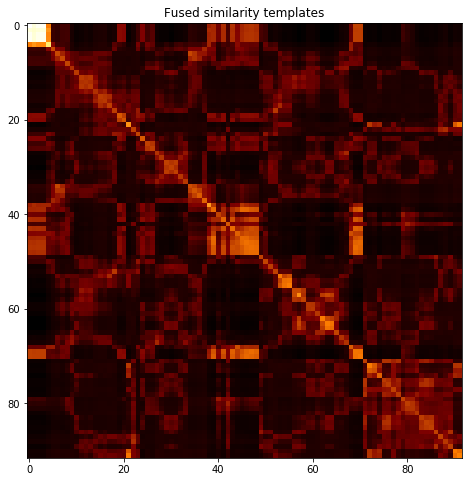

subject 10; gesture 3_0_1


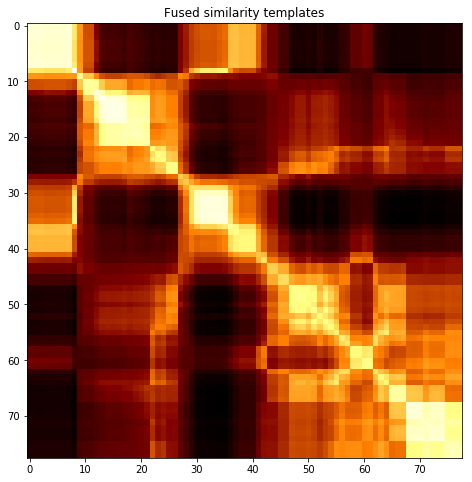

subject 10; gesture 4_1_1


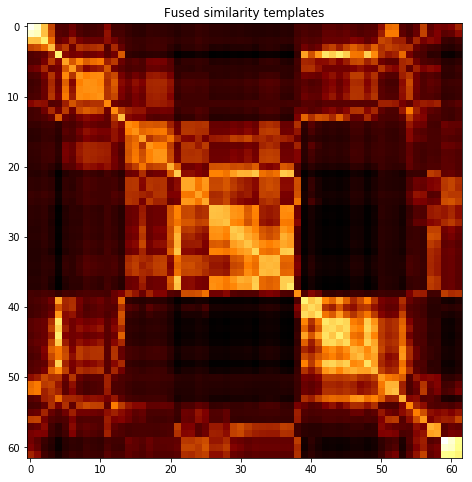

subject 10; gesture 2_0_1


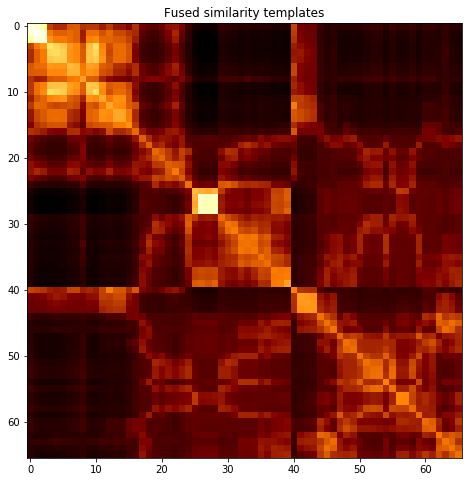

subject 10; gesture 4_1_2


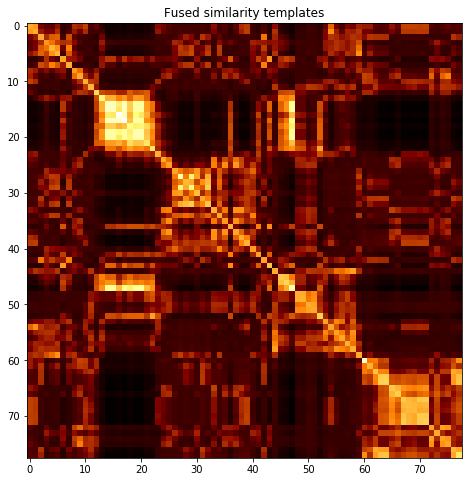

subject 10; gesture 2_0_2


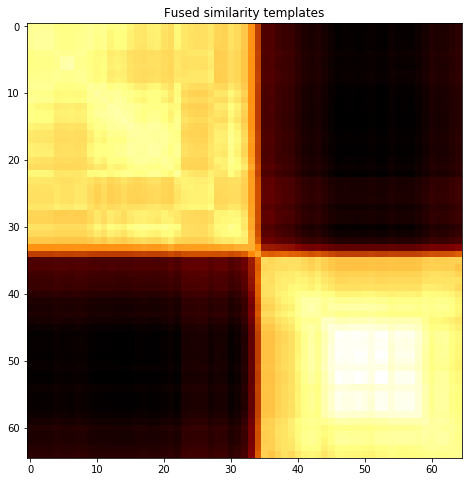

subject 10; gesture 1_1_2


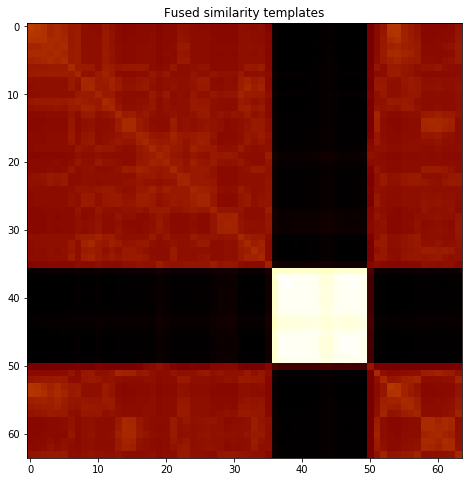

subject 10; gesture 2_1_2


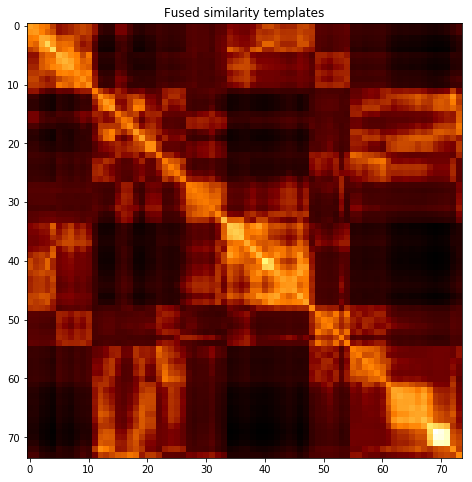

subject 10; gesture 4_0_1


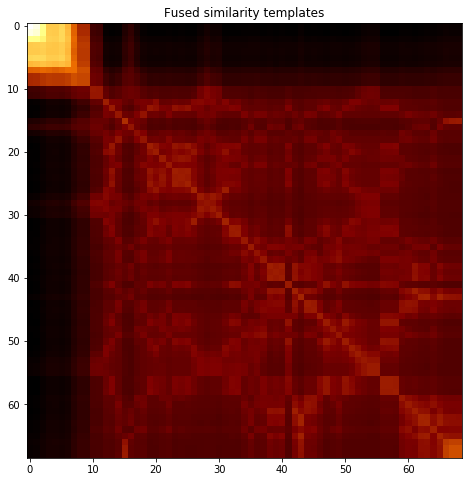

subject 10; gesture 3_0_2


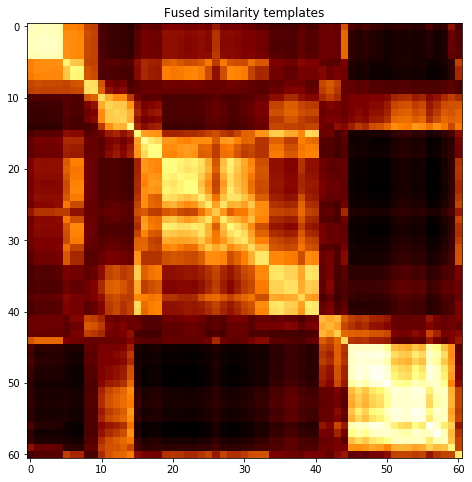

subject 10; gesture 1_1_1


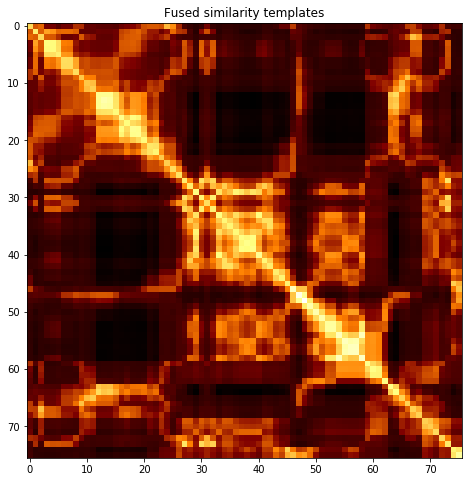

subject 10; gesture 3_1_2


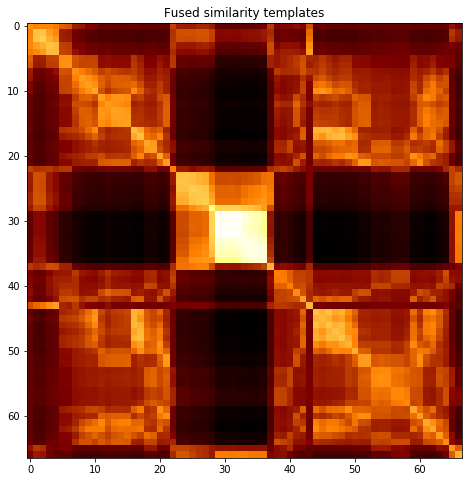

subject 10; gesture 2_1_1


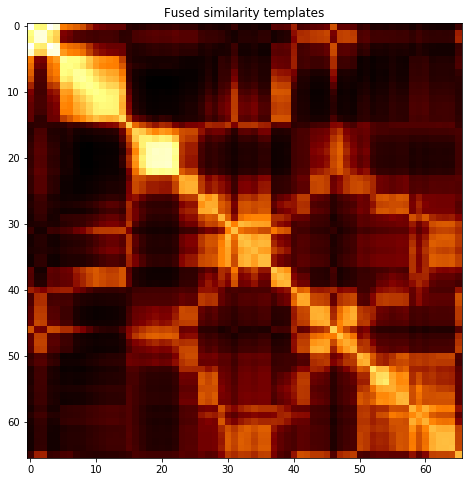

subject 10; gesture 1_0_1


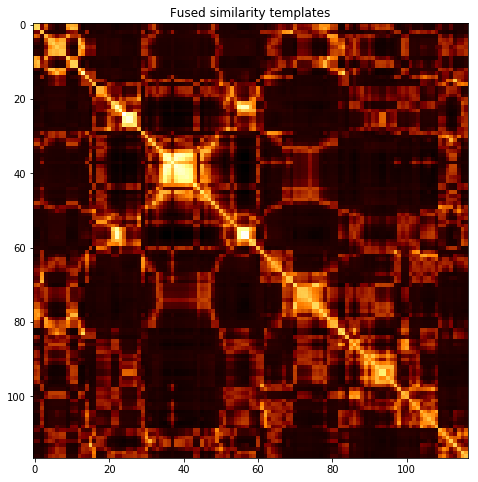

subject 10; gesture 3_1_1


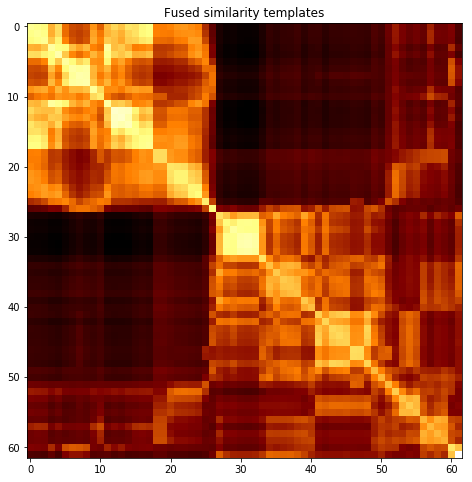

subject 10; gesture 1_0_2


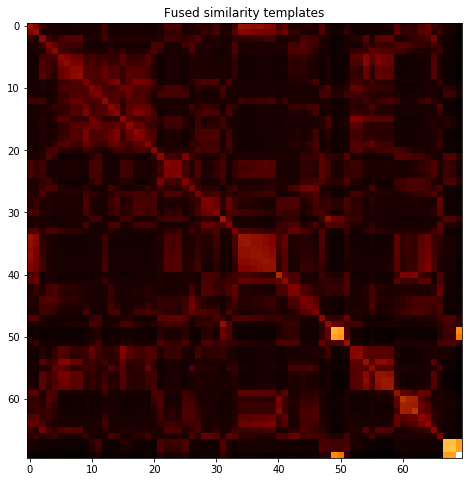

subject 10; gesture 4_0_2


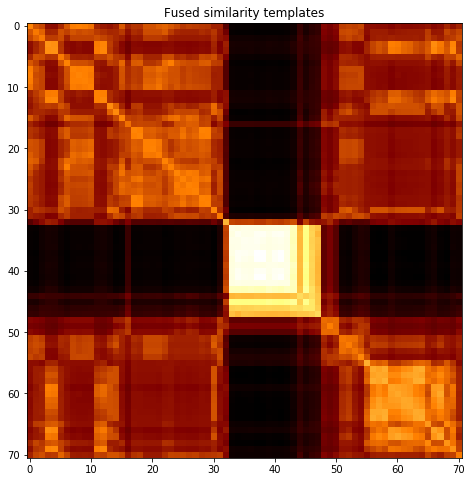

subject 02; gesture 3_0_1


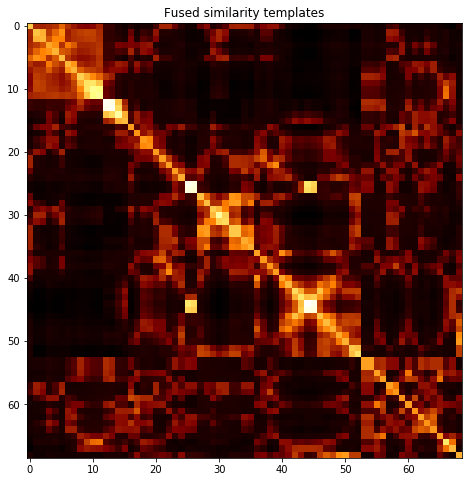

subject 02; gesture 4_1_1


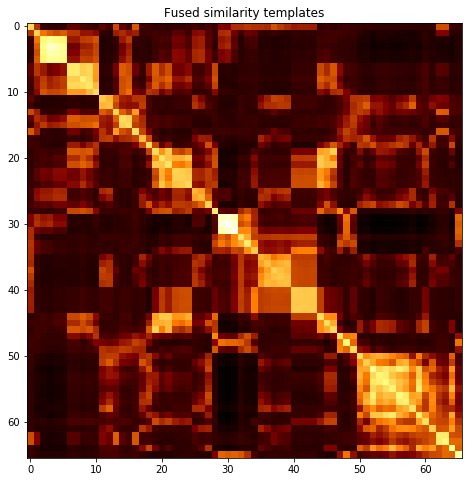

subject 02; gesture 2_0_1


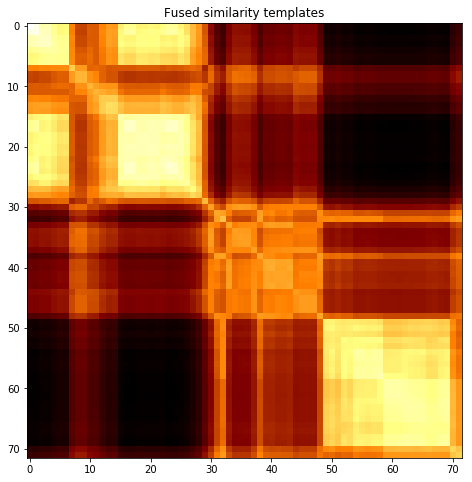

subject 02; gesture 4_1_2


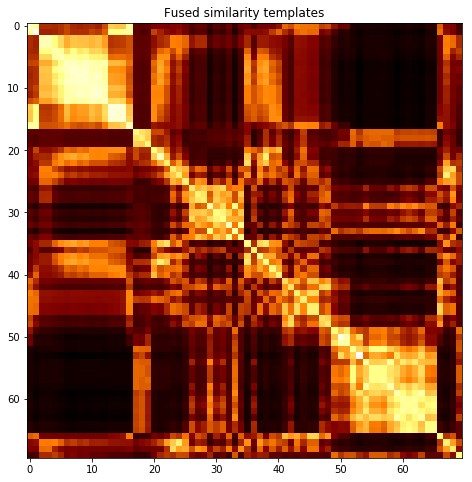

subject 02; gesture 2_0_2


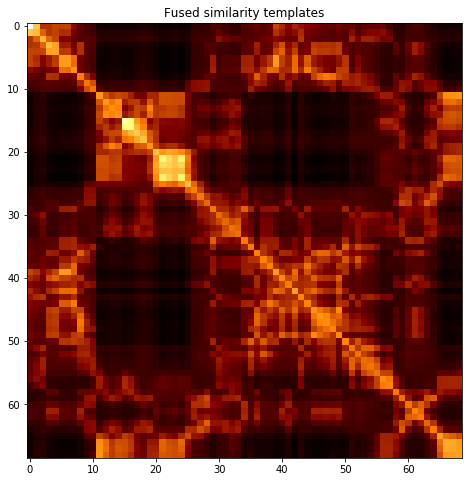

subject 02; gesture 1_1_2


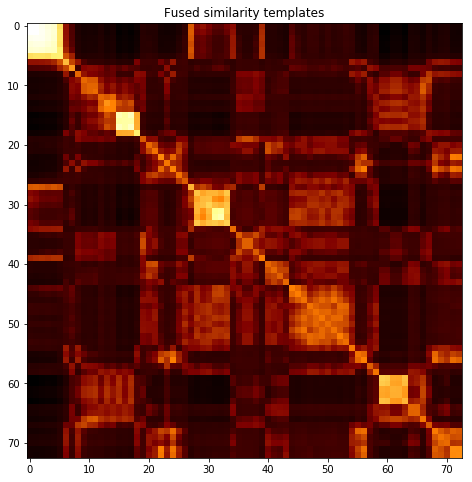

subject 02; gesture 2_1_2


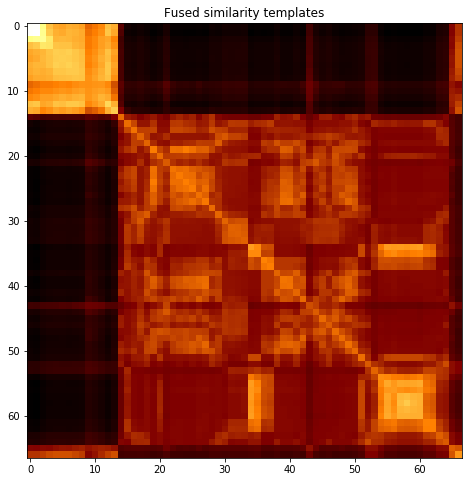

subject 02; gesture 4_0_1


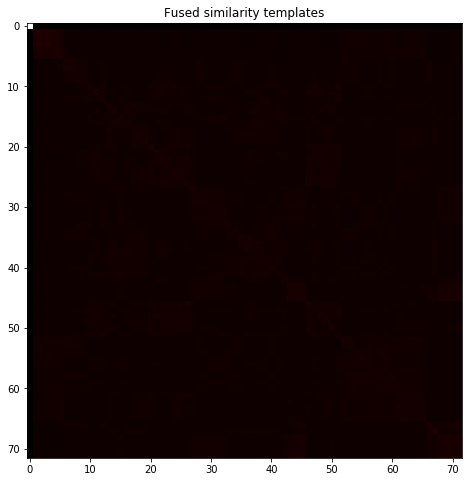

subject 02; gesture 3_0_2


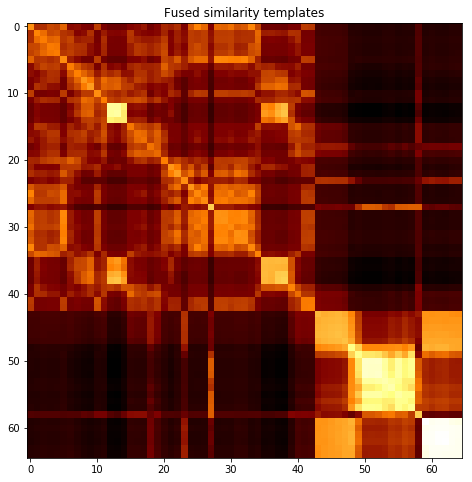

subject 02; gesture 1_1_1


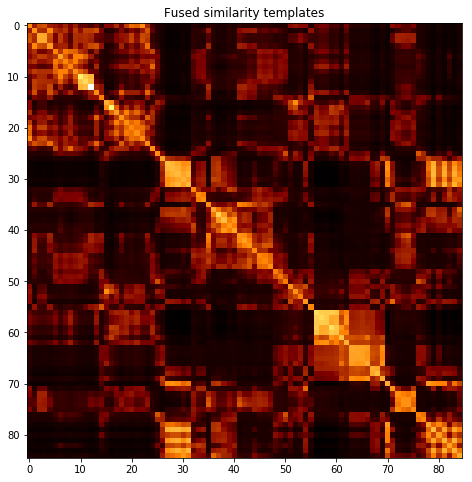

subject 02; gesture 3_1_2


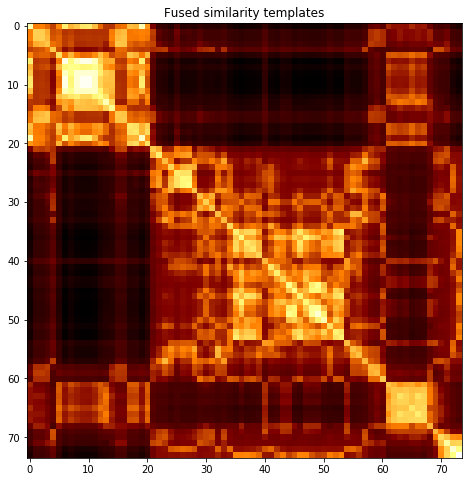

subject 02; gesture 2_1_1


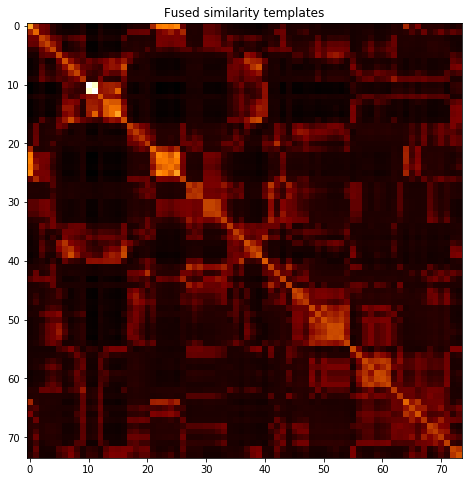

subject 02; gesture 1_0_1


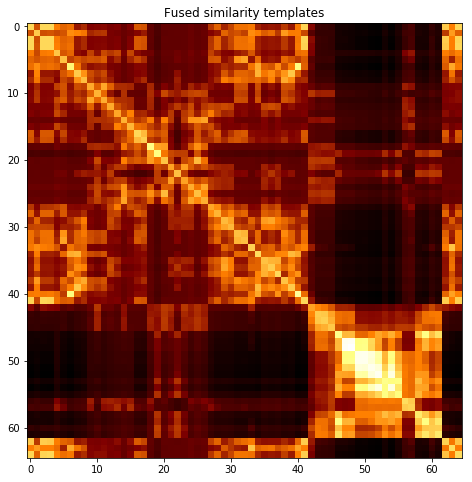

subject 02; gesture 3_1_1


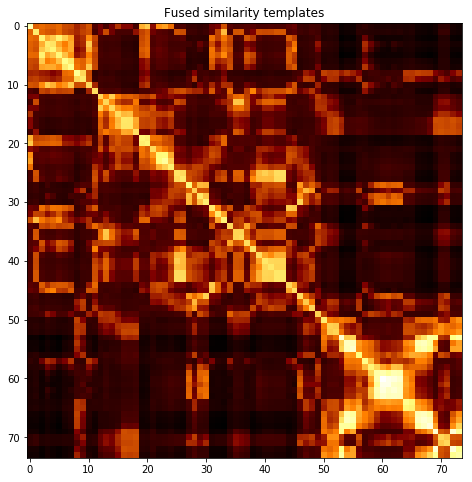

subject 02; gesture 1_0_2


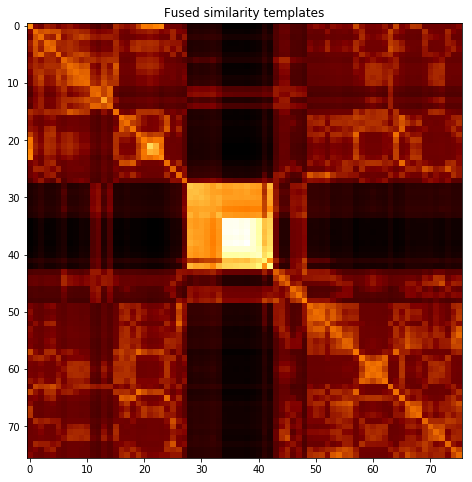

subject 02; gesture 4_0_2


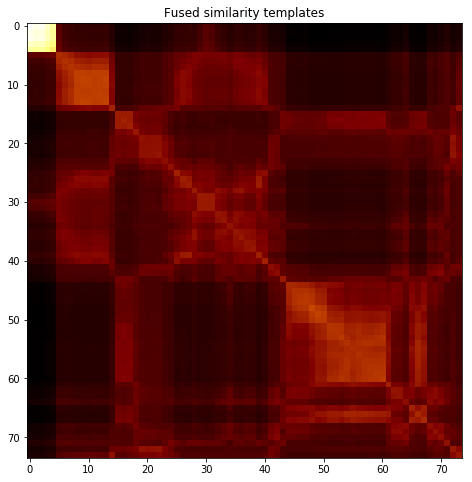

In [5]:
dict_synerg = {}
for s, gdict in dc.data_set_smooth.items():
    dict_synerg[s] = {}
    for g, a in gdict.items():
        snf = SNF(pass_synergist_channels(g[0], a), k=0.2)
        # calculate graph weights to find knn
        snf.calc_weights()
        snf.normalize_weights()
        # generate and normalize knn graphs
        snf.calc_knn_weights()
        snf.normalize_knn_weights()
        # fuse graphs
        snf.network_fusion(iters=20)
        print(f"subject {s}; gesture {g}")
        snf.plot_template()
        # save template to dict
        dict_synerg[s][g] = snf.fused_similarity_template

---

subject 30; gesture 3_0_1; avg 0.5031086486184333; sd 0.03529985751831224
subject 30; gesture 3_0_1; PoV: 0.8486838750949648


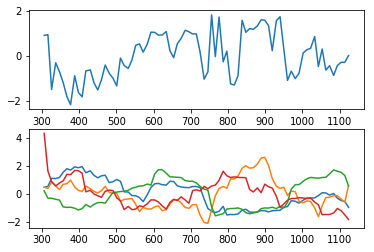

subject 30; gesture 4_1_1; avg 0.6005105931554465; sd 0.028133608855167143
subject 30; gesture 4_1_1; PoV: 0.8759575915363554


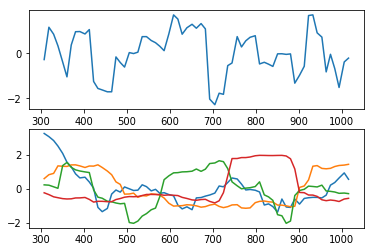

subject 30; gesture 2_0_1; avg 0.5273277678971049; sd 0.04212368255211654
subject 30; gesture 2_0_1; PoV: 0.8443968740141621


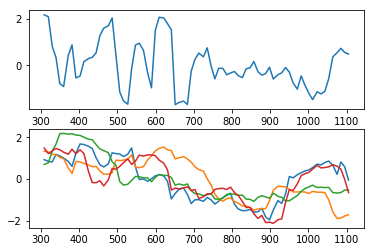

subject 30; gesture 4_1_2; avg 0.5159297928347804; sd 0.05497290812876073
subject 30; gesture 4_1_2; PoV: 0.8038331933046354


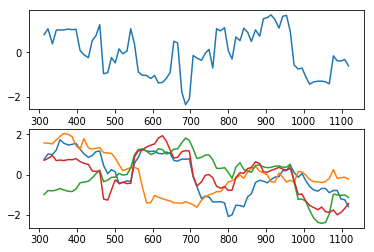

subject 30; gesture 2_0_2; avg 0.5740825537206922; sd 0.025325140055843777
subject 30; gesture 2_0_2; PoV: 0.8717727077225684


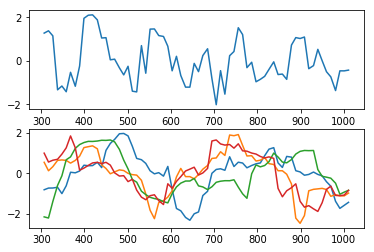

subject 30; gesture 1_1_2; avg 0.47716123722243886; sd 0.023812046222703383
subject 30; gesture 1_1_2; PoV: 0.8702581941745119


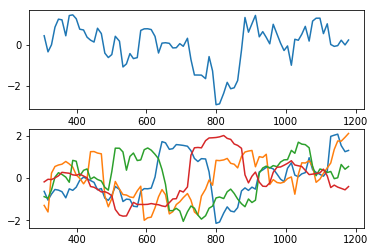

subject 30; gesture 2_1_2; avg 0.5974759404226583; sd 0.07738030945567571
subject 30; gesture 2_1_2; PoV: 0.8129452075604637


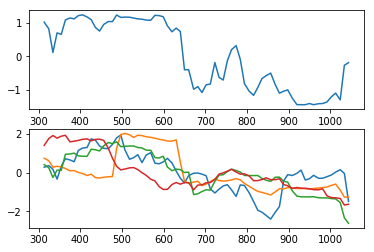

subject 30; gesture 4_0_1; avg 0.5427339961968382; sd 0.03488880903622115
subject 30; gesture 4_0_1; PoV: 0.8588087301115354


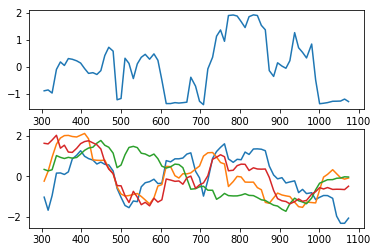

subject 30; gesture 3_0_2; avg 0.6450942777778579; sd 0.029497826024958023
subject 30; gesture 3_0_2; PoV: 0.8827265998579202


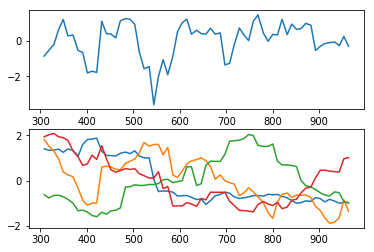

subject 30; gesture 1_1_1; avg 0.46832176551226873; sd 0.026766085523850045
subject 30; gesture 1_1_1; PoV: 0.8605919157631947


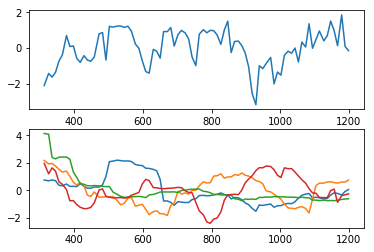

subject 30; gesture 3_1_2; avg 0.5065018764662322; sd 0.023907000681538105
subject 30; gesture 3_1_2; PoV: 0.8772885551522049


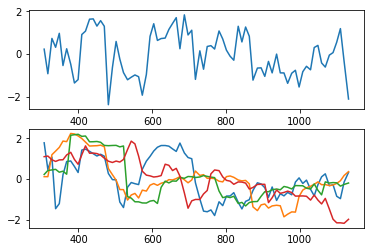

subject 30; gesture 2_1_1; avg 0.4697463048665221; sd 0.024195205917328405
subject 30; gesture 2_1_1; PoV: 0.8689546670588576


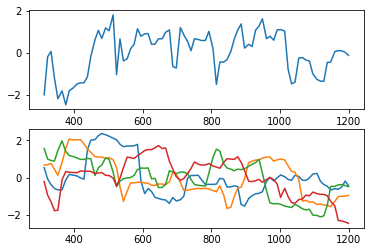

subject 30; gesture 1_0_1; avg 0.4313285946109985; sd 0.017750372571617986
subject 30; gesture 1_0_1; PoV: 0.8799835471576651


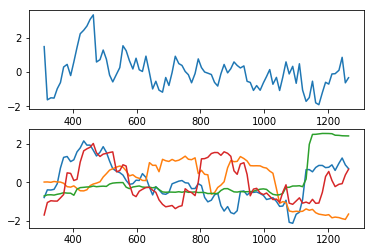

subject 30; gesture 3_1_1; avg 0.4564925717861181; sd 0.020230125451991803
subject 30; gesture 3_1_1; PoV: 0.8655329946057984


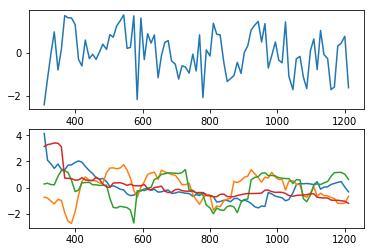

subject 30; gesture 1_0_2; avg 0.5346763765615381; sd 0.070621734628179
subject 30; gesture 1_0_2; PoV: 0.8078626066106396


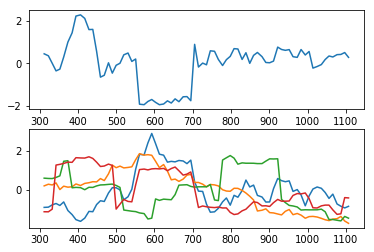

subject 30; gesture 4_0_2; avg 0.5559497440578769; sd 0.04553168269932
subject 30; gesture 4_0_2; PoV: 0.8377836179202229


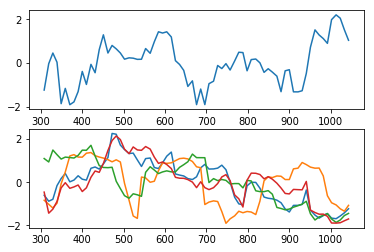

subject 06; gesture 3_0_1; avg 0.7469244270432431; sd 0.18415692116591553
subject 06; gesture 3_0_1; PoV: 0.7320182004371801


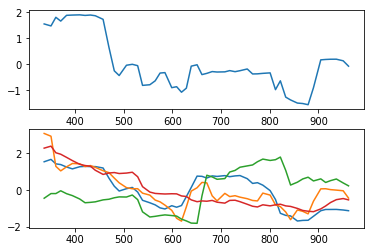

subject 06; gesture 4_1_1; avg 0.584071312900582; sd 0.0898671617917307
subject 06; gesture 4_1_1; PoV: 0.7885689740185159


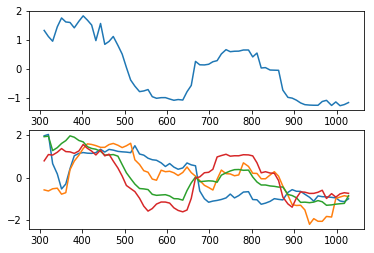

subject 06; gesture 2_0_1; avg 0.6949775807056325; sd 0.06943515942810805
subject 06; gesture 2_0_1; PoV: 0.8291338705612454


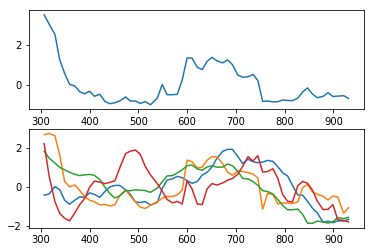

subject 06; gesture 4_1_2; avg 0.6370176772793513; sd 0.14238702026508068
subject 06; gesture 4_1_2; PoV: 0.7539830740023926


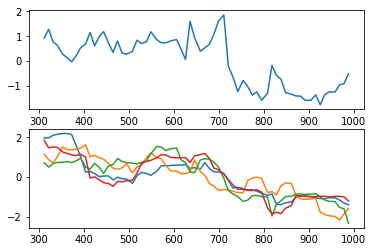

subject 06; gesture 2_0_2; avg 0.7507432978686148; sd 0.03347390090682446
subject 06; gesture 2_0_2; PoV: 0.8802174373478111


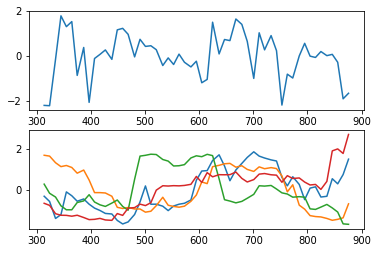

subject 06; gesture 1_1_2; avg 1.0936319998953363; sd 0.08396325115150095
subject 06; gesture 1_1_2; PoV: 0.830228126669307


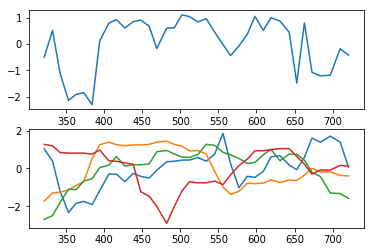

subject 06; gesture 2_1_2; avg 0.677408667652066; sd 0.09262518234004957
subject 06; gesture 2_1_2; PoV: 0.799002816863329


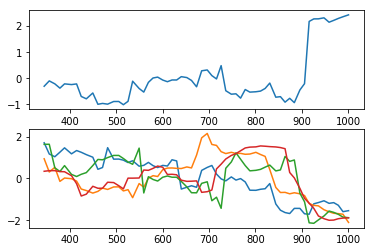

subject 06; gesture 4_0_1; avg 0.6282076168223757; sd 0.05022821727152914
subject 06; gesture 4_0_1; PoV: 0.8353164877440112


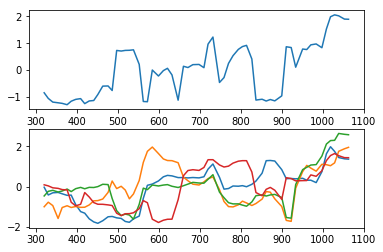

subject 06; gesture 3_0_2; avg 0.6063558634776648; sd 0.033342446076193466
subject 06; gesture 3_0_2; PoV: 0.8617017873774303


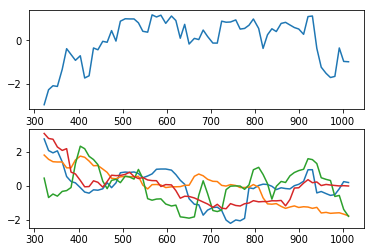

subject 06; gesture 1_1_1; avg 0.5464960626239158; sd 0.02767609498447164
subject 06; gesture 1_1_1; PoV: 0.8690799869341256


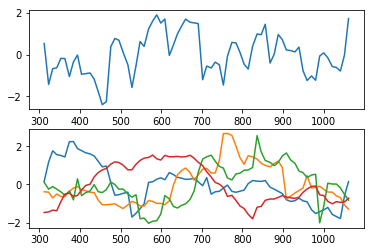

subject 06; gesture 3_1_2; avg 0.5662738047036853; sd 0.027700187809276893
subject 06; gesture 3_1_2; PoV: 0.8705275156442387


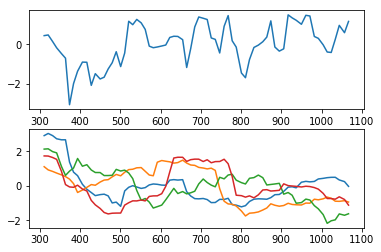

subject 06; gesture 2_1_1; avg 0.5421669105671393; sd 0.03671985506535924
subject 06; gesture 2_1_1; PoV: 0.8505878272728451


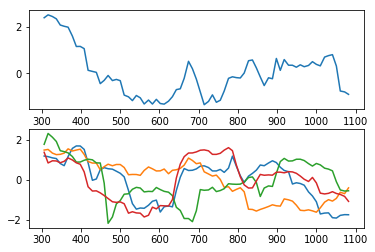

subject 06; gesture 1_0_1; avg 0.600254047063642; sd 0.029547762250460116
subject 06; gesture 1_0_1; PoV: 0.8708457535046381


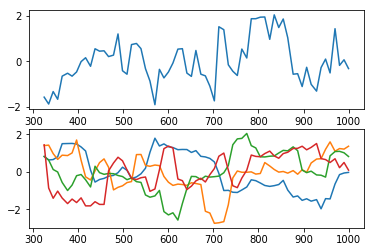

subject 06; gesture 3_1_1; avg 0.5201937310181185; sd 0.1218089569509234
subject 06; gesture 3_1_1; PoV: 0.7394085100502149


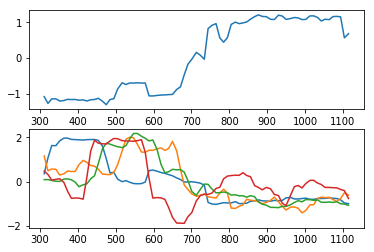

subject 06; gesture 1_0_2; avg 0.754685843182597; sd 0.040658119089235105
subject 06; gesture 1_0_2; PoV: 0.8571321769167977


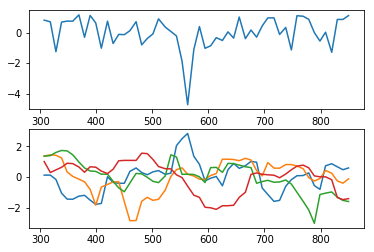

subject 06; gesture 4_0_2; avg 0.5388409640503364; sd 0.02791539051829196
subject 06; gesture 4_0_2; PoV: 0.8637738956639074


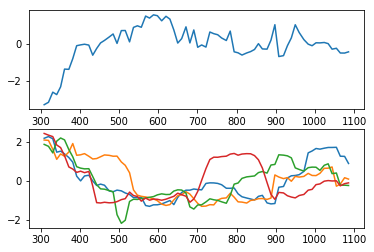

subject 09; gesture 3_0_1; avg 0.735605747118369; sd 0.05545737212225827
subject 09; gesture 3_0_1; PoV: 0.8550102264952942


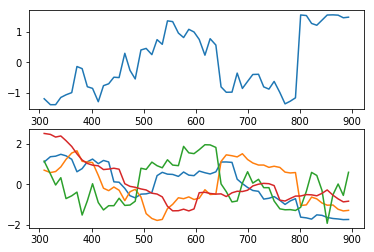

subject 09; gesture 4_1_1; avg 0.7979848109790805; sd 0.05944115031774944
subject 09; gesture 4_1_1; PoV: 0.8435037089727875


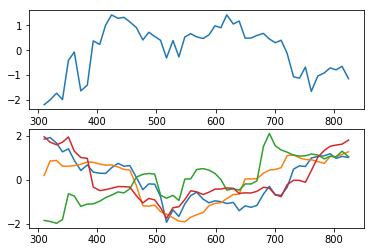

subject 09; gesture 2_0_1; avg 0.7233478602595299; sd 0.04300089947046266
subject 09; gesture 2_0_1; PoV: 0.8566386279999512


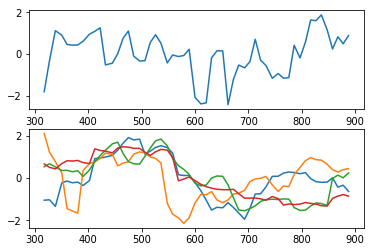

subject 09; gesture 4_1_2; avg 0.6662013202849215; sd 0.03241208081285712
subject 09; gesture 4_1_2; PoV: 0.8685197147966929


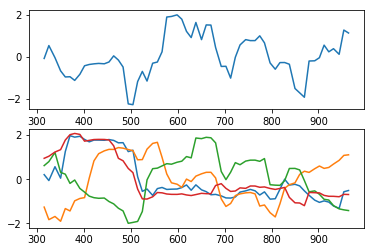

subject 09; gesture 2_0_2; avg 0.6384278364401332; sd 0.0810948190195668
subject 09; gesture 2_0_2; PoV: 0.8094342749092529


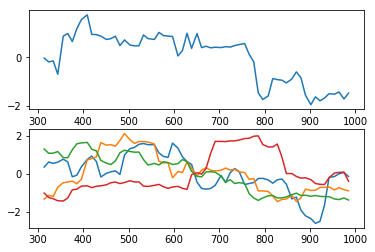

subject 09; gesture 1_1_2; avg 0.5573921758041888; sd 0.02680189872548112
subject 09; gesture 1_1_2; PoV: 0.8662210622049314


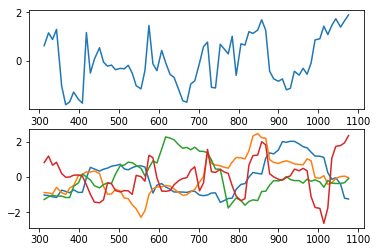

subject 09; gesture 2_1_2; avg 0.6531850622474245; sd 0.06025257255109644
subject 09; gesture 2_1_2; PoV: 0.8366832710433443


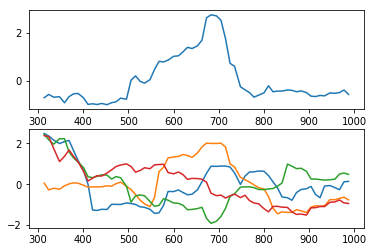

subject 09; gesture 4_0_1; avg 0.6605626479864851; sd 0.03709766551938956
subject 09; gesture 4_0_1; PoV: 0.8559171933672799


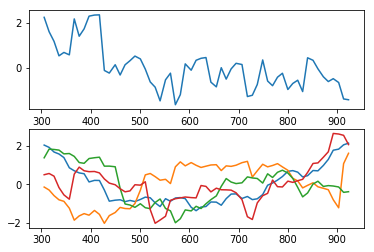

subject 09; gesture 3_0_2; avg 0.6444946045046065; sd 0.045387646564906604
subject 09; gesture 3_0_2; PoV: 0.8514903109478551


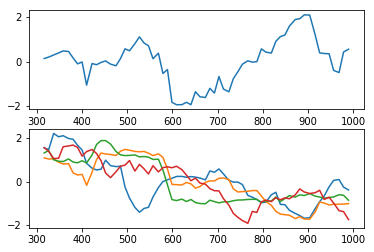

subject 09; gesture 1_1_1; avg 0.6352242673081959; sd 0.12456282425409035
subject 09; gesture 1_1_1; PoV: 0.756759219559376


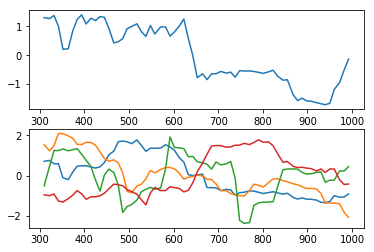

subject 09; gesture 3_1_2; avg 0.6467823019384229; sd 0.03712571518213789
subject 09; gesture 3_1_2; PoV: 0.8573680260650138


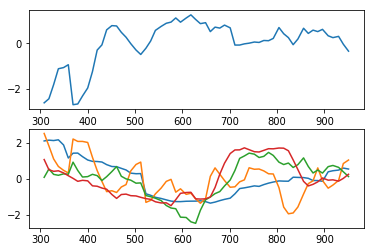

subject 09; gesture 2_1_1; avg 0.7198866700877473; sd 0.09405300927130913
subject 09; gesture 2_1_1; PoV: 0.794782170412051


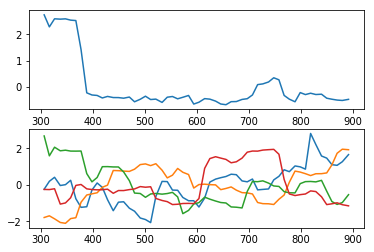

subject 09; gesture 1_0_1; avg 0.4753843700168458; sd 0.0457321470089707
subject 09; gesture 1_0_1; PoV: 0.8381040260423502


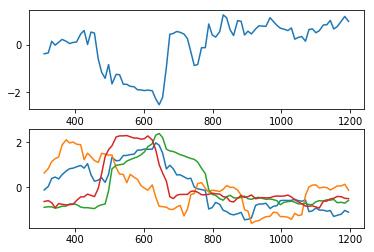

subject 09; gesture 3_1_1; avg 0.8535190360051532; sd 0.13997885734806673
subject 09; gesture 3_1_1; PoV: 0.7771445419024955


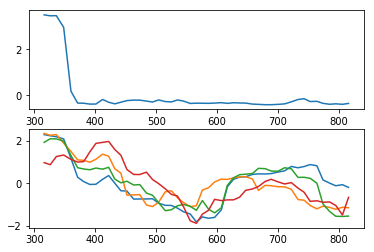

subject 09; gesture 1_0_2; avg 0.5810537075862946; sd 0.02568444303805476
subject 09; gesture 1_0_2; PoV: 0.8792153397696976


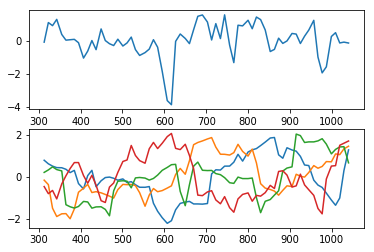

subject 09; gesture 4_0_2; avg 0.7678884544069814; sd 0.06515504505001171
subject 09; gesture 4_0_2; PoV: 0.834410427048551


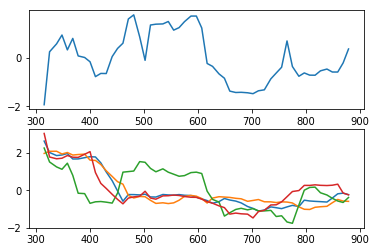

subject 03; gesture 3_0_1; avg 0.6039692297259379; sd 0.09755397327554018
subject 03; gesture 3_0_1; PoV: 0.7944853607046123


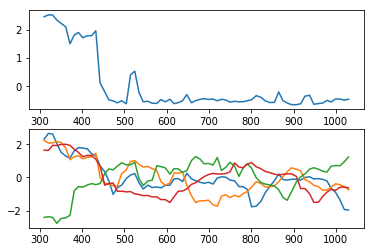

subject 03; gesture 4_1_1; avg 0.6407380566224065; sd 0.031235951446074012
subject 03; gesture 4_1_1; PoV: 0.8608852925838915


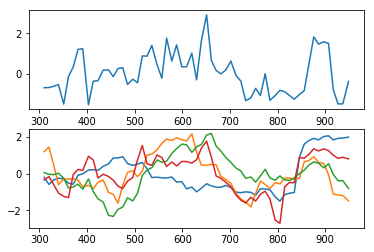

subject 03; gesture 2_0_1; avg 0.593934009969475; sd 0.03442321059033044
subject 03; gesture 2_0_1; PoV: 0.8587062530352348


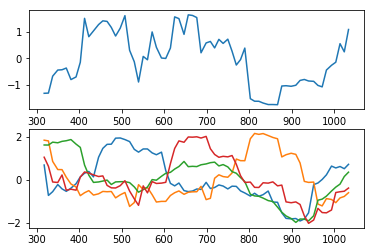

subject 03; gesture 4_1_2; avg 0.8006338639659688; sd 0.28031849509705187
subject 03; gesture 4_1_2; PoV: 0.7057939492719292


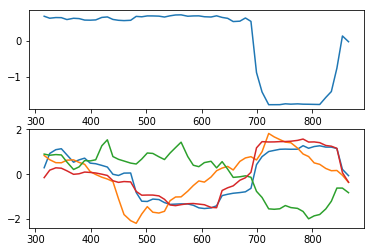

subject 03; gesture 2_0_2; avg 0.6295398643570439; sd 0.03379596815013155
subject 03; gesture 2_0_2; PoV: 0.865994473020119


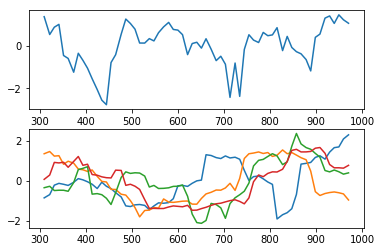

subject 03; gesture 1_1_2; avg 0.5306701345734021; sd 0.02930134854877122
subject 03; gesture 1_1_2; PoV: 0.8578055694289958


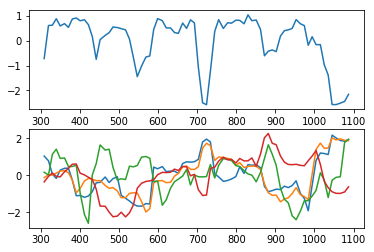

subject 03; gesture 2_1_2; avg 0.6047048154689084; sd 0.03406141747877333
subject 03; gesture 2_1_2; PoV: 0.8620171544657993


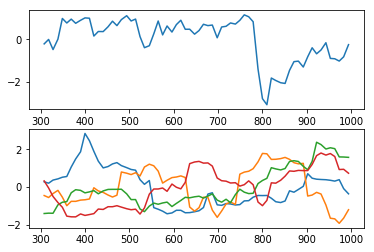

subject 03; gesture 4_0_1; avg 0.5461506974590439; sd 0.03669721844940879
subject 03; gesture 4_0_1; PoV: 0.8439311712686796


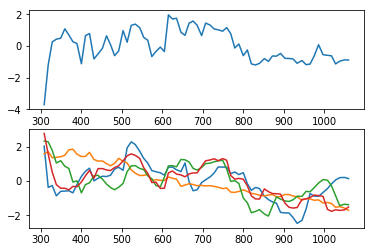

subject 03; gesture 3_0_2; avg 0.5280244653288267; sd 0.028070148568174507
subject 03; gesture 3_0_2; PoV: 0.8669645174554113


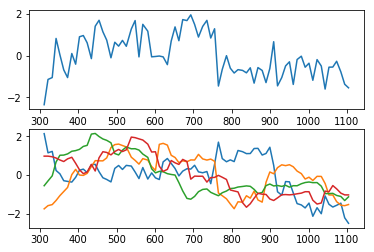

subject 03; gesture 1_1_1; avg 0.7511999998652541; sd 0.045425188210119656
subject 03; gesture 1_1_1; PoV: 0.8588771244292094


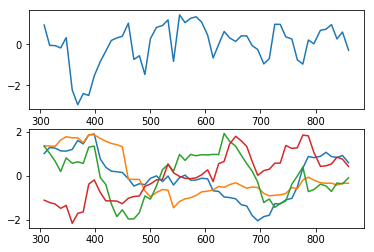

subject 03; gesture 3_1_2; avg 0.7834556261556794; sd 0.03874314041552268
subject 03; gesture 3_1_2; PoV: 0.8641693847559082


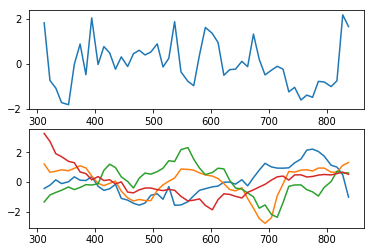

subject 03; gesture 2_1_1; avg 0.7286318372641016; sd 0.03417698237311632
subject 03; gesture 2_1_1; PoV: 0.8710526757505309


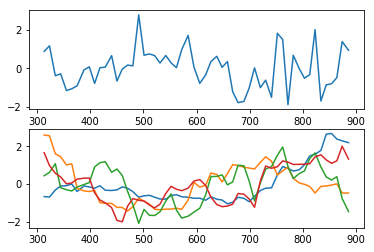

subject 03; gesture 1_0_1; avg 0.5734094756550157; sd 0.032679722149477036
subject 03; gesture 1_0_1; PoV: 0.8599486678432924


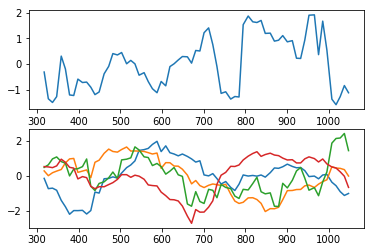

subject 03; gesture 3_1_1; avg 0.6373659949835517; sd 0.038594614863429015
subject 03; gesture 3_1_1; PoV: 0.8519470356237704


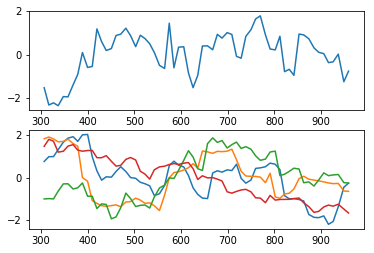

subject 03; gesture 1_0_2; avg 0.6538456965216239; sd 0.030706048971020364
subject 03; gesture 1_0_2; PoV: 0.8713592463929002


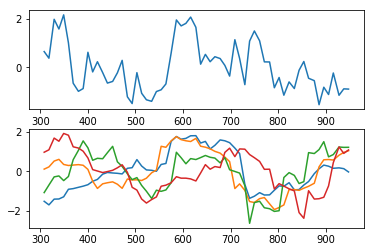

subject 03; gesture 4_0_2; avg 0.5624412796089515; sd 0.03969069615398411
subject 03; gesture 4_0_2; PoV: 0.8474011674495886


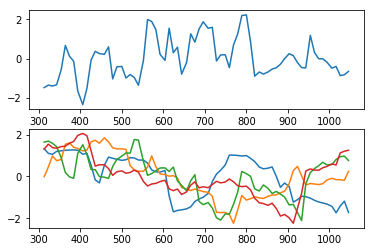

subject 05; gesture 3_0_1; avg 0.7191695161875652; sd 0.043459140824081366
subject 05; gesture 3_0_1; PoV: 0.8543013836653446


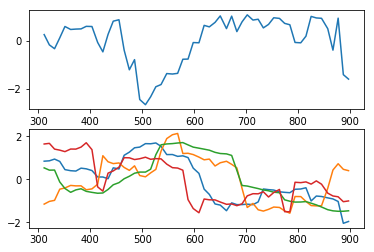

subject 05; gesture 4_1_1; avg 0.6220669264101802; sd 0.036344098840087144
subject 05; gesture 4_1_1; PoV: 0.8640296857577896


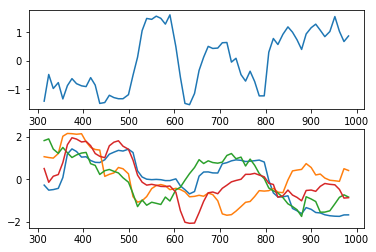

subject 05; gesture 2_0_1; avg 0.593702128395471; sd 0.04344216940205323
subject 05; gesture 2_0_1; PoV: 0.8512111407846086


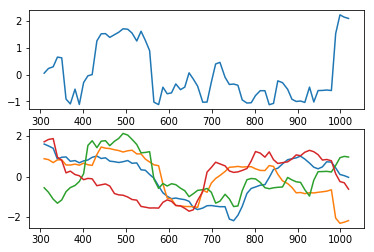

subject 05; gesture 4_1_2; avg 0.5261509910423027; sd 0.027197843193535753
subject 05; gesture 4_1_2; PoV: 0.875434227774655


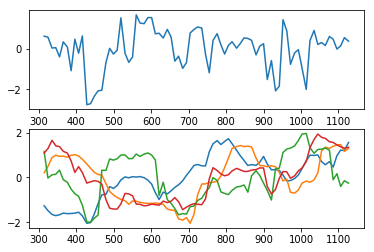

subject 05; gesture 2_0_2; avg 0.5594353472294576; sd 0.05039297395882561
subject 05; gesture 2_0_2; PoV: 0.8249162631751171


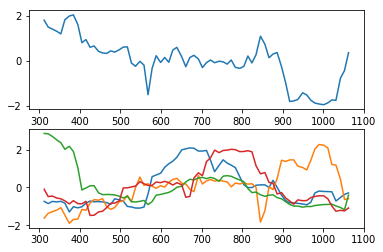

subject 05; gesture 1_1_2; avg 0.7382418067206991; sd 0.040474880011128776
subject 05; gesture 1_1_2; PoV: 0.8646650308889288


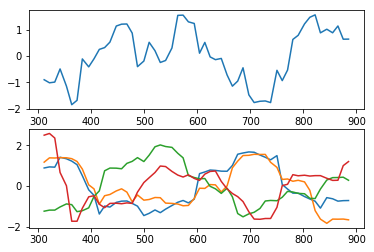

subject 05; gesture 2_1_2; avg 0.5023109483900086; sd 0.027235929075941325
subject 05; gesture 2_1_2; PoV: 0.8603447804675758


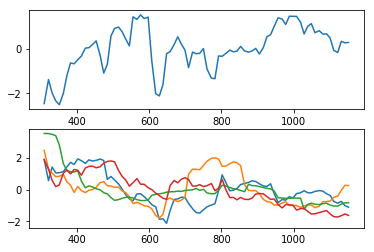

subject 05; gesture 4_0_1; avg 0.739154184582272; sd 0.07201376513641058
subject 05; gesture 4_0_1; PoV: 0.8367678414956732


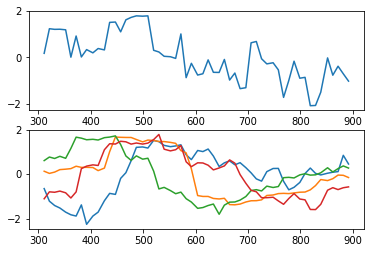

subject 05; gesture 3_0_2; avg 0.44573386870138726; sd 0.030507617291969234
subject 05; gesture 3_0_2; PoV: 0.8572038379426223


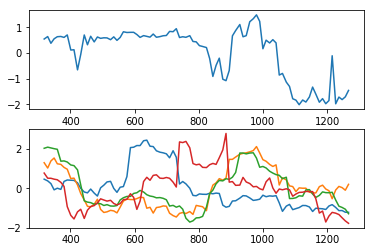

subject 05; gesture 1_1_1; avg 0.7289892855088665; sd 0.04326541626894596
subject 05; gesture 1_1_1; PoV: 0.8588358904156156


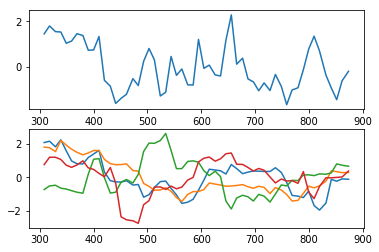

subject 05; gesture 3_1_2; avg 0.6338606222206569; sd 0.02916132477039155
subject 05; gesture 3_1_2; PoV: 0.8728363098702678


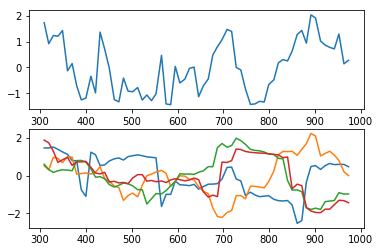

subject 05; gesture 2_1_1; avg 0.7898091946381711; sd 0.06621801676639792
subject 05; gesture 2_1_1; PoV: 0.8351643153631209


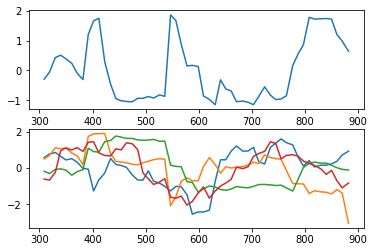

subject 05; gesture 1_0_1; avg 0.46445957835105567; sd 0.02088048053843387
subject 05; gesture 1_0_1; PoV: 0.8725585741395767


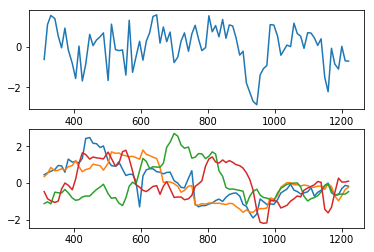

subject 05; gesture 3_1_1; avg 0.611579500941599; sd 0.0476629889517202
subject 05; gesture 3_1_1; PoV: 0.8414381580414552


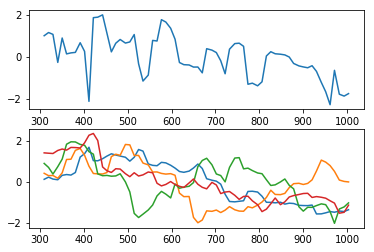

subject 05; gesture 1_0_2; avg 0.5974174446995247; sd 0.025450444603254
subject 05; gesture 1_0_2; PoV: 0.875628585644102


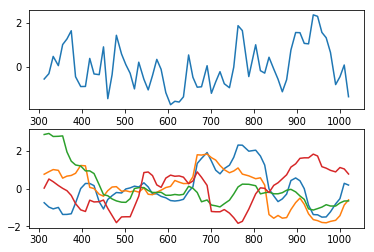

subject 05; gesture 4_0_2; avg 0.5441080782397791; sd 0.02487348841907097
subject 05; gesture 4_0_2; PoV: 0.8822970717734767


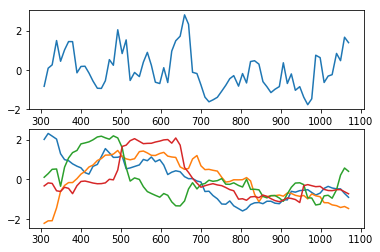

subject 21; gesture 3_0_1; avg 0.5345073521951283; sd 0.04031514533087388
subject 21; gesture 3_0_1; PoV: 0.8489943482121616


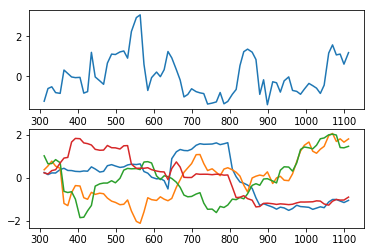

subject 21; gesture 4_1_1; avg 0.7684424677741843; sd 0.03921124066919131
subject 21; gesture 4_1_1; PoV: 0.8604135927725817


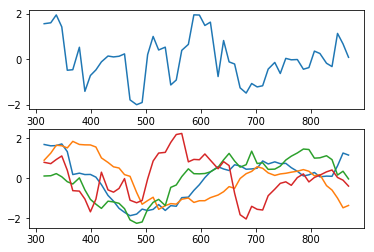

subject 21; gesture 2_0_1; avg 0.5527513849204273; sd 0.04035442413344194
subject 21; gesture 2_0_1; PoV: 0.8492647780154171


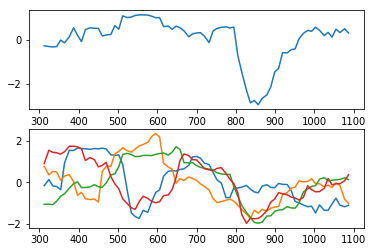

subject 21; gesture 4_1_2; avg 0.7249782460451516; sd 0.15867224238905098
subject 21; gesture 4_1_2; PoV: 0.7605188523101775


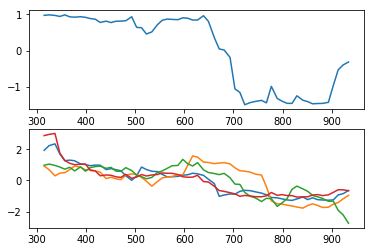

subject 21; gesture 2_0_2; avg 0.6911061141809448; sd 0.055740853741137415
subject 21; gesture 2_0_2; PoV: 0.8440945069257894


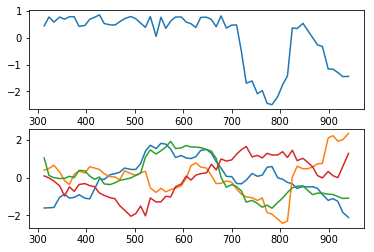

subject 21; gesture 1_1_2; avg 0.5573784164039192; sd 0.02425888368476173
subject 21; gesture 1_1_2; PoV: 0.8749514154400547


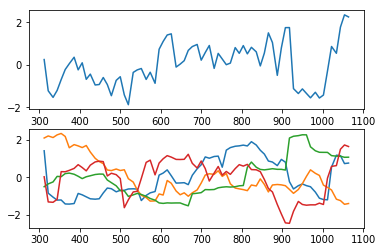

subject 21; gesture 2_1_2; avg 0.6159509687350975; sd 0.02820578913960924
subject 21; gesture 2_1_2; PoV: 0.8702334210557366


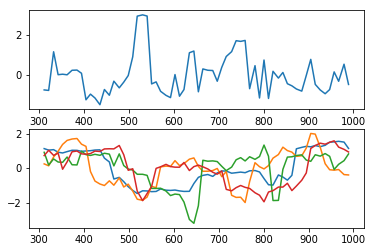

subject 21; gesture 4_0_1; avg 0.5872514930422785; sd 0.04045642521714422
subject 21; gesture 4_0_1; PoV: 0.8421632715678986


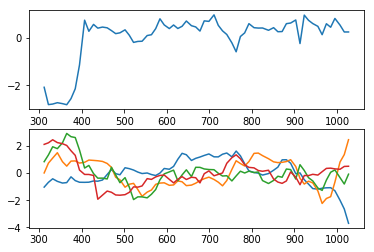

subject 21; gesture 3_0_2; avg 0.6420981792197806; sd 0.04225054765038332
subject 21; gesture 3_0_2; PoV: 0.8425653608085387


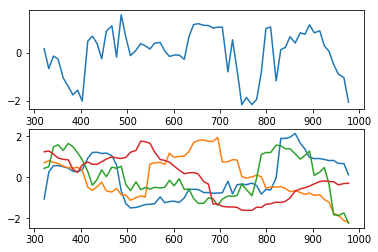

subject 21; gesture 1_1_1; avg 0.6725515060084375; sd 0.21913731207072235
subject 21; gesture 1_1_1; PoV: 0.6964107617019211


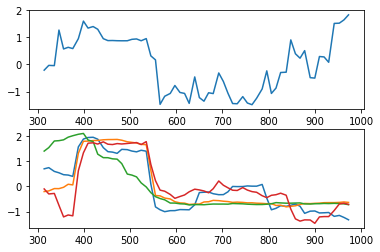

subject 21; gesture 3_1_2; avg 0.6060735506946453; sd 0.04478624829895157
subject 21; gesture 3_1_2; PoV: 0.8508591874012087


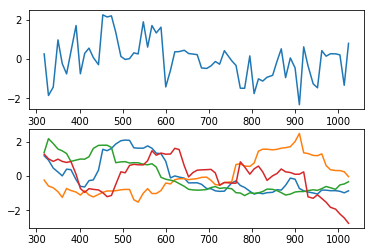

subject 21; gesture 2_1_1; avg 0.5081074811735115; sd 0.0297528093161147
subject 21; gesture 2_1_1; PoV: 0.8551700115789617


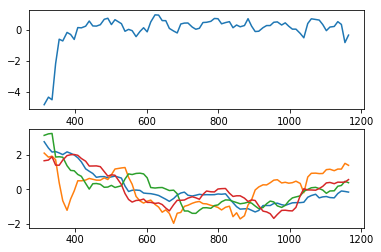

subject 21; gesture 1_0_1; avg 0.6784386031048701; sd 0.03014970642138758
subject 21; gesture 1_0_1; PoV: 0.8784282110858547


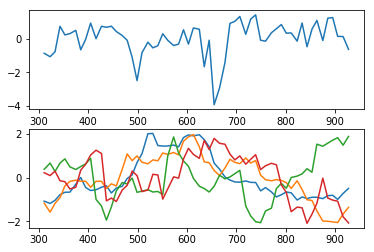

subject 21; gesture 3_1_1; avg 0.554230522582185; sd 0.05245517426595921
subject 21; gesture 3_1_1; PoV: 0.8295606024638571


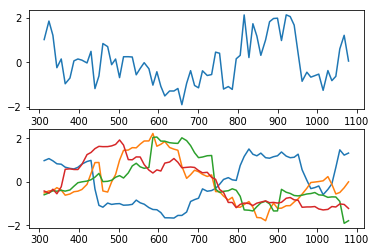

subject 21; gesture 1_0_2; avg 0.7060427962678525; sd 0.03699651793004986
subject 21; gesture 1_0_2; PoV: 0.8631132278527679


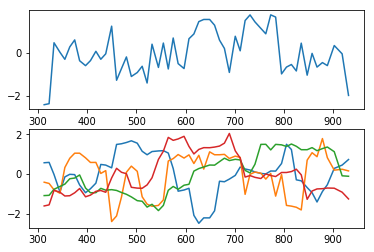

subject 21; gesture 4_0_2; avg 0.5976517607607646; sd 0.037622329787247756
subject 21; gesture 4_0_2; PoV: 0.8492914318141356


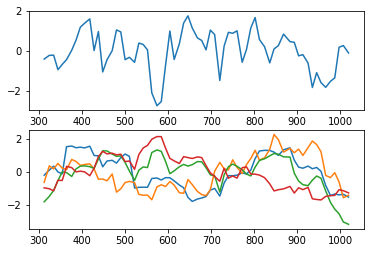

subject 17; gesture 3_0_1; avg 0.5666456181840952; sd 0.039993736639345585
subject 17; gesture 3_0_1; PoV: 0.8459269898227642


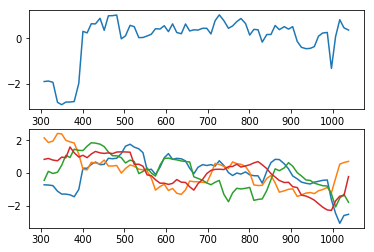

subject 17; gesture 4_1_1; avg 0.6631986380333478; sd 0.06701383906405366
subject 17; gesture 4_1_1; PoV: 0.8268022525920534


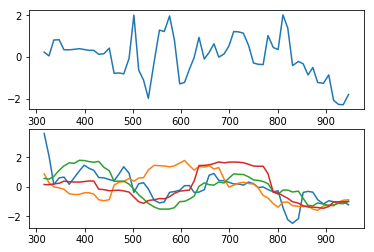

subject 17; gesture 2_0_1; avg 0.6167477596819725; sd 0.09542155151811423
subject 17; gesture 2_0_1; PoV: 0.7919383741922695


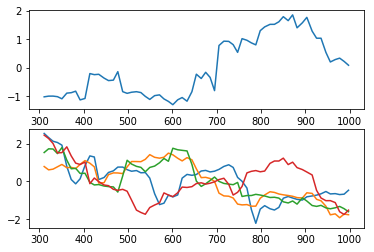

subject 17; gesture 4_1_2; avg 0.5450385505275365; sd 0.04381138664385649
subject 17; gesture 4_1_2; PoV: 0.8453415537899095


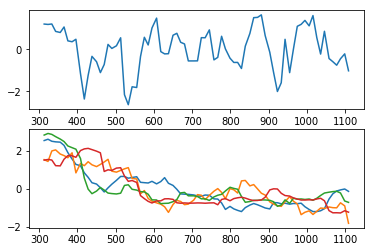

subject 17; gesture 2_0_2; avg 0.6146507210708829; sd 0.03148102736131154
subject 17; gesture 2_0_2; PoV: 0.8674127368523259


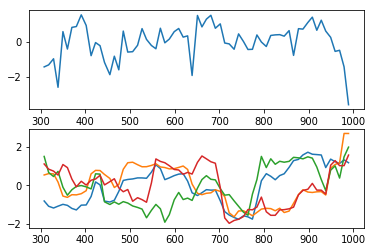

subject 17; gesture 1_1_2; avg 0.5544897596517051; sd 0.02378811584605243
subject 17; gesture 1_1_2; PoV: 0.8843707769245982


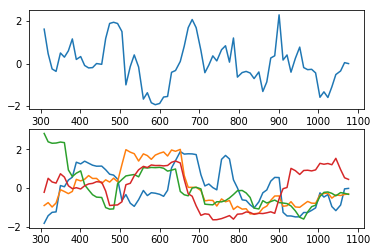

subject 17; gesture 2_1_2; avg 0.5682294635796185; sd 0.038000767430149136
subject 17; gesture 2_1_2; PoV: 0.8567255376249702


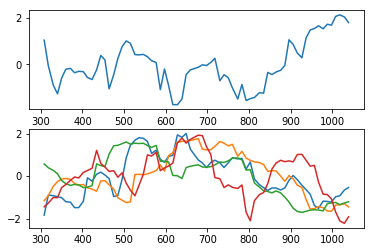

subject 17; gesture 4_0_1; avg 0.5649375686996306; sd 0.03298699653020478
subject 17; gesture 4_0_1; PoV: 0.860102940588461


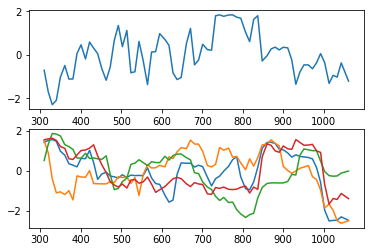

subject 17; gesture 3_0_2; avg 0.6406568241560859; sd 0.04166578249968998
subject 17; gesture 3_0_2; PoV: 0.8533867627893411


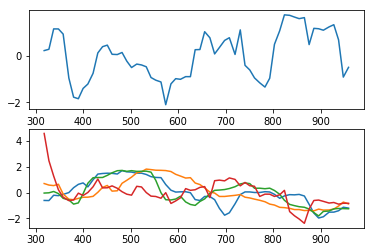

subject 17; gesture 1_1_1; avg 0.6507552467254103; sd 0.02944734449581653
subject 17; gesture 1_1_1; PoV: 0.8710297116026399


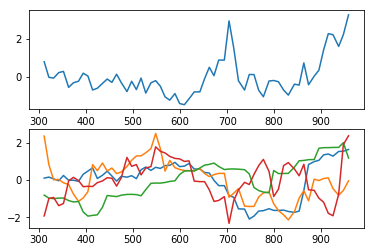

subject 17; gesture 3_1_2; avg 0.5257856383196057; sd 0.02334369480680355
subject 17; gesture 3_1_2; PoV: 0.8734531462076492


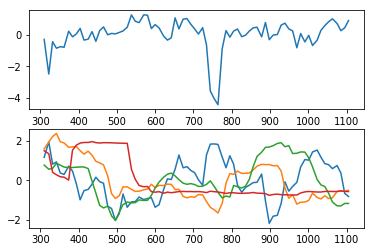

subject 17; gesture 2_1_1; avg 0.5623042022372524; sd 0.0642283444719366
subject 17; gesture 2_1_1; PoV: 0.8064899486568654


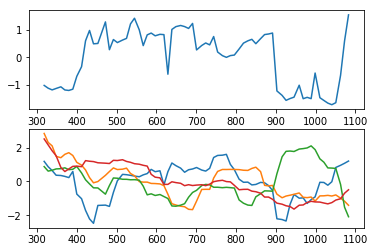

subject 17; gesture 1_0_1; avg 0.5703884889575057; sd 0.025653208230252987
subject 17; gesture 1_0_1; PoV: 0.8691462316935601


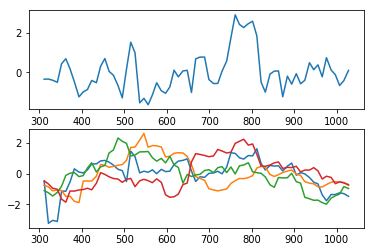

subject 17; gesture 3_1_1; avg 0.6227464440482258; sd 0.042367459357648206
subject 17; gesture 3_1_1; PoV: 0.8521358213798119


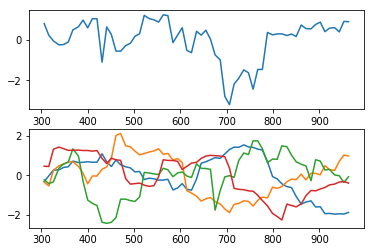

subject 17; gesture 1_0_2; avg 0.6580831200775533; sd 0.029638053296177386
subject 17; gesture 1_0_2; PoV: 0.8769225508096796


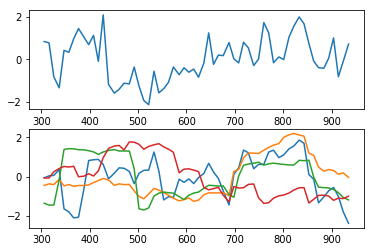

subject 17; gesture 4_0_2; avg 0.5855298729459867; sd 0.027691082377103365
subject 17; gesture 4_0_2; PoV: 0.8755510450464555


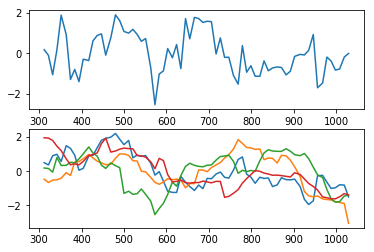

subject 01; gesture 3_0_1; avg 0.48280586768966854; sd 0.0966081584996925
subject 01; gesture 3_0_1; PoV: 0.7651224431137381


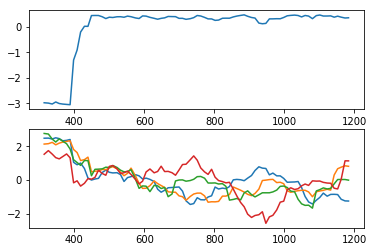

subject 01; gesture 4_1_1; avg 0.5825633653155805; sd 0.04564780843709479
subject 01; gesture 4_1_1; PoV: 0.8474996225397129


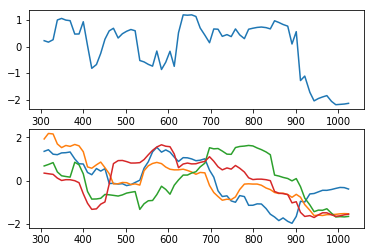

subject 01; gesture 2_0_1; avg 0.5703916045003716; sd 0.023277099502791294
subject 01; gesture 2_0_1; PoV: 0.8873956655205857


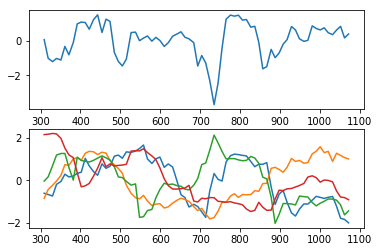

subject 01; gesture 4_1_2; avg 0.6433907149374818; sd 0.42044450155722324
subject 01; gesture 4_1_2; PoV: 0.573004125383552


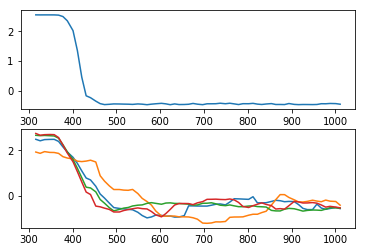

subject 01; gesture 2_0_2; avg 0.6400017276459058; sd 0.06156417674513234
subject 01; gesture 2_0_2; PoV: 0.8277238487961791


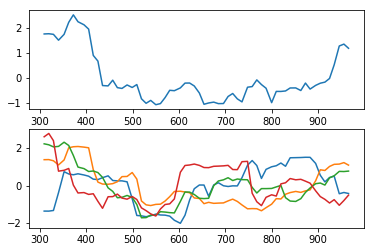

subject 01; gesture 1_1_2; avg 0.6208418621817821; sd 0.04051099206363616
subject 01; gesture 1_1_2; PoV: 0.8536862967911222


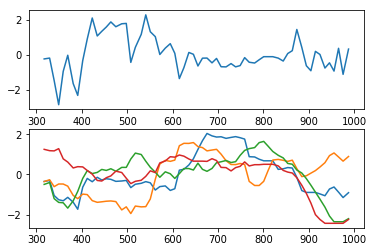

subject 01; gesture 2_1_2; avg 0.5777943681617786; sd 0.03147258667356081
subject 01; gesture 2_1_2; PoV: 0.8652245087661931


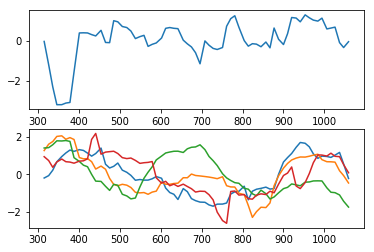

subject 01; gesture 4_0_1; avg 0.5774442479081787; sd 0.029088662518540146
subject 01; gesture 4_0_1; PoV: 0.8675075870028379


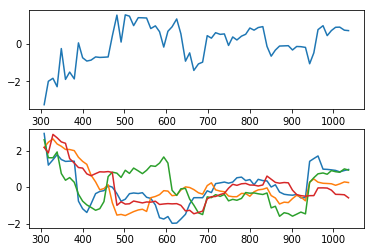

subject 01; gesture 3_0_2; avg 0.5886499323922662; sd 0.03747361135512018
subject 01; gesture 3_0_2; PoV: 0.8606982446485979


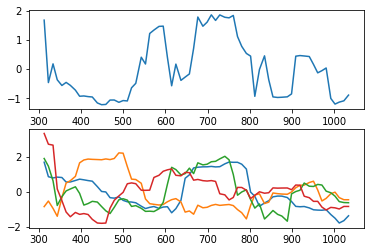

subject 01; gesture 1_1_1; avg 0.5871961282017524; sd 0.02562581731854268
subject 01; gesture 1_1_1; PoV: 0.8671189626969487


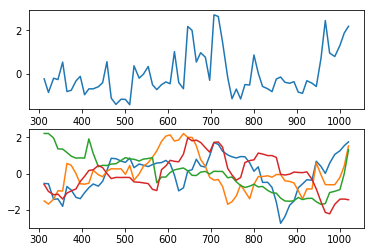

subject 01; gesture 3_1_2; avg 0.5413988054051599; sd 0.05797517015167462
subject 01; gesture 3_1_2; PoV: 0.8192305599133511


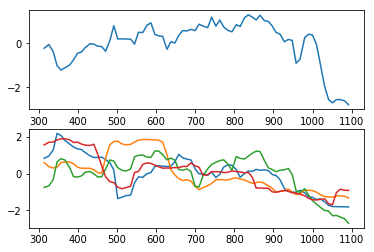

subject 01; gesture 2_1_1; avg 0.5723171633831108; sd 0.056318541368192705
subject 01; gesture 2_1_1; PoV: 0.8206368032120835


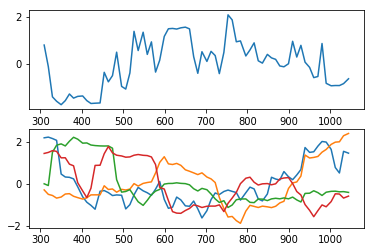

subject 01; gesture 1_0_1; avg 0.4389946346533654; sd 0.017874507023968554
subject 01; gesture 1_0_1; PoV: 0.8802766440384995


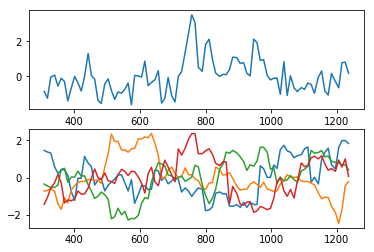

subject 01; gesture 3_1_1; avg 0.5272500444321461; sd 0.034645572648706886
subject 01; gesture 3_1_1; PoV: 0.8544597644032


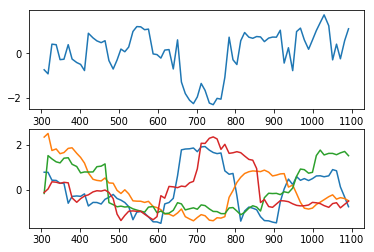

subject 01; gesture 1_0_2; avg 0.4903501694850983; sd 0.021359223673025295
subject 01; gesture 1_0_2; PoV: 0.8710512892631023


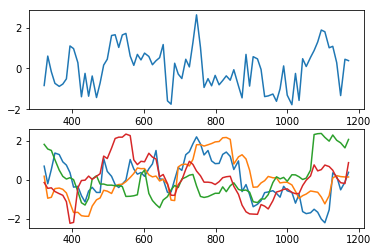

subject 01; gesture 4_0_2; avg 0.5879737641355007; sd 0.06448109023266604
subject 01; gesture 4_0_2; PoV: 0.8097269359450991


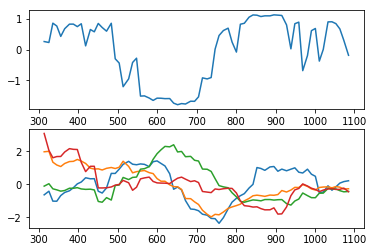

subject 16; gesture 3_0_1; avg 0.4884635233585219; sd 0.03890046696276105
subject 16; gesture 3_0_1; PoV: 0.8382376418222466


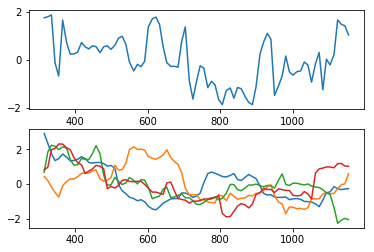

subject 16; gesture 4_1_1; avg 0.6688553649781929; sd 0.14074477571271773
subject 16; gesture 4_1_1; PoV: 0.7307537836526492


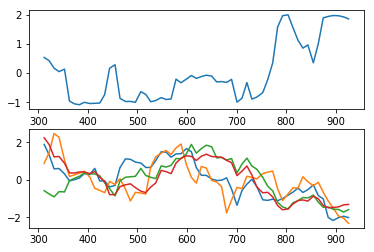

subject 16; gesture 2_0_1; avg 0.6648819758515081; sd 0.15057700154198414
subject 16; gesture 2_0_1; PoV: 0.7415410523986309


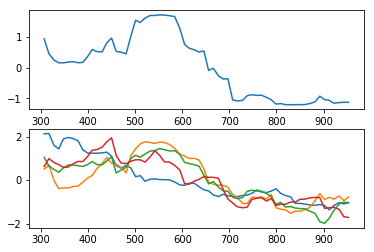

subject 16; gesture 4_1_2; avg 0.493087572526827; sd 0.12361529671183703
subject 16; gesture 4_1_2; PoV: 0.7168915815395118


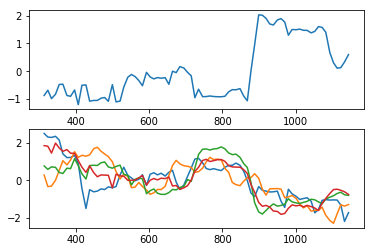

subject 16; gesture 2_0_2; avg 0.6363425015675991; sd 0.034765414876733375
subject 16; gesture 2_0_2; PoV: 0.8700198067326198


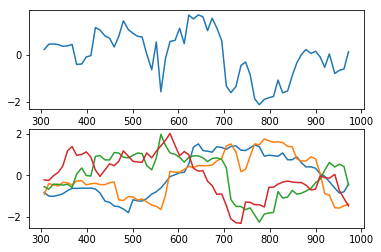

subject 16; gesture 1_1_2; avg 0.7714198423664499; sd 0.03514550146390555
subject 16; gesture 1_1_2; PoV: 0.8709515882516353


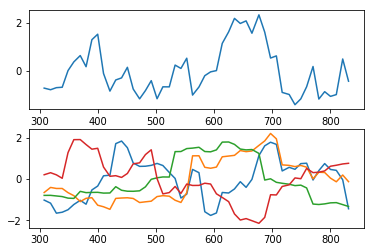

subject 16; gesture 2_1_2; avg 0.5429441324646942; sd 0.03596789882721502
subject 16; gesture 2_1_2; PoV: 0.8568608059559186


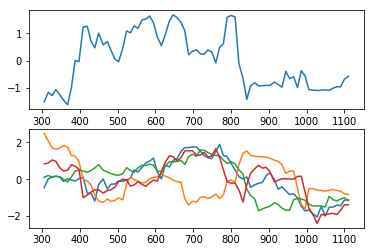

subject 16; gesture 4_0_1; avg 0.5459186008607173; sd 0.029422071399977417
subject 16; gesture 4_0_1; PoV: 0.8676916460692543


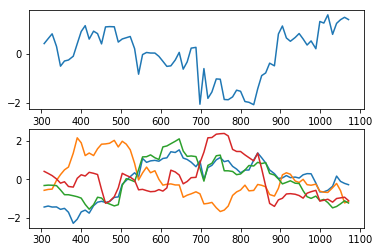

subject 16; gesture 3_0_2; avg 0.5636302749999351; sd 0.02741523560830359
subject 16; gesture 3_0_2; PoV: 0.8691081161147621


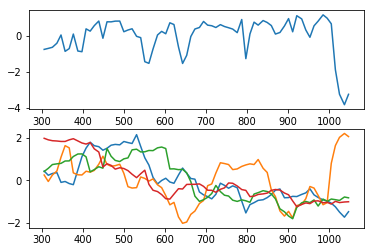

subject 16; gesture 1_1_1; avg 0.5539505864485142; sd 0.03131753725798447
subject 16; gesture 1_1_1; PoV: 0.857608454308774


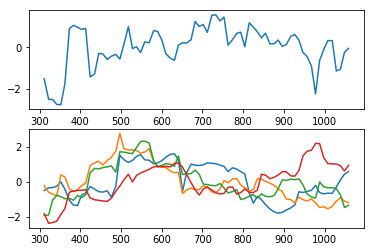

subject 16; gesture 3_1_2; avg 0.5247014630107932; sd 0.034497065507768127
subject 16; gesture 3_1_2; PoV: 0.8533521795210234


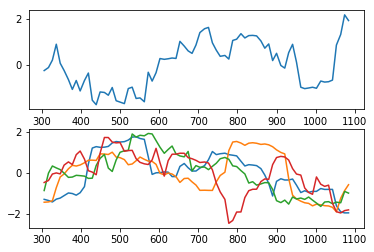

subject 16; gesture 2_1_1; avg 0.5780820974550002; sd 0.04201727919442894
subject 16; gesture 2_1_1; PoV: 0.8559309645725361


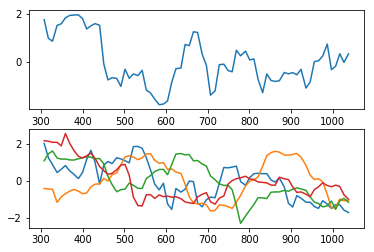

subject 16; gesture 1_0_1; avg 0.9093806114545294; sd 0.048758409567804716
subject 16; gesture 1_0_1; PoV: 0.8674796255796129


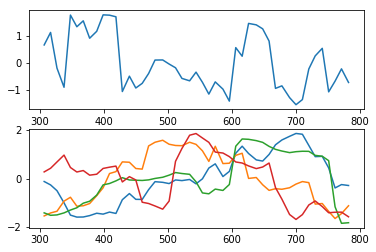

subject 16; gesture 3_1_1; avg 0.5581243721727257; sd 0.02772612972040194
subject 16; gesture 3_1_1; PoV: 0.8614051060610303


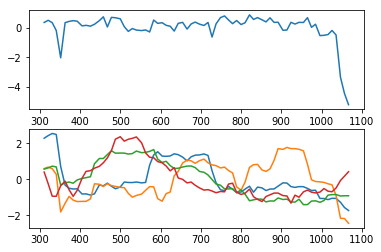

subject 16; gesture 1_0_2; avg 0.724112029058187; sd 0.03564964438436017
subject 16; gesture 1_0_2; PoV: 0.8694597019860596


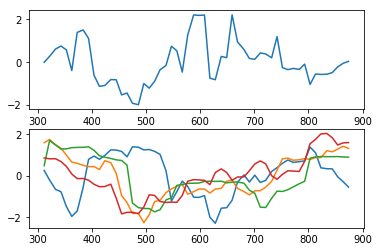

subject 16; gesture 4_0_2; avg 0.5050331616357351; sd 0.022889170651541214
subject 16; gesture 4_0_2; PoV: 0.876432536786829


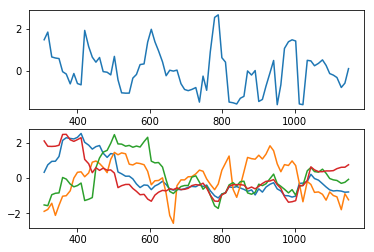

subject 26; gesture 3_0_1; avg 0.5973818954050379; sd 0.06472210901492448
subject 26; gesture 3_0_1; PoV: 0.8131692066363978


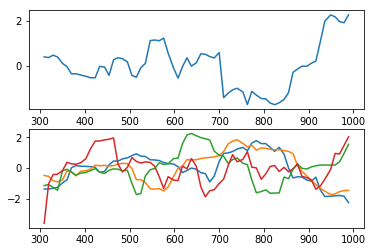

subject 26; gesture 4_1_1; avg 0.7567066456439482; sd 0.14486401746552527
subject 26; gesture 4_1_1; PoV: 0.7565727697769475


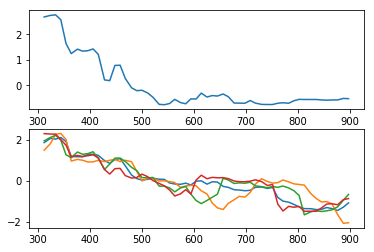

subject 26; gesture 2_0_1; avg 0.7537465585263624; sd 0.03756496494645899
subject 26; gesture 2_0_1; PoV: 0.8704814244680167


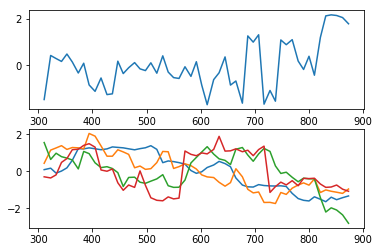

subject 26; gesture 4_1_2; avg 0.48165468088101415; sd 0.08231415165332191
subject 26; gesture 4_1_2; PoV: 0.7955996938139762


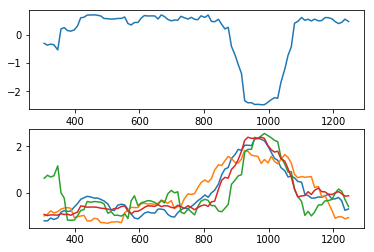

subject 26; gesture 2_0_2; avg 0.6683296498591639; sd 0.0438958027709126
subject 26; gesture 2_0_2; PoV: 0.855451690290198


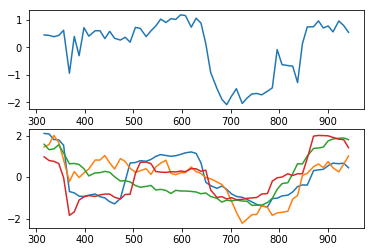

subject 26; gesture 1_1_2; avg 0.7245912248527329; sd 0.03148645088672005
subject 26; gesture 1_1_2; PoV: 0.8720459789057703


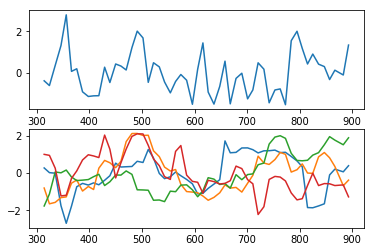

subject 26; gesture 2_1_2; avg 0.6046761318970129; sd 0.03509240852272648
subject 26; gesture 2_1_2; PoV: 0.8650865012016858


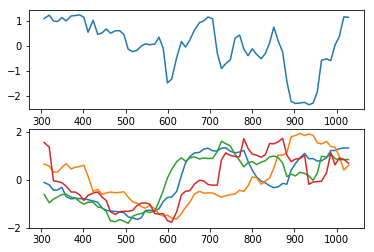

subject 26; gesture 4_0_1; avg 0.7898545400866147; sd 0.07137889310546222
subject 26; gesture 4_0_1; PoV: 0.8230420412238816


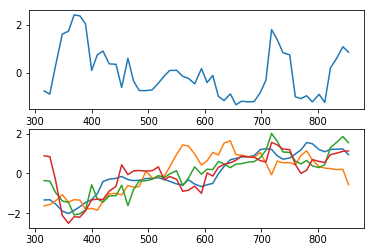

subject 26; gesture 3_0_2; avg 0.6975042671943212; sd 0.05910078098623647
subject 26; gesture 3_0_2; PoV: 0.8483404206392462


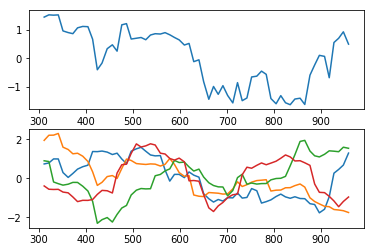

subject 26; gesture 1_1_1; avg 0.7286133670325007; sd 0.051572306122553015
subject 26; gesture 1_1_1; PoV: 0.8488813136670535


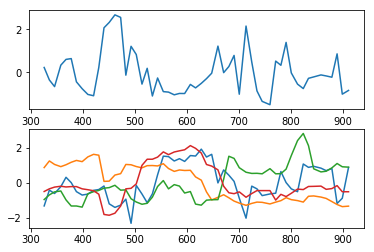

subject 26; gesture 3_1_2; avg 0.5969574759422613; sd 0.02986538801573511
subject 26; gesture 3_1_2; PoV: 0.8676323932740573


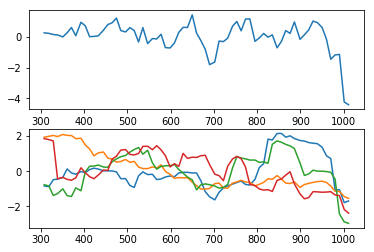

subject 26; gesture 2_1_1; avg 0.6893434033823973; sd 0.040145635272888607
subject 26; gesture 2_1_1; PoV: 0.856943671217035


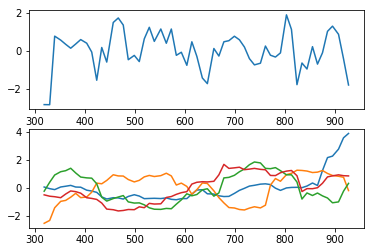

subject 26; gesture 1_0_1; avg 0.2014102896765076; sd 0.007961957052771964
subject 26; gesture 1_0_1; PoV: 0.8766358655036061


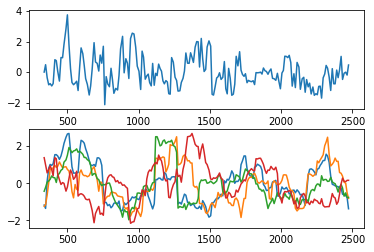

subject 26; gesture 3_1_1; avg 0.6700077102933653; sd 0.31253962912643696
subject 26; gesture 3_1_1; PoV: 0.6261644249702278


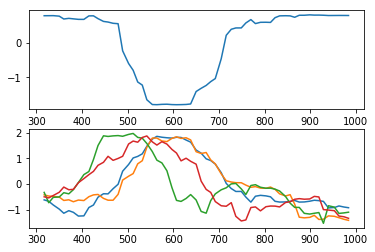

subject 26; gesture 1_0_2; avg 0.6056383006634398; sd 0.032114261342134985
subject 26; gesture 1_0_2; PoV: 0.8646952280463959


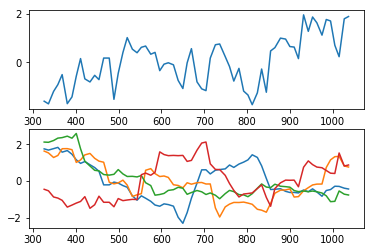

subject 26; gesture 4_0_2; avg 0.8038972831506217; sd 0.05072531755930266
subject 26; gesture 4_0_2; PoV: 0.8511928250646331


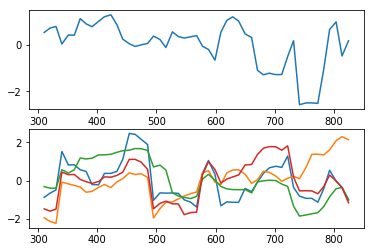

subject 32; gesture 3_0_1; avg 0.4582353622414886; sd 0.022111809367524885
subject 32; gesture 3_0_1; PoV: 0.8639060614407046


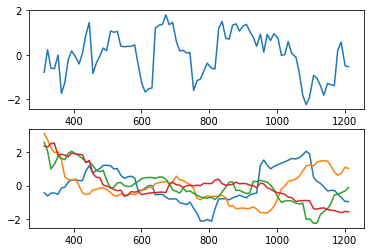

subject 32; gesture 4_1_1; avg 0.6339119461229451; sd 0.04355365649044822
subject 32; gesture 4_1_1; PoV: 0.8601008265494624


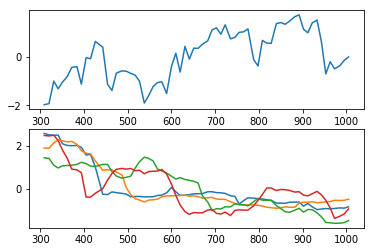

subject 32; gesture 2_0_1; avg 0.47897198365521476; sd 0.09950937998527512
subject 32; gesture 2_0_1; PoV: 0.7553506093931129


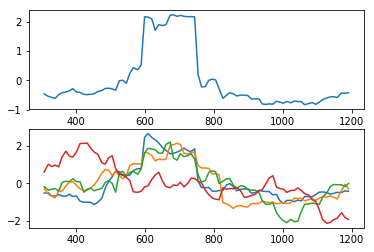

subject 32; gesture 4_1_2; avg 0.42664409719593116; sd 0.04497395948191823
subject 32; gesture 4_1_2; PoV: 0.8020788732454592


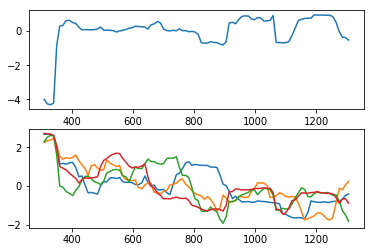

subject 32; gesture 2_0_2; avg 0.4717159412540053; sd 0.03421382252457978
subject 32; gesture 2_0_2; PoV: 0.8511571683601808


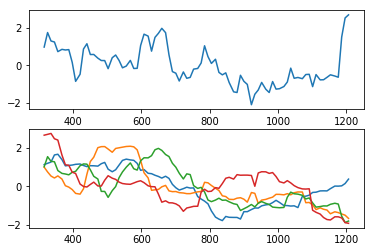

subject 32; gesture 1_1_2; avg 0.5145222309237873; sd 0.03036042303338799
subject 32; gesture 1_1_2; PoV: 0.8554311131860343


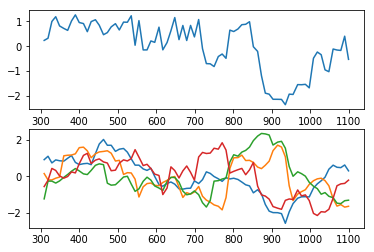

subject 32; gesture 2_1_2; avg 0.4863812719291622; sd 0.026527561322705374
subject 32; gesture 2_1_2; PoV: 0.8637247697384934


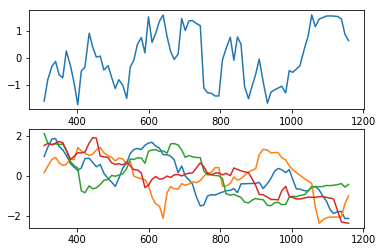

subject 32; gesture 4_0_1; avg 0.5234884684516808; sd 0.029086326041765958
subject 32; gesture 4_0_1; PoV: 0.8641283259206365


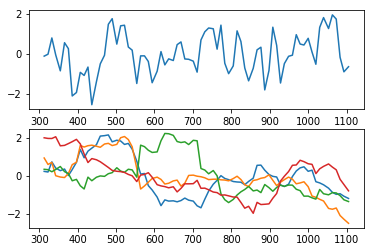

subject 32; gesture 3_0_2; avg 0.42403259093450135; sd 0.06360533279665549
subject 32; gesture 3_0_2; PoV: 0.7921511966401292


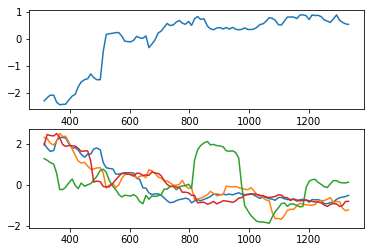

subject 32; gesture 1_1_1; avg 0.5996063759883242; sd 0.04644732159797171
subject 32; gesture 1_1_1; PoV: 0.8362011464290351


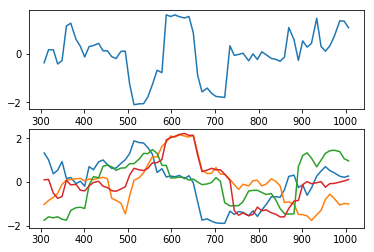

subject 32; gesture 3_1_2; avg 0.45820398757755604; sd 0.146429749301102
subject 32; gesture 3_1_2; PoV: 0.6833899036575636


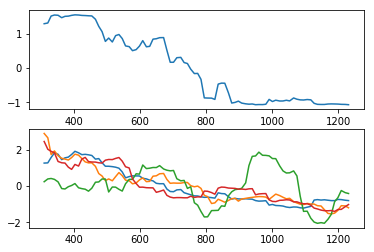

subject 32; gesture 2_1_1; avg 0.44953826742060005; sd 0.02464473141955311
subject 32; gesture 2_1_1; PoV: 0.8704492698957933


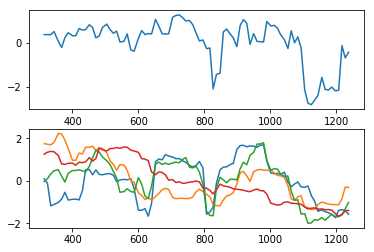

subject 32; gesture 1_0_1; avg 0.5809643153812538; sd 0.046096621765146624
subject 32; gesture 1_0_1; PoV: 0.8457392368258464


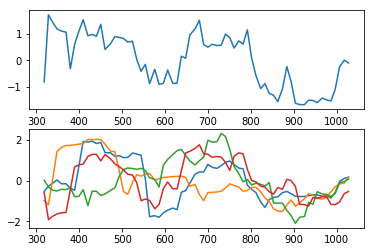

subject 32; gesture 3_1_1; avg 0.5346023546105056; sd 0.10355756544027667
subject 32; gesture 3_1_1; PoV: 0.7720981730553937


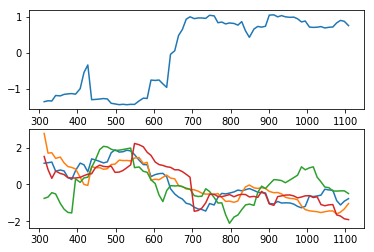

subject 32; gesture 1_0_2; avg 0.6935391821809535; sd 0.0395914748269407
subject 32; gesture 1_0_2; PoV: 0.8608418545170363


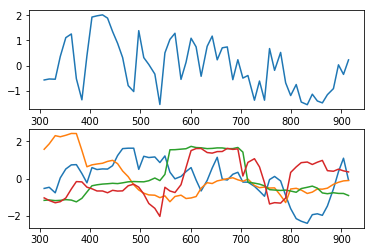

subject 32; gesture 4_0_2; avg 0.3398133214520123; sd 0.025025215844751925
subject 32; gesture 4_0_2; PoV: 0.8526480936356338


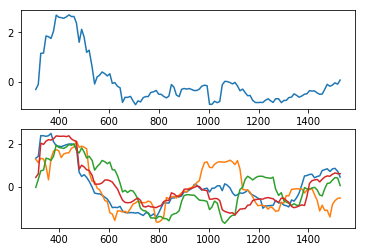

subject 04; gesture 3_0_1; avg 0.4827213859254594; sd 0.01942844023657851
subject 04; gesture 3_0_1; PoV: 0.8783464882367016


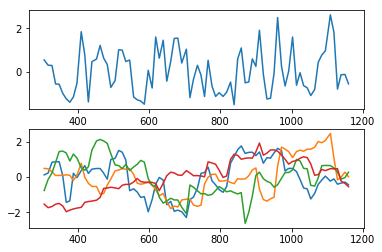

subject 04; gesture 4_1_1; avg 0.43411884467308104; sd 0.01896011130500895
subject 04; gesture 4_1_1; PoV: 0.8810557515005683


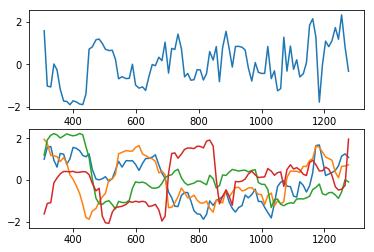

subject 04; gesture 2_0_1; avg 0.6364981449599486; sd 0.03649676184260391
subject 04; gesture 2_0_1; PoV: 0.8671428878671047


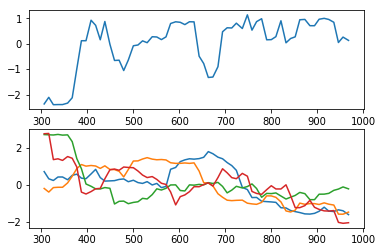

subject 04; gesture 4_1_2; avg 0.651500481781674; sd 0.03173275888658599
subject 04; gesture 4_1_2; PoV: 0.8805572654913347


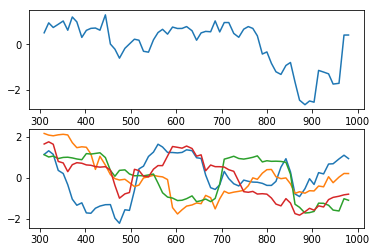

subject 04; gesture 2_0_2; avg 0.6508174491762903; sd 0.040034413861693256
subject 04; gesture 2_0_2; PoV: 0.8548969282637854


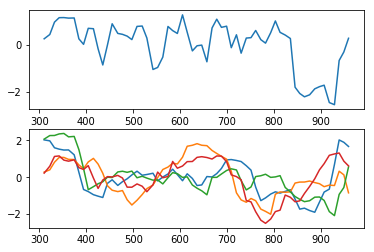

subject 04; gesture 1_1_2; avg 0.5722604079909239; sd 0.035292482443533654
subject 04; gesture 1_1_2; PoV: 0.8642480758756378


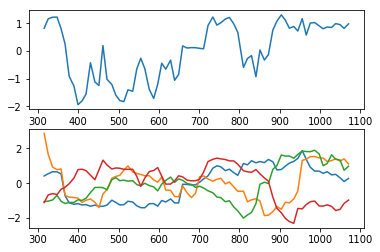

subject 04; gesture 2_1_2; avg 0.6032884977337392; sd 0.027657721127965634
subject 04; gesture 2_1_2; PoV: 0.8743628405638404


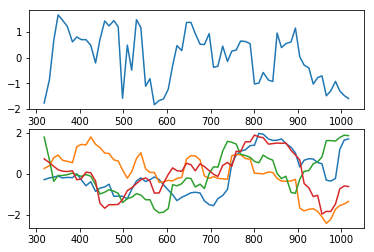

subject 04; gesture 4_0_1; avg 0.4988725042119045; sd 0.02475594793406208
subject 04; gesture 4_0_1; PoV: 0.8687673357245775


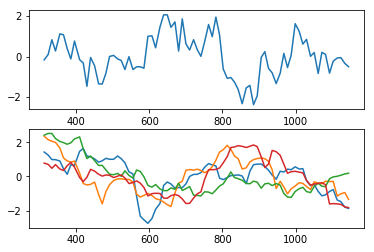

subject 04; gesture 3_0_2; avg 0.7697455084135117; sd 0.036861192013084104
subject 04; gesture 3_0_2; PoV: 0.8678798185847783


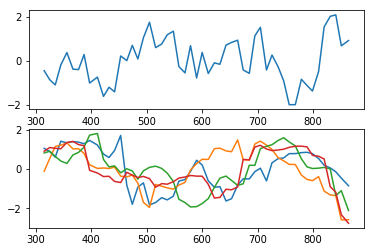

subject 04; gesture 1_1_1; avg 0.5850166578493108; sd 0.029206075679366283
subject 04; gesture 1_1_1; PoV: 0.8651893054000058


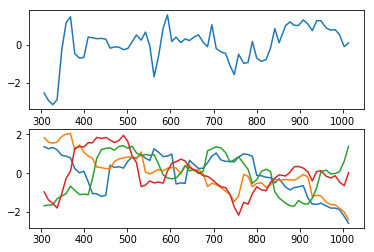

subject 04; gesture 3_1_2; avg 0.6553264649804762; sd 0.030002643534275775
subject 04; gesture 3_1_2; PoV: 0.8667149359488768


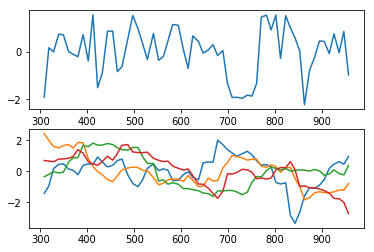

subject 04; gesture 2_1_1; avg 0.5897738855820778; sd 0.055498373574825385
subject 04; gesture 2_1_1; PoV: 0.8480036665703312


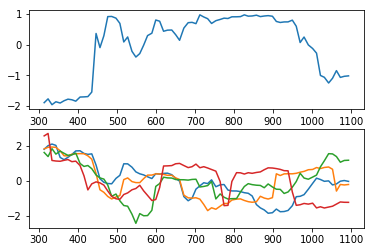

subject 04; gesture 1_0_1; avg 0.6862279879669831; sd 0.03305929889709181
subject 04; gesture 1_0_1; PoV: 0.8682868982837468


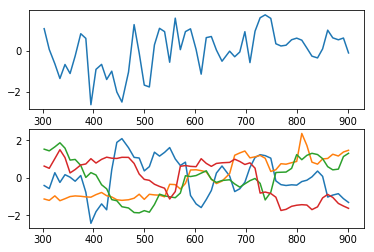

subject 04; gesture 3_1_1; avg 0.4661436591511734; sd 0.019779126936400628
subject 04; gesture 3_1_1; PoV: 0.8753830679581274


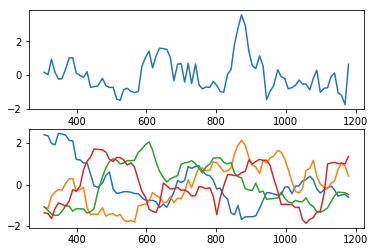

subject 04; gesture 1_0_2; avg 0.6398545921247416; sd 0.02960398538779837
subject 04; gesture 1_0_2; PoV: 0.8675547276011573


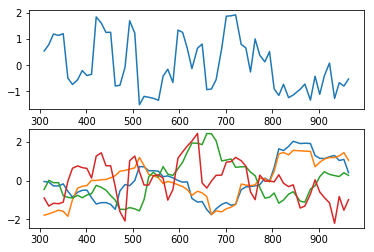

subject 04; gesture 4_0_2; avg 0.6708331870575424; sd 0.03379111590085783
subject 04; gesture 4_0_2; PoV: 0.8637363432930937


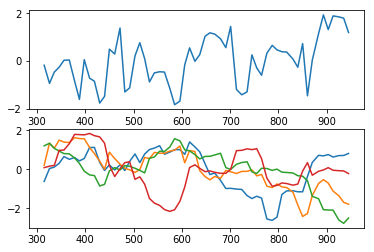

subject 08; gesture 3_0_1; avg 0.7545722104056001; sd 0.035620477150449414
subject 08; gesture 3_0_1; PoV: 0.8730628976160498


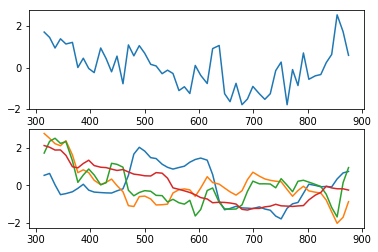

subject 08; gesture 4_1_1; avg 0.6455394474931246; sd 0.0615278704083606
subject 08; gesture 4_1_1; PoV: 0.8248258718605722


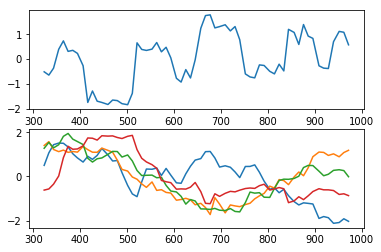

subject 08; gesture 2_0_1; avg 0.7079751113434127; sd 0.041470672608206055
subject 08; gesture 2_0_1; PoV: 0.8599414095194227


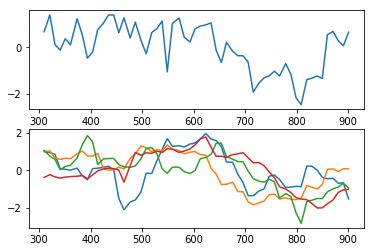

subject 08; gesture 4_1_2; avg 0.5992029371103906; sd 0.1079419143788445
subject 08; gesture 4_1_2; PoV: 0.783023181141459


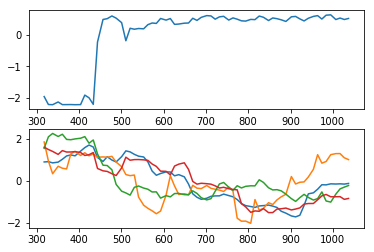

subject 08; gesture 2_0_2; avg 0.6703945169143052; sd 0.03209228492993616
subject 08; gesture 2_0_2; PoV: 0.866933017995285


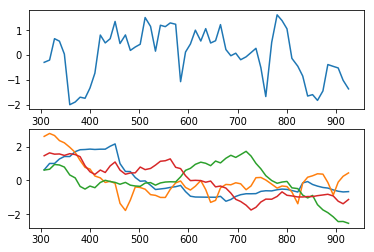

subject 08; gesture 1_1_2; avg 0.5437465423300961; sd 0.03238986415198928
subject 08; gesture 1_1_2; PoV: 0.8543527054165981


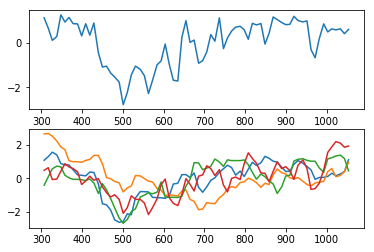

subject 08; gesture 2_1_2; avg 0.6151387537932809; sd 0.17059511572186195
subject 08; gesture 2_1_2; PoV: 0.7130904482294039


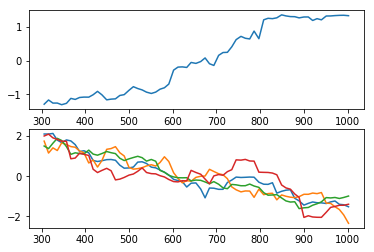

subject 08; gesture 4_0_1; avg 0.6821309666840674; sd 0.044469971107993105
subject 08; gesture 4_0_1; PoV: 0.8530384231163854


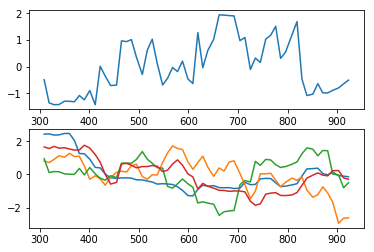

subject 08; gesture 3_0_2; avg 0.6737696349406038; sd 0.04747638380512538
subject 08; gesture 3_0_2; PoV: 0.8473211134823604


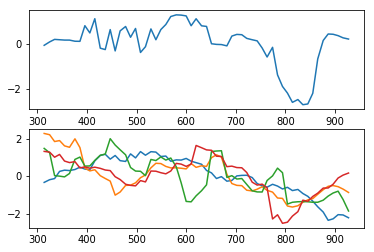

subject 08; gesture 1_1_1; avg 0.6534297590754541; sd 0.03653199156049338
subject 08; gesture 1_1_1; PoV: 0.8622231347065944


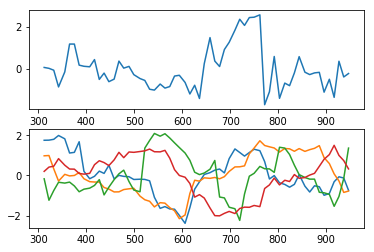

subject 08; gesture 3_1_2; avg 0.7040191603620138; sd 0.07056291022031762
subject 08; gesture 3_1_2; PoV: 0.822119743939304


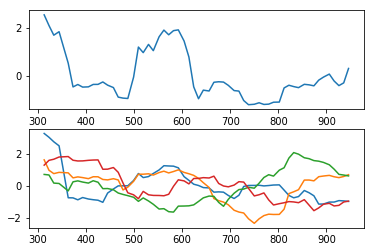

subject 08; gesture 2_1_1; avg 0.5174901312678436; sd 0.24188529401961412
subject 08; gesture 2_1_1; PoV: 0.6316468767330888


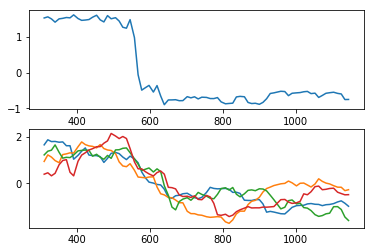

subject 08; gesture 1_0_1; avg 0.6086522638629236; sd 0.02407719153120185
subject 08; gesture 1_0_1; PoV: 0.8843222016937249


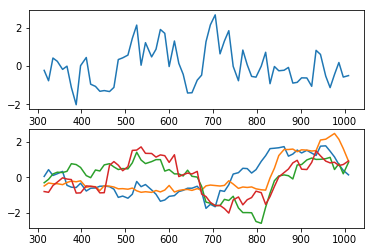

subject 08; gesture 3_1_1; avg 0.6622915706711969; sd 0.05489366721837198
subject 08; gesture 3_1_1; PoV: 0.8424060205813299


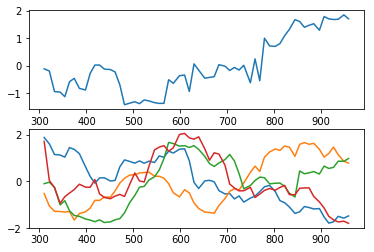

subject 08; gesture 1_0_2; avg 0.6517240937656197; sd 0.03302050643902729
subject 08; gesture 1_0_2; PoV: 0.8570187457396656


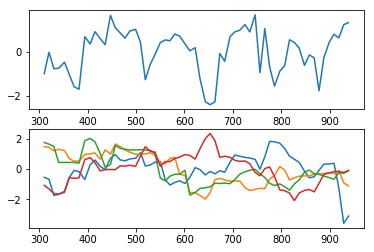

subject 08; gesture 4_0_2; avg 0.8349159897299393; sd 0.2517893015731222
subject 08; gesture 4_0_2; PoV: 0.7064635961221654


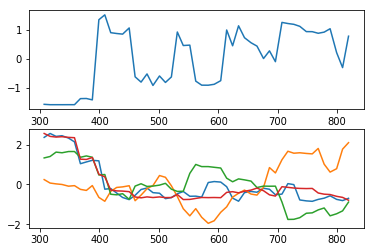

subject 27; gesture 3_0_1; avg 0.6662931404711759; sd 0.136862529610458
subject 27; gesture 3_0_1; PoV: 0.7650218113046583


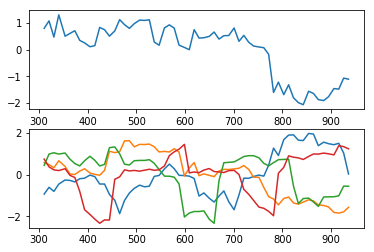

subject 27; gesture 4_1_1; avg 0.5431536716464613; sd 0.026617771195728106
subject 27; gesture 4_1_1; PoV: 0.874923037615586


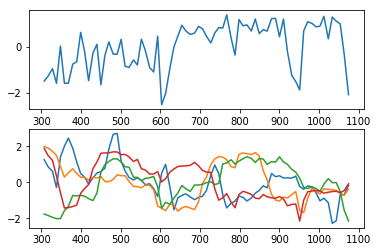

subject 27; gesture 2_0_1; avg 0.6264683354000472; sd 0.03910464187938614
subject 27; gesture 2_0_1; PoV: 0.8529401235895376


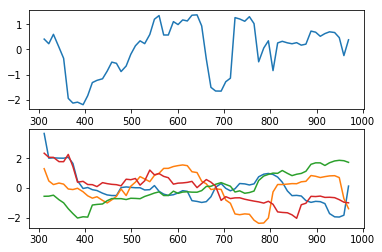

subject 27; gesture 4_1_2; avg 0.5682147570192662; sd 0.04977452506757551
subject 27; gesture 4_1_2; PoV: 0.8319874006498246


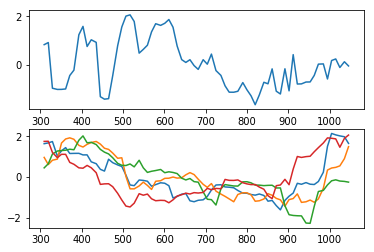

subject 27; gesture 2_0_2; avg 0.6358081424030078; sd 0.148788548872134
subject 27; gesture 2_0_2; PoV: 0.7608526639520593


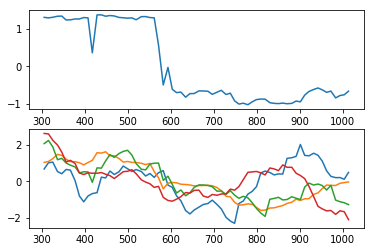

subject 27; gesture 1_1_2; avg 0.5942981430937297; sd 0.031476441467377464
subject 27; gesture 1_1_2; PoV: 0.8728058435728674


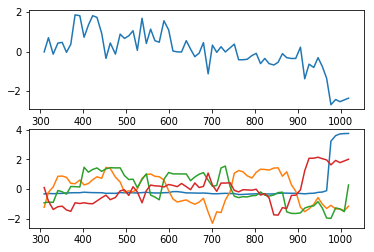

subject 27; gesture 2_1_2; avg 0.6282361181620657; sd 0.11280740178441062
subject 27; gesture 2_1_2; PoV: 0.7480603975499279


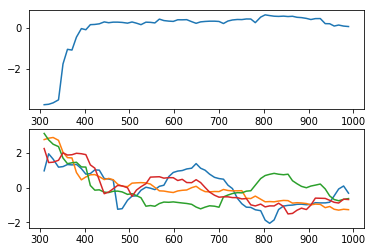

subject 27; gesture 4_0_1; avg 0.5267675686003591; sd 0.022992888900090103
subject 27; gesture 4_0_1; PoV: 0.8690678448172762


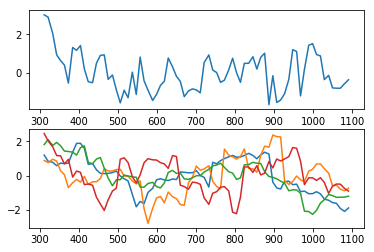

subject 27; gesture 3_0_2; avg 0.6159219272836215; sd 0.03027044051098229
subject 27; gesture 3_0_2; PoV: 0.8720469441101635


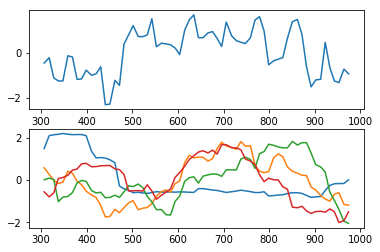

subject 27; gesture 1_1_1; avg 0.4219014750629239; sd 0.019922098488089558
subject 27; gesture 1_1_1; PoV: 0.8760178123320473


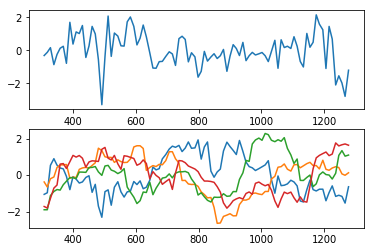

subject 27; gesture 3_1_2; avg 0.5878995095266907; sd 0.060826288037098296
subject 27; gesture 3_1_2; PoV: 0.8130956056513083


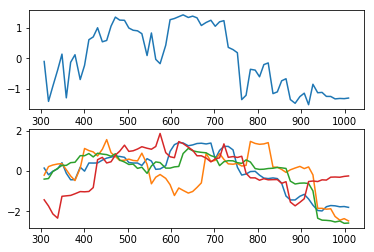

subject 27; gesture 2_1_1; avg 0.5521565245043655; sd 0.08947801257400975
subject 27; gesture 2_1_1; PoV: 0.7764411046304835


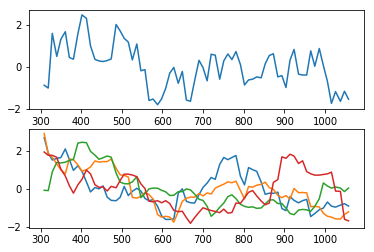

subject 27; gesture 1_0_1; avg 0.6435813498169523; sd 0.03713984947599639
subject 27; gesture 1_0_1; PoV: 0.8656725681130027


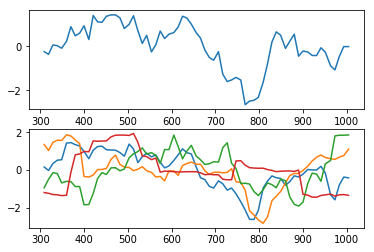

subject 27; gesture 3_1_1; avg 0.5415817088680837; sd 0.05798460484817709
subject 27; gesture 3_1_1; PoV: 0.81905743151717


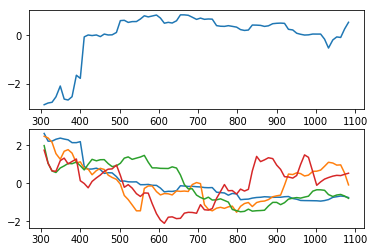

subject 27; gesture 1_0_2; avg 0.6225912046610037; sd 0.02699375732467717
subject 27; gesture 1_0_2; PoV: 0.8719154166357242


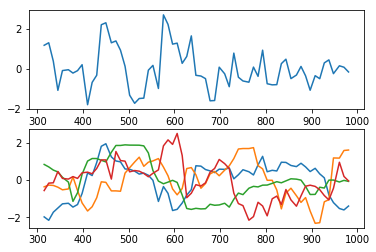

subject 27; gesture 4_0_2; avg 0.4928846230536302; sd 0.020000267932503313
subject 27; gesture 4_0_2; PoV: 0.8750632003740129


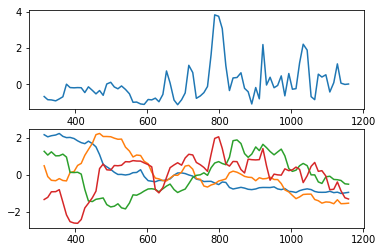

subject 14; gesture 3_0_1; avg 0.5394991001965503; sd 0.023869333850853686
subject 14; gesture 3_0_1; PoV: 0.8796302227724545


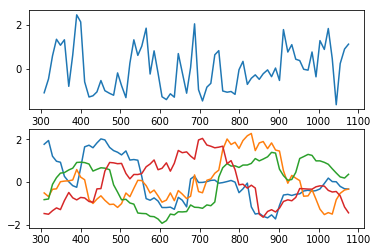

subject 14; gesture 4_1_1; avg 0.6071371180574348; sd 0.035881919869857976
subject 14; gesture 4_1_1; PoV: 0.8638637624285762


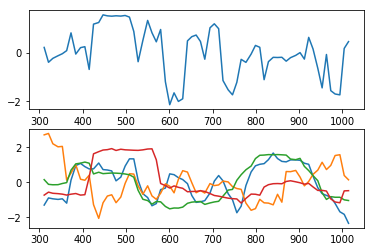

subject 14; gesture 2_0_1; avg 0.6474338835365299; sd 0.032400720557608634
subject 14; gesture 2_0_1; PoV: 0.8699929232352539


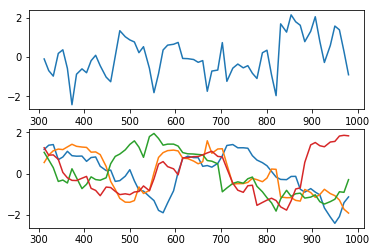

subject 14; gesture 4_1_2; avg 0.5714707469352248; sd 0.027241688884680437
subject 14; gesture 4_1_2; PoV: 0.8732955288623809


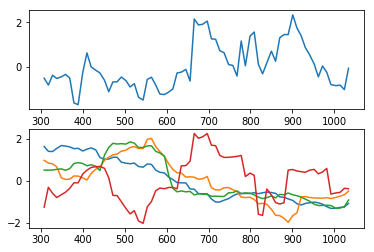

subject 14; gesture 2_0_2; avg 0.66461053532882; sd 0.04045203372401088
subject 14; gesture 2_0_2; PoV: 0.8569461755008825


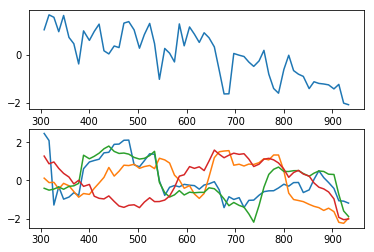

subject 14; gesture 1_1_2; avg 0.5347218840922706; sd 0.022410543078996537
subject 14; gesture 1_1_2; PoV: 0.8761399627510795


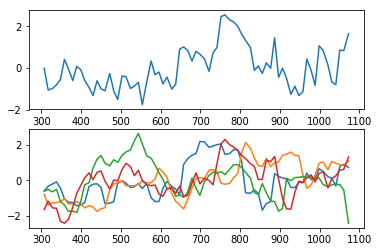

subject 14; gesture 2_1_2; avg 0.6997574397053358; sd 0.11197000905059089
subject 14; gesture 2_1_2; PoV: 0.79724022713343


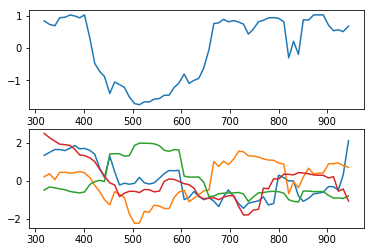

subject 14; gesture 4_0_1; avg 0.7244651780580741; sd 0.057532664273286835
subject 14; gesture 4_0_1; PoV: 0.8317324947449662


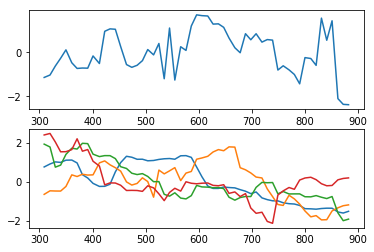

subject 14; gesture 3_0_2; avg 0.7507353012125778; sd 0.03247456183810145
subject 14; gesture 3_0_2; PoV: 0.8852676227695636


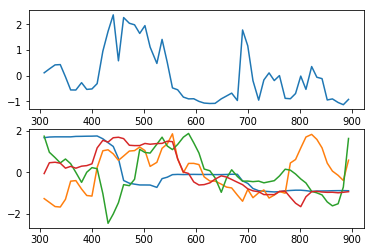

subject 14; gesture 1_1_1; avg 0.7876172681599141; sd 0.03898319842945612
subject 14; gesture 1_1_1; PoV: 0.8730519571844119


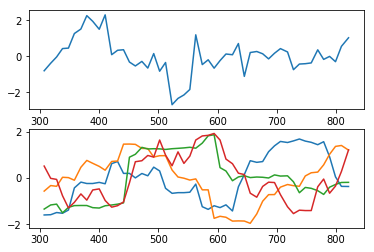

subject 14; gesture 3_1_2; avg 0.6252082313931829; sd 0.053856613346053725
subject 14; gesture 3_1_2; PoV: 0.8372588427786959


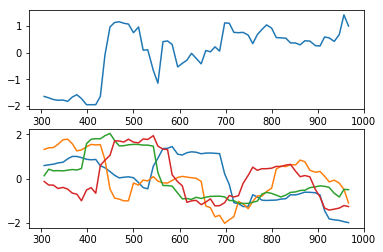

subject 14; gesture 2_1_1; avg 0.6555494485828762; sd 0.0361315703188924
subject 14; gesture 2_1_1; PoV: 0.8668245958667549


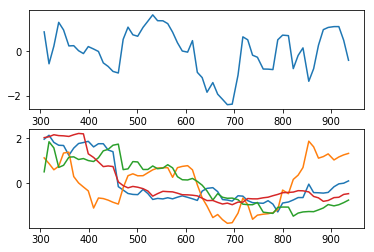

subject 14; gesture 1_0_1; avg 0.5113784061417328; sd 0.05419369100845455
subject 14; gesture 1_0_1; PoV: 0.8220210063661411


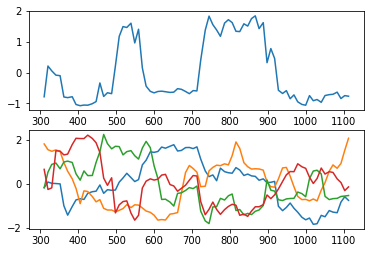

subject 14; gesture 3_1_1; avg 0.7784995345003366; sd 0.037858959304171894
subject 14; gesture 3_1_1; PoV: 0.863999074289838


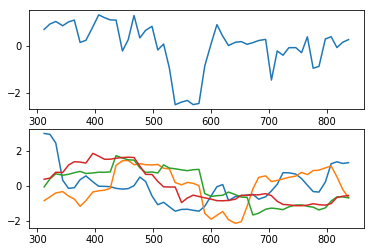

subject 14; gesture 1_0_2; avg 0.5980132933079353; sd 0.040937128192574376
subject 14; gesture 1_0_2; PoV: 0.8582553075732178


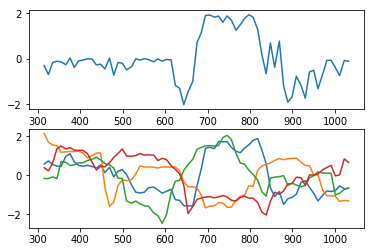

subject 14; gesture 4_0_2; avg 0.5602802280353201; sd 0.03967786474376231
subject 14; gesture 4_0_2; PoV: 0.8536110244185638


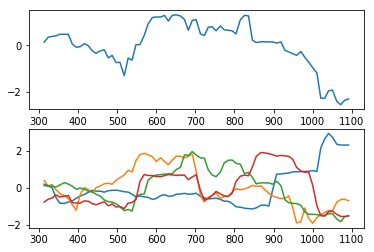

subject 23; gesture 3_0_1; avg 0.5739823533690063; sd 0.038109457847108036
subject 23; gesture 3_0_1; PoV: 0.8417567634442594


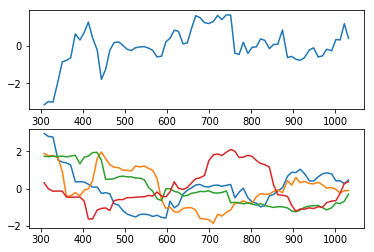

subject 23; gesture 4_1_1; avg 0.48269066611699896; sd 0.03645964635557184
subject 23; gesture 4_1_1; PoV: 0.8512712166621053


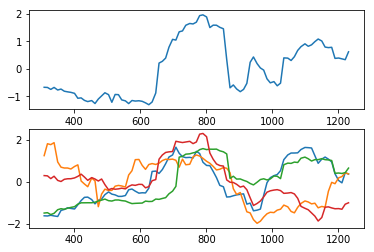

subject 23; gesture 2_0_1; avg 0.6312075679861692; sd 0.03470428620976091
subject 23; gesture 2_0_1; PoV: 0.866994066725886


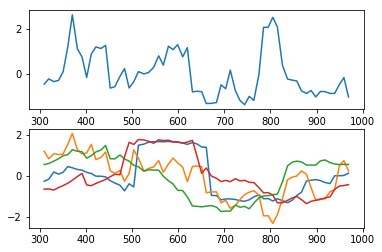

subject 23; gesture 4_1_2; avg 0.543629520960646; sd 0.02931963273687262
subject 23; gesture 4_1_2; PoV: 0.866767416928759


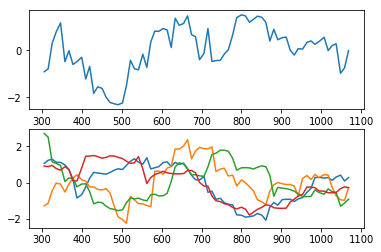

subject 23; gesture 2_0_2; avg 0.5760145881107684; sd 0.02653243674651571
subject 23; gesture 2_0_2; PoV: 0.8698780514721927


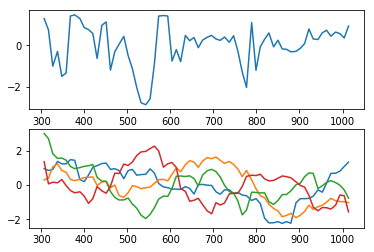

subject 23; gesture 1_1_2; avg 0.5216460800667272; sd 0.024491657865511485
subject 23; gesture 1_1_2; PoV: 0.8688766950655288


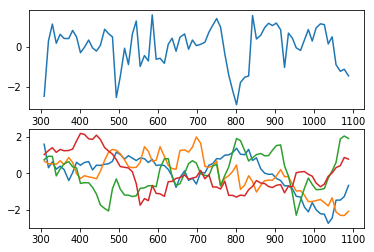

subject 23; gesture 2_1_2; avg 0.5461907513892547; sd 0.02782314716997055
subject 23; gesture 2_1_2; PoV: 0.8692864479182593


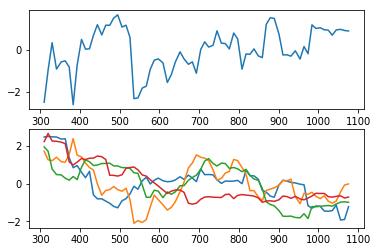

subject 23; gesture 4_0_1; avg 0.4407453981930382; sd 0.05108614541580876
subject 23; gesture 4_0_1; PoV: 0.8179248685837907


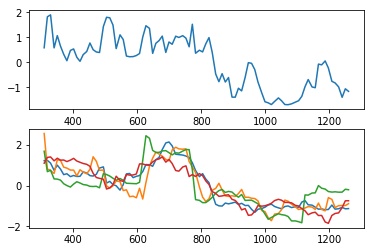

subject 23; gesture 3_0_2; avg 0.5658068859674625; sd 0.03939938098069127
subject 23; gesture 3_0_2; PoV: 0.8500842243738389


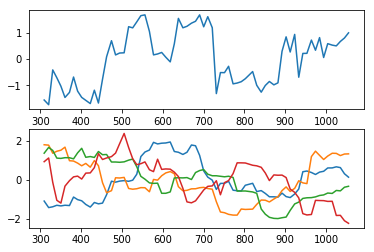

subject 23; gesture 1_1_1; avg 0.4786329085296555; sd 0.02746721452822996
subject 23; gesture 1_1_1; PoV: 0.8598412346855604


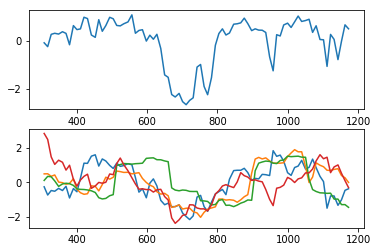

subject 23; gesture 3_1_2; avg 0.5564864562990662; sd 0.04966743024262428
subject 23; gesture 3_1_2; PoV: 0.8278070998098026


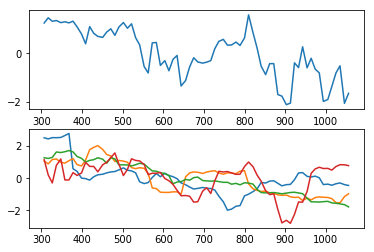

subject 23; gesture 2_1_1; avg 0.5239985418952623; sd 0.022986798324641337
subject 23; gesture 2_1_1; PoV: 0.8764179898279705


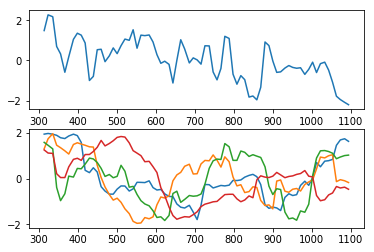

subject 23; gesture 1_0_1; avg 0.48175754532770537; sd 0.020820244428881172
subject 23; gesture 1_0_1; PoV: 0.8737907372639415


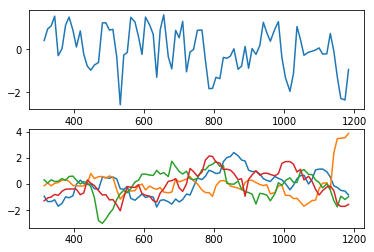

subject 23; gesture 3_1_1; avg 0.48071070375896485; sd 0.026715536229201985
subject 23; gesture 3_1_1; PoV: 0.8600473241556837


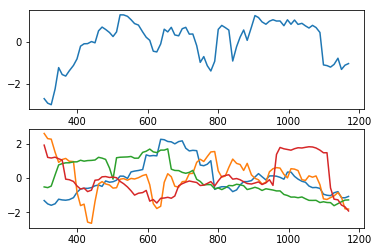

subject 23; gesture 1_0_2; avg 0.5789685457155228; sd 0.02800471359707998
subject 23; gesture 1_0_2; PoV: 0.8724904837311012


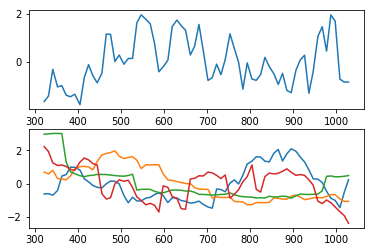

subject 23; gesture 4_0_2; avg 0.5275991577780484; sd 0.021493376684186556
subject 23; gesture 4_0_2; PoV: 0.8786316419600193


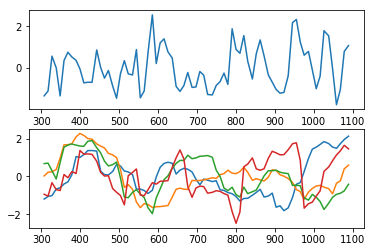

subject 25; gesture 3_0_1; avg 0.48736267400821537; sd 0.025305348670655075
subject 25; gesture 3_0_1; PoV: 0.8627785611777707


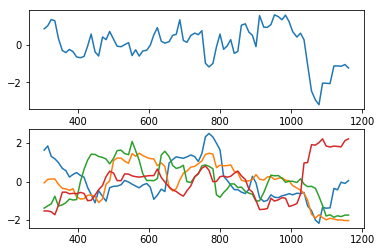

subject 25; gesture 4_1_1; avg 0.5179731987046062; sd 0.02374298995877754
subject 25; gesture 4_1_1; PoV: 0.8760680787741473


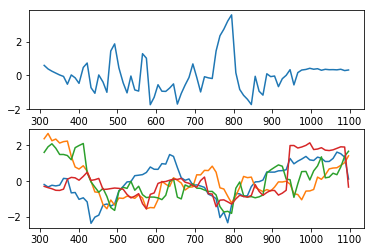

subject 25; gesture 2_0_1; avg 0.5095268500327086; sd 0.02464997184226373
subject 25; gesture 2_0_1; PoV: 0.8640153385631552


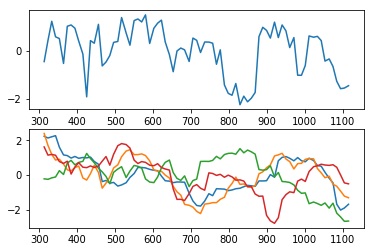

subject 25; gesture 4_1_2; avg 0.8121782316167927; sd 0.05864903064731587
subject 25; gesture 4_1_2; PoV: 0.8483838987064315


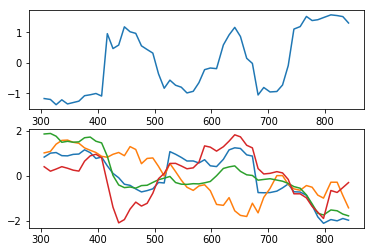

subject 25; gesture 2_0_2; avg 0.7073509425140015; sd 0.057207261255214796
subject 25; gesture 2_0_2; PoV: 0.8393336319048684


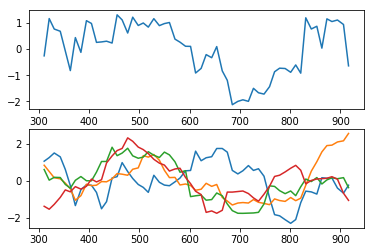

subject 25; gesture 1_1_2; avg 0.6478768782659139; sd 0.03014645099195365
subject 25; gesture 1_1_2; PoV: 0.8747967860023135


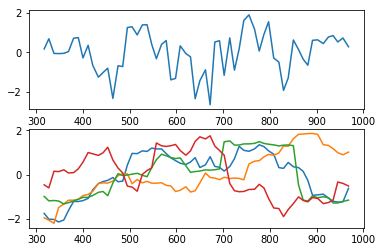

subject 25; gesture 2_1_2; avg 0.6439695468218698; sd 0.1340192541111589
subject 25; gesture 2_1_2; PoV: 0.7596135209937164


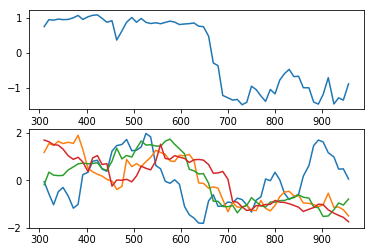

subject 25; gesture 4_0_1; avg 0.7003741850745853; sd 0.07673726655280923
subject 25; gesture 4_0_1; PoV: 0.8302569929813464


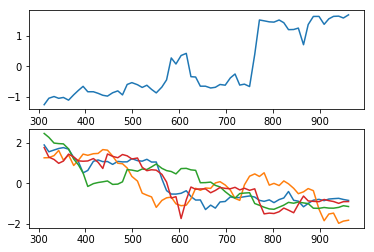

subject 25; gesture 3_0_2; avg 0.6518044841841389; sd 0.03499519996554787
subject 25; gesture 3_0_2; PoV: 0.8616123726382724


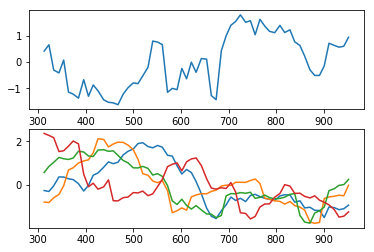

subject 25; gesture 1_1_1; avg 0.4908074129368294; sd 0.020406823938746904
subject 25; gesture 1_1_1; PoV: 0.8734422195902094


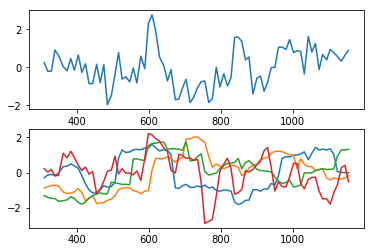

subject 25; gesture 3_1_2; avg 0.6797580386139953; sd 0.07037033219808471
subject 25; gesture 3_1_2; PoV: 0.8216091065561454


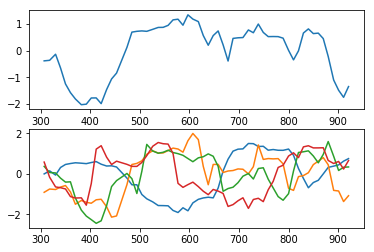

subject 25; gesture 2_1_1; avg 0.49289100594892055; sd 0.029062677971113175
subject 25; gesture 2_1_1; PoV: 0.8617701573353954


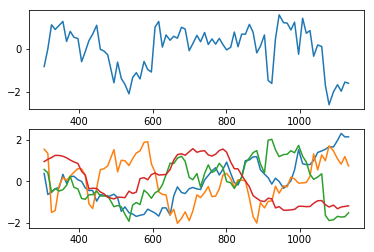

subject 25; gesture 1_0_1; avg 0.6057257993927884; sd 0.03207712244096921
subject 25; gesture 1_0_1; PoV: 0.8634177628239804


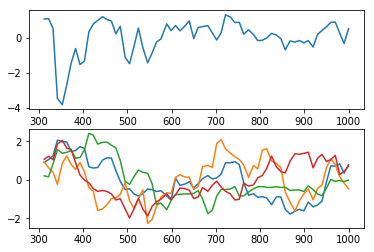

subject 25; gesture 3_1_1; avg 0.6283791750268328; sd 0.07731943802183959
subject 25; gesture 3_1_1; PoV: 0.8106044203782459


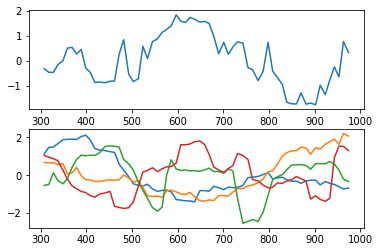

subject 25; gesture 1_0_2; avg 0.683644911927872; sd 0.049256036852492836
subject 25; gesture 1_0_2; PoV: 0.8534597564942449


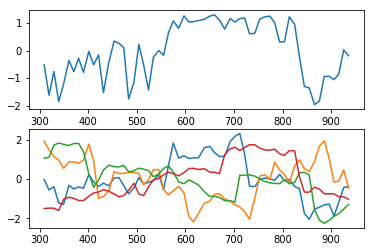

subject 25; gesture 4_0_2; avg 0.6425497411211819; sd 0.06299843351885336
subject 25; gesture 4_0_2; PoV: 0.8317929901057978


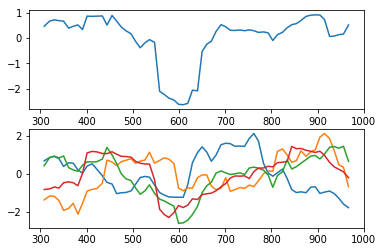

subject 18; gesture 3_0_1; avg 0.6183598525129103; sd 0.04015448685604226
subject 18; gesture 3_0_1; PoV: 0.8512967967893047


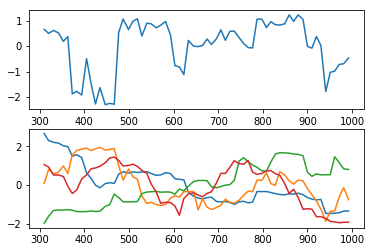

subject 18; gesture 4_1_1; avg 0.561427352023031; sd 0.02606923179309093
subject 18; gesture 4_1_1; PoV: 0.8759875910085925


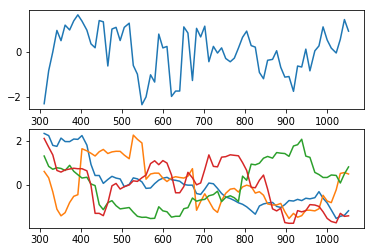

subject 18; gesture 2_0_1; avg 0.6636953741354081; sd 0.03571990376354942
subject 18; gesture 2_0_1; PoV: 0.8674533463904031


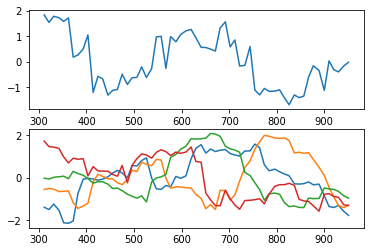

subject 18; gesture 4_1_2; avg 0.5477113798968808; sd 0.024410773149578516
subject 18; gesture 4_1_2; PoV: 0.8741129549775227


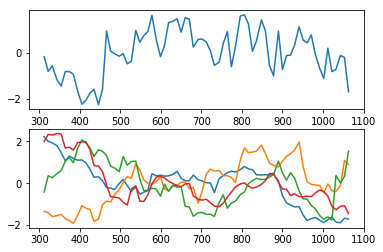

subject 18; gesture 2_0_2; avg 0.5835044816387774; sd 0.03547008745328589
subject 18; gesture 2_0_2; PoV: 0.8604229400120268


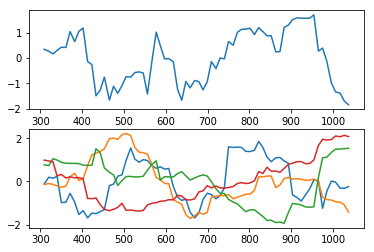

subject 18; gesture 1_1_2; avg 0.501763772117665; sd 0.02211690728372225
subject 18; gesture 1_1_2; PoV: 0.872499831274667


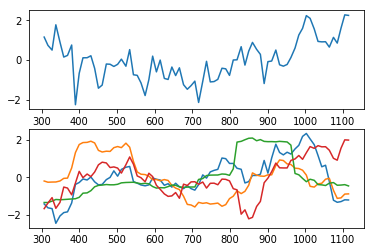

subject 18; gesture 2_1_2; avg 0.5810807131408318; sd 0.15806293698215568
subject 18; gesture 2_1_2; PoV: 0.727935178613439


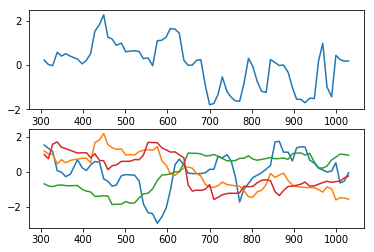

subject 18; gesture 4_0_1; avg 0.5372122033442952; sd 0.12140301993707557
subject 18; gesture 4_0_1; PoV: 0.7468250785797261


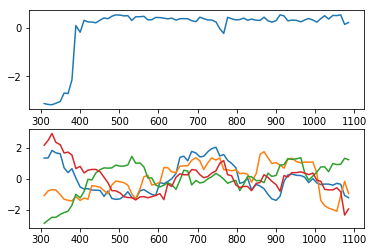

subject 18; gesture 3_0_2; avg 0.5672818739104504; sd 0.13207447181731397
subject 18; gesture 3_0_2; PoV: 0.7487781868398243


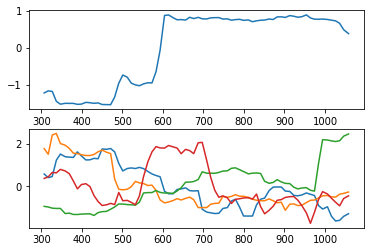

subject 18; gesture 1_1_1; avg 0.5244740317351916; sd 0.02928445403014774
subject 18; gesture 1_1_1; PoV: 0.8596126485766932


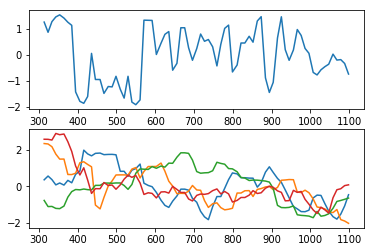

subject 18; gesture 3_1_2; avg 0.4670014806796902; sd 0.02898464461047628
subject 18; gesture 3_1_2; PoV: 0.8515055612416425


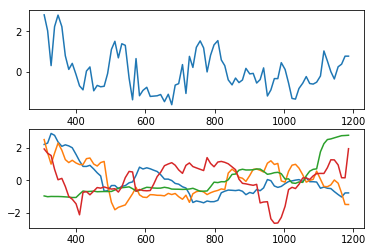

subject 18; gesture 2_1_1; avg 0.5832126878334737; sd 0.10359212430748765
subject 18; gesture 2_1_1; PoV: 0.7803004146795298


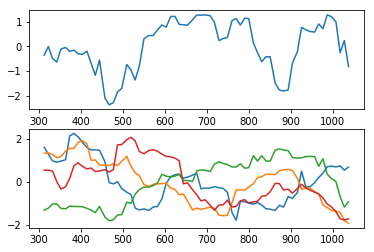

subject 18; gesture 1_0_1; avg 0.8070062196297111; sd 0.14885449971385217
subject 18; gesture 1_0_1; PoV: 0.7628123334592488


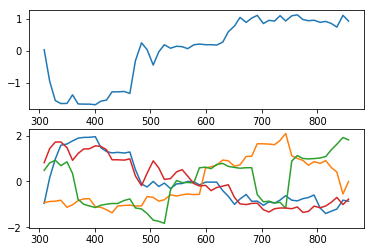

subject 18; gesture 3_1_1; avg 0.28036932345657584; sd 0.03429198429746646
subject 18; gesture 3_1_1; PoV: 0.8115941701454874


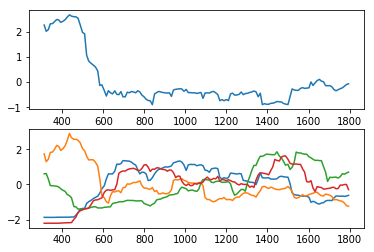

subject 18; gesture 1_0_2; avg 0.5001380698090906; sd 0.019974110571846275
subject 18; gesture 1_0_2; PoV: 0.8799082069864472


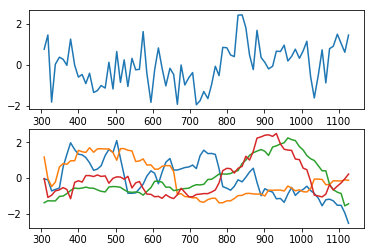

subject 18; gesture 4_0_2; avg 0.5753820632231417; sd 0.0303179016912923
subject 18; gesture 4_0_2; PoV: 0.8588911273854866


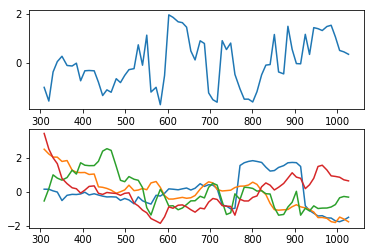

subject 29; gesture 3_0_1; avg 0.4575420116806328; sd 0.11186753793475641
subject 29; gesture 3_0_1; PoV: 0.7314939494766651


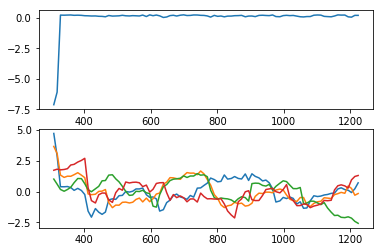

subject 29; gesture 4_1_1; avg 0.5235001057196067; sd 0.03090181195961814
subject 29; gesture 4_1_1; PoV: 0.8576819992228294


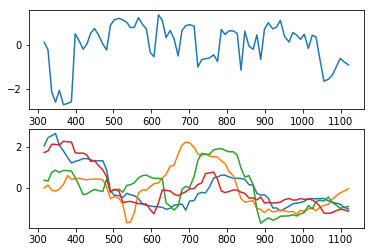

subject 29; gesture 2_0_1; avg 0.7187571216907989; sd 0.11403416604914593
subject 29; gesture 2_0_1; PoV: 0.784774638071761


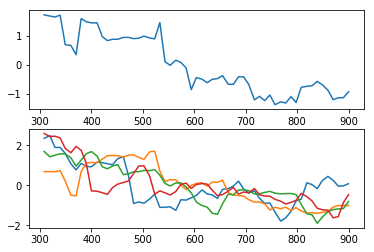

subject 29; gesture 4_1_2; avg 0.573288094860023; sd 0.03330729449565157
subject 29; gesture 4_1_2; PoV: 0.8620877785486286


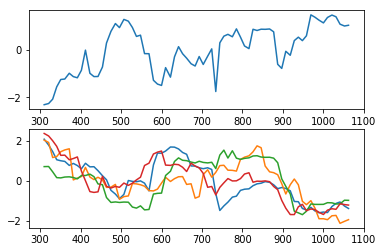

subject 29; gesture 2_0_2; avg 0.6086715893752968; sd 0.03246721310577386
subject 29; gesture 2_0_2; PoV: 0.8613408861306716


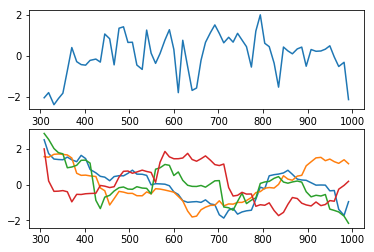

subject 29; gesture 1_1_2; avg 0.6274857245211274; sd 0.03287571843010887
subject 29; gesture 1_1_2; PoV: 0.8714393892749163


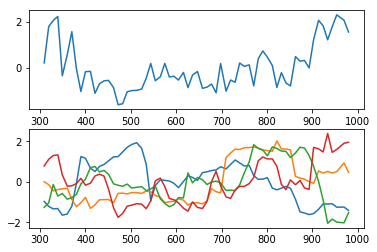

subject 29; gesture 2_1_2; avg 0.5975159860263481; sd 0.1311046553814519
subject 29; gesture 2_1_2; PoV: 0.7698534182389668


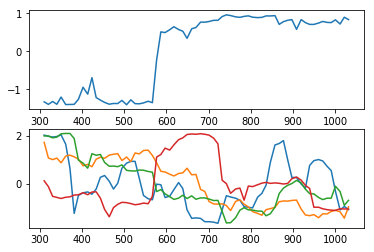

subject 29; gesture 4_0_1; avg 0.5989490345283321; sd 0.032049528231197714
subject 29; gesture 4_0_1; PoV: 0.8632432844742016


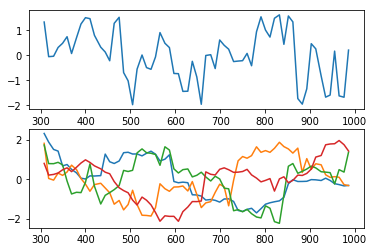

subject 29; gesture 3_0_2; avg 0.5815091919568218; sd 0.026509466439709996
subject 29; gesture 3_0_2; PoV: 0.8743688753493597


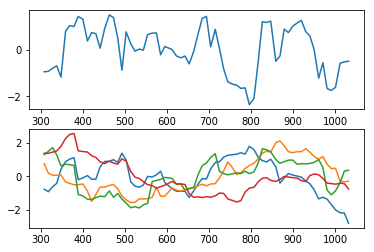

subject 29; gesture 1_1_1; avg 0.7183626246112891; sd 0.08559786695813196
subject 29; gesture 1_1_1; PoV: 0.8090865076761395


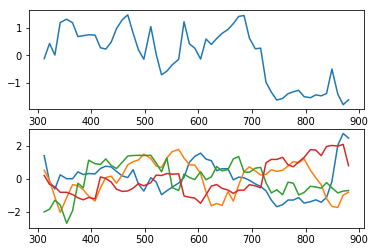

subject 29; gesture 3_1_2; avg 0.5499678246710961; sd 0.035372846163036015
subject 29; gesture 3_1_2; PoV: 0.8578459348665297


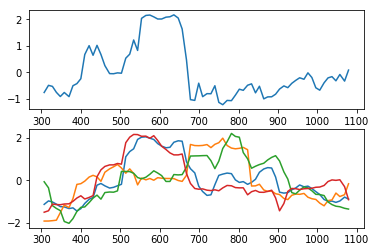

subject 29; gesture 2_1_1; avg 0.6112840610234895; sd 0.03914234805217258
subject 29; gesture 2_1_1; PoV: 0.8503099681768972


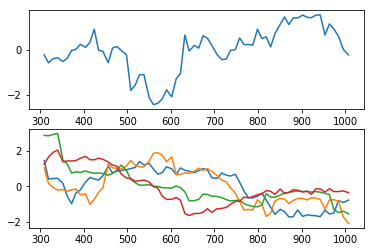

subject 29; gesture 1_0_1; avg 0.6037153060595715; sd 0.027625960117707102
subject 29; gesture 1_0_1; PoV: 0.8702094086445746


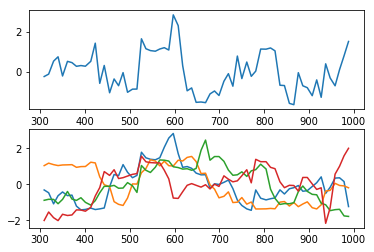

subject 29; gesture 3_1_1; avg 0.5121860274923243; sd 0.022415729587529812
subject 29; gesture 3_1_1; PoV: 0.8832708894339216


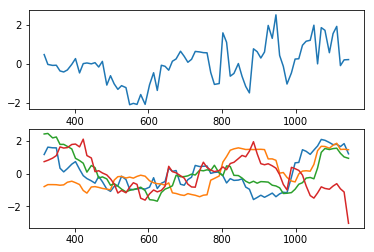

subject 29; gesture 1_0_2; avg 0.588555929659611; sd 0.03109717556550828
subject 29; gesture 1_0_2; PoV: 0.8578841935637647


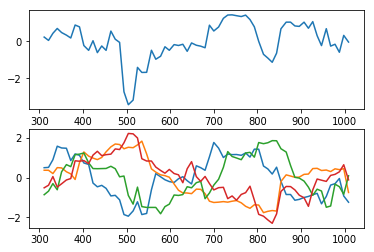

subject 29; gesture 4_0_2; avg 0.5374605263025805; sd 0.056443813102656566
subject 29; gesture 4_0_2; PoV: 0.8263091532787272


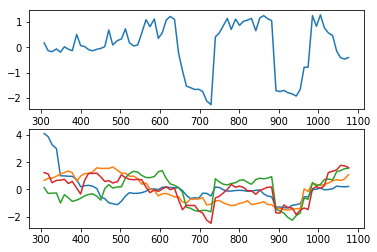

subject 15; gesture 3_0_1; avg 0.6607200928996617; sd 0.038791383894874326
subject 15; gesture 3_0_1; PoV: 0.862587305100771


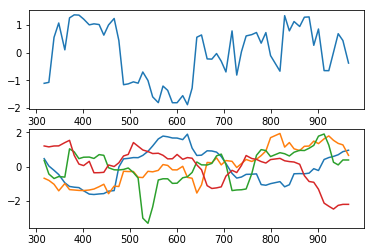

subject 15; gesture 4_1_1; avg 0.6498640288346325; sd 0.07037663033208359
subject 15; gesture 4_1_1; PoV: 0.8200392590912494


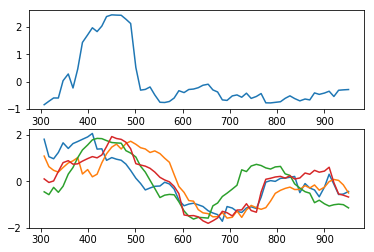

subject 15; gesture 2_0_1; avg 0.7085756461356001; sd 0.080365014468306
subject 15; gesture 2_0_1; PoV: 0.8212100267476946


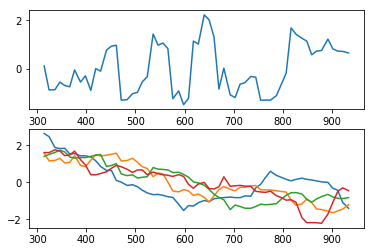

subject 15; gesture 4_1_2; avg 0.5148311096855166; sd 0.03071605641331182
subject 15; gesture 4_1_2; PoV: 0.860848558591854


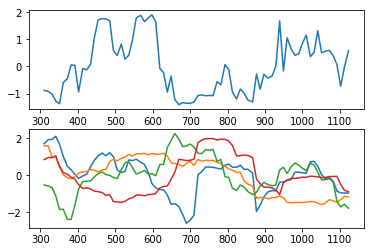

subject 15; gesture 2_0_2; avg 0.6540524089443596; sd 0.03588302774130811
subject 15; gesture 2_0_2; PoV: 0.8642324273984738


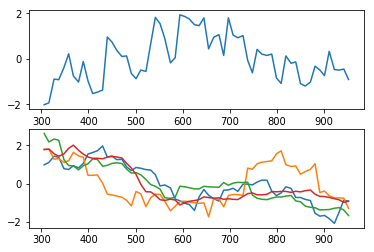

subject 15; gesture 1_1_2; avg 0.4969508926151522; sd 0.021744264703440923
subject 15; gesture 1_1_2; PoV: 0.8750725865746609


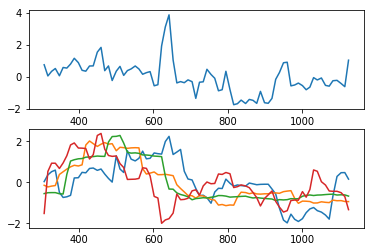

subject 15; gesture 2_1_2; avg 0.6119844441558328; sd 0.06600538316121105
subject 15; gesture 2_1_2; PoV: 0.8090837909653641


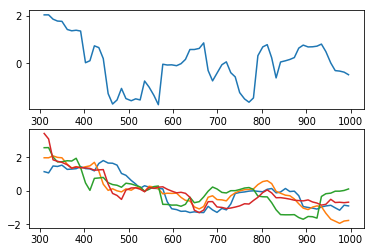

subject 15; gesture 4_0_1; avg 0.620014750080802; sd 0.051958903392124674
subject 15; gesture 4_0_1; PoV: 0.8329030844073907


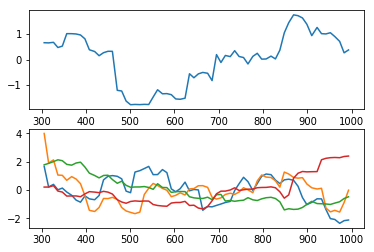

subject 15; gesture 3_0_2; avg 0.5393697249293814; sd 0.033852397234259
subject 15; gesture 3_0_2; PoV: 0.8512662483197052


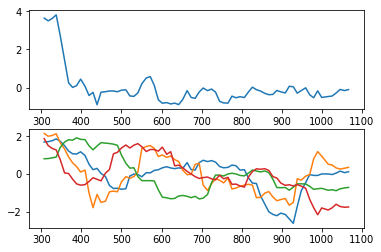

subject 15; gesture 1_1_1; avg 0.6453993562836496; sd 0.028459605151985343
subject 15; gesture 1_1_1; PoV: 0.8742629463777782


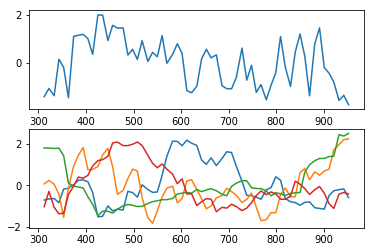

subject 15; gesture 3_1_2; avg 0.571265737753517; sd 0.02761116436037358
subject 15; gesture 3_1_2; PoV: 0.8644111239455357


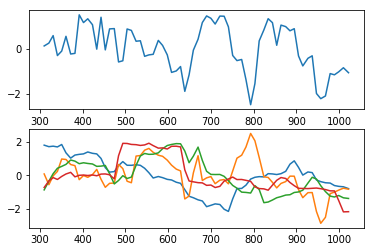

subject 15; gesture 2_1_1; avg 0.5733027289715883; sd 0.03724384269671749
subject 15; gesture 2_1_1; PoV: 0.8548965130942237


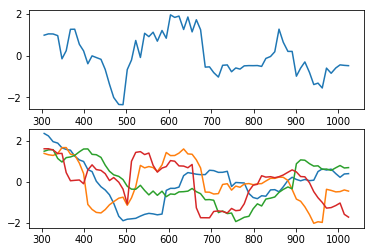

subject 15; gesture 1_0_1; avg 0.7038942115254518; sd 0.04493658469164514
subject 15; gesture 1_0_1; PoV: 0.8616024488043779


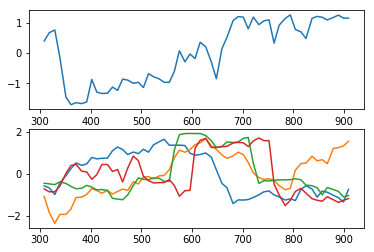

subject 15; gesture 3_1_1; avg 0.6440590888791878; sd 0.03236139899589895
subject 15; gesture 3_1_1; PoV: 0.8589491995124965


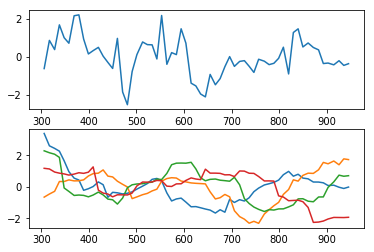

subject 15; gesture 1_0_2; avg 0.6316845403693222; sd 0.03498283031224297
subject 15; gesture 1_0_2; PoV: 0.8627780079644561


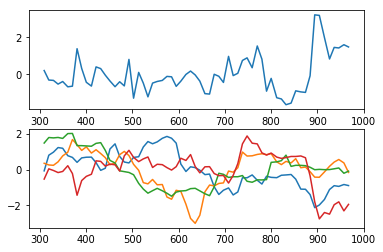

subject 15; gesture 4_0_2; avg 0.63320267290245; sd 0.04356240159306673
subject 15; gesture 4_0_2; PoV: 0.8523669759855849


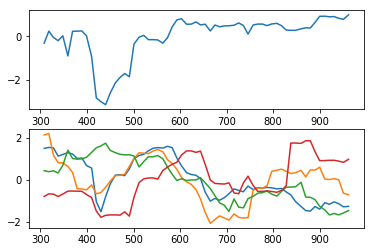

subject 28; gesture 3_0_1; avg 0.9714873109129133; sd 0.18256780394176414
subject 28; gesture 3_0_1; PoV: 0.7710245066701868


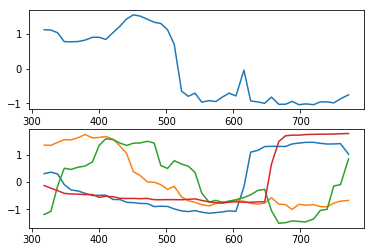

subject 28; gesture 4_1_1; avg 0.6648962301706495; sd 0.03666763408438115
subject 28; gesture 4_1_1; PoV: 0.8657438365621972


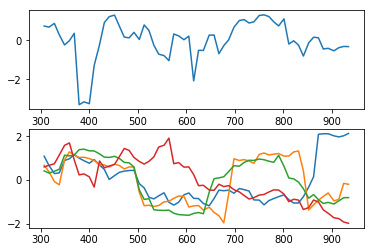

subject 28; gesture 2_0_1; avg 0.8878299389577289; sd 0.17536662153876023
subject 28; gesture 2_0_1; PoV: 0.7808483474319637


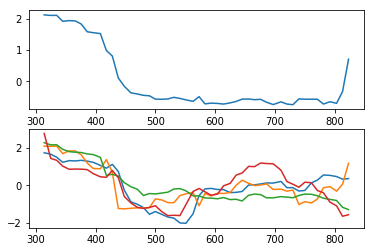

subject 28; gesture 4_1_2; avg 0.7275977672419263; sd 0.053568300006315815
subject 28; gesture 4_1_2; PoV: 0.8462351987295639


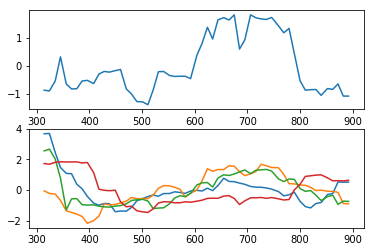

subject 28; gesture 2_0_2; avg 0.6656931150065516; sd 0.027566060226830436
subject 28; gesture 2_0_2; PoV: 0.8779886089730865


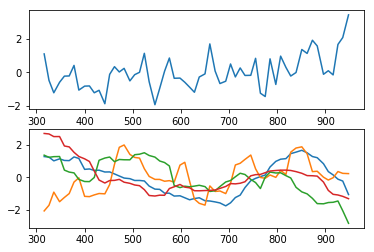

subject 28; gesture 1_1_2; avg 0.8412708655801502; sd 0.04509536968700934
subject 28; gesture 1_1_2; PoV: 0.8536081514868017


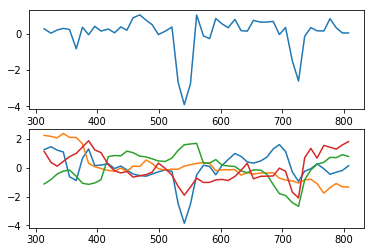

subject 28; gesture 2_1_2; avg 0.5656428843375287; sd 0.034480555471327994
subject 28; gesture 2_1_2; PoV: 0.8534404808800401


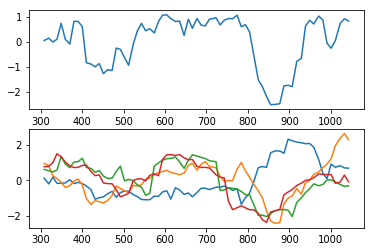

subject 28; gesture 4_0_1; avg 0.7857377945511735; sd 0.04533456996038437
subject 28; gesture 4_0_1; PoV: 0.8525248101122916


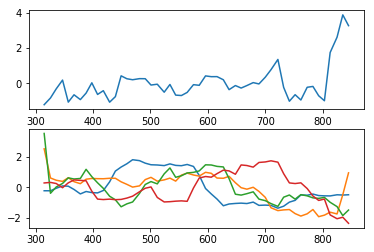

subject 28; gesture 3_0_2; avg 0.6404702766181447; sd 0.029190688246737186
subject 28; gesture 3_0_2; PoV: 0.8669286811756152


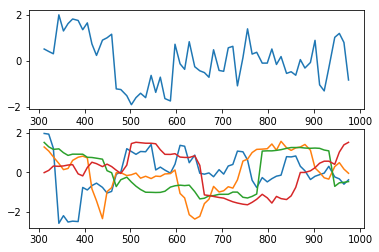

subject 28; gesture 1_1_1; avg 1.0311793955417632; sd 0.06172901429410015
subject 28; gesture 1_1_1; PoV: 0.8611073017464465


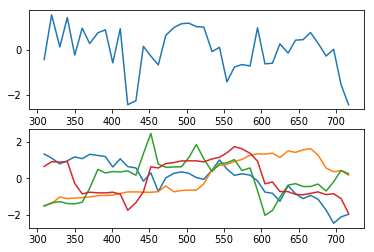

subject 28; gesture 3_1_2; avg 0.7857597392219947; sd 0.05850940872068791
subject 28; gesture 3_1_2; PoV: 0.8445418184501374


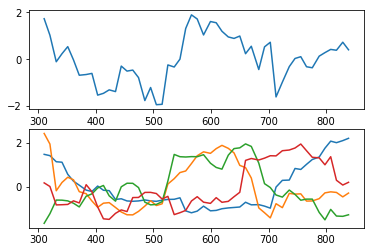

subject 28; gesture 2_1_1; avg 1.1438028635461892; sd 0.1305306382794955
subject 28; gesture 2_1_1; PoV: 0.8344285794252678


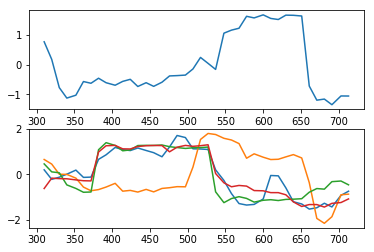

subject 28; gesture 1_0_1; avg 0.7652539743843794; sd 0.03412179696882547
subject 28; gesture 1_0_1; PoV: 0.8745178587152409


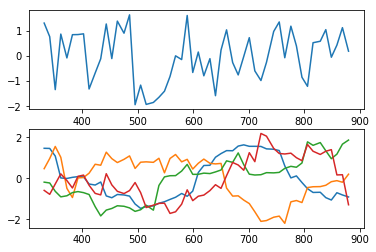

subject 28; gesture 3_1_1; avg 0.7670350105795808; sd 0.21998231406115548
subject 28; gesture 3_1_1; PoV: 0.7104247209753346


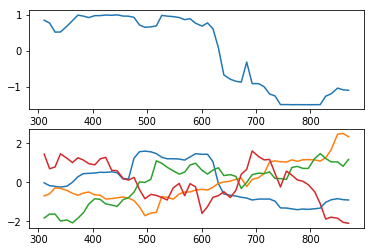

subject 28; gesture 1_0_2; avg 0.676539150193902; sd 0.046431540043696554
subject 28; gesture 1_0_2; PoV: 0.8498750507050117


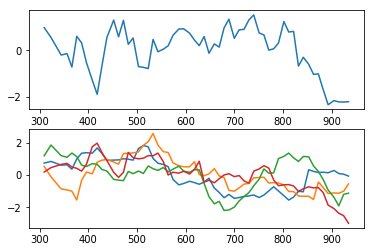

subject 28; gesture 4_0_2; avg 0.7438362792374893; sd 0.06732031874619218
subject 28; gesture 4_0_2; PoV: 0.8324075284939382


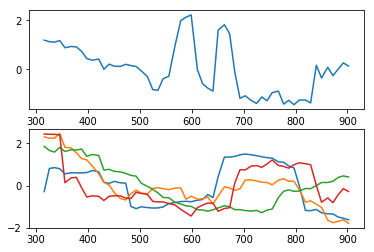

subject 12; gesture 3_0_1; avg 0.5607346182707132; sd 0.036985008177940794
subject 12; gesture 3_0_1; PoV: 0.8542199222521311


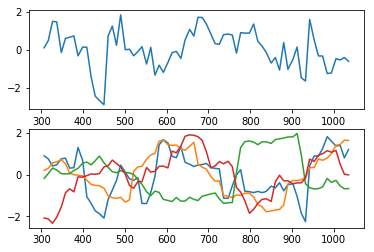

subject 12; gesture 4_1_1; avg 0.530865747637083; sd 0.04603467498657091
subject 12; gesture 4_1_1; PoV: 0.8286934117410292


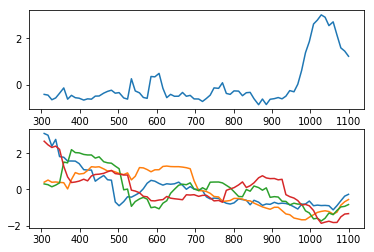

subject 12; gesture 2_0_1; avg 0.5740181869422207; sd 0.06217971648590459
subject 12; gesture 2_0_1; PoV: 0.8290123065832489


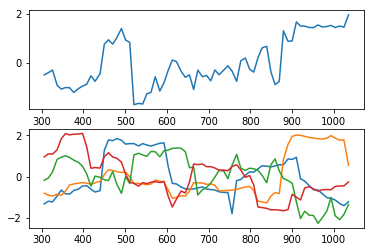

subject 12; gesture 4_1_2; avg 0.5312642972569551; sd 0.03559897569376824
subject 12; gesture 4_1_2; PoV: 0.8456028075303974


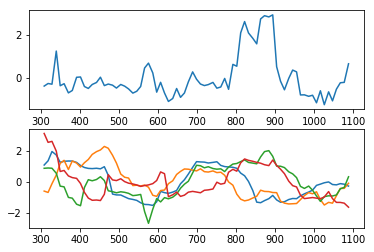

subject 12; gesture 2_0_2; avg 0.5965263208216622; sd 0.03376775744704642
subject 12; gesture 2_0_2; PoV: 0.8633274263823097


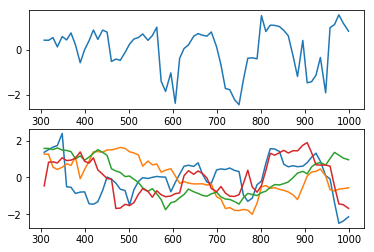

subject 12; gesture 1_1_2; avg 0.53940198755874; sd 0.026334259726717164
subject 12; gesture 1_1_2; PoV: 0.8661437715898663


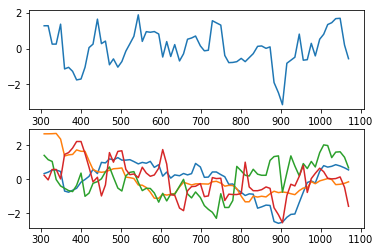

subject 12; gesture 2_1_2; avg 0.5590606794902999; sd 0.03511122214766256
subject 12; gesture 2_1_2; PoV: 0.8525680497646382


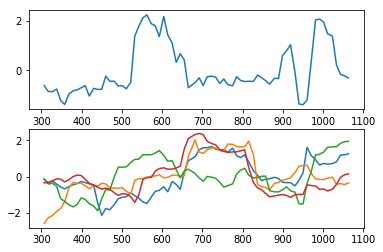

subject 12; gesture 4_0_1; avg 0.5498937040145596; sd 0.02943104910256996
subject 12; gesture 4_0_1; PoV: 0.8717551882176275


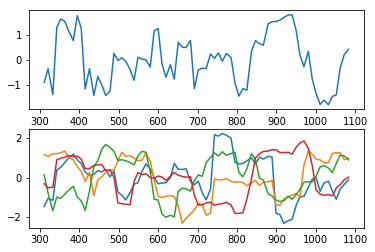

subject 12; gesture 3_0_2; avg 0.49168607884983884; sd 0.025040038637022338
subject 12; gesture 3_0_2; PoV: 0.8688059090643229


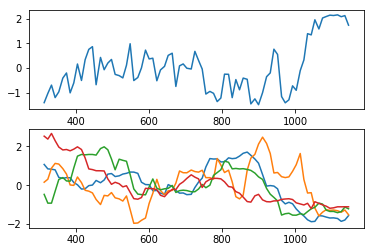

subject 12; gesture 1_1_1; avg 0.5585570962160247; sd 0.02562647209290221
subject 12; gesture 1_1_1; PoV: 0.8719974162396636


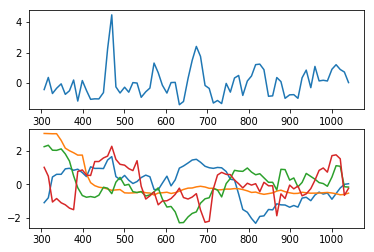

subject 12; gesture 3_1_2; avg 0.5142143424197246; sd 0.02570420511322764
subject 12; gesture 3_1_2; PoV: 0.8647103917112038


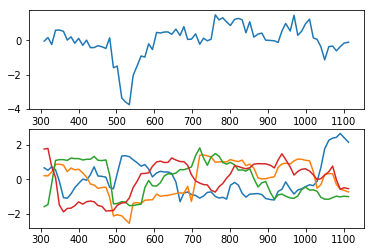

subject 12; gesture 2_1_1; avg 0.550935682857029; sd 0.044084105703573545
subject 12; gesture 2_1_1; PoV: 0.8365832967324183


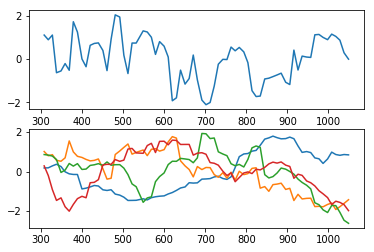

subject 12; gesture 1_0_1; avg 0.5425085637733461; sd 0.02338565982641192
subject 12; gesture 1_0_1; PoV: 0.8708847604718765


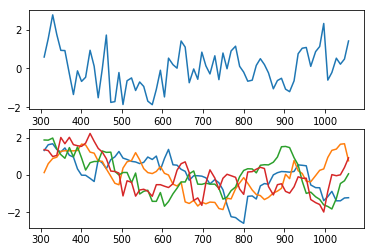

subject 12; gesture 3_1_1; avg 0.5335081815020437; sd 0.02079924988589247
subject 12; gesture 3_1_1; PoV: 0.886775749273817


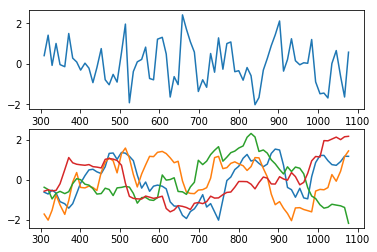

subject 12; gesture 1_0_2; avg 0.6378016881947097; sd 0.11024957425237238
subject 12; gesture 1_0_2; PoV: 0.7697764090834462


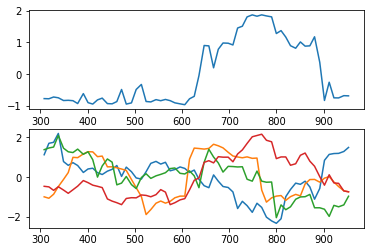

subject 12; gesture 4_0_2; avg 0.5786807976476573; sd 0.03392526279450129
subject 12; gesture 4_0_2; PoV: 0.8589988122588395


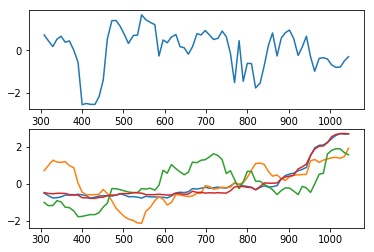

subject 19; gesture 3_0_1; avg 0.5874599186951805; sd 0.026620648745905515
subject 19; gesture 3_0_1; PoV: 0.8688390329739657


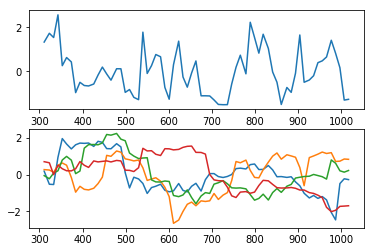

subject 19; gesture 4_1_1; avg 0.527415153603784; sd 0.04864066736689252
subject 19; gesture 4_1_1; PoV: 0.8332462804759468


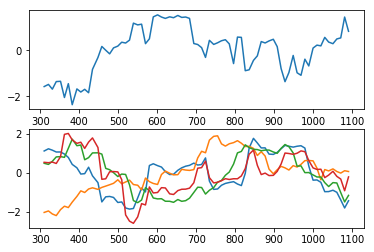

subject 19; gesture 2_0_1; avg 0.533538871289854; sd 0.024018744339468056
subject 19; gesture 2_0_1; PoV: 0.8695622524990497


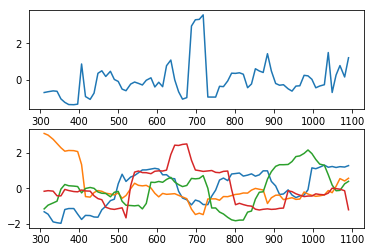

subject 19; gesture 4_1_2; avg 0.4772594000070636; sd 0.02497855816242842
subject 19; gesture 4_1_2; PoV: 0.8614290169597307


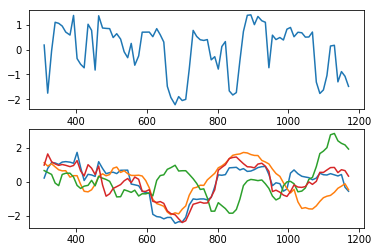

subject 19; gesture 2_0_2; avg 0.5814408550844926; sd 0.025871646419245723
subject 19; gesture 2_0_2; PoV: 0.8766795798387208


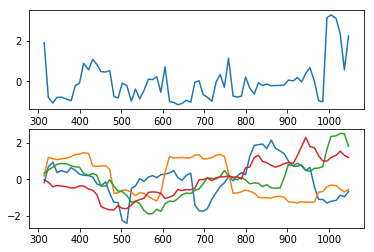

subject 19; gesture 1_1_2; avg 0.5235825579222833; sd 0.026640480717702242
subject 19; gesture 1_1_2; PoV: 0.8659517298031736


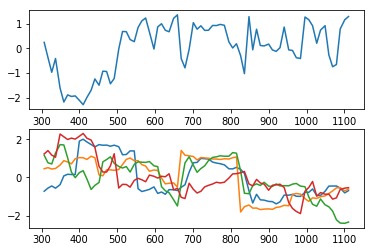

subject 19; gesture 2_1_2; avg 0.5603871401011133; sd 0.027520962077414095
subject 19; gesture 2_1_2; PoV: 0.8707002635999095


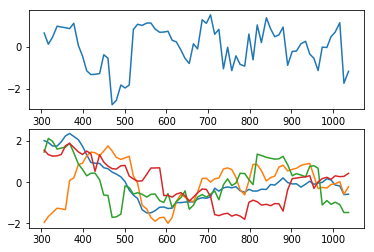

subject 19; gesture 4_0_1; avg 0.5093930496860548; sd 0.331991780218137
subject 19; gesture 4_0_1; PoV: 0.5753203098822488


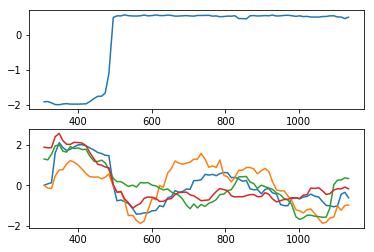

subject 19; gesture 3_0_2; avg 0.6571795520404835; sd 0.07820150378779608
subject 19; gesture 3_0_2; PoV: 0.8066105985482089


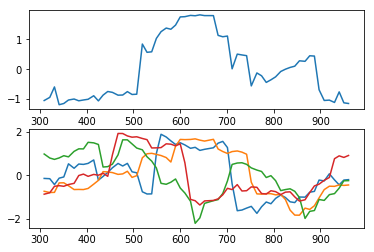

subject 19; gesture 1_1_1; avg 0.6824517946970787; sd 0.032501473161622246
subject 19; gesture 1_1_1; PoV: 0.8755396866641734


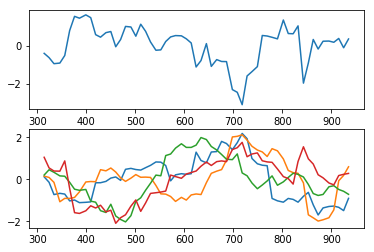

subject 19; gesture 3_1_2; avg 0.572472545004737; sd 0.030705378521359752
subject 19; gesture 3_1_2; PoV: 0.8662817554482972


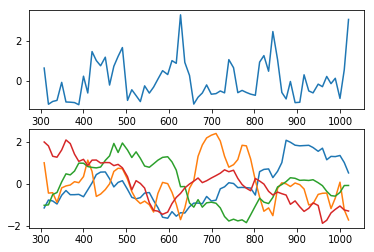

subject 19; gesture 2_1_1; avg 0.4855852697324742; sd 0.027671391924476405
subject 19; gesture 2_1_1; PoV: 0.8611232350648375


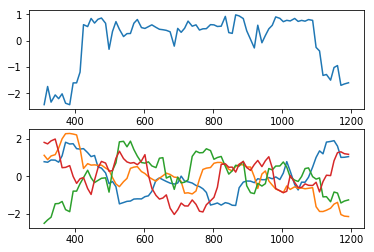

subject 19; gesture 1_0_1; avg 0.7843658121766194; sd 0.08303276791502082
subject 19; gesture 1_0_1; PoV: 0.8118190517462754


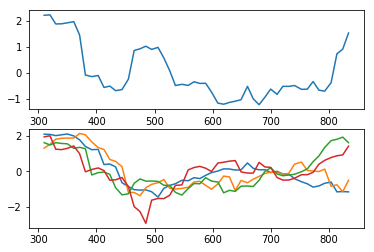

subject 19; gesture 3_1_1; avg 0.46373094231662604; sd 0.02094297423796026
subject 19; gesture 3_1_1; PoV: 0.8692791326377806


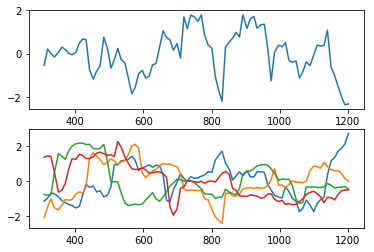

subject 19; gesture 1_0_2; avg 0.6429222978766593; sd 0.028619273549833915
subject 19; gesture 1_0_2; PoV: 0.8721271188959191


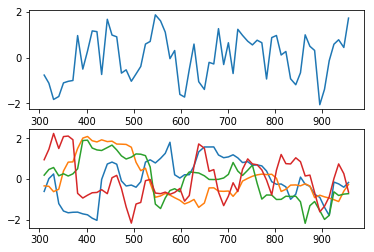

subject 19; gesture 4_0_2; avg 0.5008546135456609; sd 0.018631622070462647
subject 19; gesture 4_0_2; PoV: 0.8861423310486574


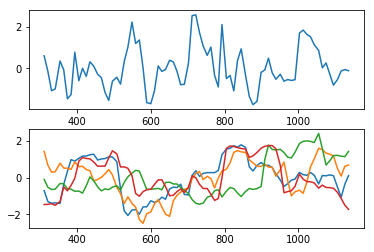

subject 07; gesture 3_0_1; avg 0.5138261055132466; sd 0.03131581471447185
subject 07; gesture 3_0_1; PoV: 0.8642013906255931


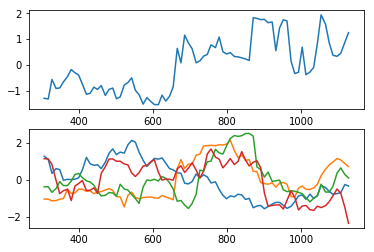

subject 07; gesture 4_1_1; avg 0.46533878776964926; sd 0.027388312196274228
subject 07; gesture 4_1_1; PoV: 0.8589250588736891


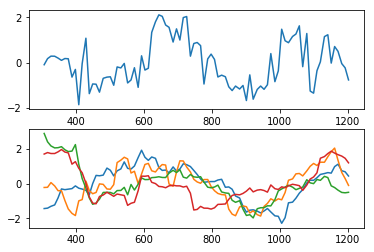

subject 07; gesture 2_0_1; avg 0.5287701105908091; sd 0.026057350698239758
subject 07; gesture 2_0_1; PoV: 0.8587300519846616


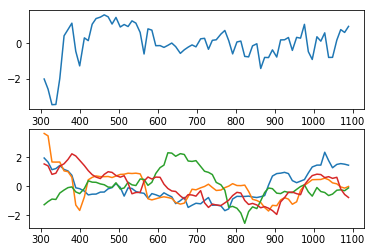

subject 07; gesture 4_1_2; avg 0.33540476609220116; sd 0.014626817940605373
subject 07; gesture 4_1_2; PoV: 0.8672657450415288


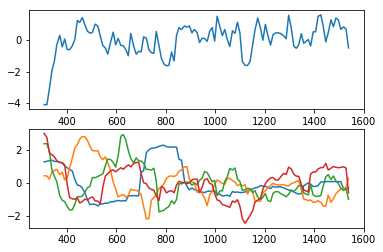

subject 07; gesture 2_0_2; avg 0.5102757779819633; sd 0.0340813683432687
subject 07; gesture 2_0_2; PoV: 0.8611931504570232


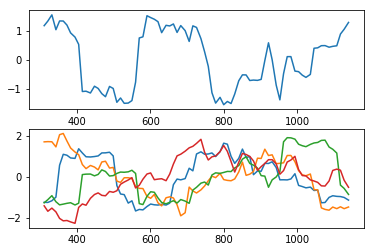

subject 07; gesture 1_1_2; avg 0.4885157553923859; sd 0.01947401960953954
subject 07; gesture 1_1_2; PoV: 0.8811737761344425


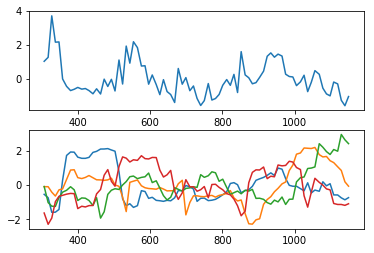

subject 07; gesture 2_1_2; avg 0.4754599389971652; sd 0.024439606783247834
subject 07; gesture 2_1_2; PoV: 0.8649144808893339


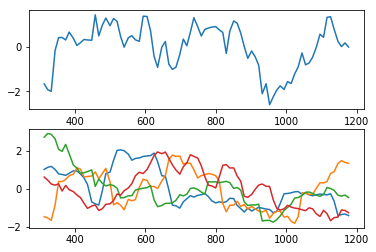

subject 07; gesture 4_0_1; avg 0.4375924000179187; sd 0.01708904048733226
subject 07; gesture 4_0_1; PoV: 0.886086925997179


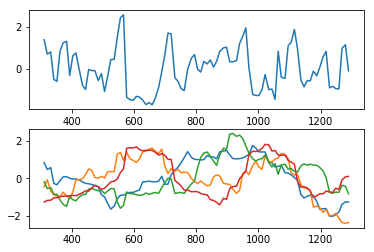

subject 07; gesture 3_0_2; avg 0.4465234377166879; sd 0.017458804721185158
subject 07; gesture 3_0_2; PoV: 0.8817701620008555


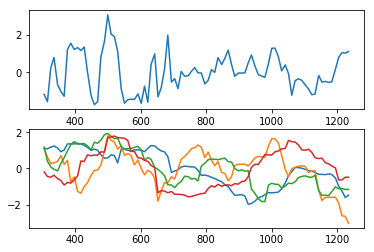

subject 07; gesture 1_1_1; avg 0.5827730534001404; sd 0.03172052275571081
subject 07; gesture 1_1_1; PoV: 0.8600861243506016


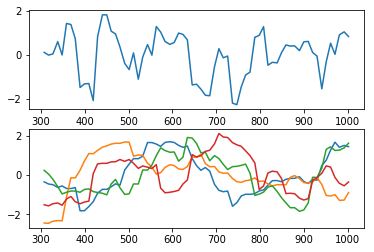

subject 07; gesture 3_1_2; avg 0.406073454398186; sd 0.02161469046284106
subject 07; gesture 3_1_2; PoV: 0.8683179540842959


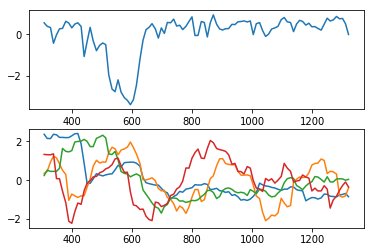

subject 07; gesture 2_1_1; avg 0.4977147883520557; sd 0.023646998439217182
subject 07; gesture 2_1_1; PoV: 0.8691321985404471


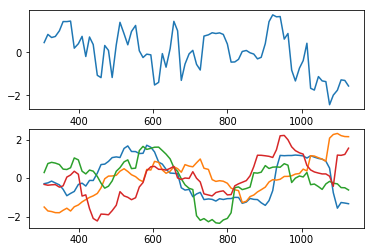

subject 07; gesture 1_0_1; avg 0.4390781944449166; sd 0.0183734547288355
subject 07; gesture 1_0_1; PoV: 0.8783418522339698


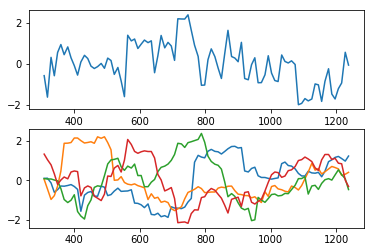

subject 07; gesture 3_1_1; avg 0.4700415649677939; sd 0.04268119350742629
subject 07; gesture 3_1_1; PoV: 0.8345812271759476


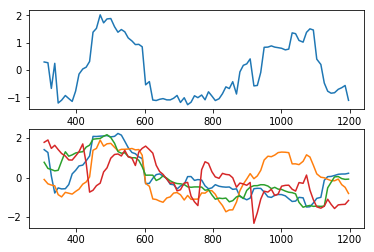

subject 07; gesture 1_0_2; avg 0.5521410501789125; sd 0.024525057952234065
subject 07; gesture 1_0_2; PoV: 0.8774125413843059


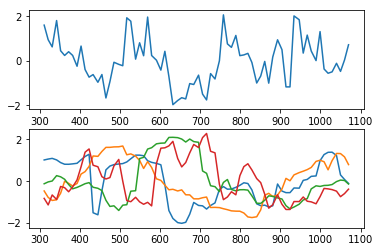

subject 07; gesture 4_0_2; avg 0.48761076102141; sd 0.025559594889882895
subject 07; gesture 4_0_2; PoV: 0.8629520149411372


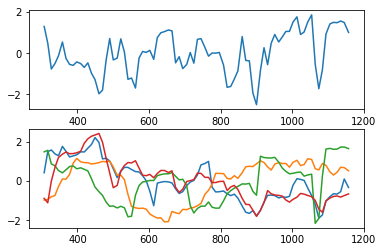

subject 20; gesture 3_0_1; avg 0.5126644398332817; sd 0.055465011031420916
subject 20; gesture 3_0_1; PoV: 0.8190396155279032


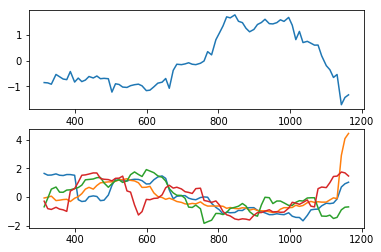

subject 20; gesture 4_1_1; avg 0.6047008275099377; sd 0.0678879833445449
subject 20; gesture 4_1_1; PoV: 0.8284495198827128


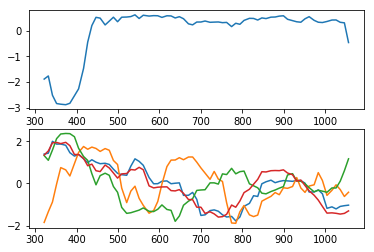

subject 20; gesture 2_0_1; avg 0.5491094118816144; sd 0.03345848842971212
subject 20; gesture 2_0_1; PoV: 0.8535153425301761


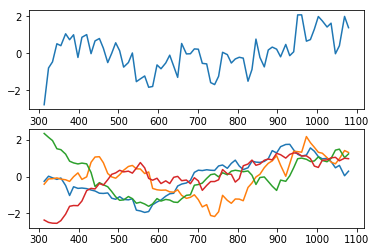

subject 20; gesture 4_1_2; avg 0.7494558428279323; sd 0.05682709102583566
subject 20; gesture 4_1_2; PoV: 0.8431206832534148


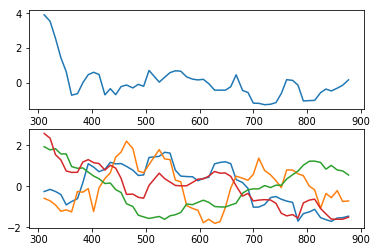

subject 20; gesture 2_0_2; avg 0.5127657338160494; sd 0.04366646016084805
subject 20; gesture 2_0_2; PoV: 0.8357990101625218


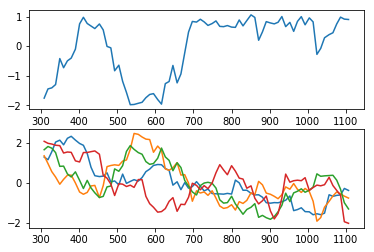

subject 20; gesture 1_1_2; avg 0.5399140024072043; sd 0.021541196672965494
subject 20; gesture 1_1_2; PoV: 0.8799695455112612


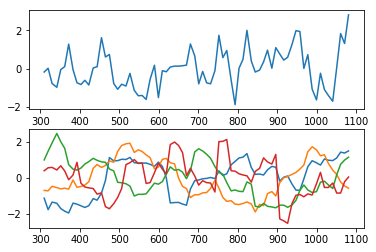

subject 20; gesture 2_1_2; avg 0.5496820770666104; sd 0.026939750647975817
subject 20; gesture 2_1_2; PoV: 0.8573411528883554


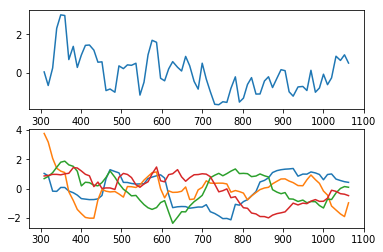

subject 20; gesture 4_0_1; avg 0.44802367368957213; sd 0.022803128547937437
subject 20; gesture 4_0_1; PoV: 0.8663803447827056


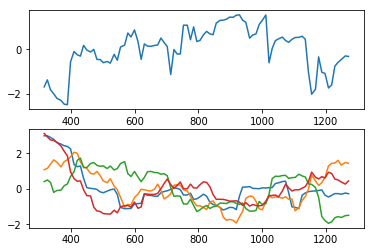

subject 20; gesture 3_0_2; avg 0.6170111775563222; sd 0.02683407797595553
subject 20; gesture 3_0_2; PoV: 0.8803508889995011


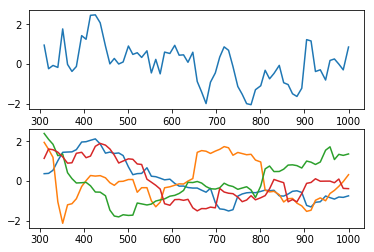

subject 20; gesture 1_1_1; avg 0.5051944615355909; sd 0.02171671102943824
subject 20; gesture 1_1_1; PoV: 0.8782953282898696


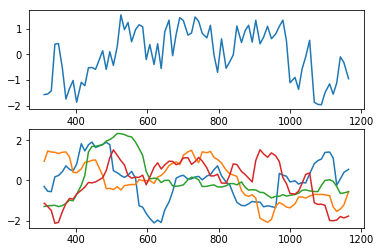

subject 20; gesture 3_1_2; avg 0.6091692225281663; sd 0.02847362619730811
subject 20; gesture 3_1_2; PoV: 0.8745791063398518


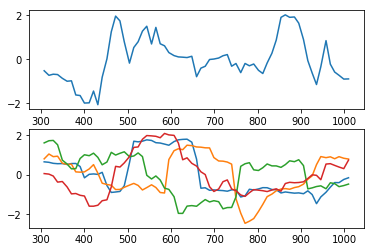

subject 20; gesture 2_1_1; avg 0.5419361280578945; sd 0.025403364394618252
subject 20; gesture 2_1_1; PoV: 0.8709252667088477


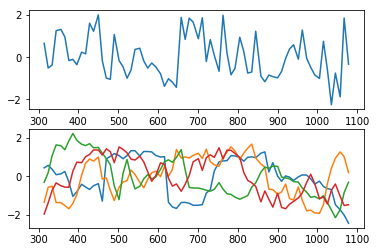

subject 20; gesture 1_0_1; avg 0.5121735654674789; sd 0.02417391101651924
subject 20; gesture 1_0_1; PoV: 0.8666700790660341


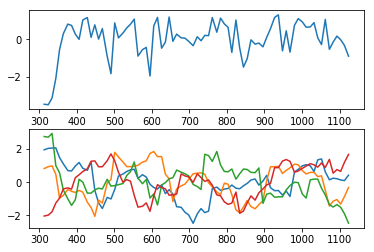

subject 20; gesture 3_1_1; avg 0.5752301358985437; sd 0.05285738229194173
subject 20; gesture 3_1_1; PoV: 0.8399205485666635


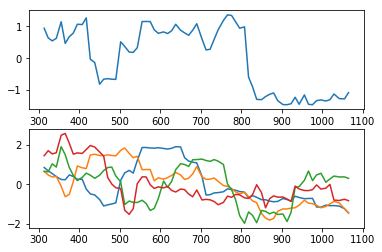

subject 20; gesture 1_0_2; avg 0.3904045923026205; sd 0.01634942664072756
subject 20; gesture 1_0_2; PoV: 0.8741157214101994


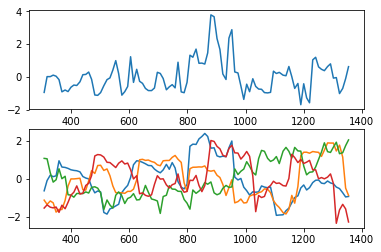

subject 20; gesture 4_0_2; avg 0.5626997587984797; sd 0.03148515363237613
subject 20; gesture 4_0_2; PoV: 0.8636474373503142


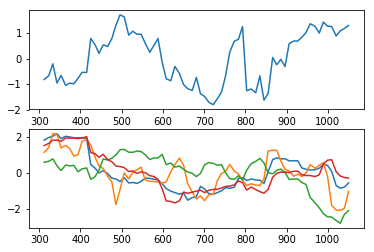

subject 31; gesture 3_0_1; avg 0.5788410083727714; sd 0.024450438319954085
subject 31; gesture 3_0_1; PoV: 0.8723150765708624


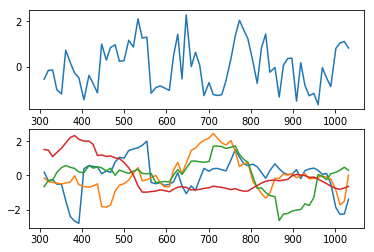

subject 31; gesture 4_1_1; avg 0.7190375553269552; sd 0.036363249200868746
subject 31; gesture 4_1_1; PoV: 0.8681790567570405


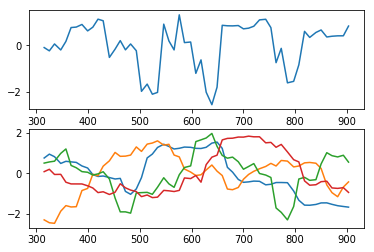

subject 31; gesture 2_0_1; avg 0.6494274325508111; sd 0.03127469098185135
subject 31; gesture 2_0_1; PoV: 0.8647110280332035


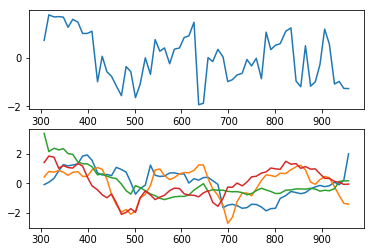

subject 31; gesture 4_1_2; avg 0.7012460038801123; sd 0.18442738691388444
subject 31; gesture 4_1_2; PoV: 0.7335551418642005


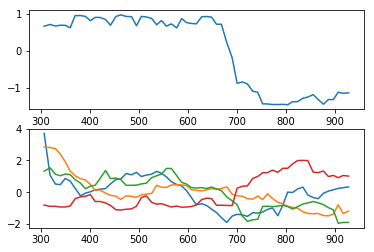

subject 31; gesture 2_0_2; avg 0.7063238553585969; sd 0.05042476537097515
subject 31; gesture 2_0_2; PoV: 0.8529731843330611


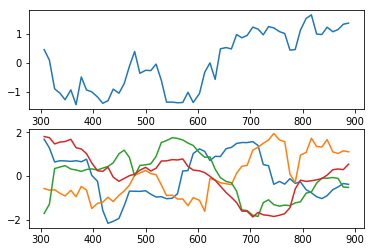

subject 31; gesture 1_1_2; avg 0.6559390523673253; sd 0.030571923770977307
subject 31; gesture 1_1_2; PoV: 0.870480154434143


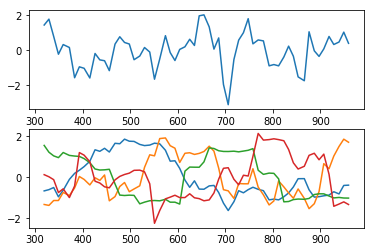

subject 31; gesture 2_1_2; avg 0.7975482416575405; sd 0.10189461121147116
subject 31; gesture 2_1_2; PoV: 0.8025865064620453


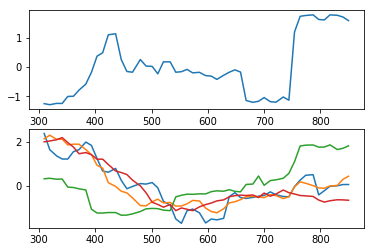

subject 31; gesture 4_0_1; avg 0.6010361321115945; sd 0.02709854517858243
subject 31; gesture 4_0_1; PoV: 0.8690949138155979


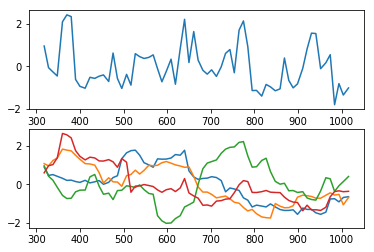

subject 31; gesture 3_0_2; avg 0.6870144583414989; sd 0.03352926939842844
subject 31; gesture 3_0_2; PoV: 0.8779956327847537


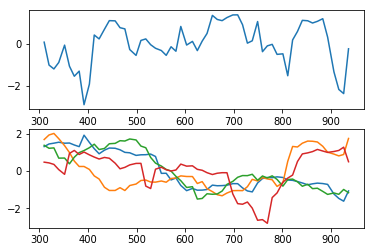

subject 31; gesture 1_1_1; avg 0.6231629016306257; sd 0.04100409203365005
subject 31; gesture 1_1_1; PoV: 0.855870755415272


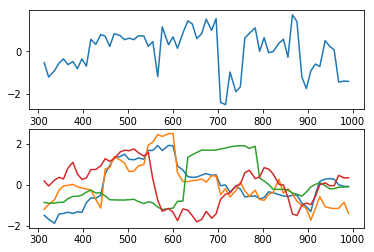

subject 31; gesture 3_1_2; avg 0.6680799826191697; sd 0.03040214147558323
subject 31; gesture 3_1_2; PoV: 0.8767871096102057


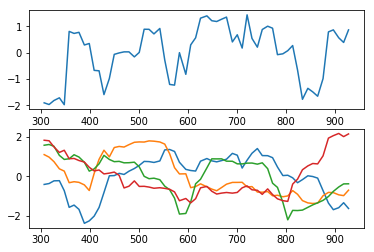

subject 31; gesture 2_1_1; avg 0.6066145918072294; sd 0.026811477697763427
subject 31; gesture 2_1_1; PoV: 0.8730212512928703


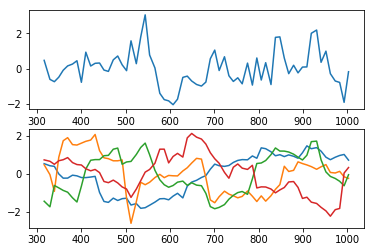

subject 31; gesture 1_0_1; avg 0.4228532183346263; sd 0.01840772135264749
subject 31; gesture 1_0_1; PoV: 0.8762783130564427


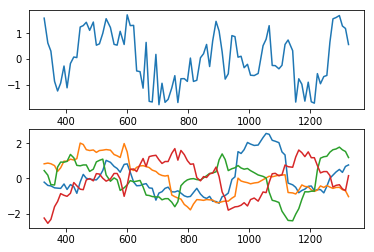

subject 31; gesture 3_1_1; avg 0.6833193312800535; sd 0.02920780447910915
subject 31; gesture 3_1_1; PoV: 0.880649780460126


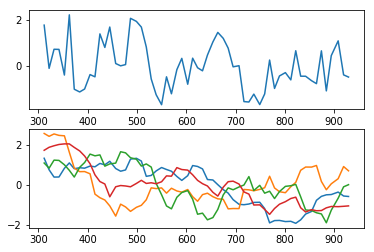

subject 31; gesture 1_0_2; avg 0.6273293899465475; sd 0.03309894976749074
subject 31; gesture 1_0_2; PoV: 0.8681270479375942


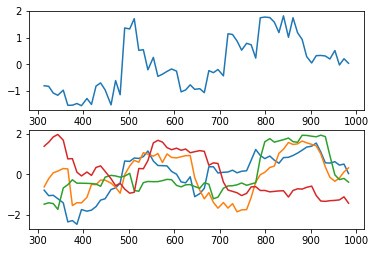

subject 31; gesture 4_0_2; avg 0.6197097168438359; sd 0.030363419714078584
subject 31; gesture 4_0_2; PoV: 0.8739239934500372


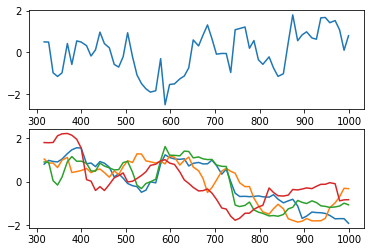

subject 13; gesture 3_0_1; avg 0.40410480419431777; sd 0.020147158634669673
subject 13; gesture 3_0_1; PoV: 0.8730419108925209


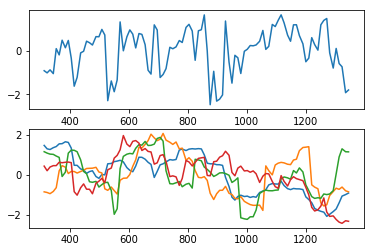

subject 13; gesture 4_1_1; avg 0.3555337635316179; sd 0.019931108705089476
subject 13; gesture 4_1_1; PoV: 0.8585764949399646


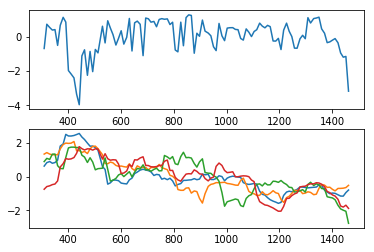

subject 13; gesture 2_0_1; avg 0.471758230675517; sd 0.022389230851092137
subject 13; gesture 2_0_1; PoV: 0.8720462657194202


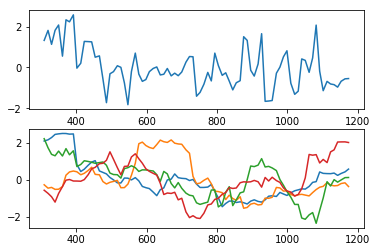

subject 13; gesture 4_1_2; avg 0.29720661394523346; sd 0.013620913943129314
subject 13; gesture 4_1_2; PoV: 0.8696941033857895


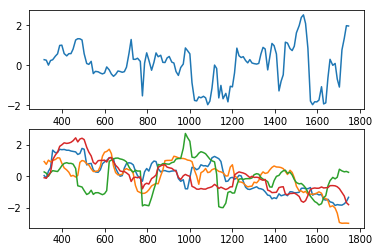

subject 13; gesture 2_0_2; avg 0.4392466550482566; sd 0.019970696040504044
subject 13; gesture 2_0_2; PoV: 0.8721109467918007


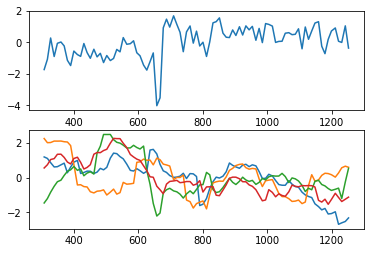

subject 13; gesture 1_1_2; avg 0.44844318080250495; sd 0.020956594049590258
subject 13; gesture 1_1_2; PoV: 0.8722272879191642


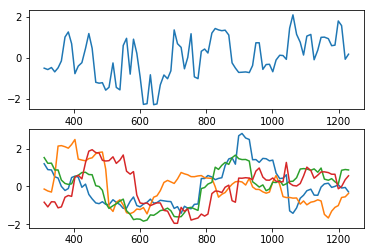

subject 13; gesture 2_1_2; avg 0.4369210538239283; sd 0.01962162500346577
subject 13; gesture 2_1_2; PoV: 0.8749293429807017


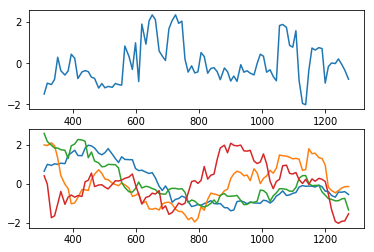

subject 13; gesture 4_0_1; avg 0.29902241725110906; sd 0.015579536485863766
subject 13; gesture 4_0_1; PoV: 0.8634206291425417


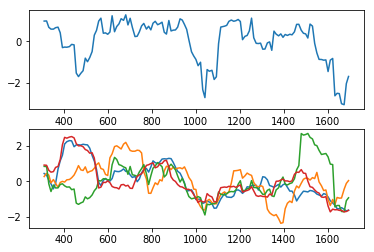

subject 13; gesture 3_0_2; avg 0.35577379881114146; sd 0.015874956652506943
subject 13; gesture 3_0_2; PoV: 0.8779871340244642


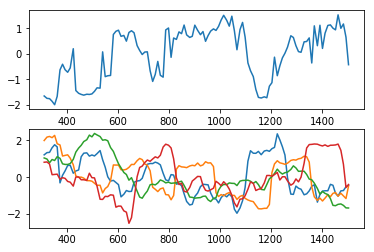

subject 13; gesture 1_1_1; avg 0.5212828830813744; sd 0.03434348313949581
subject 13; gesture 1_1_1; PoV: 0.8515009634017496


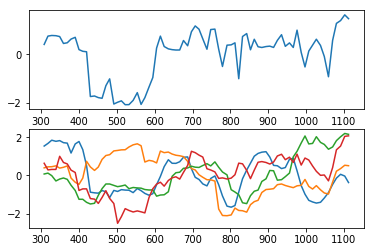

subject 13; gesture 3_1_2; avg 0.29078206828771613; sd 0.01634105548676577
subject 13; gesture 3_1_2; PoV: 0.8567624449878136


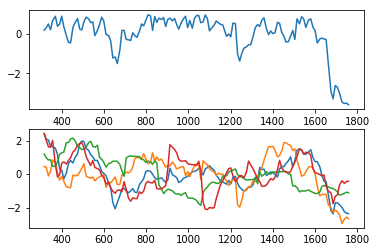

subject 13; gesture 2_1_1; avg 0.3894915873852907; sd 0.01864446571162503
subject 13; gesture 2_1_1; PoV: 0.8695265374890413


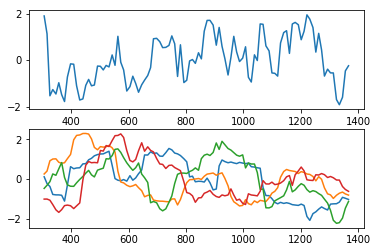

subject 13; gesture 1_0_1; avg 0.22243705938224953; sd 0.009450997441746123
subject 13; gesture 1_0_1; PoV: 0.8690915541426016


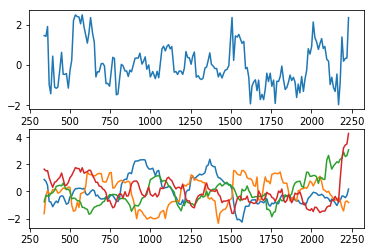

subject 13; gesture 3_1_1; avg 0.3265937081408563; sd 0.012578657949268672
subject 13; gesture 3_1_1; PoV: 0.8809831902133751


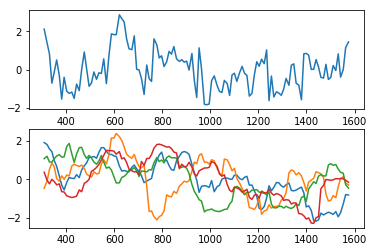

subject 13; gesture 1_0_2; avg 0.3929471982022361; sd 0.016247646046827605
subject 13; gesture 1_0_2; PoV: 0.8790754726617909


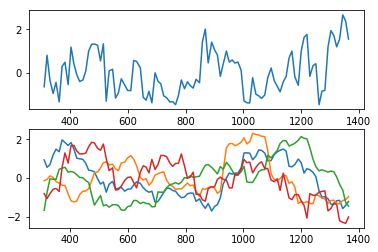

subject 13; gesture 4_0_2; avg 0.38190166860464303; sd 0.017007906227185794
subject 13; gesture 4_0_2; PoV: 0.8744710033038544


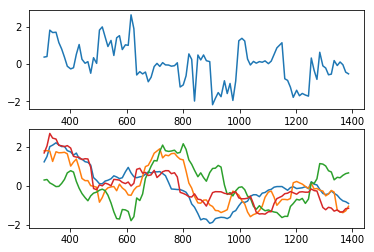

subject 36; gesture 3_0_1; avg 0.6521783793437076; sd 0.03586796773207261
subject 36; gesture 3_0_1; PoV: 0.8575579299501663


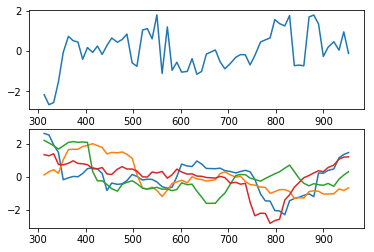

subject 36; gesture 4_1_1; avg 0.7304044719853376; sd 0.06884472117065628
subject 36; gesture 4_1_1; PoV: 0.848460854647581


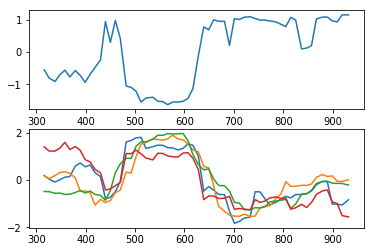

subject 36; gesture 2_0_1; avg 0.6743929313874932; sd 0.04073333756961244
subject 36; gesture 2_0_1; PoV: 0.8641594947864514


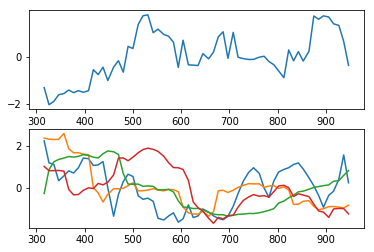

subject 36; gesture 4_1_2; avg 0.7804857354528976; sd 0.10758971913640643
subject 36; gesture 4_1_2; PoV: 0.7918251875347029


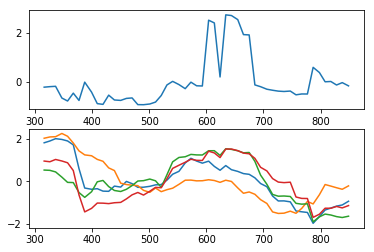

subject 36; gesture 2_0_2; avg 0.6616701784412898; sd 0.04837826545929986
subject 36; gesture 2_0_2; PoV: 0.8487001429991804


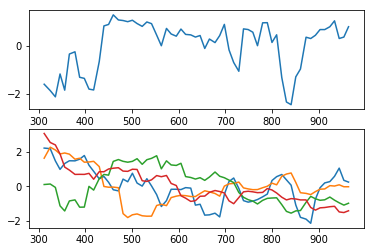

subject 36; gesture 1_1_2; avg 0.6193936034633591; sd 0.03362333061333355
subject 36; gesture 1_1_2; PoV: 0.8717312076768405


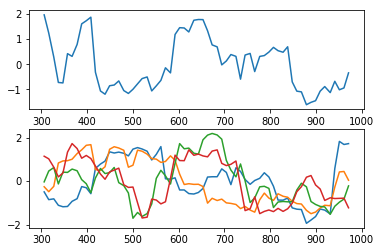

subject 36; gesture 2_1_2; avg 0.8067367110591905; sd 0.05218712275540632
subject 36; gesture 2_1_2; PoV: 0.8517007751751894


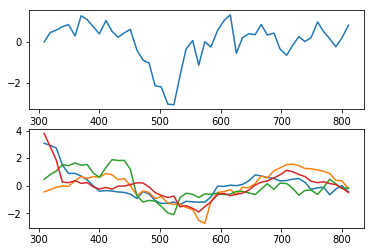

subject 36; gesture 4_0_1; avg 0.5871683803537194; sd 0.041729102823519604
subject 36; gesture 4_0_1; PoV: 0.8543030864469648


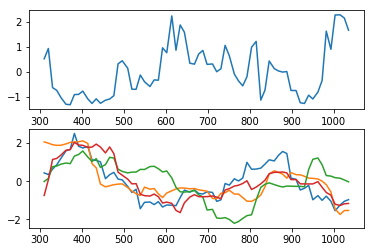

subject 36; gesture 3_0_2; avg 0.613203280388301; sd 0.030224631228668634
subject 36; gesture 3_0_2; PoV: 0.8707385256145868


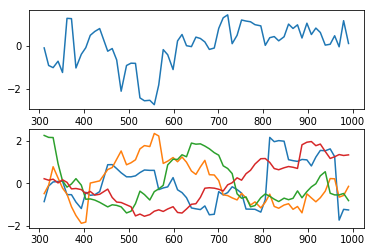

subject 36; gesture 1_1_1; avg 0.5404104807144784; sd 0.02070921706220631
subject 36; gesture 1_1_1; PoV: 0.8827569641299801


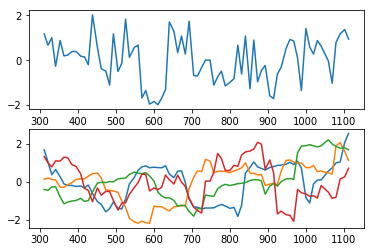

subject 36; gesture 3_1_2; avg 0.7424105957822478; sd 0.03861470162806801
subject 36; gesture 3_1_2; PoV: 0.8704444792783463


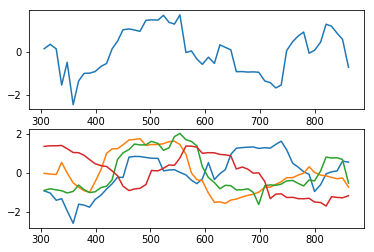

subject 36; gesture 2_1_1; avg 0.5773577793838737; sd 0.036982209214664975
subject 36; gesture 2_1_1; PoV: 0.8580489750623167


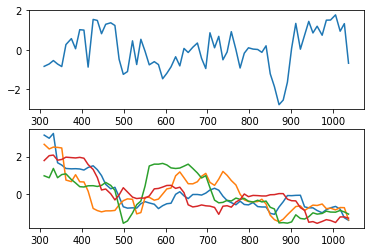

subject 36; gesture 1_0_1; avg 0.6706018964688178; sd 0.03112913815107719
subject 36; gesture 1_0_1; PoV: 0.8702138947066196


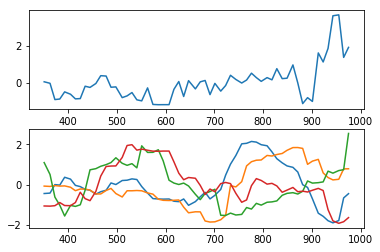

subject 36; gesture 3_1_1; avg 0.6545866990128157; sd 0.10236547120109514
subject 36; gesture 3_1_1; PoV: 0.781852446090214


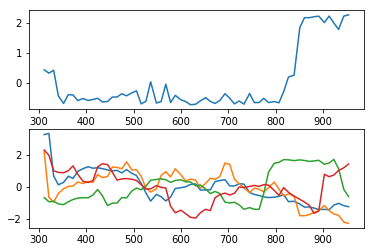

subject 36; gesture 1_0_2; avg 0.6899543174889364; sd 0.0356215252836167
subject 36; gesture 1_0_2; PoV: 0.8695689431621026


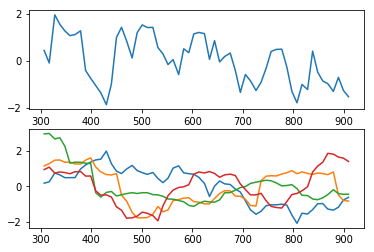

subject 36; gesture 4_0_2; avg 0.7358418383573013; sd 0.047374774808999834
subject 36; gesture 4_0_2; PoV: 0.8567590576721459


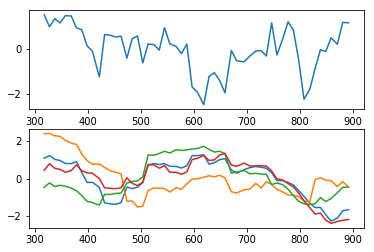

subject 24; gesture 3_0_1; avg 0.6897290556937481; sd 0.0460114836732302
subject 24; gesture 3_0_1; PoV: 0.861152853010556


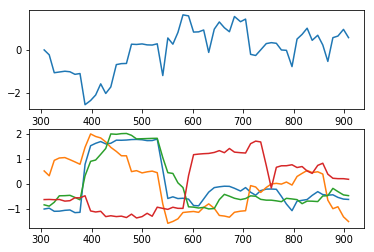

subject 24; gesture 4_1_1; avg 0.4865251794752597; sd 0.031033283438252672
subject 24; gesture 4_1_1; PoV: 0.8554986986291534


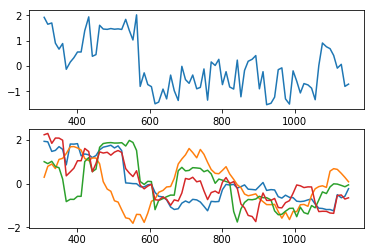

subject 24; gesture 2_0_1; avg 0.584112766286299; sd 0.1351669872134371
subject 24; gesture 2_0_1; PoV: 0.7427352919642701


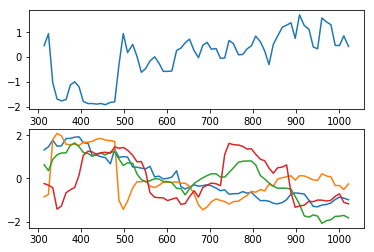

subject 24; gesture 4_1_2; avg 0.46355659331572807; sd 0.028413504762770964
subject 24; gesture 4_1_2; PoV: 0.8545127565692737


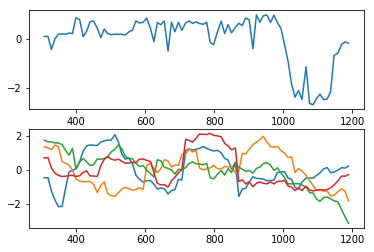

subject 24; gesture 2_0_2; avg 0.5155539700961427; sd 0.026944145926582563
subject 24; gesture 2_0_2; PoV: 0.8668798003743093


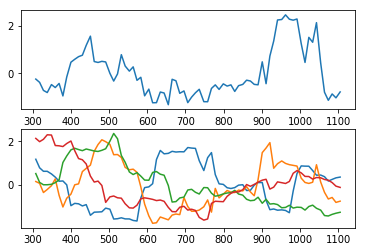

subject 24; gesture 1_1_2; avg 0.5651624730600334; sd 0.02418509791376397
subject 24; gesture 1_1_2; PoV: 0.873420982189114


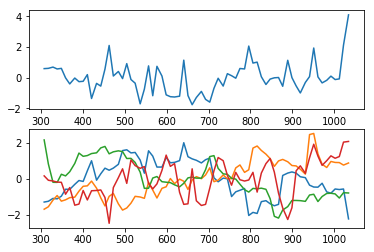

subject 24; gesture 2_1_2; avg 0.4796984667735443; sd 0.03830213693598439
subject 24; gesture 2_1_2; PoV: 0.8423652077619497


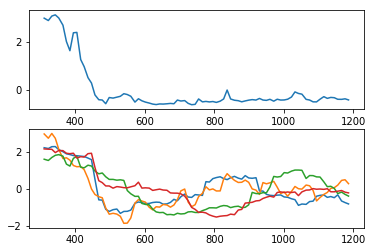

subject 24; gesture 4_0_1; avg 0.5682497500672539; sd 0.027370038683539318
subject 24; gesture 4_0_1; PoV: 0.8790073006012908


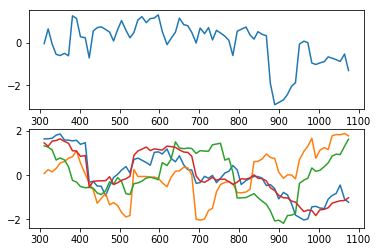

subject 24; gesture 3_0_2; avg 0.5797496540420712; sd 0.03809349239918729
subject 24; gesture 3_0_2; PoV: 0.8534115700297376


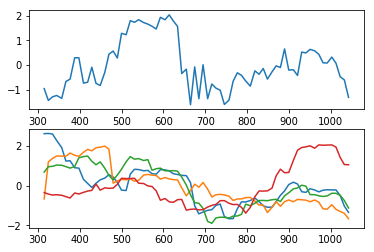

subject 24; gesture 1_1_1; avg 0.6442187444510175; sd 0.03420757081703122
subject 24; gesture 1_1_1; PoV: 0.8619202670014187


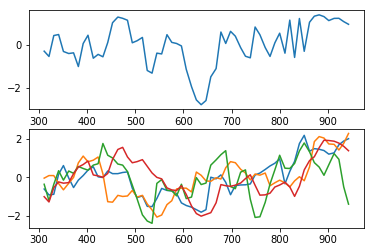

subject 24; gesture 3_1_2; avg 0.5681658583693108; sd 0.03886127157282373
subject 24; gesture 3_1_2; PoV: 0.8519641115464889


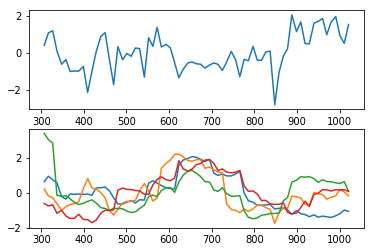

subject 24; gesture 2_1_1; avg 0.586188774555579; sd 0.04196127742725994
subject 24; gesture 2_1_1; PoV: 0.8534423948602117


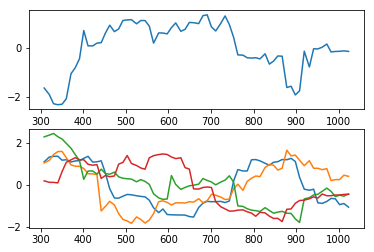

subject 24; gesture 1_0_1; avg 0.5284058977509187; sd 0.024833689161906303
subject 24; gesture 1_0_1; PoV: 0.8714126503598919


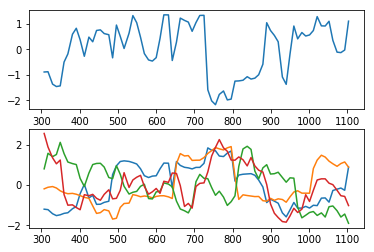

subject 24; gesture 3_1_1; avg 0.5470083337185089; sd 0.028464656204448588
subject 24; gesture 3_1_1; PoV: 0.8649542858397915


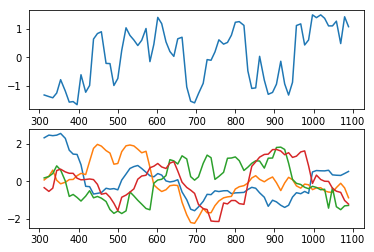

subject 24; gesture 1_0_2; avg 0.5586167526276743; sd 0.028237592382597865
subject 24; gesture 1_0_2; PoV: 0.8650936906534028


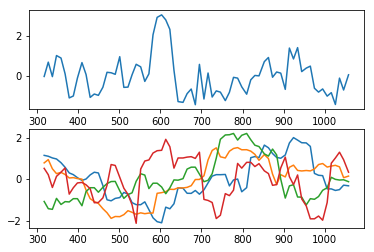

subject 24; gesture 4_0_2; avg 0.5192332779647636; sd 0.039997712628956024
subject 24; gesture 4_0_2; PoV: 0.8390517656729433


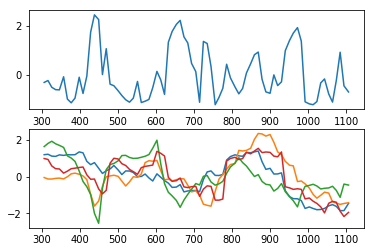

subject 33; gesture 3_0_1; avg 0.6627884958399108; sd 0.04063578839456625
subject 33; gesture 3_0_1; PoV: 0.8580167423500786


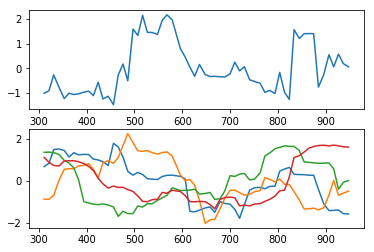

subject 33; gesture 4_1_1; avg 0.5862183568075854; sd 0.0456796437369707
subject 33; gesture 4_1_1; PoV: 0.8452115211426129


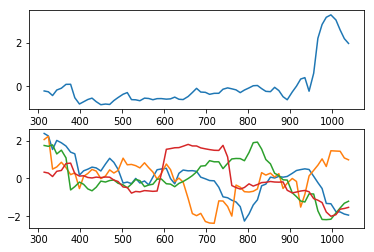

subject 33; gesture 2_0_1; avg 0.74970649030599; sd 0.047182158509706924
subject 33; gesture 2_0_1; PoV: 0.8505905515482488


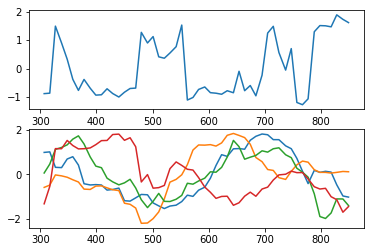

subject 33; gesture 4_1_2; avg 0.644445386713607; sd 0.04732449620946663
subject 33; gesture 4_1_2; PoV: 0.8459253996310717


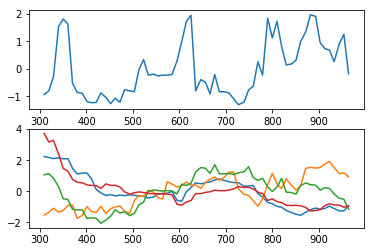

subject 33; gesture 2_0_2; avg 0.6052801990935084; sd 0.037756794314817786
subject 33; gesture 2_0_2; PoV: 0.8604054248238173


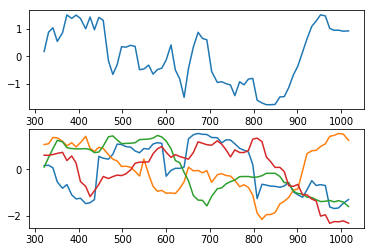

subject 33; gesture 1_1_2; avg 0.552867027946483; sd 0.07024035035443651
subject 33; gesture 1_1_2; PoV: 0.8096073342640792


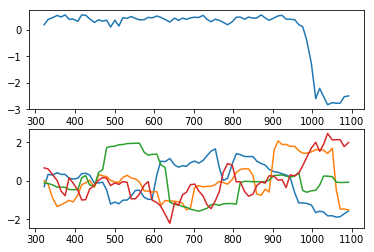

subject 33; gesture 2_1_2; avg 0.5803411579174308; sd 0.02802593165116594
subject 33; gesture 2_1_2; PoV: 0.8668234446509476


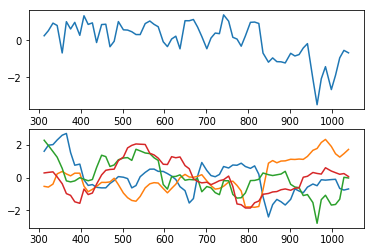

subject 33; gesture 4_0_1; avg 0.642421054384812; sd 0.048650844031478506
subject 33; gesture 4_0_1; PoV: 0.8418433038993619


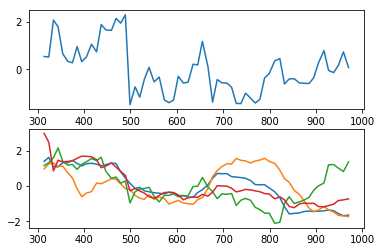

subject 33; gesture 3_0_2; avg 0.6052409620574112; sd 0.05601589767317762
subject 33; gesture 3_0_2; PoV: 0.8339535314648601


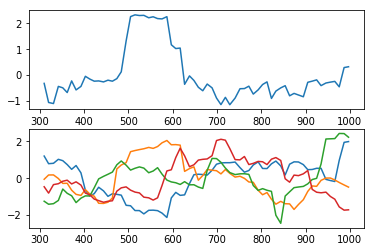

subject 33; gesture 1_1_1; avg 0.528881873127079; sd 0.02143450840284008
subject 33; gesture 1_1_1; PoV: 0.8806560062600154


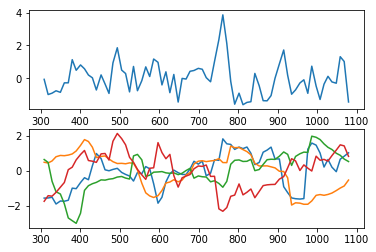

subject 33; gesture 3_1_2; avg 0.6951783035033062; sd 0.04301000600070587
subject 33; gesture 3_1_2; PoV: 0.856708039033391


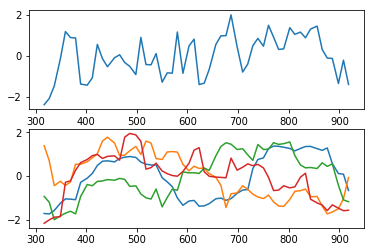

subject 33; gesture 2_1_1; avg 0.6293242328550732; sd 0.04093971996649774
subject 33; gesture 2_1_1; PoV: 0.8552377551451845


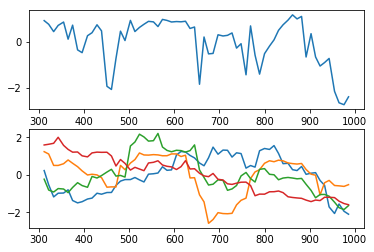

subject 33; gesture 1_0_1; avg 0.5804116114596239; sd 0.03193772140660624
subject 33; gesture 1_0_1; PoV: 0.8594678787545724


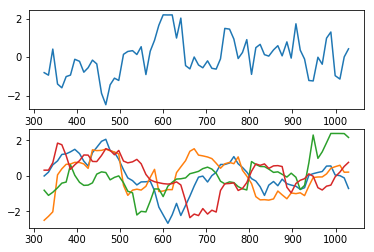

subject 33; gesture 3_1_1; avg 0.6727522680508738; sd 0.06945274688074206
subject 33; gesture 3_1_1; PoV: 0.8277580543715269


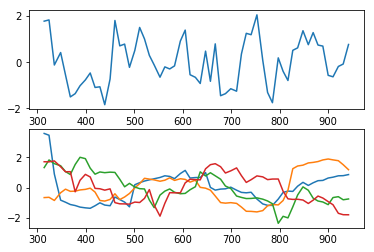

subject 33; gesture 1_0_2; avg 0.5345034396828172; sd 0.028429849938882458
subject 33; gesture 1_0_2; PoV: 0.8651640665954413


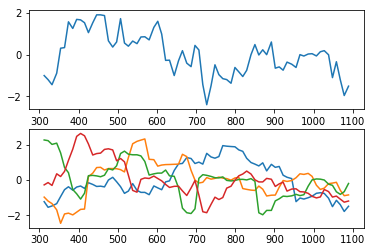

subject 33; gesture 4_0_2; avg 0.6130845680329684; sd 0.03084474706120195
subject 33; gesture 4_0_2; PoV: 0.8670539013957567


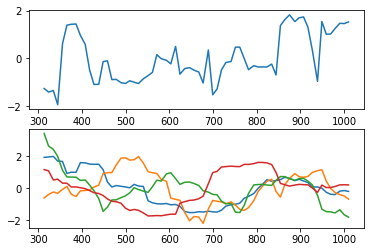

subject 11; gesture 3_0_1; avg 0.5757721382952392; sd 0.03851041729196186
subject 11; gesture 3_0_1; PoV: 0.8472418732427336


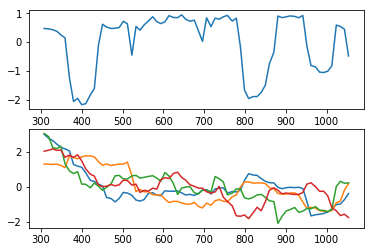

subject 11; gesture 4_1_1; avg 0.5505858911108923; sd 0.040526592104428355
subject 11; gesture 4_1_1; PoV: 0.8459772333188612


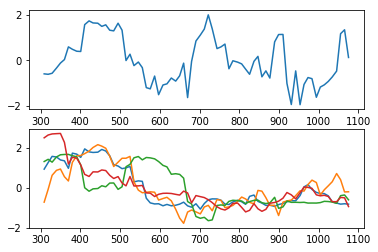

subject 11; gesture 2_0_1; avg 0.5185658266066899; sd 0.046230229560616835
subject 11; gesture 2_0_1; PoV: 0.8273368921097147


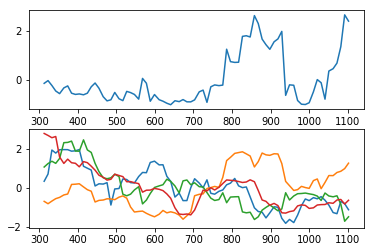

subject 11; gesture 4_1_2; avg 0.5560503788253173; sd 0.02227794080807676
subject 11; gesture 4_1_2; PoV: 0.8756165491203957


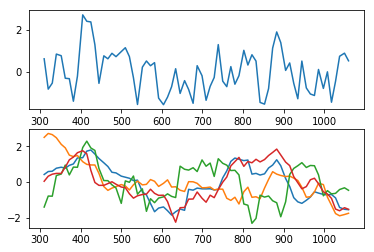

subject 11; gesture 2_0_2; avg 0.5162917865797884; sd 0.025529766393102962
subject 11; gesture 2_0_2; PoV: 0.864656847063053


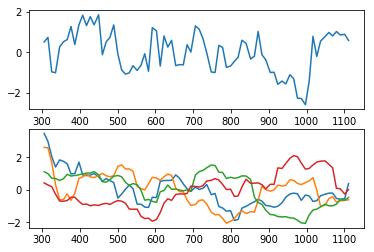

subject 11; gesture 1_1_2; avg 0.5075798069223758; sd 0.024175846554970123
subject 11; gesture 1_1_2; PoV: 0.8692500387399522


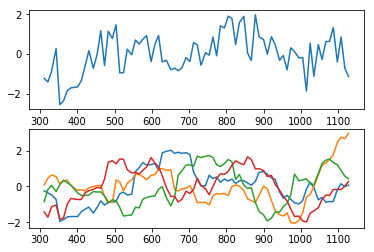

subject 11; gesture 2_1_2; avg 0.5502110504683086; sd 0.027890476082593613
subject 11; gesture 2_1_2; PoV: 0.8688494572795719


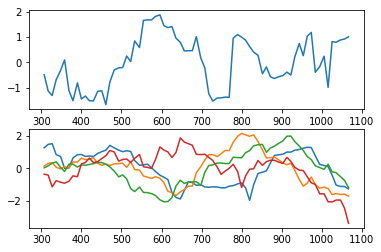

subject 11; gesture 4_0_1; avg 0.5856573136425917; sd 0.04646861682290914
subject 11; gesture 4_0_1; PoV: 0.8426231939573281


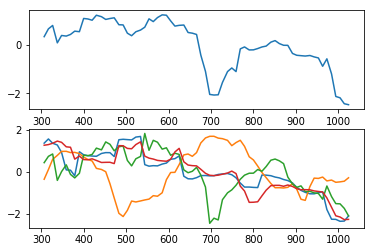

subject 11; gesture 3_0_2; avg 0.5305292887737257; sd 0.026563184705567223
subject 11; gesture 3_0_2; PoV: 0.8663970842442059


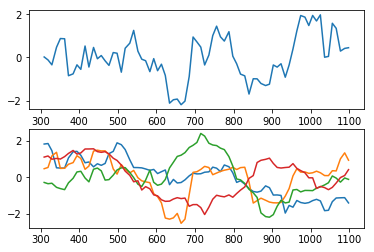

subject 11; gesture 1_1_1; avg 0.4597407590231726; sd 0.02616627049508175
subject 11; gesture 1_1_1; PoV: 0.8580134517528358


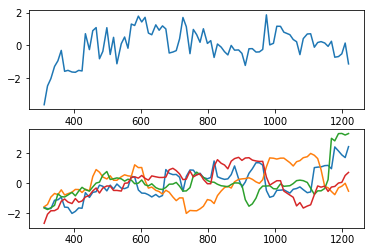

subject 11; gesture 3_1_2; avg 0.5585741040104523; sd 0.10278681887539691
subject 11; gesture 3_1_2; PoV: 0.764299053285337


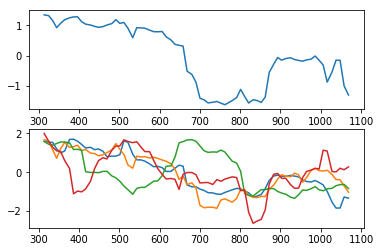

subject 11; gesture 2_1_1; avg 0.5401999616214352; sd 0.029540605559304642
subject 11; gesture 2_1_1; PoV: 0.8638295077882717


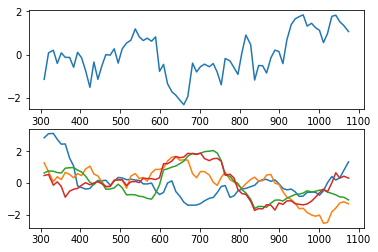

subject 11; gesture 1_0_1; avg 0.4801154515790194; sd 0.019686328828156727
subject 11; gesture 1_0_1; PoV: 0.8761780830379269


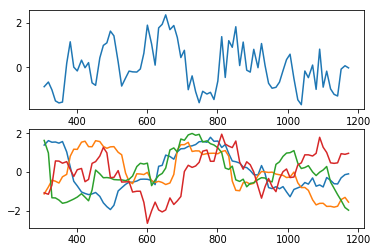

subject 11; gesture 3_1_1; avg 0.5987886979211221; sd 0.03659786405589731
subject 11; gesture 3_1_1; PoV: 0.8549159909447588


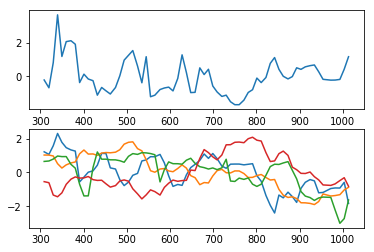

subject 11; gesture 1_0_2; avg 0.5646549981172835; sd 0.026665208930449755
subject 11; gesture 1_0_2; PoV: 0.8711139708549507


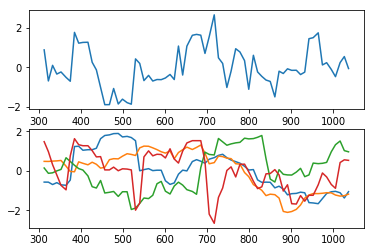

subject 11; gesture 4_0_2; avg 0.5230812102439801; sd 0.028777671137999835
subject 11; gesture 4_0_2; PoV: 0.8599003888275146


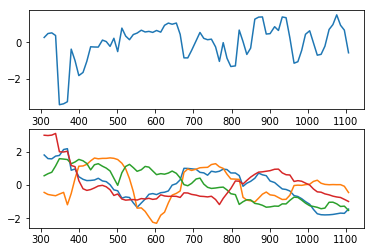

subject 35; gesture 3_0_1; avg 0.7268294865377373; sd 0.04530872470454235
subject 35; gesture 3_0_1; PoV: 0.860708257873042


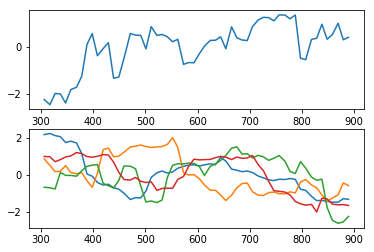

subject 35; gesture 4_1_1; avg 0.6742880701003402; sd 0.03627318235012525
subject 35; gesture 4_1_1; PoV: 0.8701032983906842


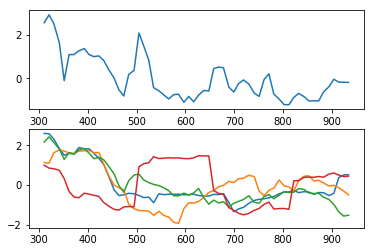

subject 35; gesture 2_0_1; avg 0.7249120082663298; sd 0.03632702221146255
subject 35; gesture 2_0_1; PoV: 0.8674893743633932


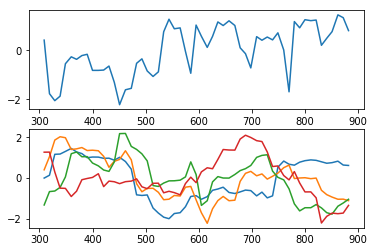

subject 35; gesture 4_1_2; avg 0.6108423322420611; sd 0.16342747931311746
subject 35; gesture 4_1_2; PoV: 0.7126655459868881


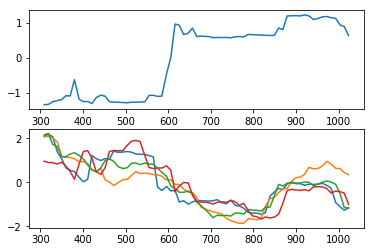

subject 35; gesture 2_0_2; avg 0.5901802766694801; sd 0.02643835163280108
subject 35; gesture 2_0_2; PoV: 0.8801839451237298


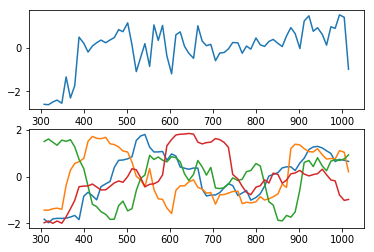

subject 35; gesture 1_1_2; avg 0.5509315407103695; sd 0.026769735501793176
subject 35; gesture 1_1_2; PoV: 0.8652746127975758


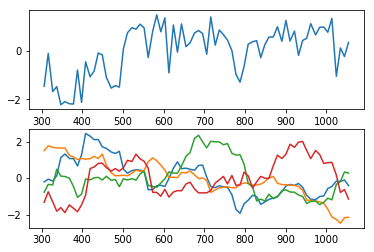

subject 35; gesture 2_1_2; avg 0.6401471832385471; sd 0.06600324990156016
subject 35; gesture 2_1_2; PoV: 0.8119709847304409


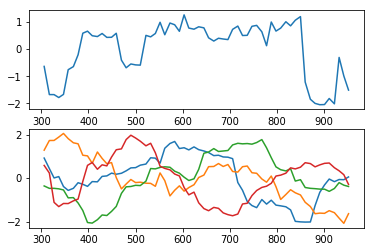

subject 35; gesture 4_0_1; avg 0.6612814547890628; sd 0.059441991907219355
subject 35; gesture 4_0_1; PoV: 0.8262240742534034


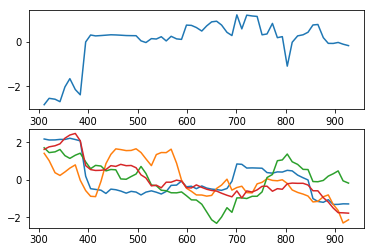

subject 35; gesture 3_0_2; avg 0.5515122086926738; sd 0.12215363712837271
subject 35; gesture 3_0_2; PoV: 0.7475882831374263


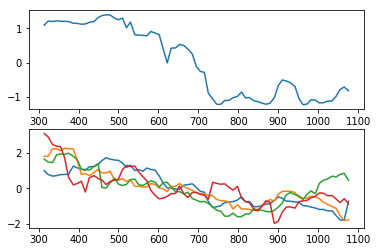

subject 35; gesture 1_1_1; avg 0.7146025300345551; sd 0.031821887136951596
subject 35; gesture 1_1_1; PoV: 0.8677074242002629


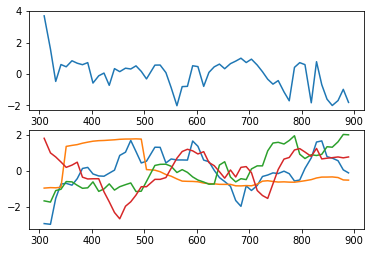

subject 35; gesture 3_1_2; avg 0.5558166124471727; sd 0.03163983190762495
subject 35; gesture 3_1_2; PoV: 0.8612986279350134


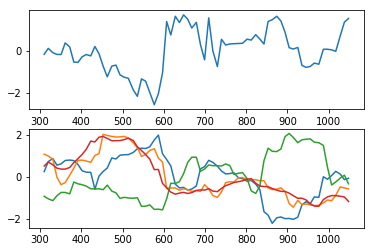

subject 35; gesture 2_1_1; avg 0.6493018093515616; sd 0.03420647978367705
subject 35; gesture 2_1_1; PoV: 0.8606394208497565


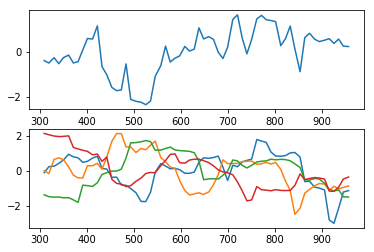

subject 35; gesture 1_0_1; avg 0.5929084816696478; sd 0.0280897008959604
subject 35; gesture 1_0_1; PoV: 0.867741509700967


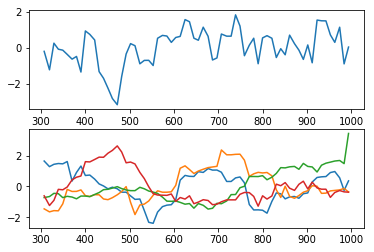

subject 35; gesture 3_1_1; avg 0.7347580275240815; sd 0.22334104874240165
subject 35; gesture 3_1_1; PoV: 0.7019488496714411


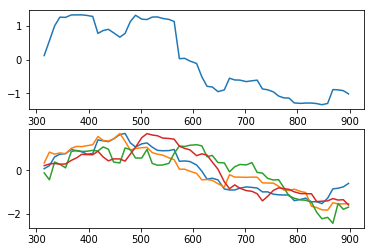

subject 35; gesture 1_0_2; avg 0.5087772788497004; sd 0.02720041746451948
subject 35; gesture 1_0_2; PoV: 0.8601347260864622


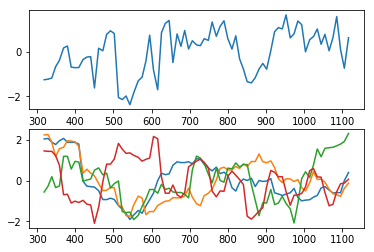

subject 35; gesture 4_0_2; avg 0.49578974044147306; sd 0.021376117368927916
subject 35; gesture 4_0_2; PoV: 0.876039860932495


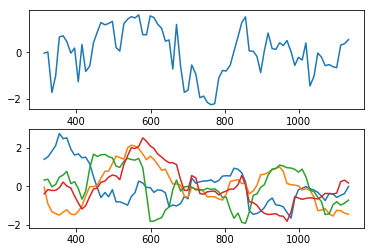

subject 22; gesture 3_0_1; avg 0.7390267025166566; sd 0.04889508668302994
subject 22; gesture 3_0_1; PoV: 0.8584078301966479


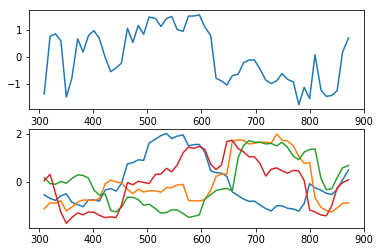

subject 22; gesture 4_1_1; avg 0.6756994297590351; sd 0.1891135258452906
subject 22; gesture 4_1_1; PoV: 0.7208719355439457


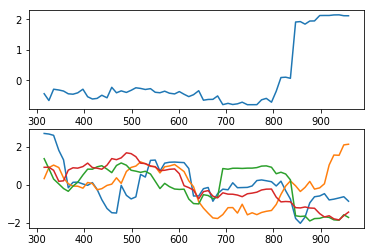

subject 22; gesture 2_0_1; avg 0.695364043847279; sd 0.04229400286718057
subject 22; gesture 2_0_1; PoV: 0.8522048660997849


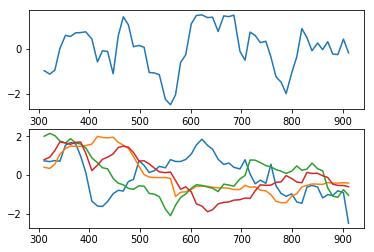

subject 22; gesture 4_1_2; avg 0.6100969244316949; sd 0.047225005159107096
subject 22; gesture 4_1_2; PoV: 0.8430406503060551


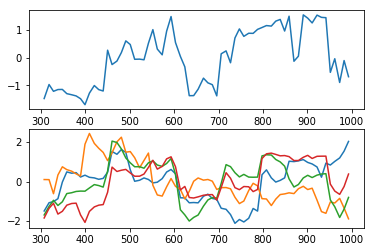

subject 22; gesture 2_0_2; avg 0.5417526653530996; sd 0.0418418371746866
subject 22; gesture 2_0_2; PoV: 0.8434805849533468


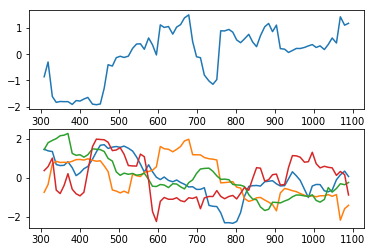

subject 22; gesture 1_1_2; avg 0.7633171903271535; sd 0.04258927859374256
subject 22; gesture 1_1_2; PoV: 0.8461257608474565


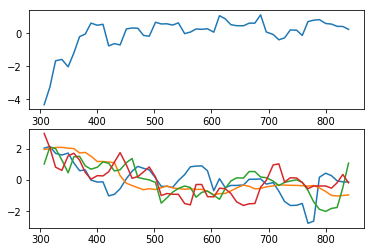

subject 22; gesture 2_1_2; avg 0.5727072030724087; sd 0.08911643092440324
subject 22; gesture 2_1_2; PoV: 0.7866509388001302


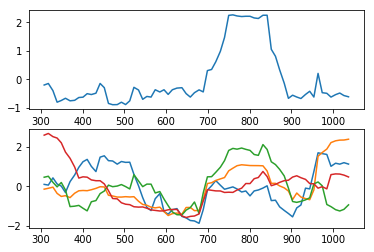

subject 22; gesture 4_0_1; avg 0.6610658504150084; sd 0.04289215645106176
subject 22; gesture 4_0_1; PoV: 0.8538142366683278


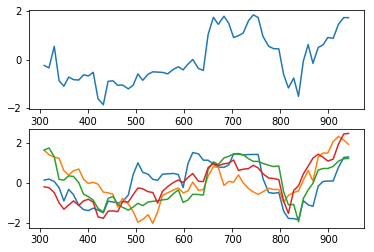

subject 22; gesture 3_0_2; avg 0.6685718442448287; sd 0.037599184139695534
subject 22; gesture 3_0_2; PoV: 0.8681846370352384


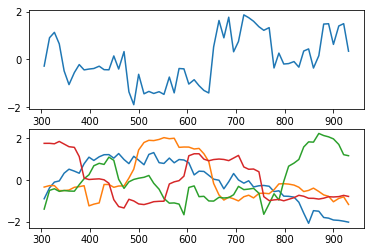

subject 22; gesture 1_1_1; avg 0.6265980156188257; sd 0.032478630901489614
subject 22; gesture 1_1_1; PoV: 0.8687904939928607


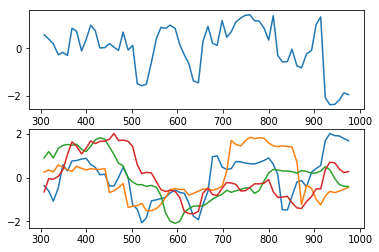

subject 22; gesture 3_1_2; avg 0.6606671888183546; sd 0.04826868365996509
subject 22; gesture 3_1_2; PoV: 0.8412804780896652


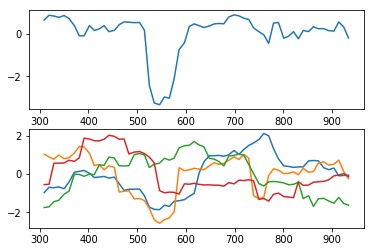

subject 22; gesture 2_1_1; avg 0.6061134328967094; sd 0.035403643561327226
subject 22; gesture 2_1_1; PoV: 0.8648975392506834


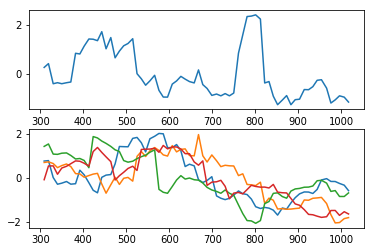

subject 22; gesture 1_0_1; avg 0.7010777989386276; sd 0.04689382229269513
subject 22; gesture 1_0_1; PoV: 0.8442108953427068


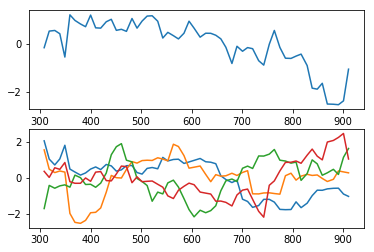

subject 22; gesture 3_1_1; avg 0.580306995142844; sd 0.025756922361463788
subject 22; gesture 3_1_1; PoV: 0.8785698011850277


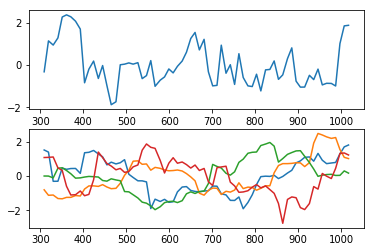

subject 22; gesture 1_0_2; avg 0.5730020818280311; sd 0.022972946038083353
subject 22; gesture 1_0_2; PoV: 0.8837535022735381


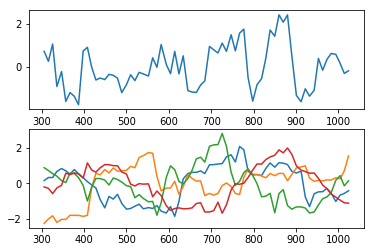

subject 22; gesture 4_0_2; avg 0.7172207538436611; sd 0.03406578079407571
subject 22; gesture 4_0_2; PoV: 0.8715418610625449


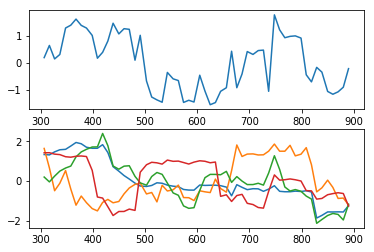

subject 34; gesture 3_0_1; avg 0.5120582764451821; sd 0.034040663019440365
subject 34; gesture 3_0_1; PoV: 0.8551317425026689


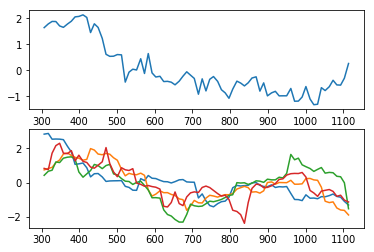

subject 34; gesture 4_1_1; avg 0.5544309371416913; sd 0.054440395981769626
subject 34; gesture 4_1_1; PoV: 0.8245156388744198


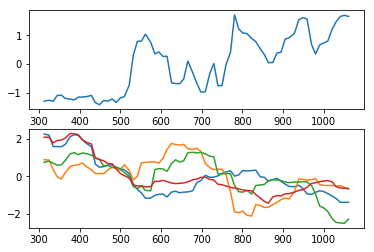

subject 34; gesture 2_0_1; avg 0.5857690114701796; sd 0.028405261161173985
subject 34; gesture 2_0_1; PoV: 0.8747377733616905


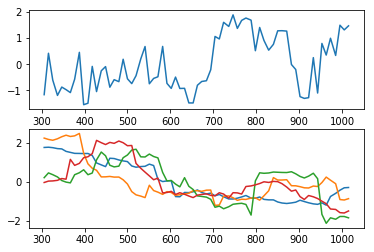

subject 34; gesture 4_1_2; avg 0.49225557657823626; sd 0.044728993869073475
subject 34; gesture 4_1_2; PoV: 0.8269089874587419


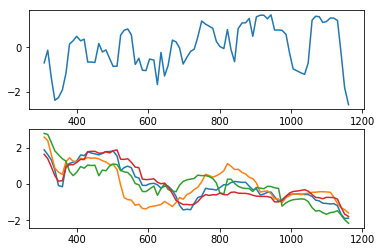

subject 34; gesture 2_0_2; avg 0.5479283791901398; sd 0.026126830605035026
subject 34; gesture 2_0_2; PoV: 0.8679612970896227


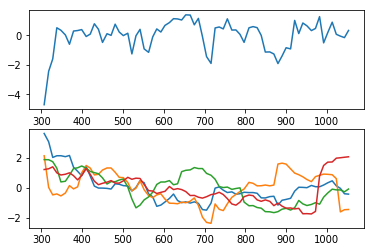

subject 34; gesture 1_1_2; avg 0.6589346002775873; sd 0.06567269473420413
subject 34; gesture 1_1_2; PoV: 0.8387457235720172


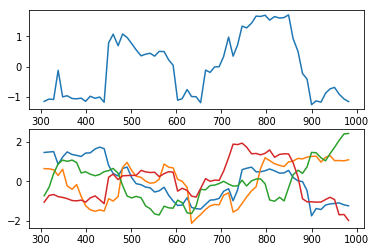

subject 34; gesture 2_1_2; avg 0.5531765284520179; sd 0.10488296474652972
subject 34; gesture 2_1_2; PoV: 0.7652172602499256


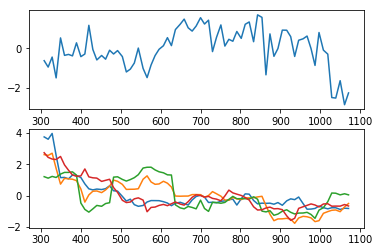

subject 34; gesture 4_0_1; avg 0.5060992299470422; sd 0.043503621959839846
subject 34; gesture 4_0_1; PoV: 0.8339211743258858


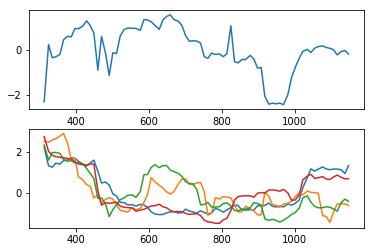

subject 34; gesture 3_0_2; avg 0.5729749209985285; sd 0.02831533792727947
subject 34; gesture 3_0_2; PoV: 0.8697897141010186


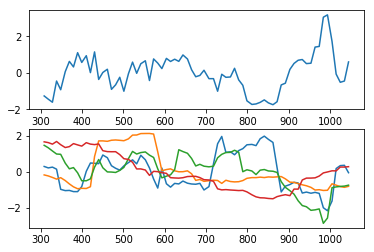

subject 34; gesture 1_1_1; avg 0.4278322135578133; sd 0.02203281761943345
subject 34; gesture 1_1_1; PoV: 0.865800751181108


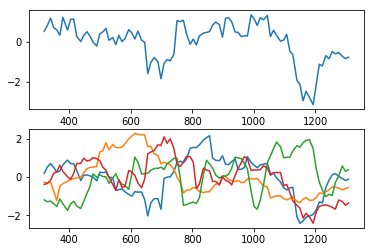

subject 34; gesture 3_1_2; avg 0.5469535362093961; sd 0.037517082257974725
subject 34; gesture 3_1_2; PoV: 0.8536151866445834


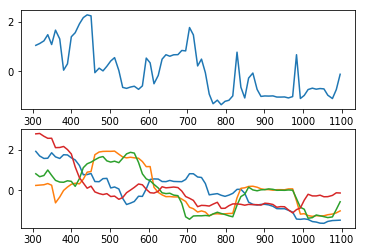

subject 34; gesture 2_1_1; avg 0.4341942496816732; sd 0.02451171892498675
subject 34; gesture 2_1_1; PoV: 0.8617945027190164


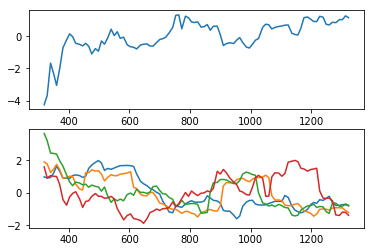

subject 34; gesture 1_0_1; avg 0.5082661900561832; sd 0.04215477881308263
subject 34; gesture 1_0_1; PoV: 0.8445772486545166


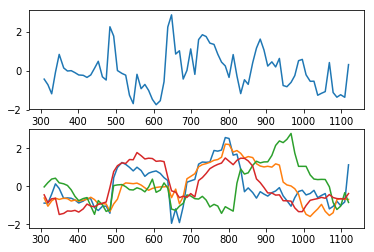

subject 34; gesture 3_1_1; avg 0.5510268525732548; sd 0.03604622087848394
subject 34; gesture 3_1_1; PoV: 0.8531360654065508


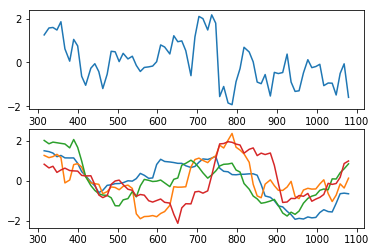

subject 34; gesture 1_0_2; avg 0.5230348285571553; sd 0.02696577594552267
subject 34; gesture 1_0_2; PoV: 0.8652611174878163


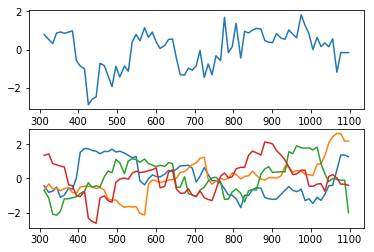

subject 34; gesture 4_0_2; avg 0.44260574219629706; sd 0.020478789608919752
subject 34; gesture 4_0_2; PoV: 0.8699860987177224


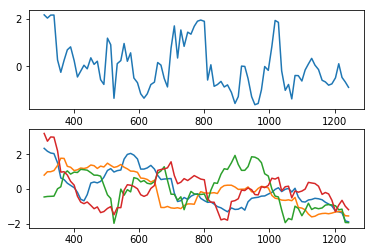

subject 10; gesture 3_0_1; avg 0.5473700187308322; sd 0.04711643855643012
subject 10; gesture 3_0_1; PoV: 0.8346858696939051


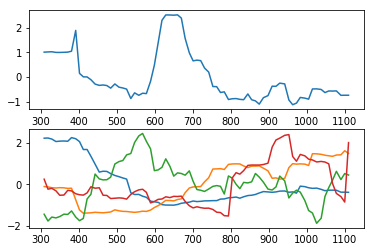

subject 10; gesture 4_1_1; avg 0.6708921040102799; sd 0.04456100082593867
subject 10; gesture 4_1_1; PoV: 0.8516609778802072


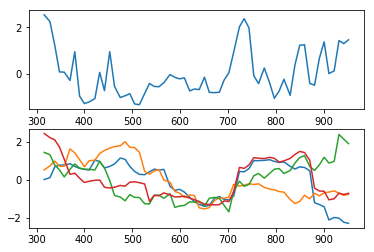

subject 10; gesture 2_0_1; avg 0.6219416732403916; sd 0.043480862757256385
subject 10; gesture 2_0_1; PoV: 0.8462675307015979


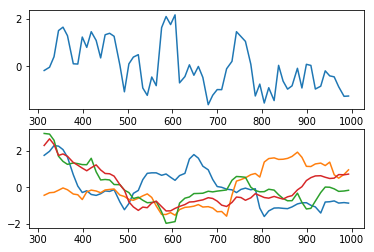

subject 10; gesture 4_1_2; avg 0.5128181069941623; sd 0.02600586798552962
subject 10; gesture 4_1_2; PoV: 0.8659181006147262


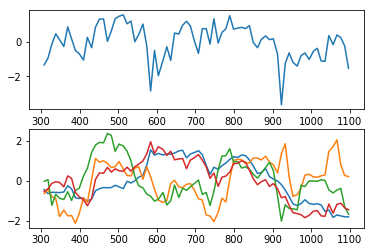

subject 10; gesture 2_0_2; avg 0.6490360635173235; sd 0.34427048657535225
subject 10; gesture 2_0_2; PoV: 0.6084330622036347


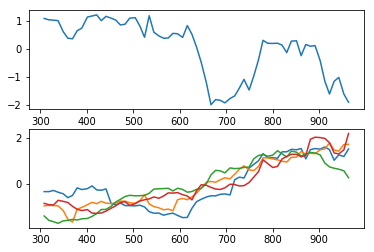

subject 10; gesture 1_1_2; avg 0.6417471020950729; sd 0.4222989333955387
subject 10; gesture 1_1_2; PoV: 0.5650814480500783


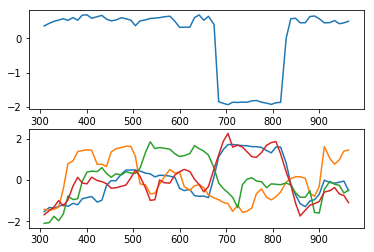

subject 10; gesture 2_1_2; avg 0.5492718411451979; sd 0.036221293573432574
subject 10; gesture 2_1_2; PoV: 0.8500439723910729


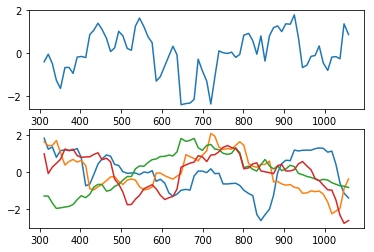

subject 10; gesture 4_0_1; avg 0.6144936787424019; sd 0.08066699169250587
subject 10; gesture 4_0_1; PoV: 0.8004932408681329


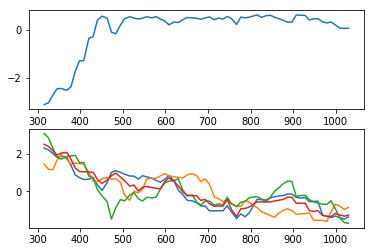

subject 10; gesture 3_0_2; avg 0.7086782386953545; sd 0.06257926440485054
subject 10; gesture 3_0_2; PoV: 0.8374081899120934


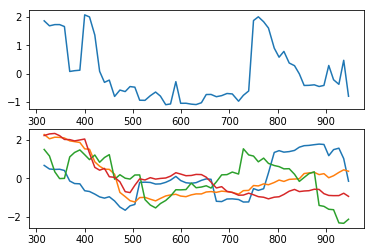

subject 10; gesture 1_1_1; avg 0.5445868083364717; sd 0.026753074519303192
subject 10; gesture 1_1_1; PoV: 0.8751114463354631


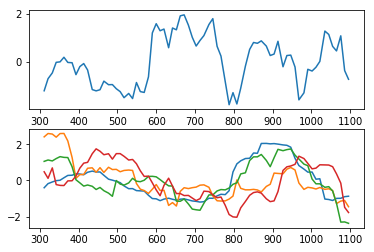

subject 10; gesture 3_1_2; avg 0.6115633447243864; sd 0.06598448479990954
subject 10; gesture 3_1_2; PoV: 0.8172915186568517


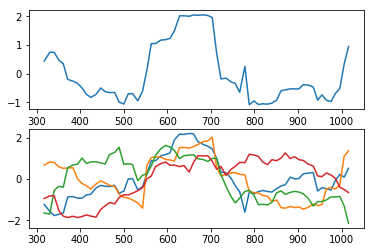

subject 10; gesture 2_1_1; avg 0.6248951143127369; sd 0.03854548849184432
subject 10; gesture 2_1_1; PoV: 0.8568238874262118


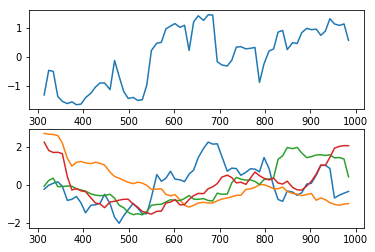

subject 10; gesture 1_0_1; avg 0.3462373323752175; sd 0.01357220905307416
subject 10; gesture 1_0_1; PoV: 0.8812934749784906


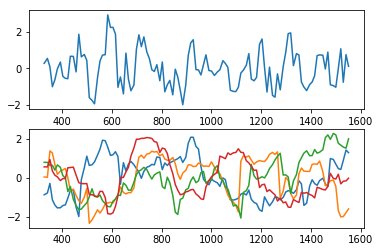

subject 10; gesture 3_1_1; avg 0.7007216550077865; sd 0.04930617885607539
subject 10; gesture 3_1_1; PoV: 0.8579932678918017


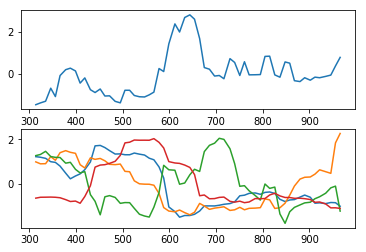

subject 10; gesture 1_0_2; avg 0.5872083282358085; sd 0.028140418286700716
subject 10; gesture 1_0_2; PoV: 0.8667214650210999


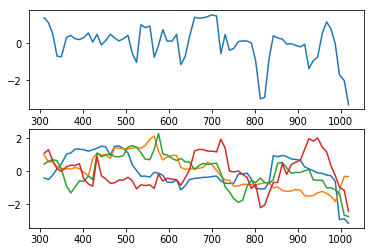

subject 10; gesture 4_0_2; avg 0.5799094843453442; sd 0.08879253469024845
subject 10; gesture 4_0_2; PoV: 0.7907682085035945


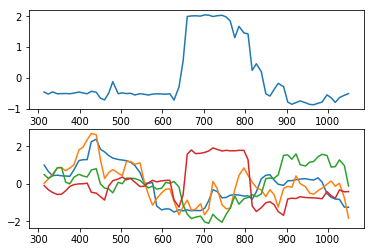

subject 02; gesture 3_0_1; avg 0.5841959355835739; sd 0.024800095072114215
subject 02; gesture 3_0_1; PoV: 0.8714095035192406


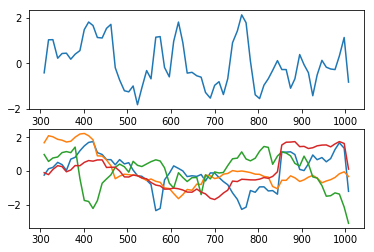

subject 02; gesture 4_1_1; avg 0.6291154210100012; sd 0.030791860821399914
subject 02; gesture 4_1_1; PoV: 0.8689590753272546


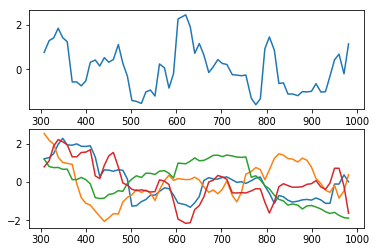

subject 02; gesture 2_0_1; avg 0.5873551631702824; sd 0.1285820458380785
subject 02; gesture 2_0_1; PoV: 0.7410033714577691


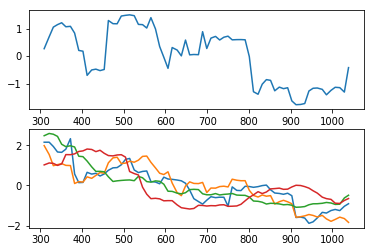

subject 02; gesture 4_1_2; avg 0.5951632807046762; sd 0.037028149220949304
subject 02; gesture 4_1_2; PoV: 0.8629396666498573


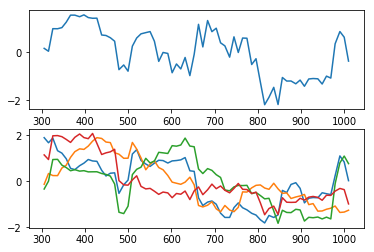

subject 02; gesture 2_0_2; avg 0.5901503265035399; sd 0.035252907465388346
subject 02; gesture 2_0_2; PoV: 0.8543814161708407


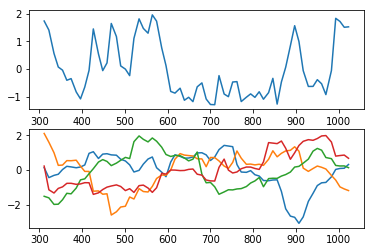

subject 02; gesture 1_1_2; avg 0.5735314046724683; sd 0.03405003552827385
subject 02; gesture 1_1_2; PoV: 0.8504036232412362


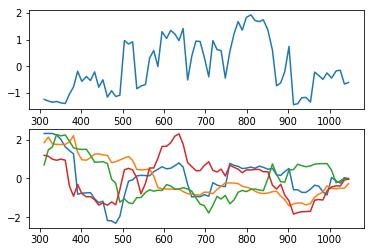

subject 02; gesture 2_1_2; avg 0.6289917295362406; sd 0.08224793407291944
subject 02; gesture 2_1_2; PoV: 0.80455845885696


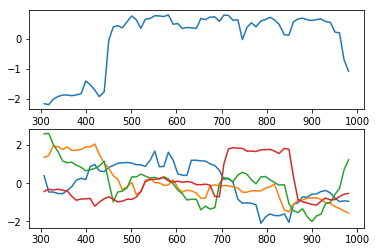

subject 02; gesture 4_0_1; avg 0.5840223310417587; sd 0.09590968611065294
subject 02; gesture 4_0_1; PoV: 0.7706626308372254


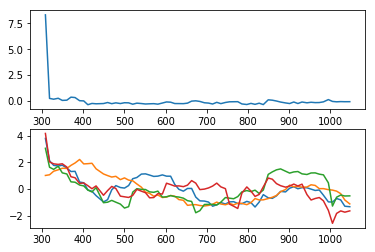

subject 02; gesture 3_0_2; avg 0.6418051965001244; sd 0.060650187014770256
subject 02; gesture 3_0_2; PoV: 0.8242827943491878


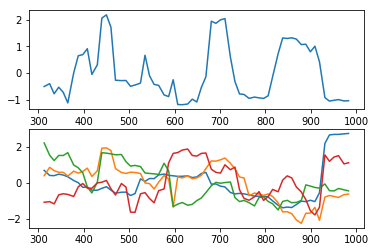

subject 02; gesture 1_1_1; avg 0.47763560787611986; sd 0.02117684436309495
subject 02; gesture 1_1_1; PoV: 0.8791692016903562


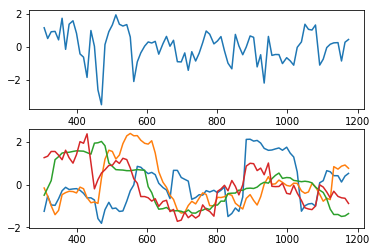

subject 02; gesture 3_1_2; avg 0.5494048724014962; sd 0.03942437650648242
subject 02; gesture 3_1_2; PoV: 0.8450660658589302


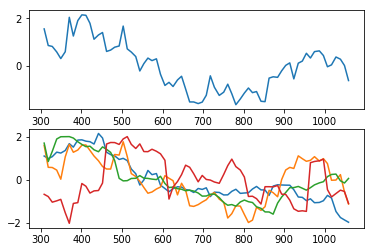

subject 02; gesture 2_1_1; avg 0.5446675872618525; sd 0.024707513435430824
subject 02; gesture 2_1_1; PoV: 0.8678065113886504


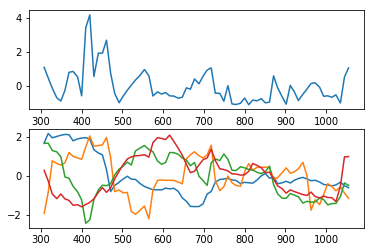

subject 02; gesture 1_0_1; avg 0.6194569501065582; sd 0.04232051531064232
subject 02; gesture 1_0_1; PoV: 0.8534302511981374


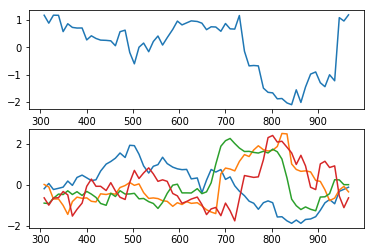

subject 02; gesture 3_1_1; avg 0.5538536777247085; sd 0.02757038523896373
subject 02; gesture 3_1_1; PoV: 0.868332690841738


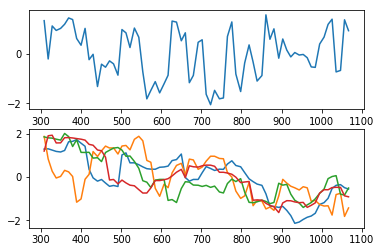

subject 02; gesture 1_0_2; avg 0.5368930924878738; sd 0.04274851243281884
subject 02; gesture 1_0_2; PoV: 0.8479872074799819


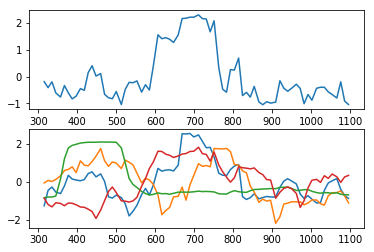

subject 02; gesture 4_0_2; avg 0.5611428707917377; sd 0.06589116572402451
subject 02; gesture 4_0_2; PoV: 0.7952352285107203


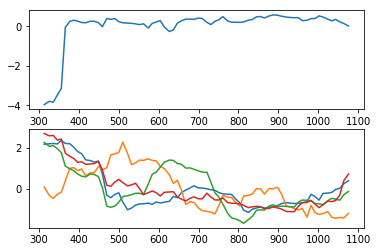

In [6]:
decomp_syn = {}

for s, gdict in dict_synerg.items():
    decomp_syn[s] = {}
    for g, a in gdict.items():
        print(f"subject {s}; gesture {g}; avg {a.mean()}; sd {a.std()}")
        evals, evecs = la.eig(a)
        evals = evals.real
        sort_idx = np.argsort(-evals)
        evals = evals[sort_idx]
        evecs = evecs[:, sort_idx]
        # calc percent of variance explained
        print(f"subject {s}; gesture {g}; PoV: {evals[0].real / evals.real.sum()}")
        # do PCA
        res = a @ evecs[:, 0]
        res = scale(res.real)
        decomp_syn[s][g] = res
        # plot results
        plt.subplot(211)
        plt.plot(dc.data_set_smooth[s][g][:,0], res)
        plt.subplot(212)
        plt.plot(dc.data_set_smooth[s][g][:,0], dc.data_set_smooth[s][g][:,1])
        plt.plot(dc.data_set_smooth[s][g][:,0], dc.data_set_smooth[s][g][:,2])
        plt.plot(dc.data_set_smooth[s][g][:,0], dc.data_set_smooth[s][g][:,3])
        plt.plot(dc.data_set_smooth[s][g][:,0], dc.data_set_smooth[s][g][:,4])
        plt.show()

---

In [7]:
# organize vectors by gesture
gest_dict = {"1":[], "2":[], "3":[], "4":[]}

for s, gdict in decomp_syn.items():
    for g, a in gdict.items():
        if g[0] not in ["1", "2", "3", "4"]: continue
        gest_dict[g[0]].append(a)

In [8]:
comp_dict = {"1":{"1":[], "2":[], "3":[], "4":[]},
             "2":{"1":[], "2":[], "3":[], "4":[]},
             "3":{"1":[], "2":[], "3":[], "4":[]},
             "4":{"1":[], "2":[], "3":[], "4":[]}}

for g1 in ["1", "2", "3", "4"]:
    for g2 in ["1", "2", "3", "4"]:
        for i in range(144):
            for j in range(144):
                if i == j and g1 == g2: continue
                comp_dict[g1][g2].append(dtw(gest_dict[g1][i], gest_dict[g2][j]))

In [9]:
for g1 in ["1", "2", "3", "4"]:
    print(f"gesture {g1} dtw similarities w/ other gestures:")
    for g2 in ["1", "2", "3", "4"]:
        print(f"avg similarity vs gesture {g2}: {np.mean(comp_dict[g1][g2])}")

gesture 1 dtw similarities w/ other gestures:
avg similarity vs gesture 1: 6.559443879043812
avg similarity vs gesture 2: 6.843982158036759
avg similarity vs gesture 3: 6.921008298084917
avg similarity vs gesture 4: 6.945052230092276
gesture 2 dtw similarities w/ other gestures:
avg similarity vs gesture 1: 6.84398215803676
avg similarity vs gesture 2: 7.007909685318584
avg similarity vs gesture 3: 7.095159853517766
avg similarity vs gesture 4: 7.135046020317897
gesture 3 dtw similarities w/ other gestures:
avg similarity vs gesture 1: 6.921008298084916
avg similarity vs gesture 2: 7.095159853517766
avg similarity vs gesture 3: 7.210725838974456
avg similarity vs gesture 4: 7.244394059826743
gesture 4 dtw similarities w/ other gestures:
avg similarity vs gesture 1: 6.945052230092277
avg similarity vs gesture 2: 7.135046020317895
avg similarity vs gesture 3: 7.244394059826744
avg similarity vs gesture 4: 7.288286189142511
